In [2]:
import json
import os
import numpy as np
import requests
import pandas as pd
from bs4 import BeautifulSoup
import re
from docx import Document
from docx.shared import Pt
import pickle
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import collections
from IPython.display import display

import math
import statistics
from scipy.stats import norm

from IPython.display import display


from matplotlib.pyplot import figure

from sklearn.metrics import classification_report, ConfusionMatrixDisplay, confusion_matrix, accuracy_score

from scikitplot.metrics import plot_roc
from scikitplot.metrics import plot_precision_recall
from scikitplot.metrics import plot_cumulative_gain
from scikitplot.metrics import plot_lift_curve

from scipy.stats import shapiro, mannwhitneyu, normaltest, kstest

from deepdiff import DeepDiff
import random
import prettytable
from prettytable import PrettyTable
from textwrap import fill

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [3]:
def plot_classification_report(y_test, y_pred, lista_clf_report, cmap):
    
    model_report = classification_report(y_test, y_pred, output_dict=True)
    
    model_r = pd.DataFrame(model_report).iloc[:-1, :].T
    
    g = sns.heatmap(model_r, annot=True, cmap=cmap, cbar=False)
    
    plt.title("{} Test classification report".format(risorsa))
    
    lista_clf_report.append(model_r)
    
    plt.show()

In [4]:
def plot_classification_results(diz_df, bf, cmap):
        
    y_test = 'y_test' if not bf else 'gold_classes'
    y_pred = 'y_pred' if not bf else 'system_classes'
    y_score = 'y_score' if not bf else 'probabilities'
    
    lista_cm_normalizzate = []
    lista_clf_report = []
    
    for clf in diz_df:
        
        #classificatore del livello
        print("\033[1m{}\033[0m".format(clf.title()))
        
        print("------------------------")
        print("  Summary")
        print("------------------------")
        print(classification_report(diz_df[clf][y_test], diz_df[clf][y_pred]))
        
        plot_classification_report(diz_df[clf][y_test], diz_df[clf][y_pred], lista_clf_report, cmap)

        print("\n------------------------")
        print("  Confusion Matrix")
        print("------------------------")
        
        cm1 = ConfusionMatrixDisplay.from_predictions(diz_df[clf][y_test], \
                                                      diz_df[clf][y_pred], cmap=cmap)

        
        cm2 = ConfusionMatrixDisplay.from_predictions(diz_df[clf][y_test], \
                                                      diz_df[clf][y_pred], normalize = 'true', cmap=cmap)
        
        cm1.ax_.set_title("{} Confusion matrix {}".format(risorsa, clf))
        cm2.ax_.set_title("{} Confusion matrix normalized {}".format(risorsa, clf))
                
        lista_cm_normalizzate.append(cm2)
        
        plot_roc(diz_df[clf][y_test], \
                  diz_df[clf][y_score])
        
        plot_precision_recall(diz_df[clf][y_test], \
                  diz_df[clf][y_score])
        
        plot_cumulative_gain(diz_df[clf][y_test], \
                  diz_df[clf][y_score])
        
        plot_lift_curve(diz_df[clf][y_test], \
                  diz_df[clf][y_score])

        plt.show()
        
        print("------------------------------------------------------------------------------------------------")
        
    return lista_cm_normalizzate, lista_clf_report

In [5]:
path_pickle = "../pickle"

In [6]:
path_images = "../plots/"
path_images_tit_ridotti = "../plots_titoli_ridotti/"

In [64]:
def controlla_ids(diz):
    
    lista_ids = []
    
    for clf in diz:
        
        if not lista_ids:
            print("inizializzo la lista con il classificatore {}".format(clf))
            lista_ids = list(diz[clf]['ids_preds'].keys())
            
        if list(diz[clf]['ids_preds'].keys()) != lista_ids:
            print("Ho trovato degli id diversi per il classificatore {}".format(clf))
            
    return lista_ids

In [65]:
diz_cmap = {'5': 'Blues',
            '10': 'YlOrBr',
            '20': 'PuRd',
            '30': 'Reds',
            'random_speech': 'YlGn'}
risorsa = 'ParlaMint'

In [66]:
def plot_all_normalized_confusion_matrices(lista_grafici, model, dist, cmap, titolo_ridotto='', no_pretrain=''):
    
    n_cols = 1
    n_rows = 1
    figsize=(15, 7)
    fontsize = 15
    fontsize_plots = 10
    clf_epoch = 'epoch'
    
    if 'SVM' in model:
        n_cols = 6
        n_rows = 2
        clf_epoch = 'clf'
    else:
        n_cols = 5
        n_rows = 1
        figsize=(10, 12)
        fontsize = 13
        
    fig,ax = plt.subplots(n_rows, n_cols, figsize = figsize)

    if 'SVM' in model:
        contatore_colonne = 0
        for i, j in zip(range(n_rows), (lista_grafici[:n_cols], lista_grafici[n_cols:])):
            for z, f in enumerate(j):
                contatore_colonne += 1
                f.plot(ax=ax[i][z], cmap=cmap)
                f.im_.colorbar.remove()
                f.ax_.set_xlabel('')
                if z!=0:
                    f.ax_.set_ylabel('')
                if z==0:
                    f.ax_.set_ylabel(f.ax_.get_ylabel(), fontsize=fontsize_plots)
                f.ax_.set_title('{} {}'.format(clf_epoch, str(contatore_colonne)), fontsize=fontsize_plots)
                plt.tight_layout()
    
    else:
        for i, f in enumerate(lista_grafici):
            f.plot(ax=ax[i], cmap=cmap)
            f.im_.colorbar.remove()
            f.ax_.set_xlabel('')
            if i!=0:
                f.ax_.set_ylabel('')
            if i==0:
                f.ax_.set_ylabel(f.ax_.get_ylabel(), fontsize=fontsize_plots)
            f.ax_.set_title('{} {}'.format(clf_epoch, i+1), fontsize=fontsize_plots)
            plt.tight_layout()
        
        
    if 'SVM' in model:
        fig.text(0.5, 0.05, 'Predicted label', ha='left', fontsize = fontsize_plots)
    
    else:
        fig.text(0.5, 0.39, 'Predicted label', ha='left', fontsize = fontsize_plots)
    
    #plt.subplots_adjust(wspace=0.3, hspace=3)
 
    #fig.colorbar(f.im_, orientation='horizontal', cax=cax)
    title = "{} Normalized confusion matrices for {} classification on distance {}".format(risorsa, model, dist)
    if model == 'BERT fine-tuned':
        title = "{} Normalized confusion matrices for {} classification on distance {}".format(risorsa, model, dist)
    if not titolo_ridotto:
        #plt.suptitle(title, fontsize=fontsize)
        plt.title(title, fontsize=fontsize)
    
    if titolo_ridotto:
        if no_pretrain:
            title+="_no_pretrain"
        fig.savefig(path_images_tit_ridotti + title + '.png', dpi=fig.dpi, bbox_inches='tight')
    else:
        if no_pretrain:
            title+="_no_pretrain"
        fig.savefig(path_images + title + '.png', dpi=fig.dpi, bbox_inches='tight')
    
    plt.show()

In [67]:
def plot_all_classification_report(lista_clf_report, dist, cmap, model, titolo_ridotto='', no_pretrain=''):
    
    nrows = ''
    ncols = ''
    figsize=(15, 13)
    
    if 'SVM' in model:
        nrows = 4
        ncols = 3
    else:
        nrows = 2
        ncols = 3
        figsize=(14,6)
        
    fig,ax = plt.subplots(nrows, ncols, figsize=figsize, sharey=True)
    n_row = -1

    if "SVM" in model:
        for j in list(range(nrows)):
            for i in list(range(ncols)):
                n_row +=1
                g = sns.heatmap(lista_clf_report[n_row], annot=True, cmap=cmap, cbar=False, ax= ax[j, i])
                title = "{} {} clf {} Test classification report \nDistance {}".format(risorsa, model, n_row+1, dist)
                if 'scaled' in model:
                    title = "{} {} \nclf {} Test classification report \nDistance {}".format(risorsa, model, n_row+1, dist)
                if titolo_ridotto:
                    title = "clf {}".format(n_row+1)
                g.set_title(title)
            plt.tight_layout()
        
    if not "SVM" in model:
        for j in list(range(nrows)):
            for i in list(range(ncols)):
                if j == 0 and i in range(0,3) or j == 1 and i in range(2):
                    n_row +=1
                    g = sns.heatmap(lista_clf_report[n_row], annot=True, cmap=cmap, cbar=False, ax= ax[j, i])
                    title =  "{} {} epoch {}\n Test classification report \nDistance {}".format(risorsa, model, n_row+1, dist)
                    if titolo_ridotto:
                        title = "epoch {}".format(n_row+1)
                    g.set_title(title)
            plt.tight_layout()
        
        if j == 1:
            for s in range(2, 3):
                fig.delaxes(ax[j, s])
                
        
    if titolo_ridotto:
        t = "{} - {} Test classification reports (distance {})".format(risorsa, model, dist)
        if no_pretrain:
            t+='_no_pretrain'
        t += '.png'
        fig.savefig(path_images_tit_ridotti + t, dpi=fig.dpi, bbox_inches='tight')
    else:
        t = "{} - {} Test classification reports (distance {})".format(risorsa, model, dist)
        if no_pretrain:
            t+='_no_pretrain'
        t += '.png'
        fig.savefig(path_images + t, dpi=fig.dpi, bbox_inches='tight')

### Performance measurements
- **ROC curve**: https://towardsdatascience.com/understanding-auc-roc-curve-68b2303cc9c5
    AUC (Area Under The Curve) ROC (Receiver Operating Characteristics) curve (or AUROC - Area Under the Receiver Operating Characteristics). It is one of the most important evaluation metrics for checking any classification model’s performance. ROC is a probability curve and AUC represents the degree or measure of separability. It tells how much the model is capable of distinguishing between classes. 
    Higher the AUC, the better the model is at predicting 0 classes as 0 and 1 classes as 1. An excellent model has AUC near to the 1 which means it has a good measure of separability. A poor model has an AUC near 0 which means it has the worst measure of separability. In fact, it means it is reciprocating the result. It is predicting 0s as 1s and 1s as 0s. And when AUC is 0.5, it means the model has no class separation capacity whatsoever.
-  **Lift curve**: The lift curve describes a performance coefficient (the lift) over the cumulative proportion of a population. The Lift Chart measures the effectiveness of models by calculating the ratio between the result obtained with a model and the result obtained without a model. The result obtained without a model is based on randomly selected records. In the chart, it is represented by the random curve. In the Lift Chart, the random curve is always represented as a horizontal line. At that point in the chart where the model curve declines below the random curve, the lift factor is smaller than 1. This means that the records of the model contain fewer target values than a random sample with equally distributed target values.
- **Precision recall curve**: 
    Precision can be thought of as the fraction of positive predictions that actually belong to the positive class. Recall can be thought of as the fraction of positive predictions out of all positive instances in the data set. The gray dotted line represents a “baseline” classifier — this classifier would simply predict that all instances belong to the positive class. A good classifier will maintain both a high precision and high recall across the graph, and will “hug” the upper right corner.

In [68]:
def plot_loss_and_accuracy_of_all_distances_svm(list_of_diz, titolo_ridotto='', no_pretrain=''):
    
    fig,ax = plt.subplots(1, 1)
    
    for diz, dist, marker in zip(list_of_diz, ['5', '10', '20', '30', 'random_speech'], ['o', '^', 's', 'd', 'v']):
        test_acc = []
        for epoch in diz:
            test_acc.append(diz[epoch]["accuracy"])

        plt.plot(range(1,13), test_acc, label = "Distance {}".format(dist), linewidth=.8, marker=marker)
    
    plt.grid()
    title = "{} - SVM Test accuracy summary".format(risorsa, str(dist))
    plt.xlabel("Layers")
    plt.xticks(range(1,13))
    plt.ylabel("Test Accuracy")
    plt.legend(loc='lower center', bbox_to_anchor=(0.5, -0.42), ncol=2)
    
    if not titolo_ridotto:
        if no_pretrain:
            title+='no_pretrain'
        fig.savefig(path_images + title + '.png', dpi=fig.dpi, bbox_inches='tight')
        plt.title(title)
    
    else:
        if no_pretrain:
            title+='_no_pretrain'
        fig.savefig(path_images_tit_ridotti + title + '.png', dpi=fig.dpi, bbox_inches='tight')
        
    plt.show()

# SVM NO PRETRAINED

In [127]:
dist_5_svm_no_pretrain = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_5_no_pretrain.pickle", "rb")
dist_10_svm_no_pretrain = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_10_no_pretrain.pickle", "rb")
dist_20_svm_no_pretrain = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_20_no_pretrain.pickle", "rb")
dist_30_svm_no_pretrain = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_30_no_pretrain.pickle", "rb")
dist_random_speech_svm_no_pretrain = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_random_speech_no_pretrain.pickle", "rb")

diz_dist_5_svm_no_pretrain = pickle.load(dist_5_svm_no_pretrain)
diz_dist_10_svm_no_pretrain = pickle.load(dist_10_svm_no_pretrain)
diz_dist_20_svm_no_pretrain = pickle.load(dist_20_svm_no_pretrain)
diz_dist_30_svm_no_pretrain = pickle.load(dist_30_svm_no_pretrain)
diz_random_speech_svm_no_pretrain = pickle.load(dist_random_speech_svm_no_pretrain)

In [70]:
list(diz_dist_10_svm_no_pretrain['df_dist_10']['clf_1']['ids_preds'].keys()) == list(diz_dist_10_svm_no_pretrain['df_dist_10']['clf_5']['ids_preds'].keys())

True

In [71]:
lista_ids_svm_5_no_pretrain = controlla_ids(diz_dist_5_svm_no_pretrain['df_dist_5'])

inizializzo la lista con il classificatore clf_1


In [72]:
lista_ids_svm_10_no_pretrain = controlla_ids(diz_dist_10_svm_no_pretrain['df_dist_10'])

inizializzo la lista con il classificatore clf_1


In [73]:
lista_ids_svm_20_no_pretrain = controlla_ids(diz_dist_20_svm_no_pretrain['df_dist_20'])

inizializzo la lista con il classificatore clf_1


In [74]:
lista_ids_svm_30_no_pretrain = controlla_ids(diz_dist_30_svm_no_pretrain['df_dist_30'])

inizializzo la lista con il classificatore clf_1


In [75]:
lista_ids_svm_random_speech_no_pretrain = controlla_ids(diz_random_speech_svm_no_pretrain['df_random_speech'])

inizializzo la lista con il classificatore clf_1


# SVM no-pretrain classification results

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.51      0.50      1200
           1       0.49      0.47      0.48      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



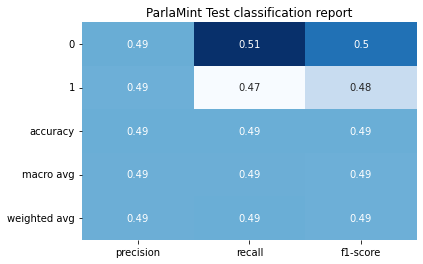


------------------------
  Confusion Matrix
------------------------


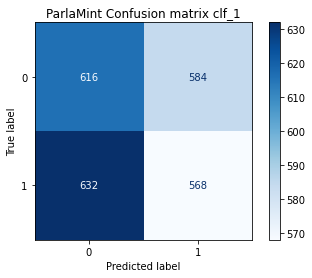

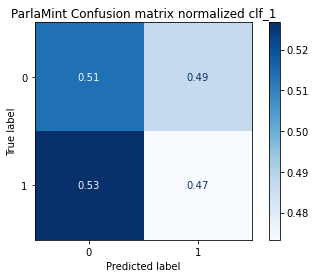

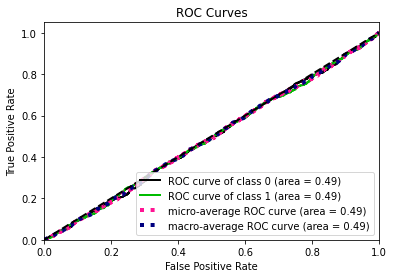

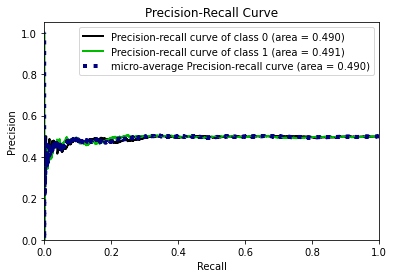

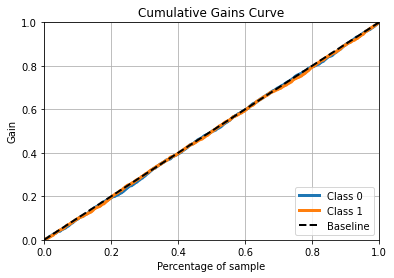

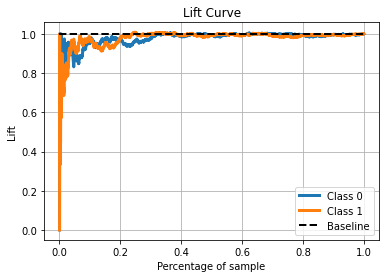

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



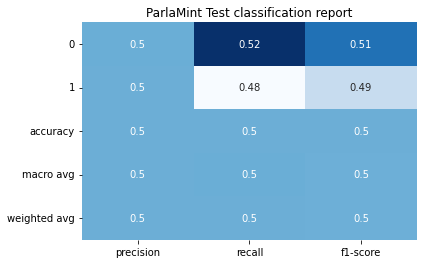


------------------------
  Confusion Matrix
------------------------


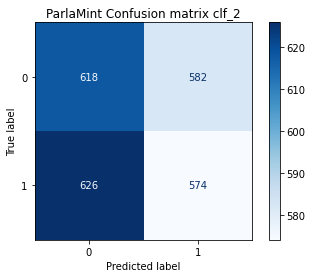

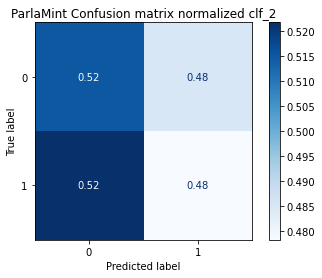

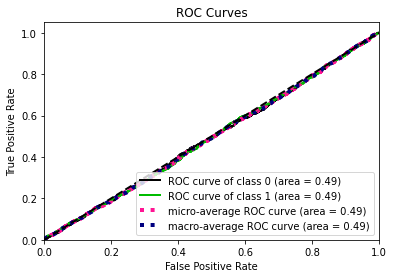

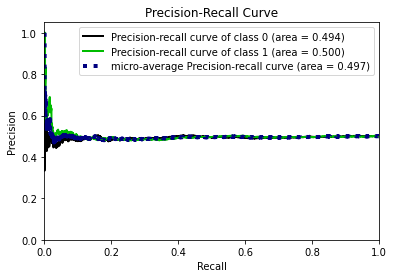

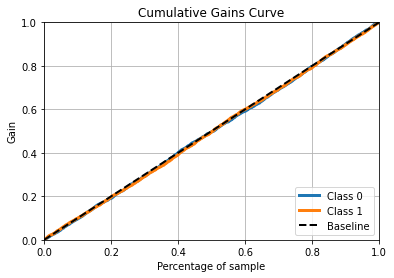

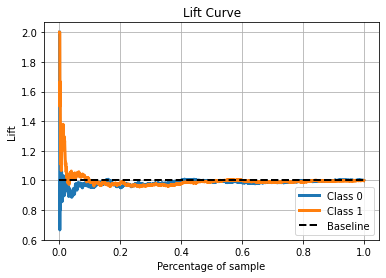

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.51      1200
           1       0.50      0.49      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



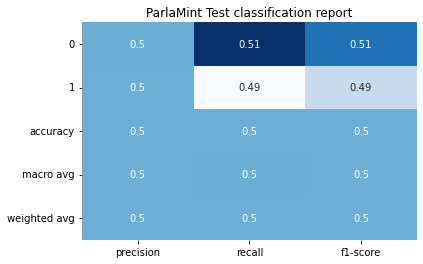


------------------------
  Confusion Matrix
------------------------


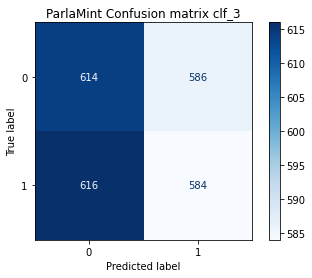

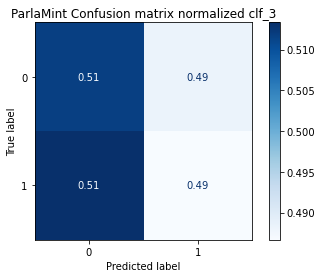

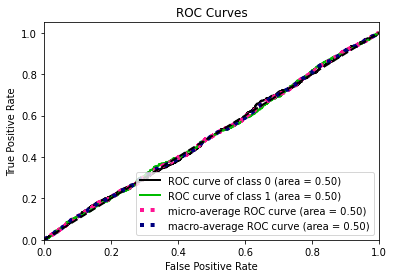

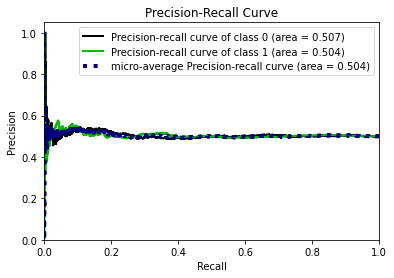

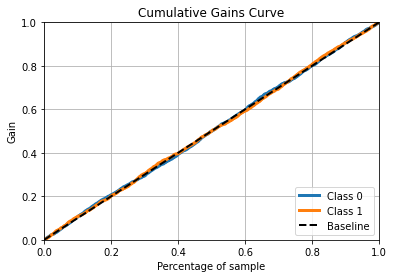

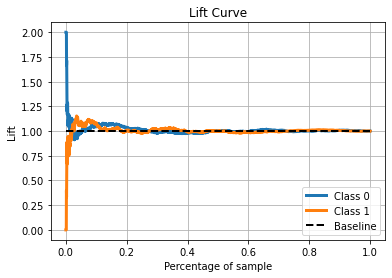

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.50      0.50      1200
           1       0.49      0.49      0.49      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



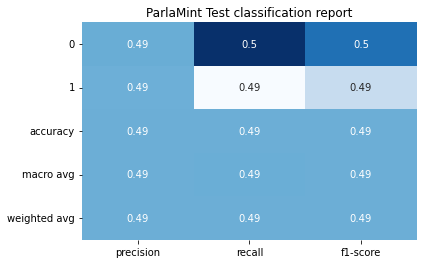


------------------------
  Confusion Matrix
------------------------


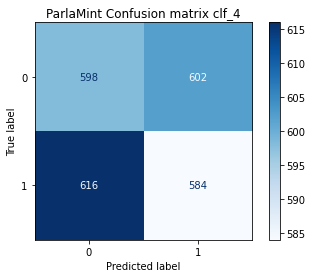

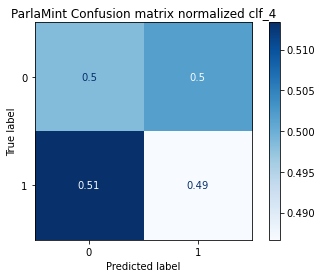

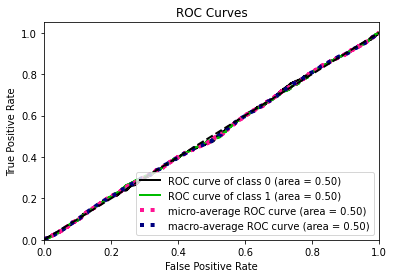

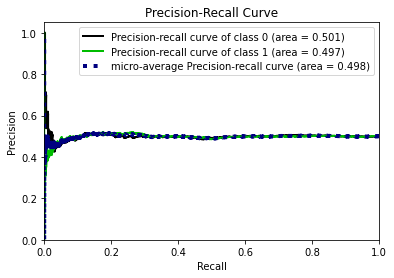

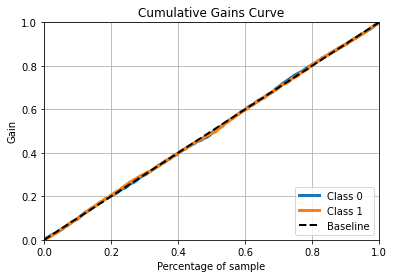

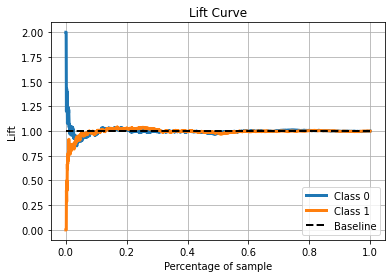

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.51      1200
           1       0.50      0.49      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



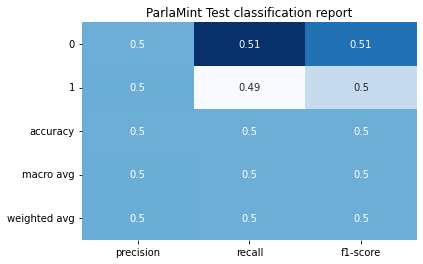


------------------------
  Confusion Matrix
------------------------


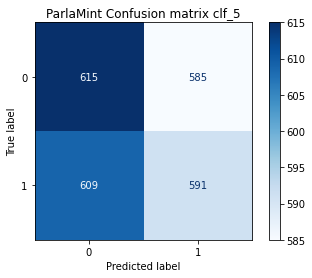

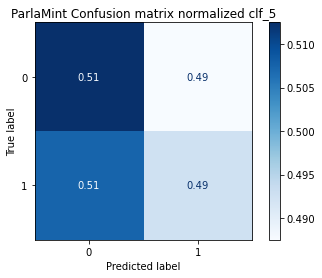

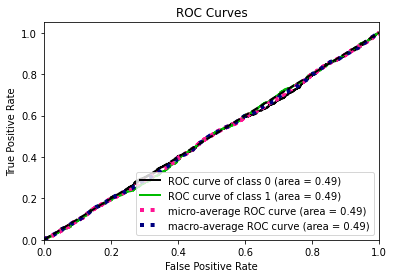

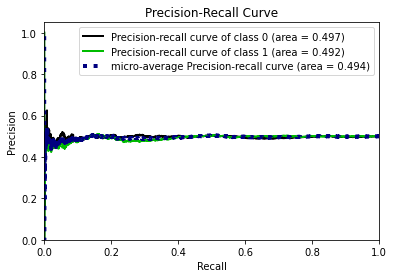

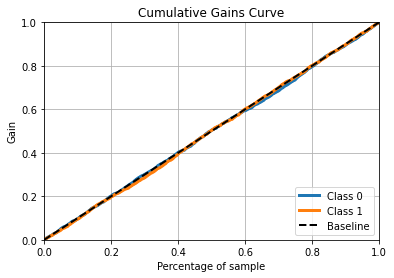

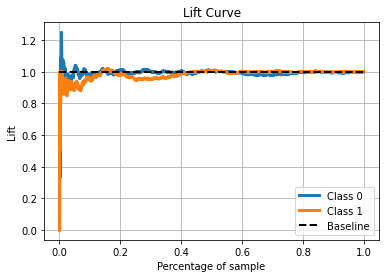

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.48      0.48      0.48      1200
           1       0.48      0.48      0.48      1200

    accuracy                           0.48      2400
   macro avg       0.48      0.48      0.48      2400
weighted avg       0.48      0.48      0.48      2400



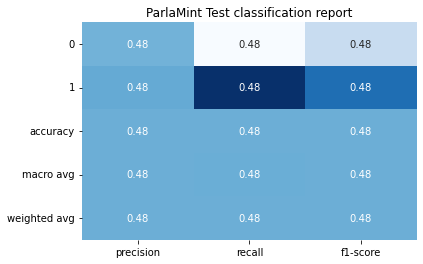


------------------------
  Confusion Matrix
------------------------


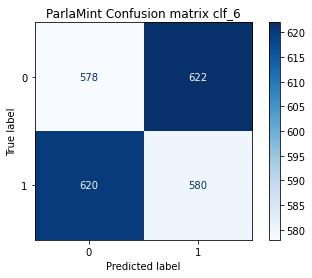

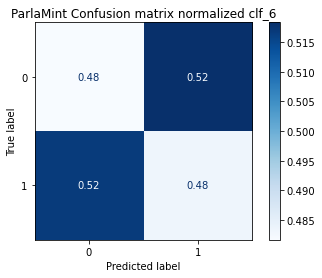

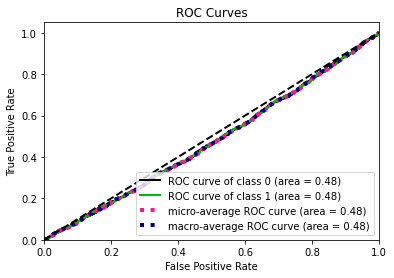

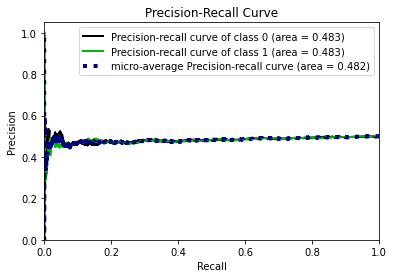

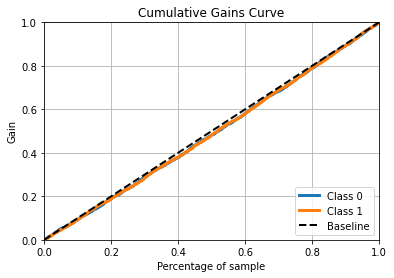

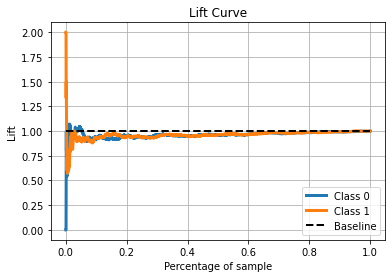

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.48      0.48      0.48      1200
           1       0.49      0.49      0.49      1200

    accuracy                           0.48      2400
   macro avg       0.48      0.48      0.48      2400
weighted avg       0.48      0.48      0.48      2400



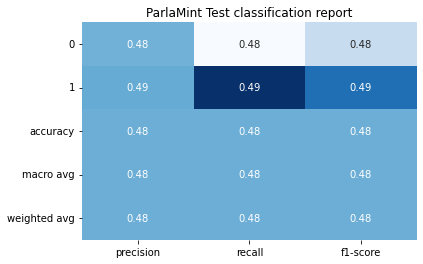


------------------------
  Confusion Matrix
------------------------


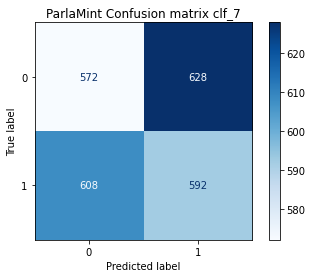

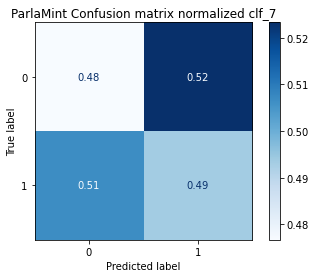

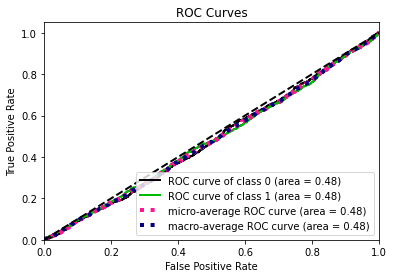

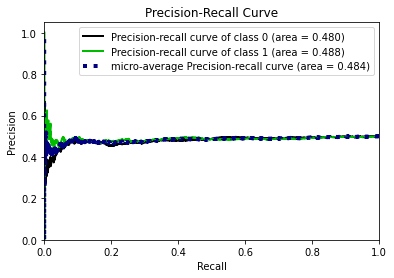

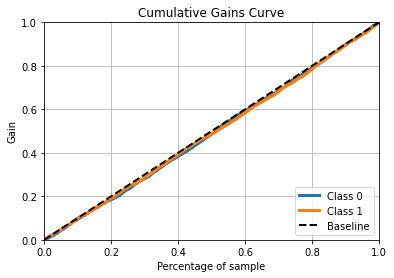

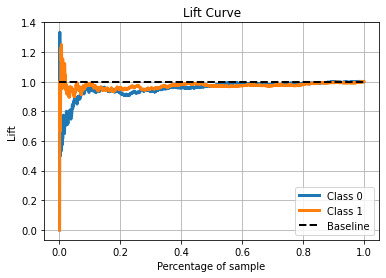

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.48      0.49      1200
           1       0.49      0.51      0.50      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



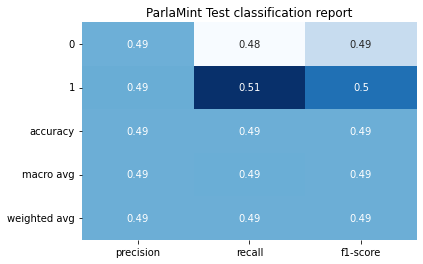


------------------------
  Confusion Matrix
------------------------


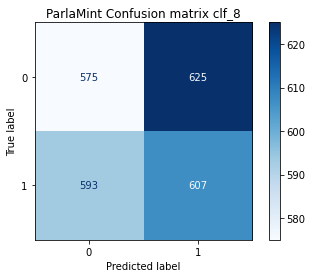

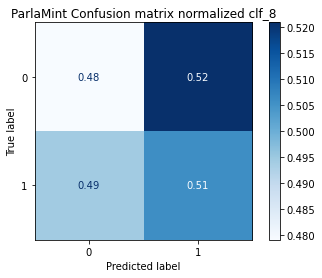

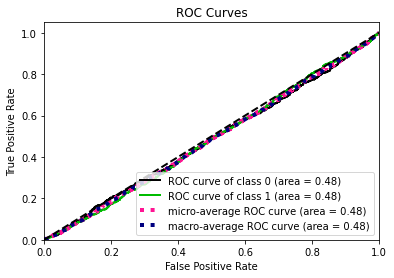

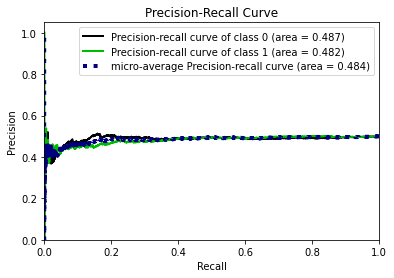

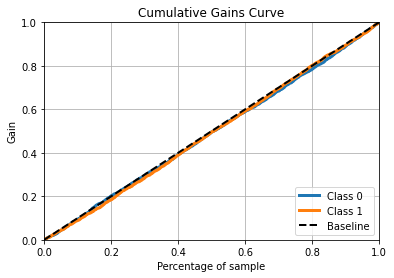

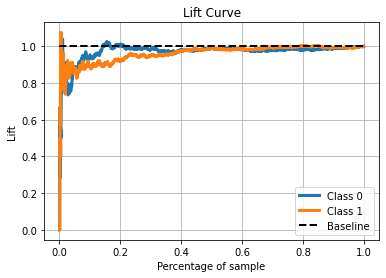

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.48      0.49      1200
           1       0.50      0.51      0.51      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



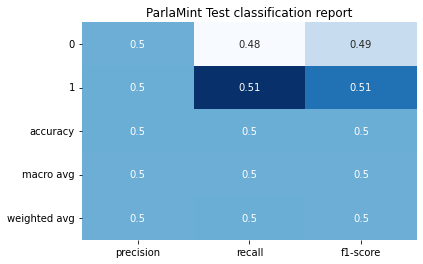


------------------------
  Confusion Matrix
------------------------


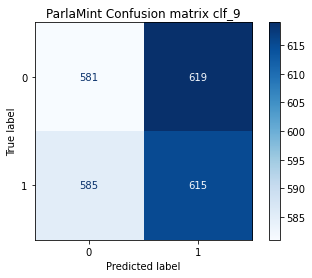

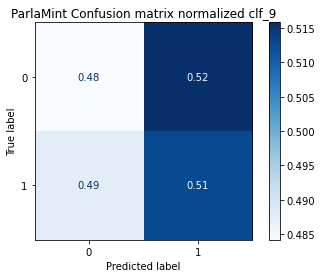

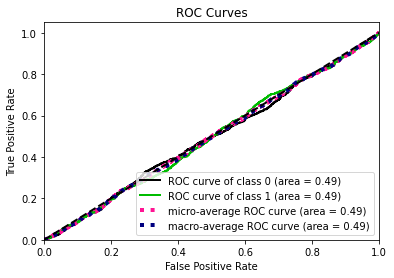

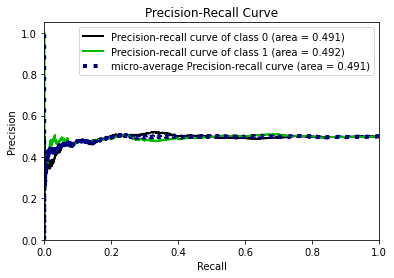

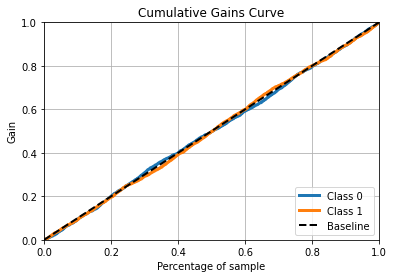

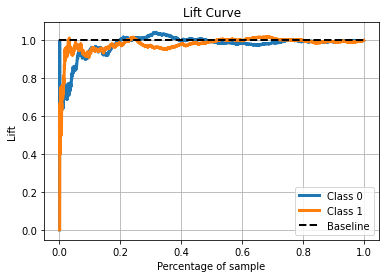

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.49      0.49      1200
           1       0.50      0.50      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



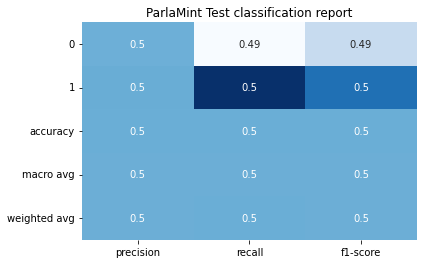


------------------------
  Confusion Matrix
------------------------


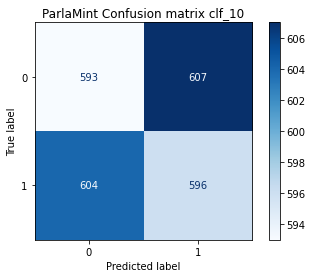

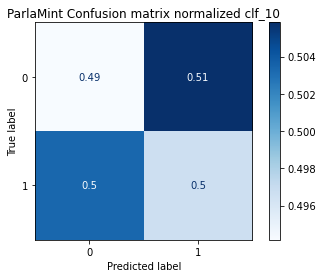

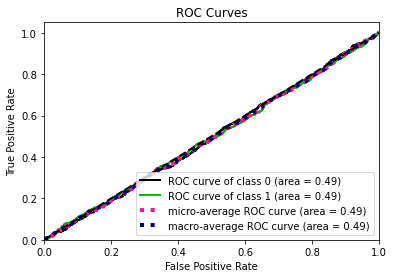

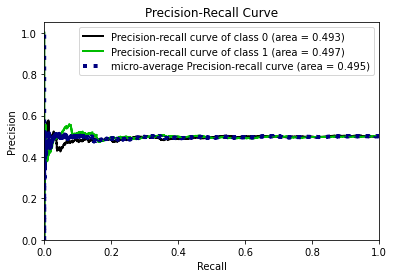

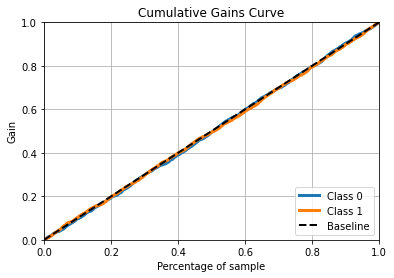

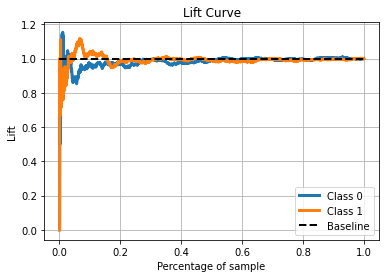

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.48      0.49      1200
           1       0.50      0.51      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



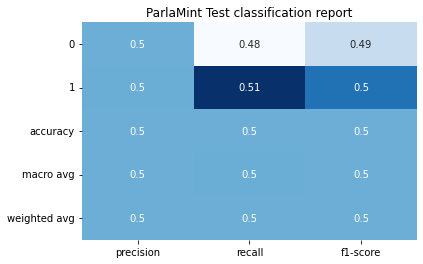


------------------------
  Confusion Matrix
------------------------


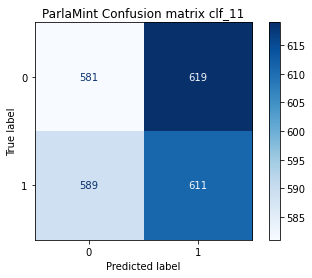

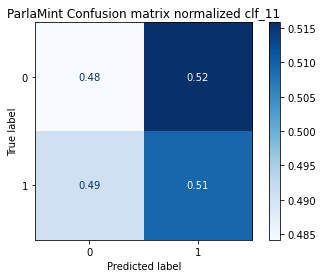

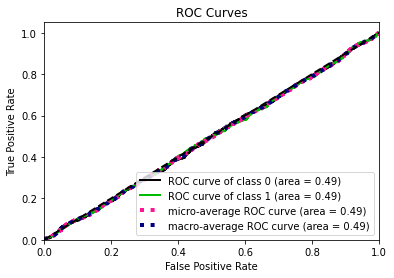

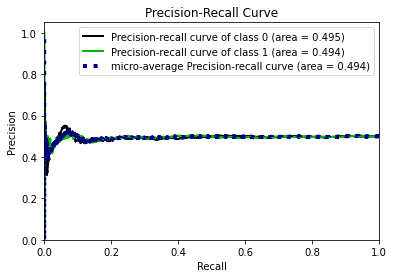

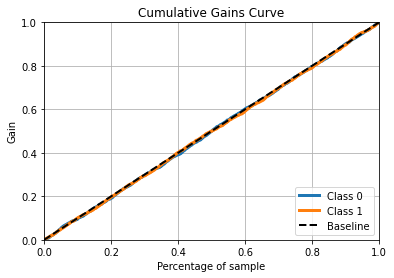

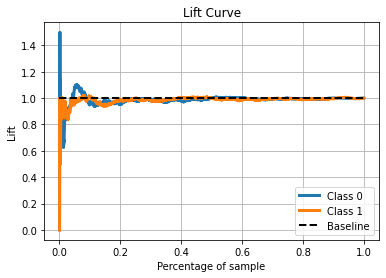

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.48      0.49      1200
           1       0.49      0.51      0.50      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



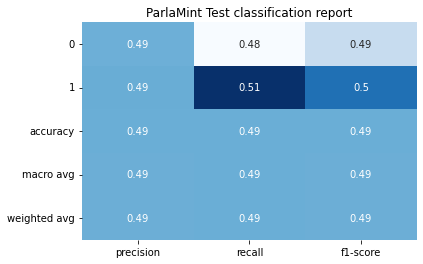


------------------------
  Confusion Matrix
------------------------


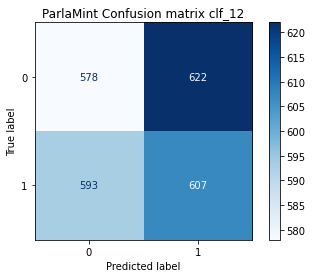

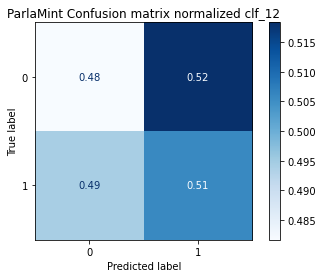

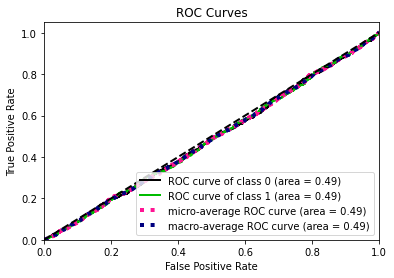

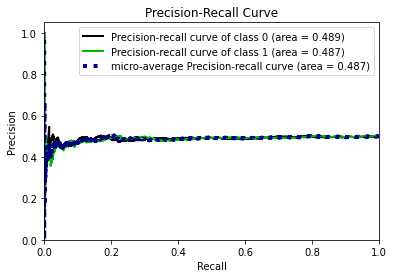

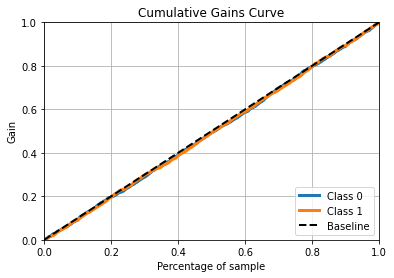

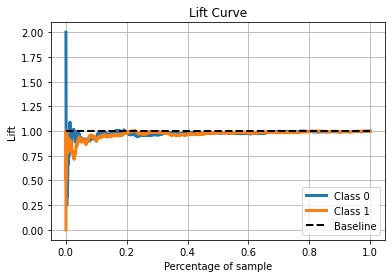

------------------------------------------------------------------------------------------------


In [76]:
lista_cm_normalizzate_svm_5_no_pretrain, lista_clf_report_5_no_pretrain = \
        plot_classification_results(diz_dist_5_svm_no_pretrain['df_dist_5'], False, diz_cmap['5'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.53      0.52      1200
           1       0.51      0.48      0.49      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.50      2400
weighted avg       0.51      0.51      0.50      2400



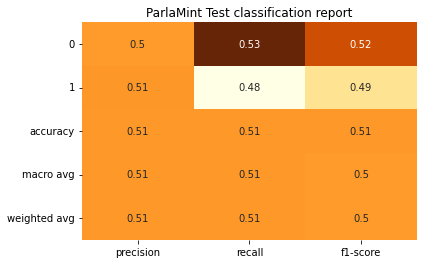


------------------------
  Confusion Matrix
------------------------


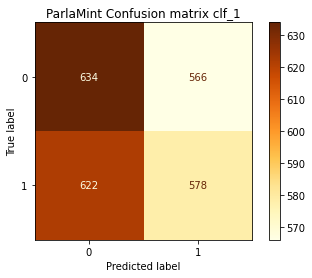

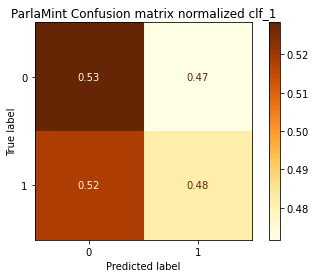

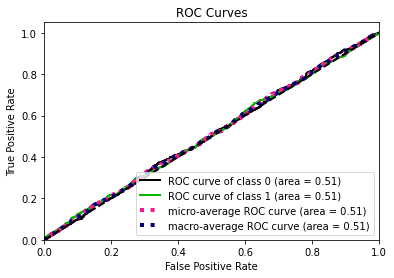

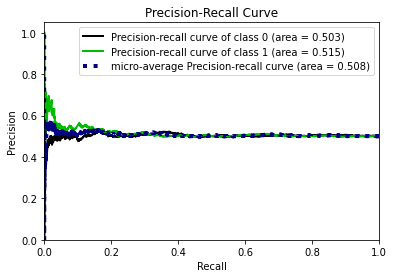

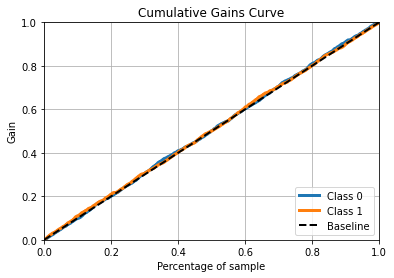

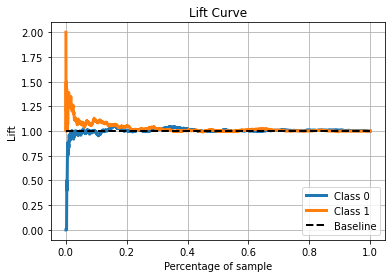

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.48      0.49      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



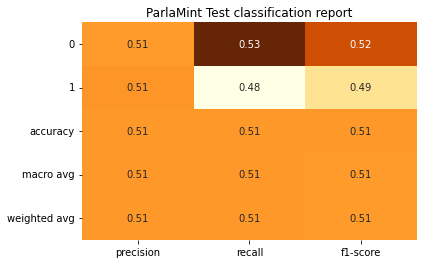


------------------------
  Confusion Matrix
------------------------


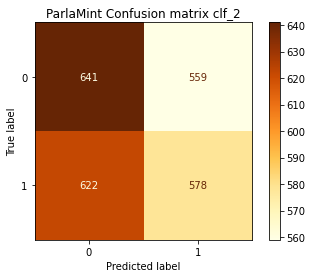

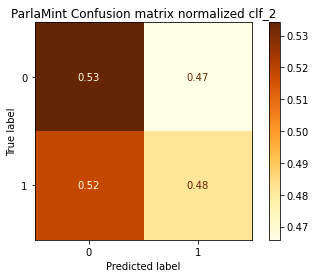

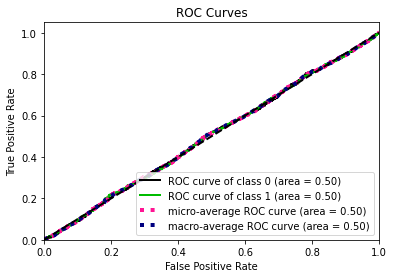

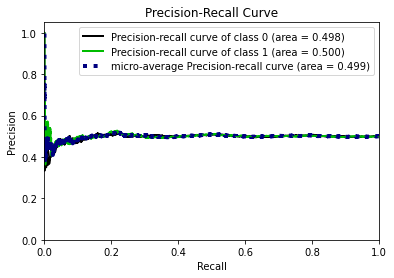

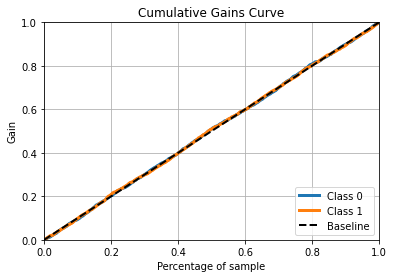

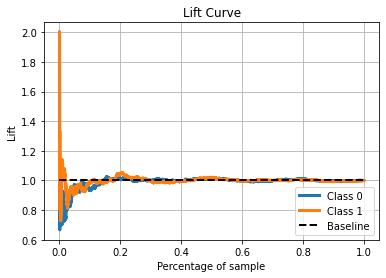

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



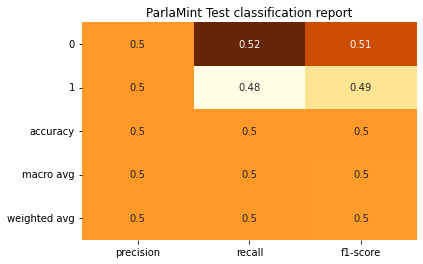


------------------------
  Confusion Matrix
------------------------


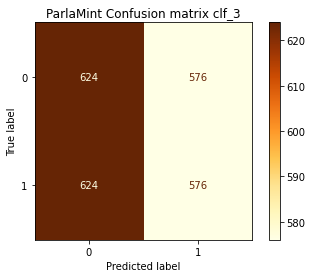

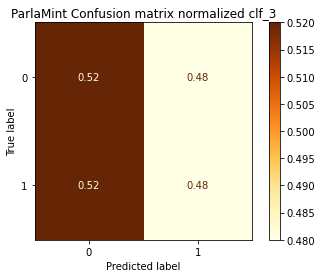

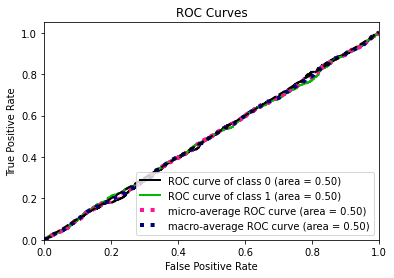

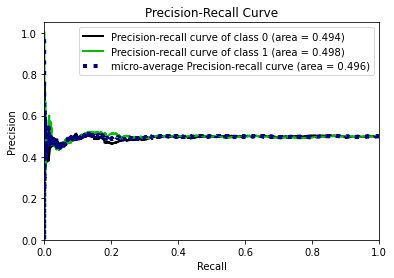

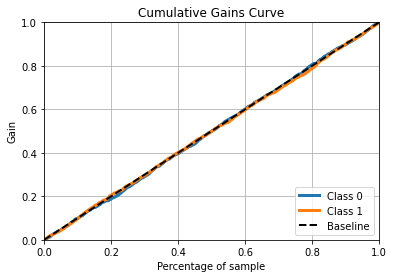

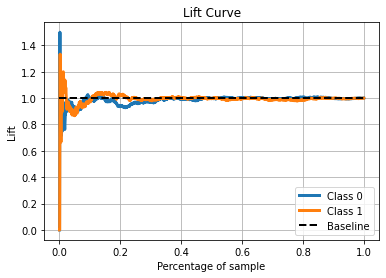

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.53      0.51      1200
           1       0.49      0.45      0.47      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



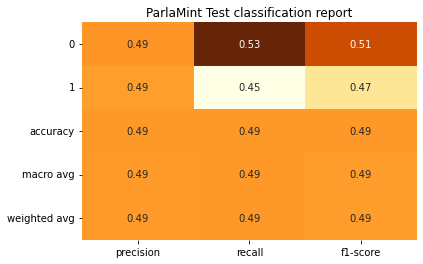


------------------------
  Confusion Matrix
------------------------


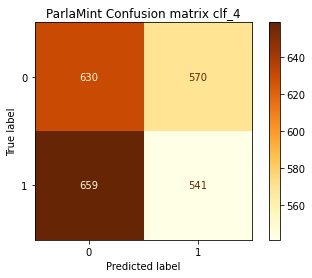

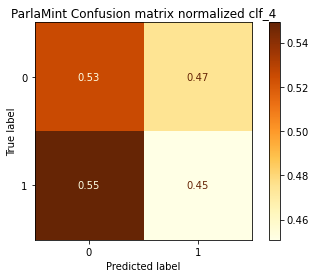

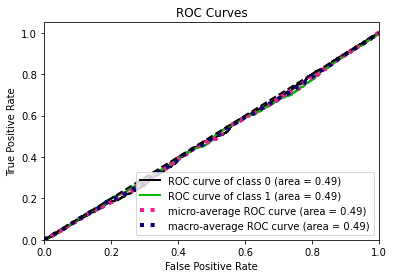

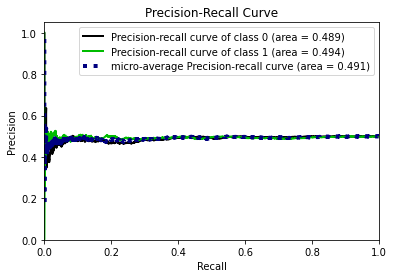

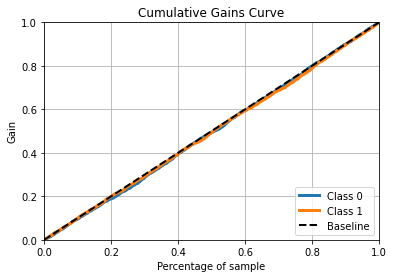

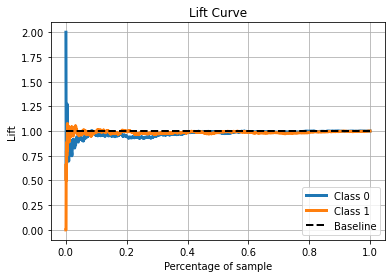

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.53      0.52      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



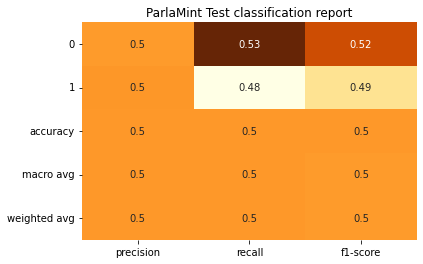


------------------------
  Confusion Matrix
------------------------


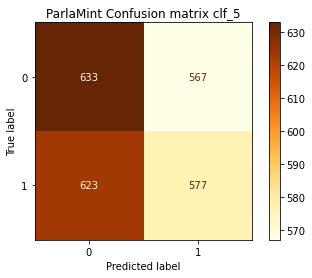

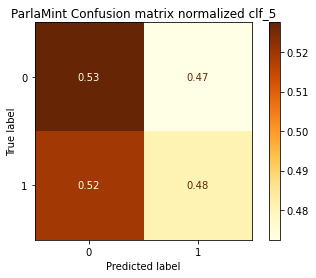

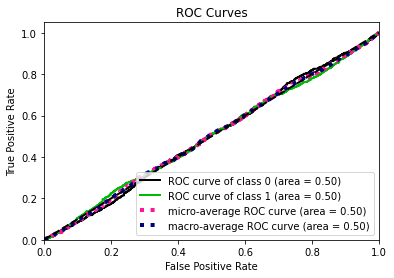

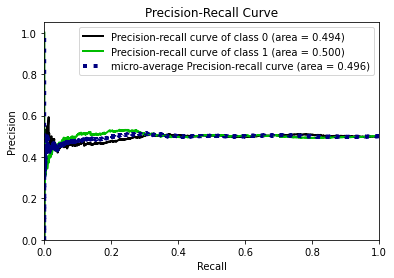

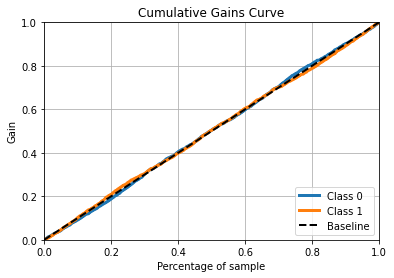

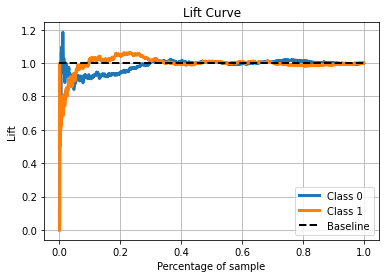

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.51      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



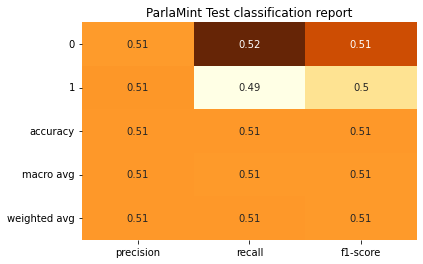


------------------------
  Confusion Matrix
------------------------


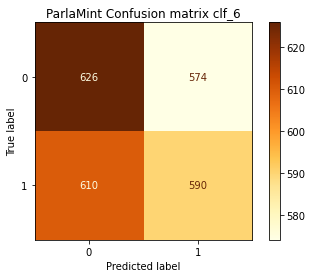

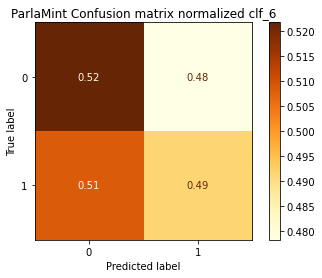

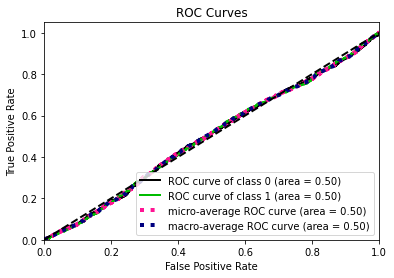

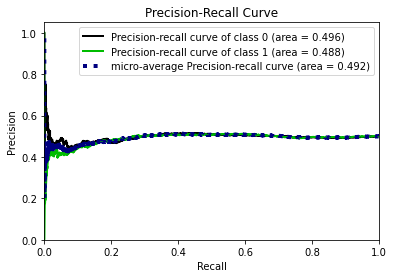

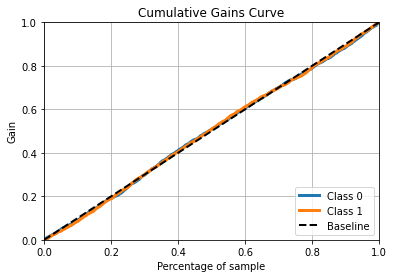

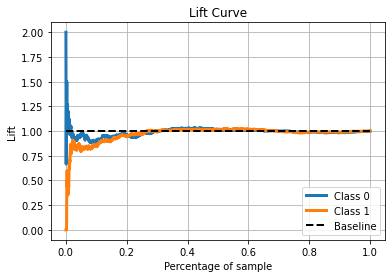

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



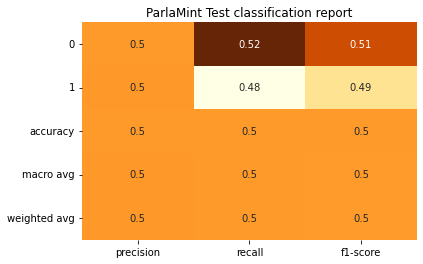


------------------------
  Confusion Matrix
------------------------


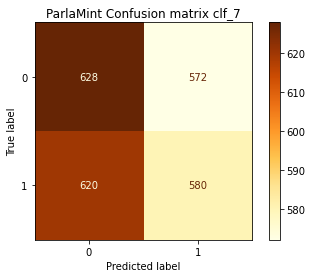

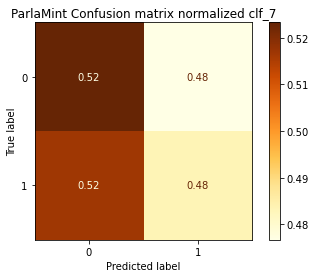

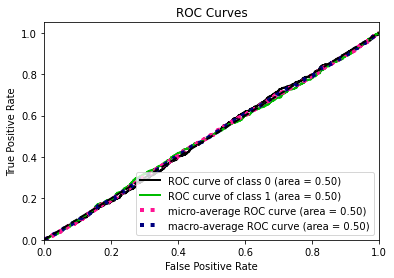

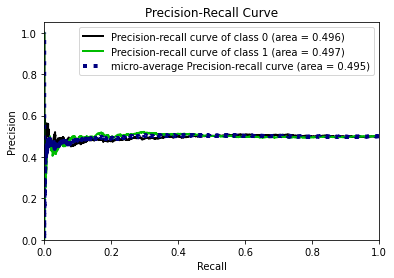

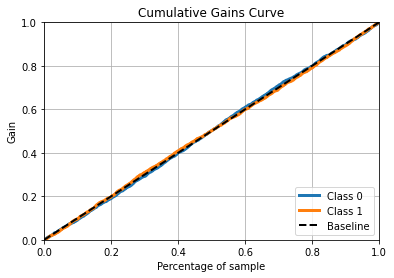

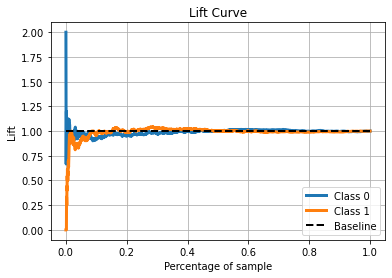

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.48      0.49      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



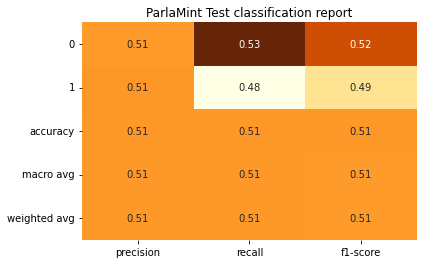


------------------------
  Confusion Matrix
------------------------


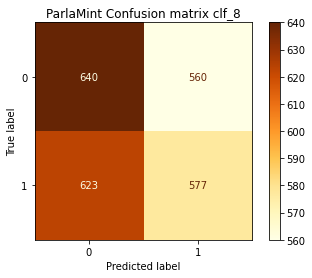

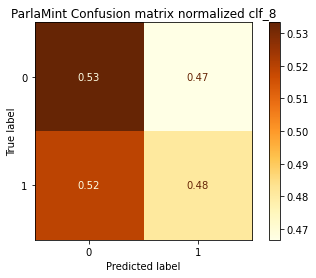

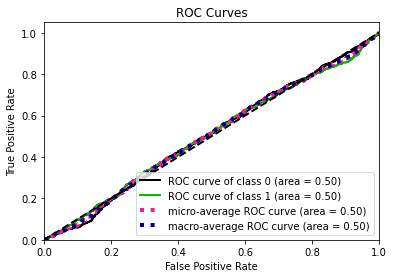

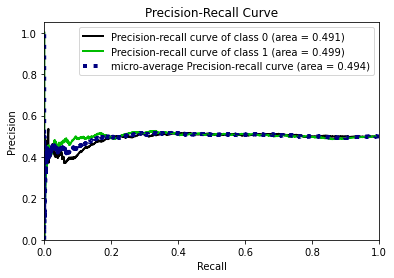

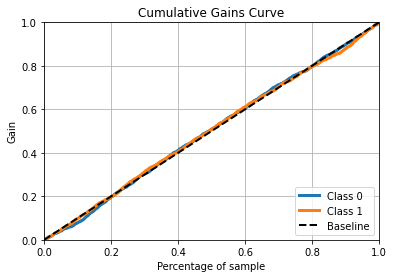

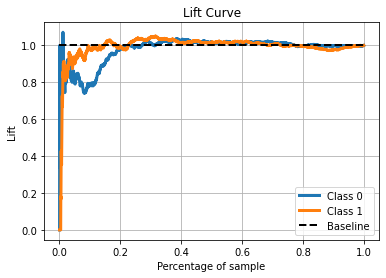

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.53      0.51      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



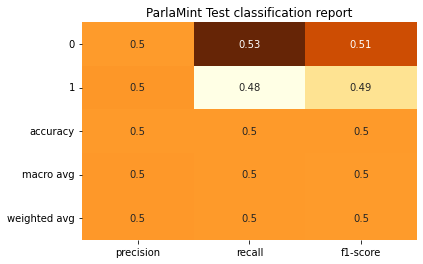


------------------------
  Confusion Matrix
------------------------


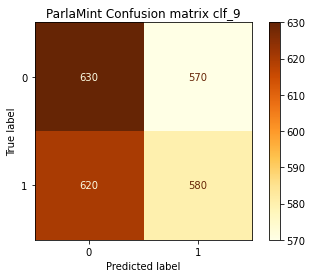

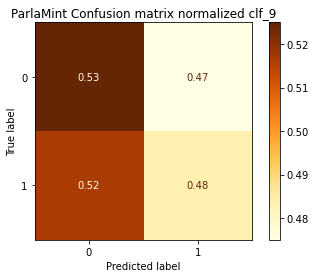

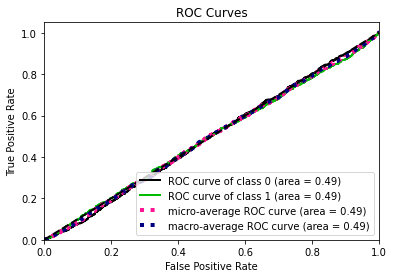

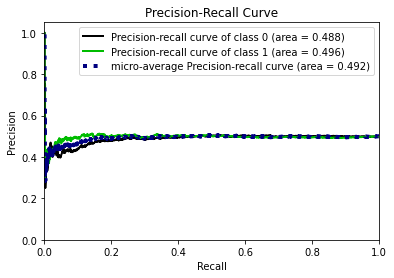

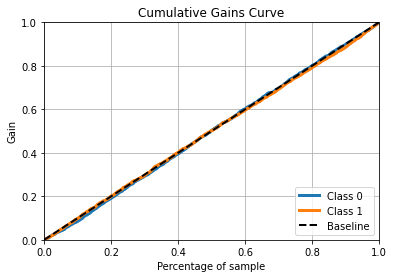

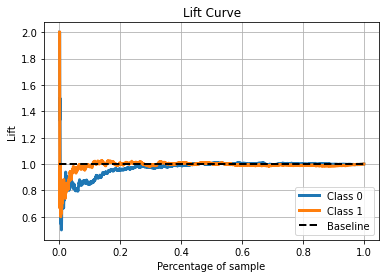

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



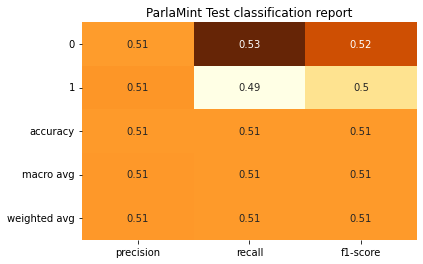


------------------------
  Confusion Matrix
------------------------


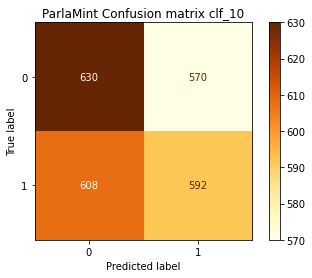

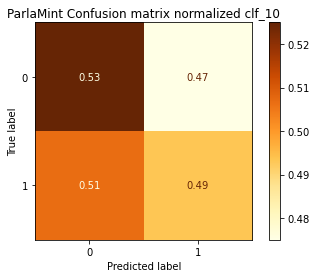

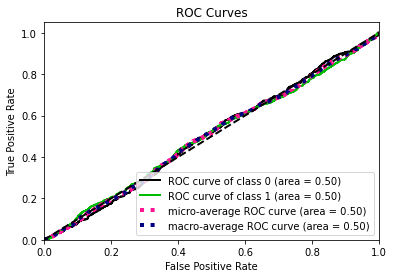

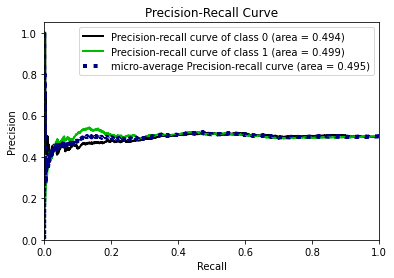

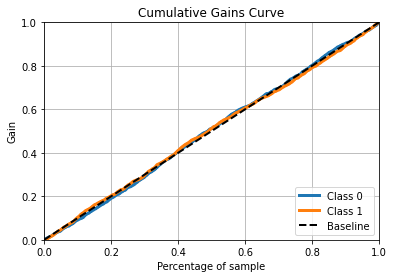

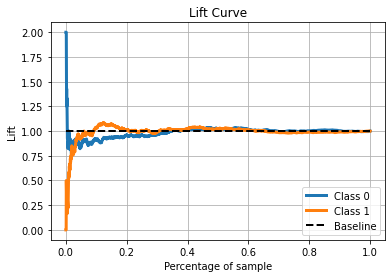

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.50      2400
weighted avg       0.51      0.51      0.50      2400



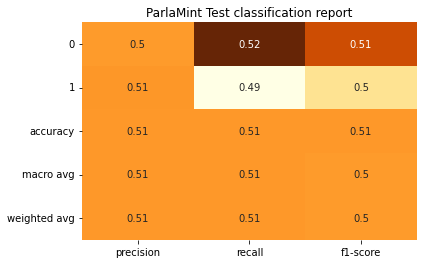


------------------------
  Confusion Matrix
------------------------


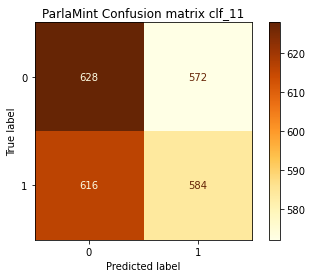

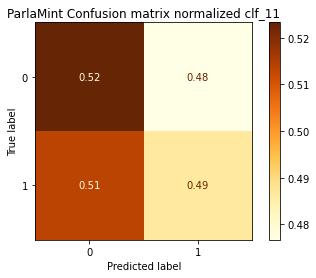

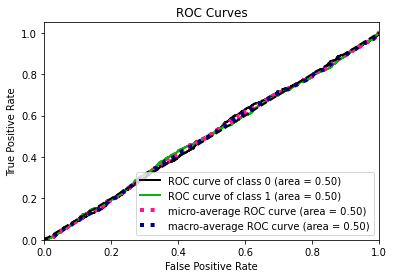

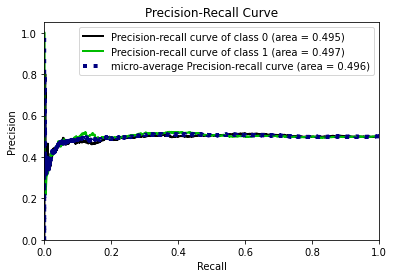

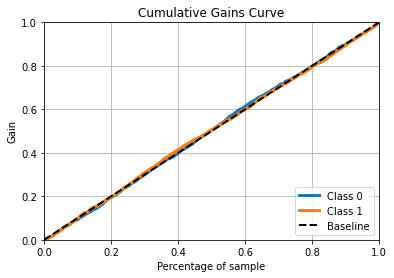

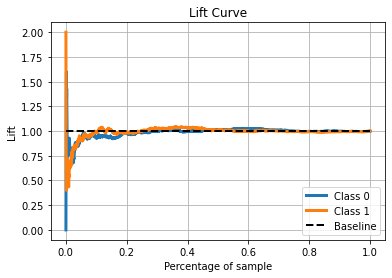

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.54      0.52      1200
           1       0.51      0.48      0.49      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



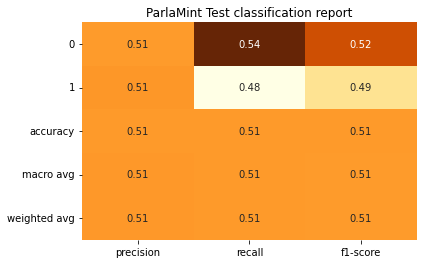


------------------------
  Confusion Matrix
------------------------


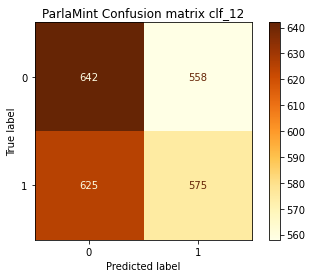

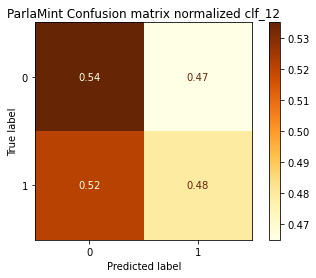

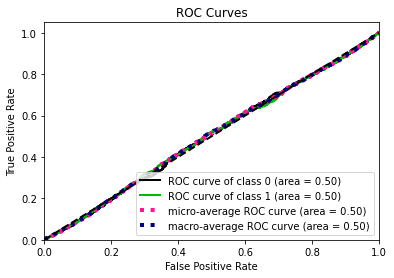

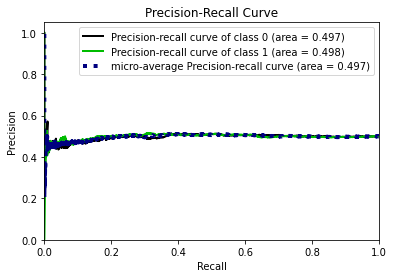

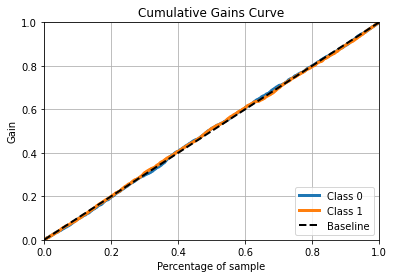

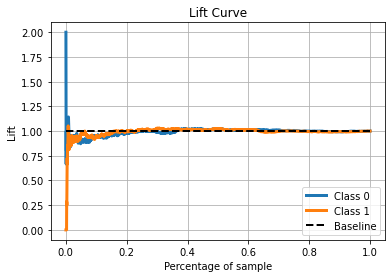

------------------------------------------------------------------------------------------------


In [77]:
lista_cm_normalizzate_svm_10_no_pretrain, lista_clf_report_10_no_pretrain = \
        plot_classification_results(diz_dist_10_svm_no_pretrain['df_dist_10'], False, diz_cmap['10'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.51      0.51      1200
           1       0.51      0.52      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



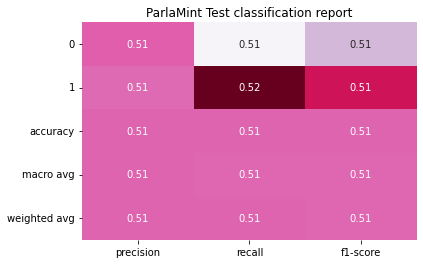


------------------------
  Confusion Matrix
------------------------


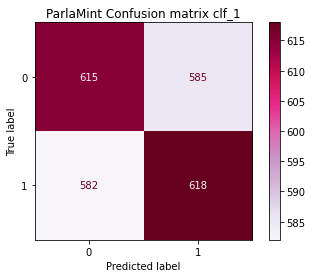

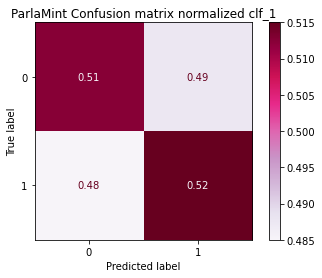

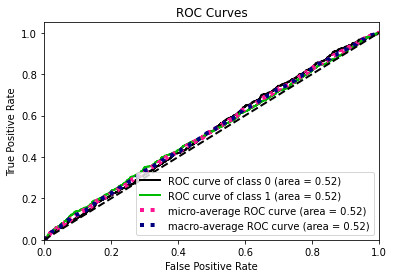

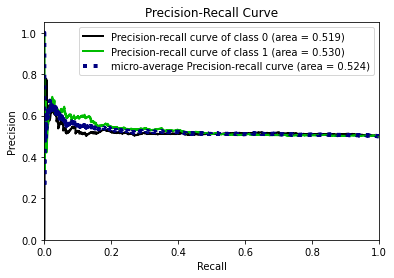

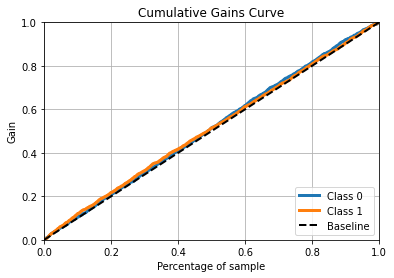

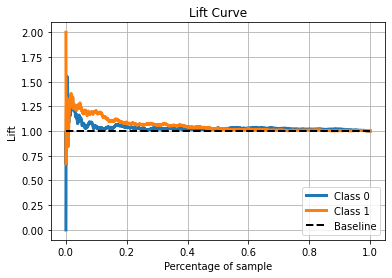

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.50      0.50      1200
           1       0.50      0.49      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



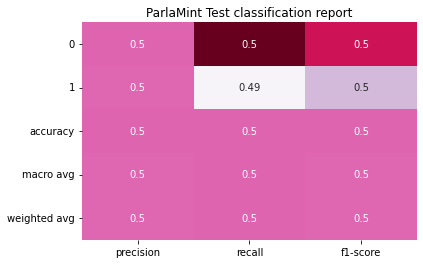


------------------------
  Confusion Matrix
------------------------


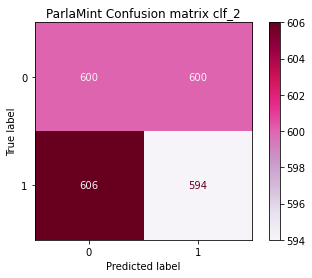

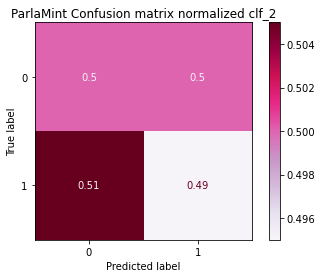

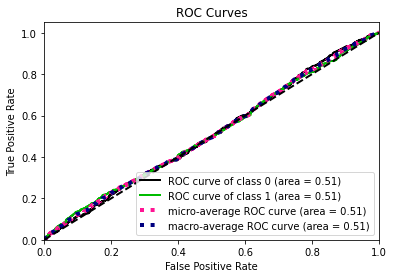

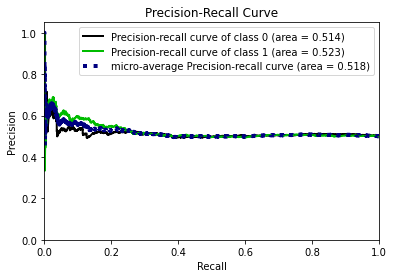

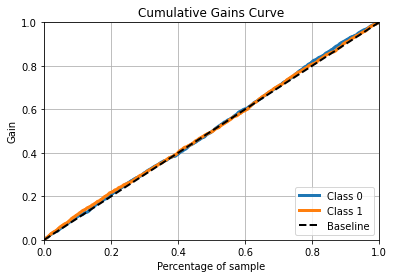

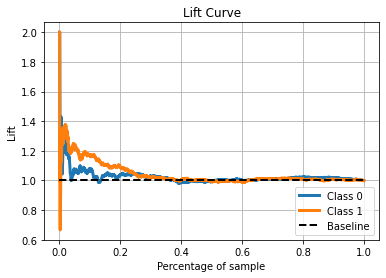

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.54      0.53      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.52      0.52      2400
weighted avg       0.53      0.53      0.52      2400



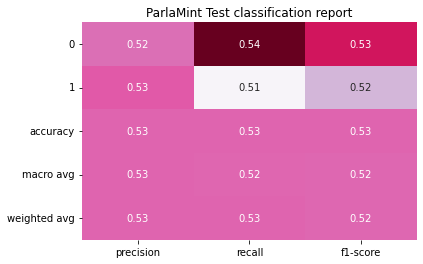


------------------------
  Confusion Matrix
------------------------


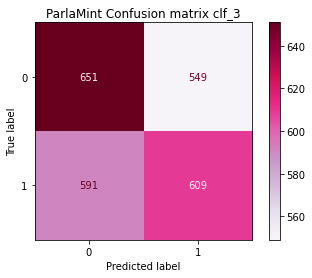

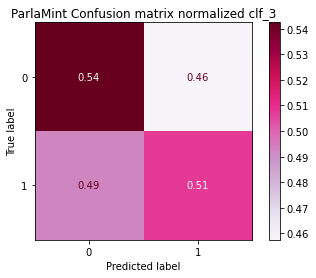

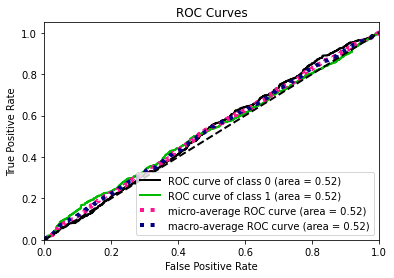

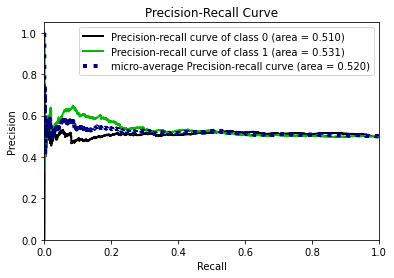

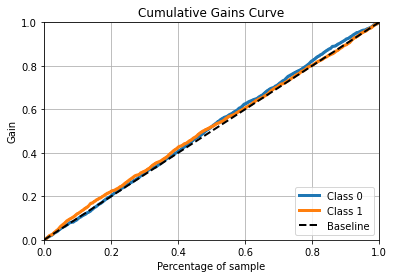

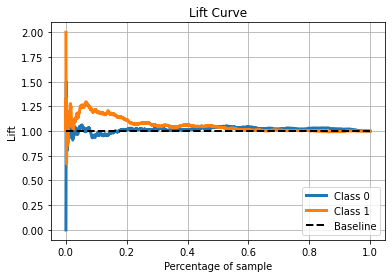

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.50      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



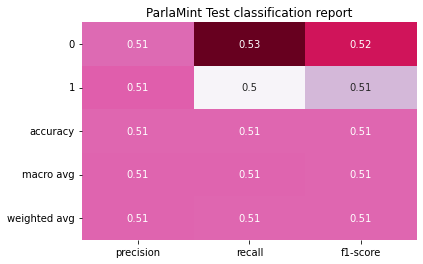


------------------------
  Confusion Matrix
------------------------


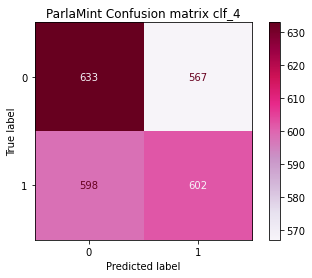

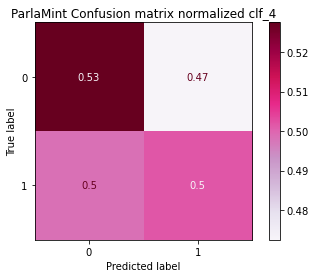

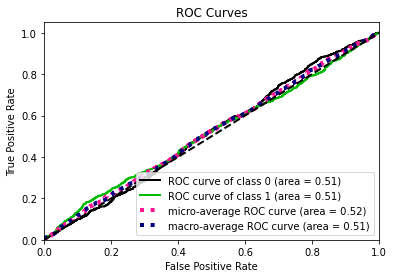

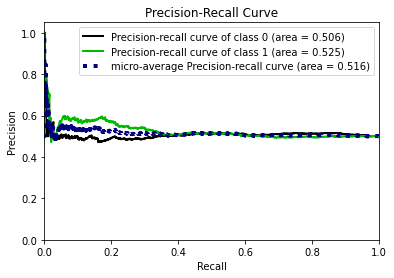

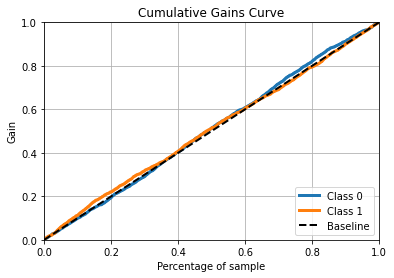

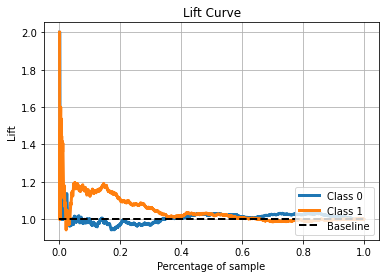

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.52      1200
           1       0.51      0.50      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



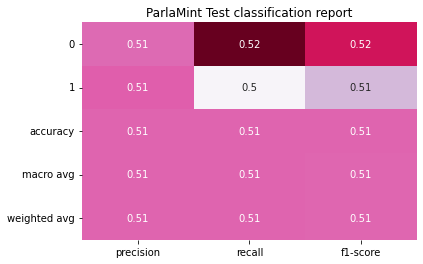


------------------------
  Confusion Matrix
------------------------


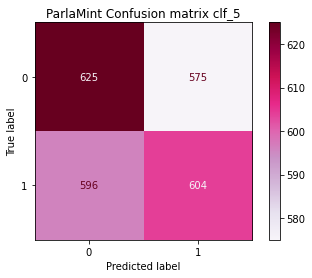

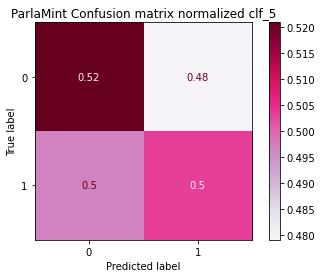

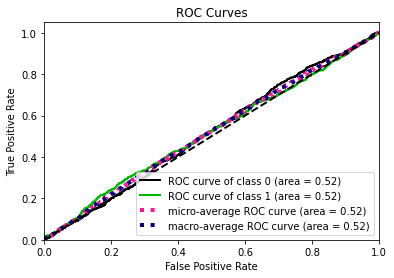

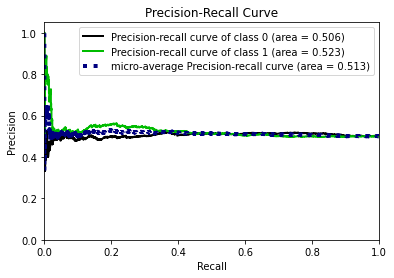

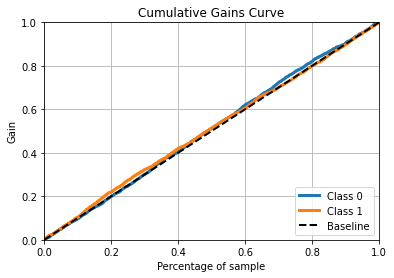

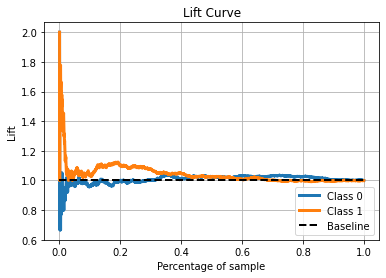

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.53      0.52      1200
           1       0.52      0.52      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



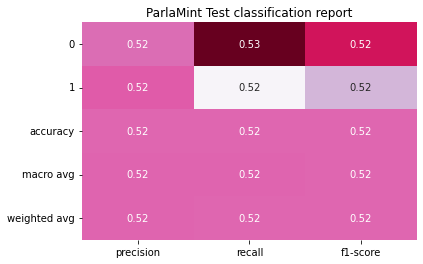


------------------------
  Confusion Matrix
------------------------


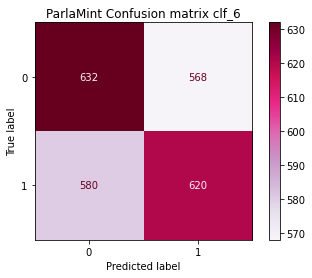

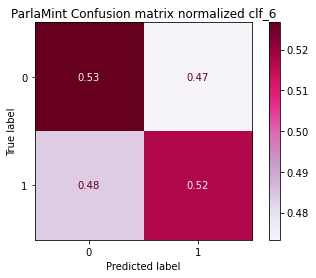

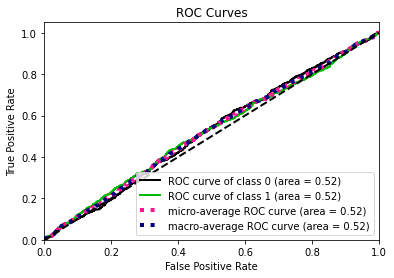

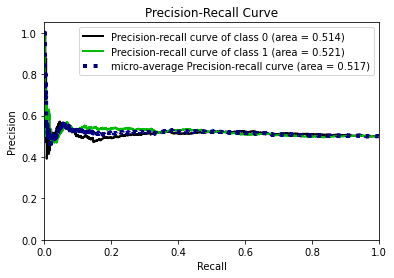

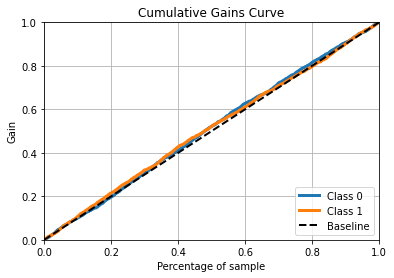

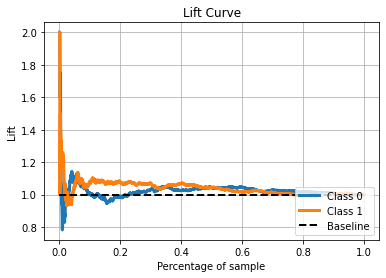

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.52      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



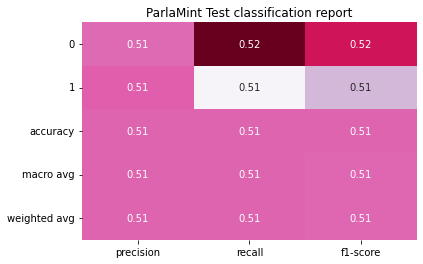


------------------------
  Confusion Matrix
------------------------


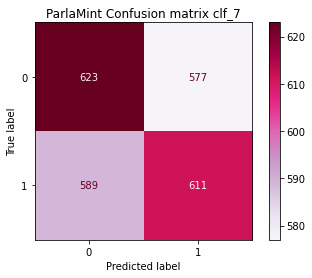

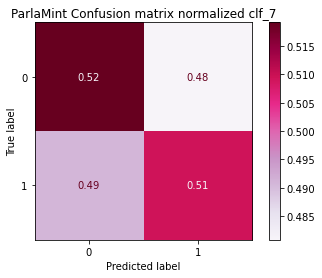

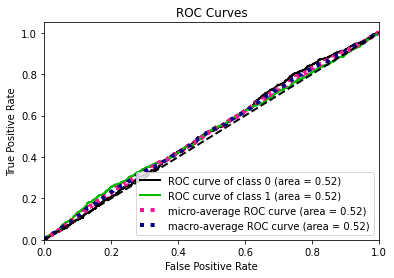

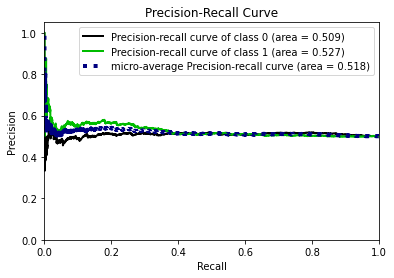

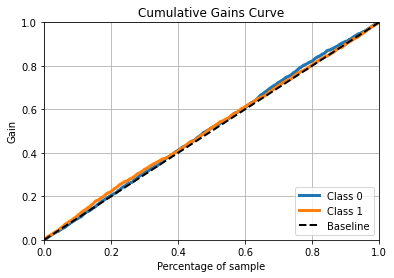

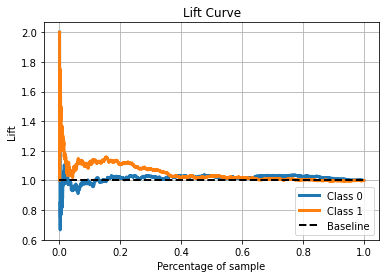

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



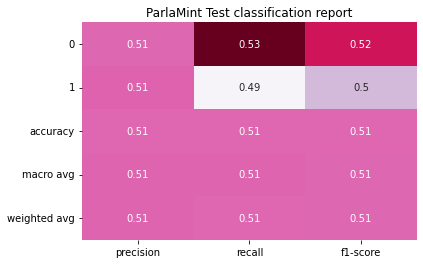


------------------------
  Confusion Matrix
------------------------


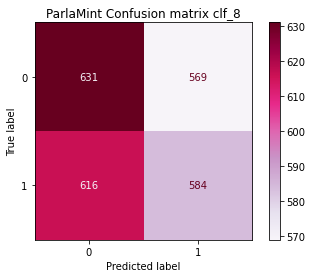

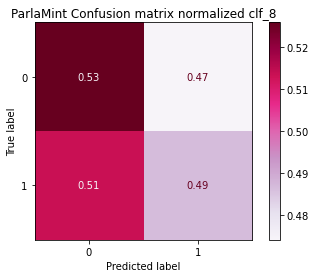

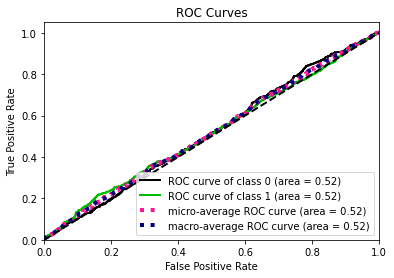

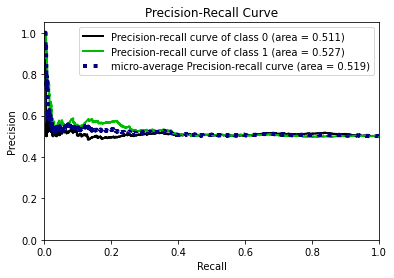

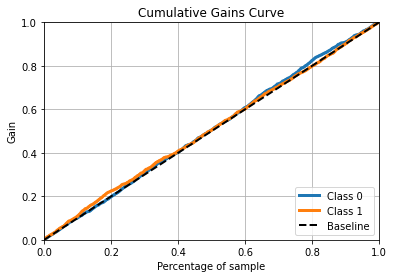

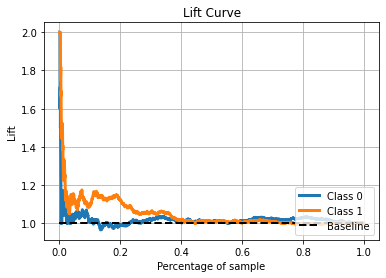

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.48      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



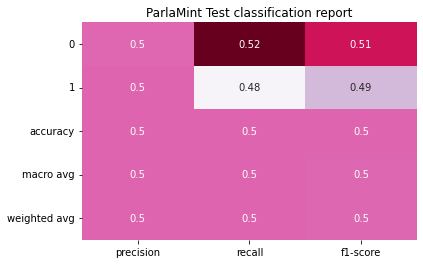


------------------------
  Confusion Matrix
------------------------


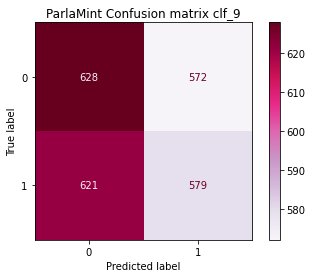

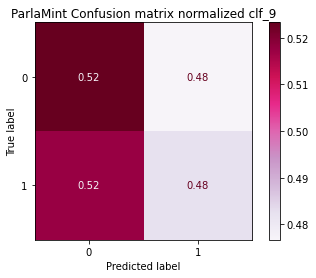

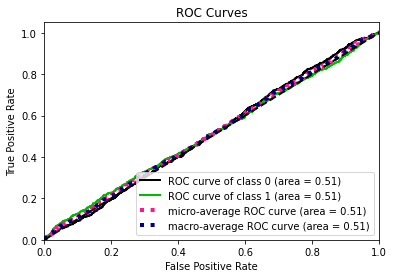

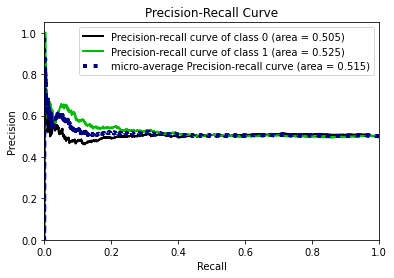

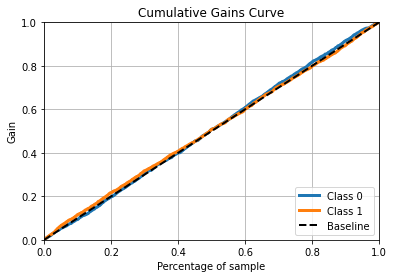

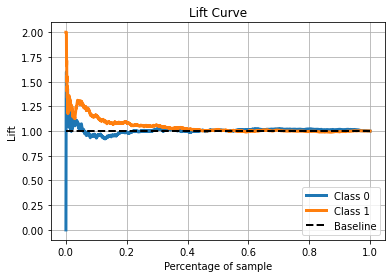

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.52      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



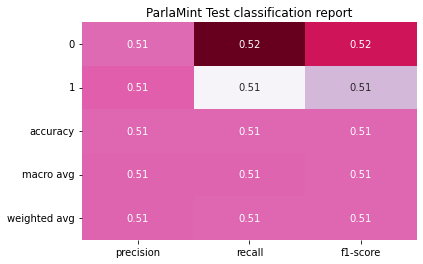


------------------------
  Confusion Matrix
------------------------


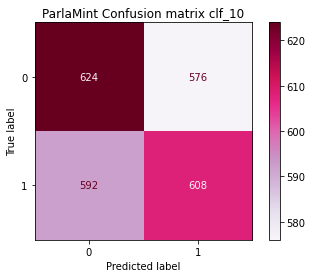

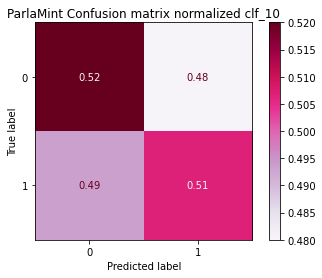

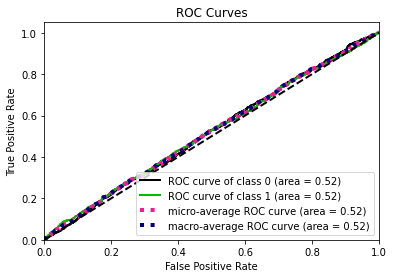

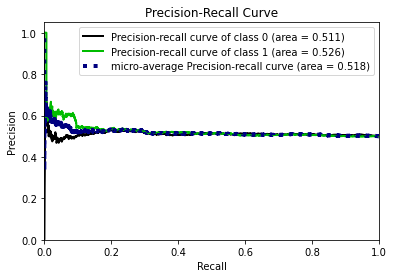

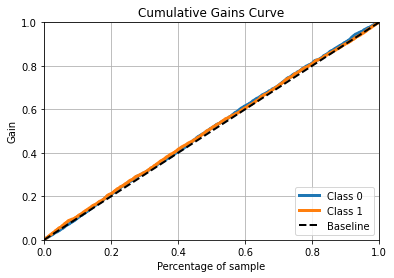

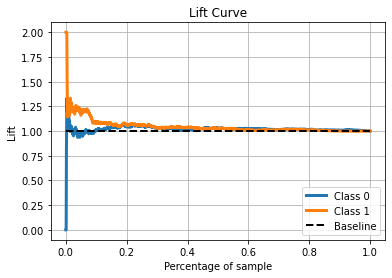

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.52      0.52      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



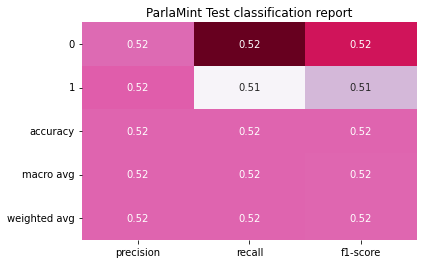


------------------------
  Confusion Matrix
------------------------


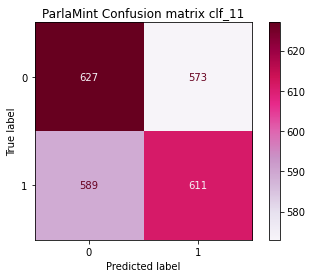

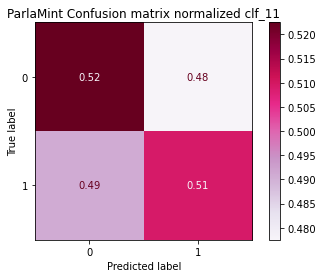

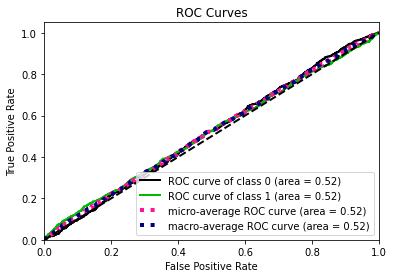

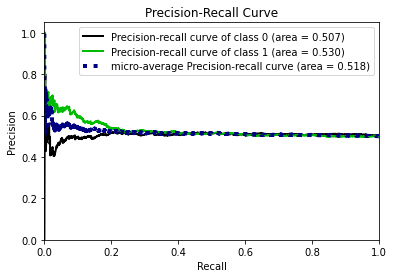

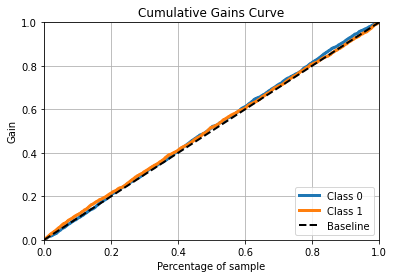

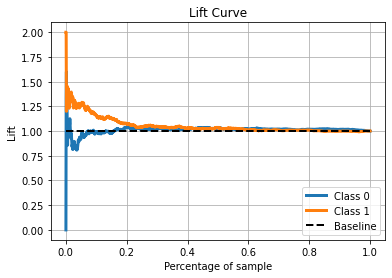

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.53      0.52      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



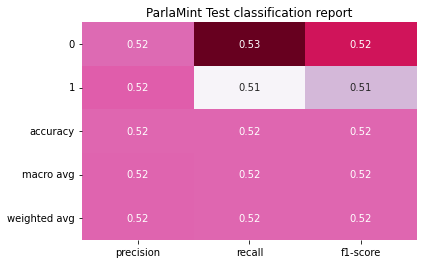


------------------------
  Confusion Matrix
------------------------


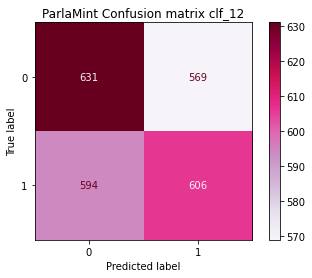

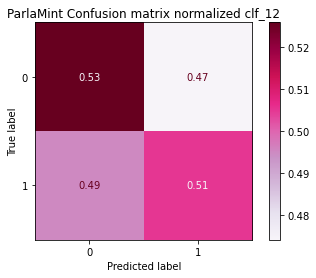

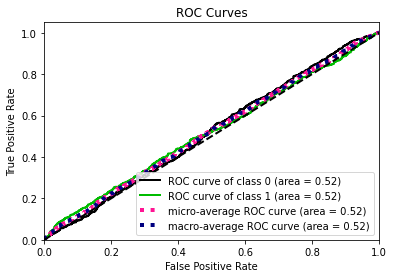

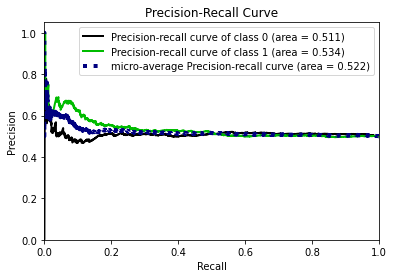

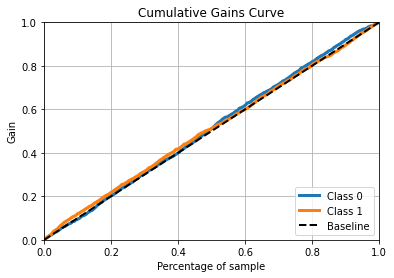

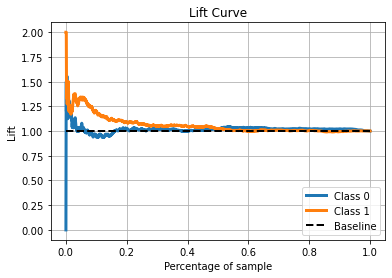

------------------------------------------------------------------------------------------------


In [78]:
lista_cm_normalizzate_svm_20_no_pretrain, lista_clf_report_20_no_pretrain = \
        plot_classification_results(diz_dist_20_svm_no_pretrain['df_dist_20'], False, diz_cmap['20'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.55      0.54      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



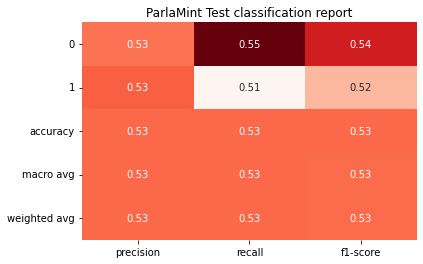


------------------------
  Confusion Matrix
------------------------


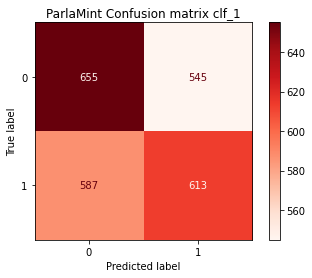

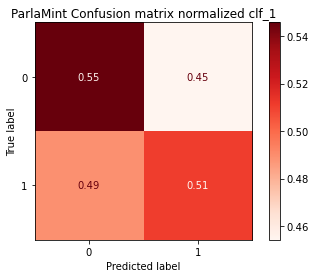

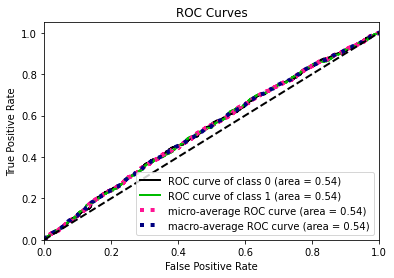

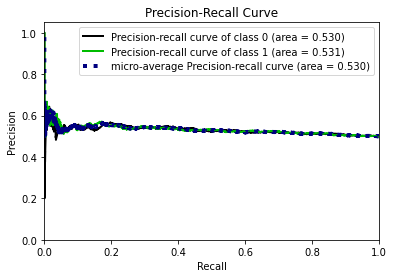

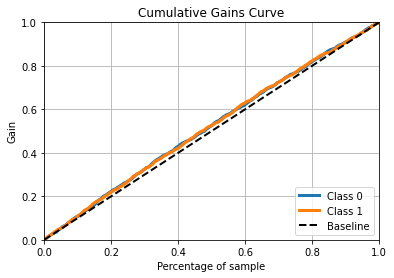

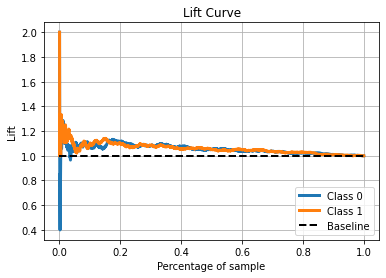

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.54      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



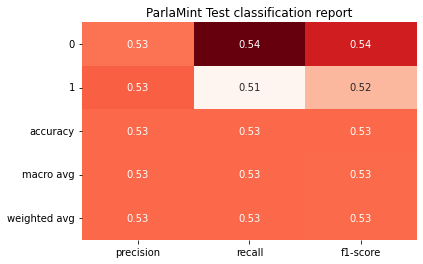


------------------------
  Confusion Matrix
------------------------


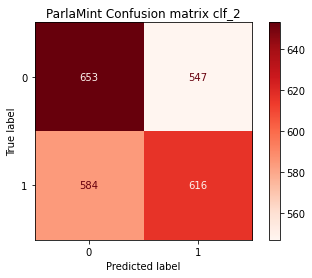

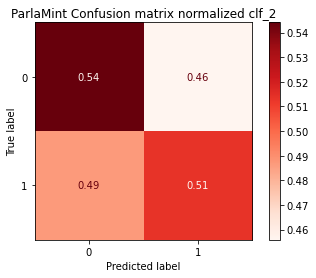

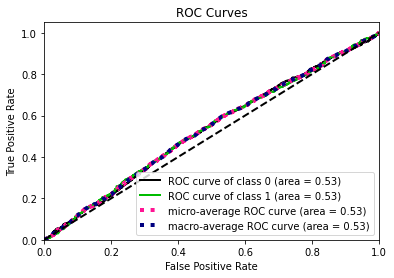

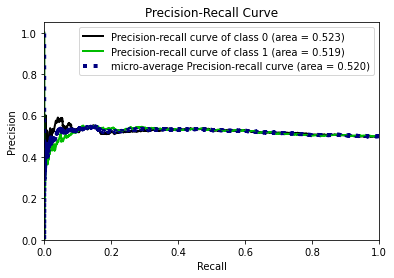

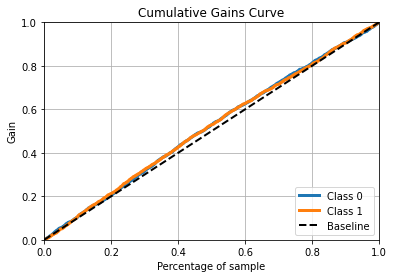

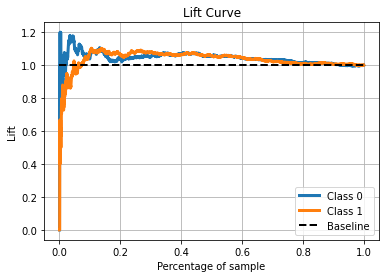

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.52      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.51      2400
weighted avg       0.52      0.52      0.51      2400



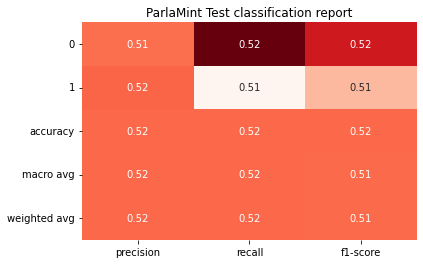


------------------------
  Confusion Matrix
------------------------


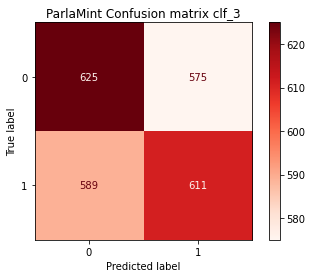

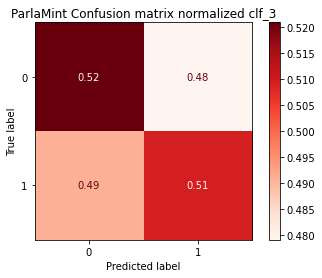

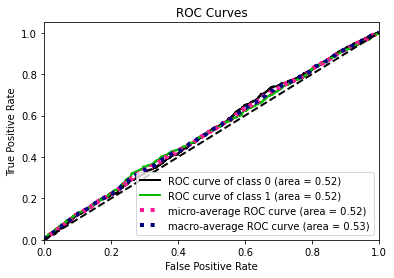

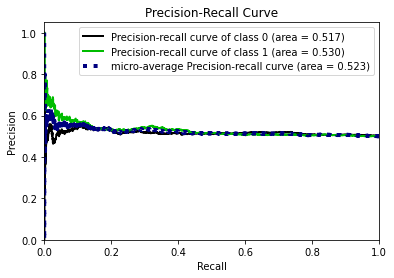

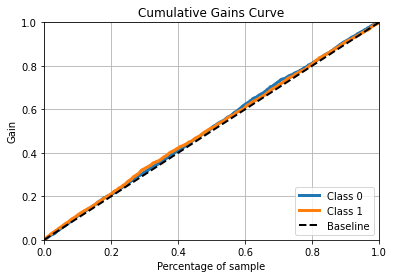

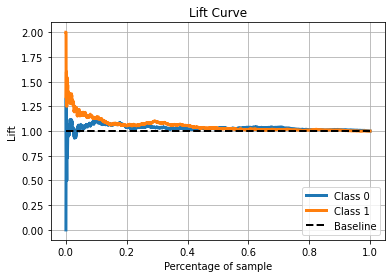

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



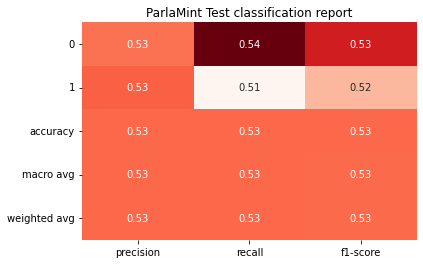


------------------------
  Confusion Matrix
------------------------


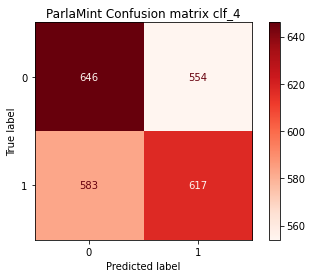

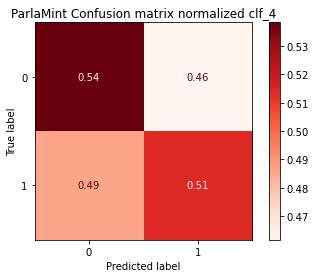

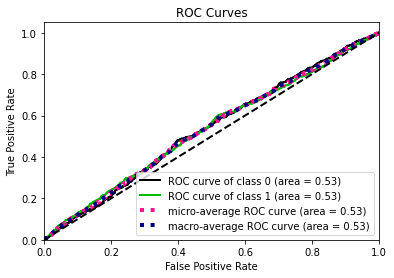

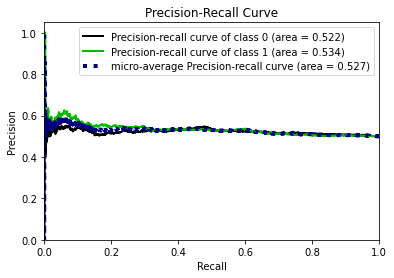

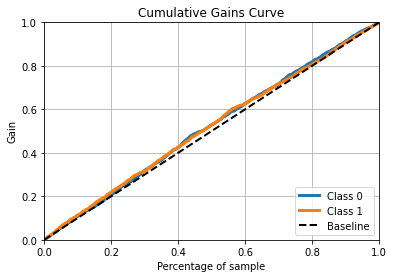

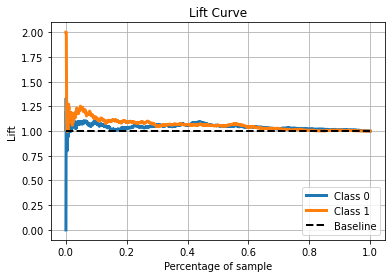

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.51      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



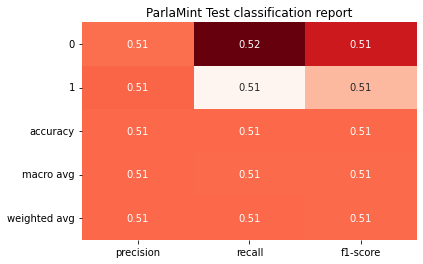


------------------------
  Confusion Matrix
------------------------


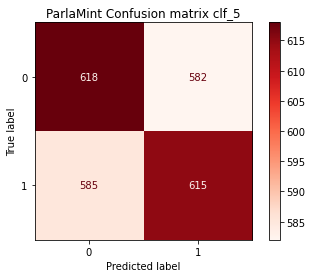

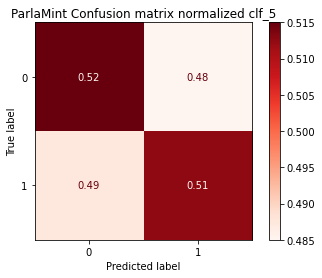

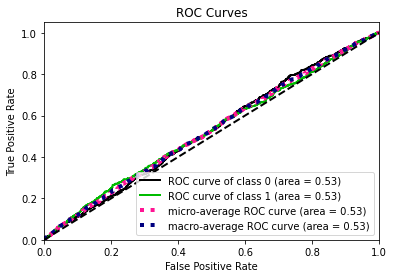

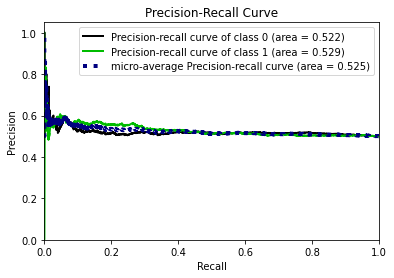

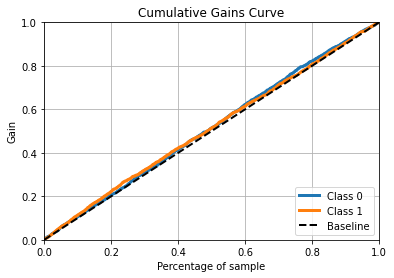

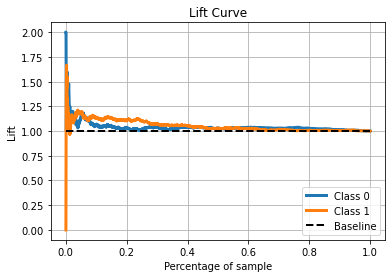

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.54      0.53      1200
           1       0.52      0.50      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



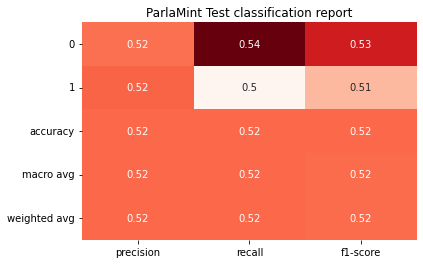


------------------------
  Confusion Matrix
------------------------


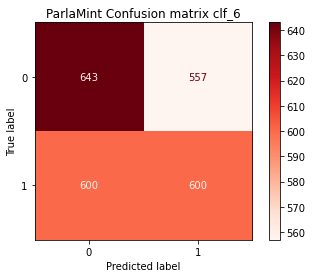

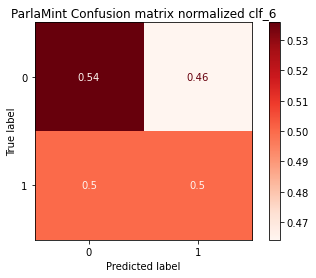

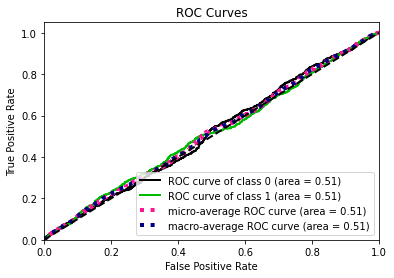

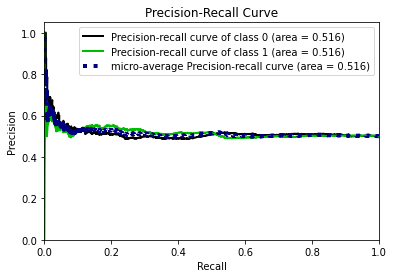

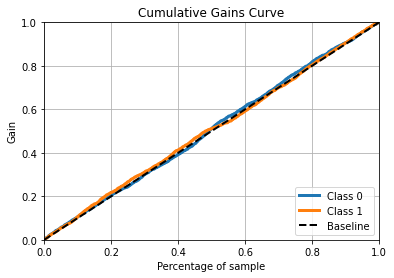

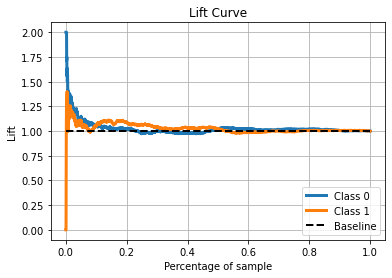

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.50      2400
weighted avg       0.51      0.51      0.50      2400



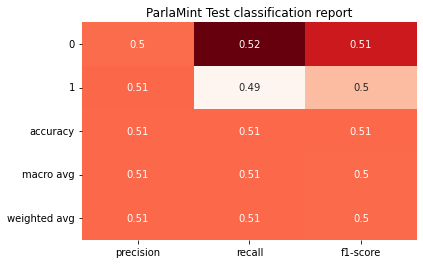


------------------------
  Confusion Matrix
------------------------


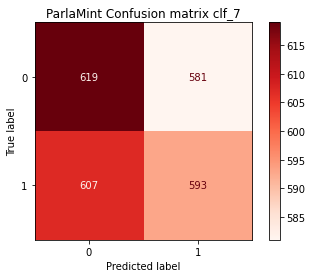

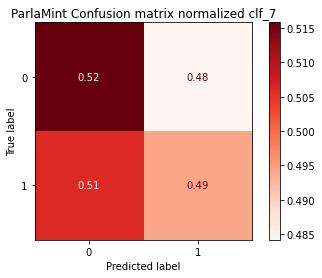

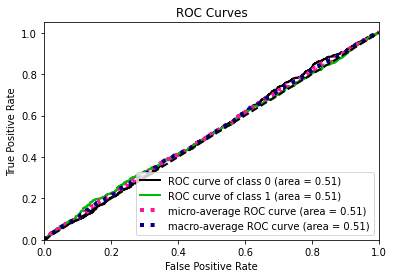

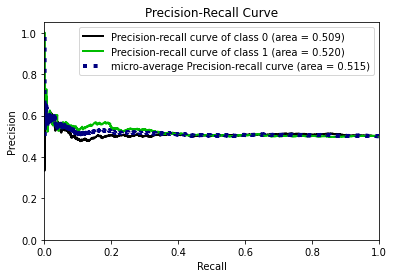

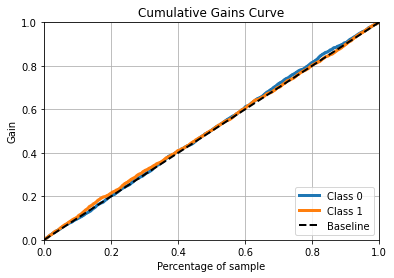

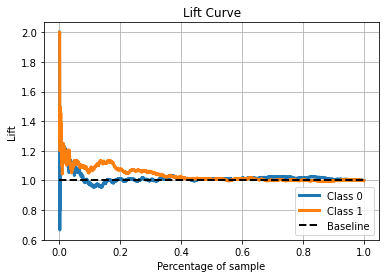

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.53      0.53      1200
           1       0.52      0.50      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



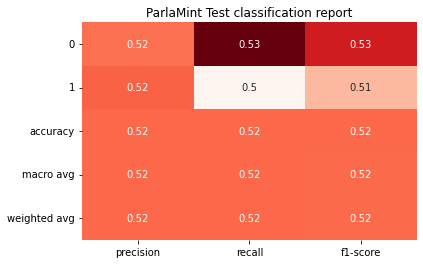


------------------------
  Confusion Matrix
------------------------


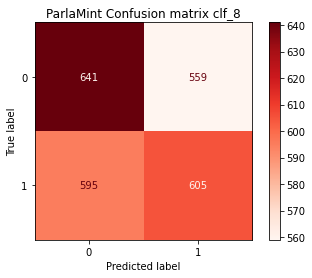

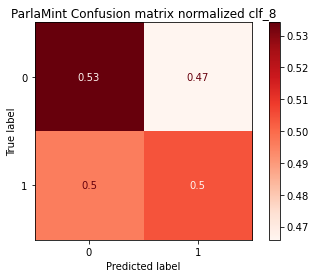

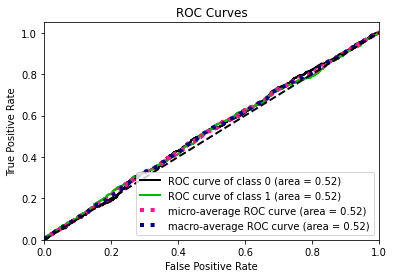

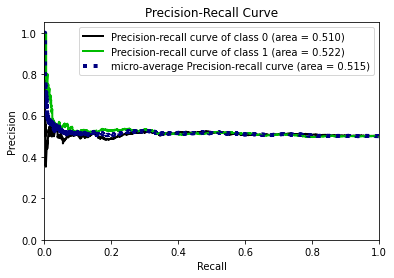

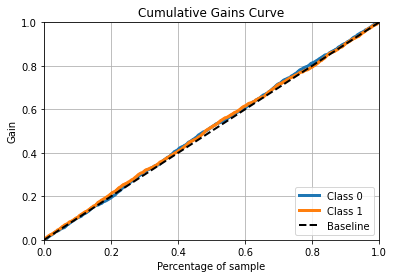

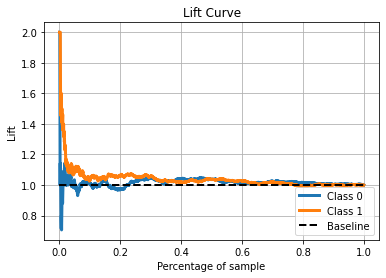

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



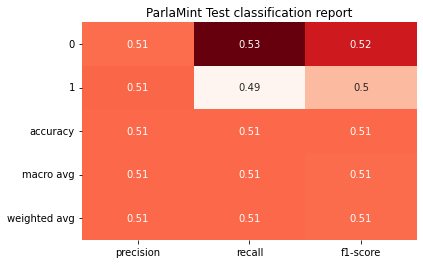


------------------------
  Confusion Matrix
------------------------


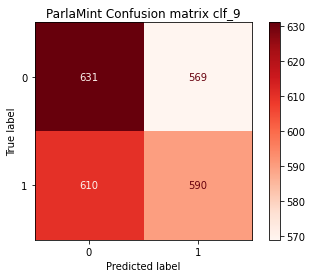

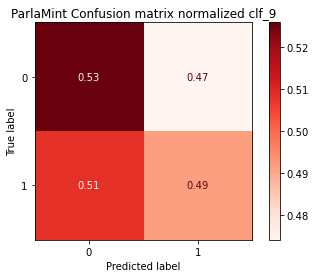

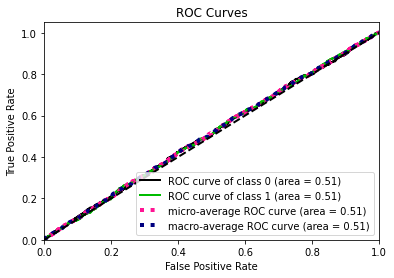

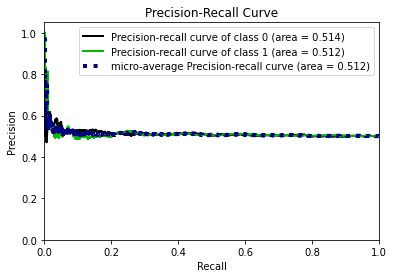

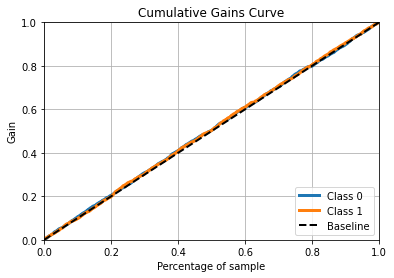

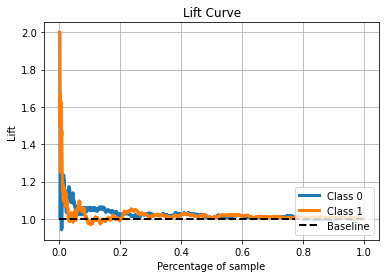

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.51      1200
           1       0.51      0.50      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



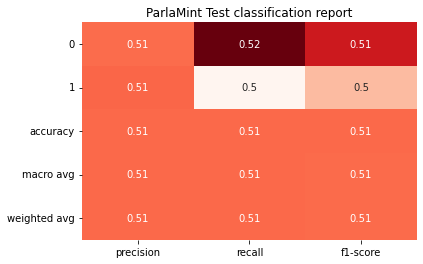


------------------------
  Confusion Matrix
------------------------


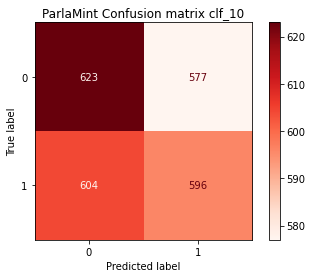

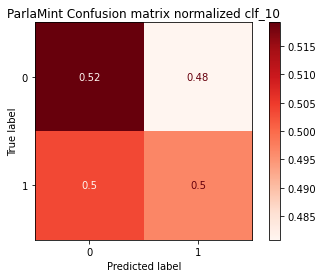

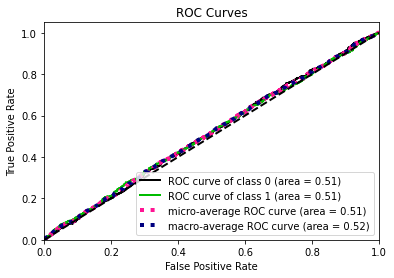

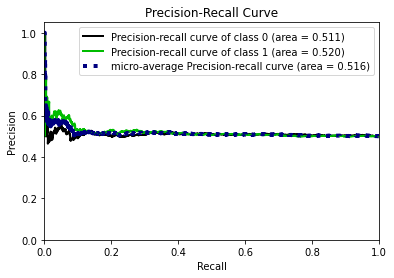

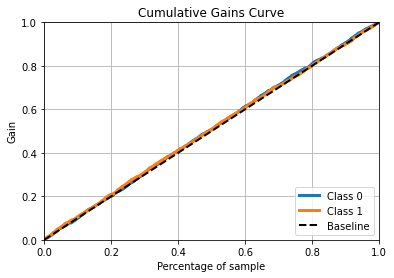

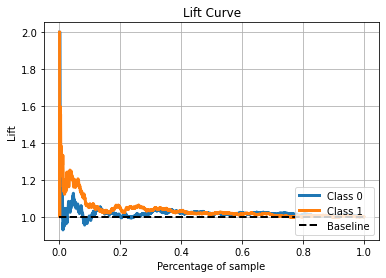

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.51      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



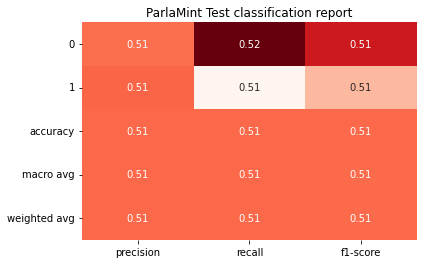


------------------------
  Confusion Matrix
------------------------


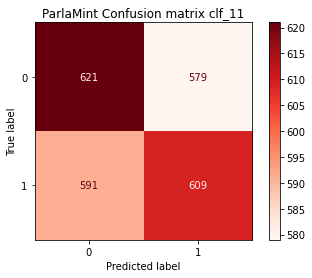

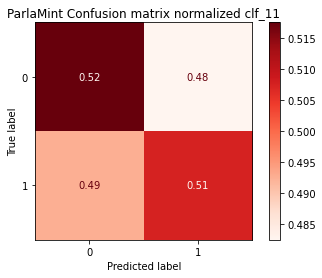

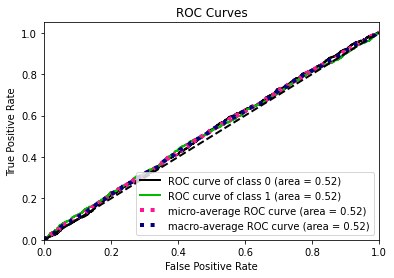

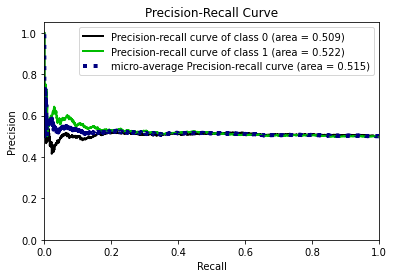

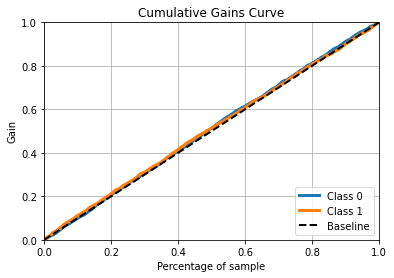

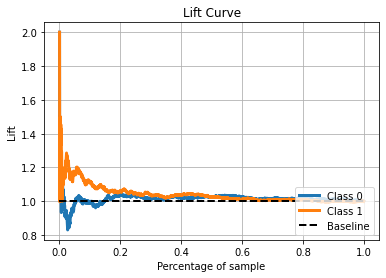

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.51      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



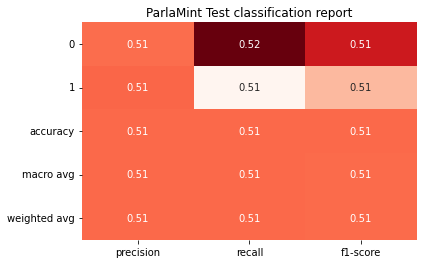


------------------------
  Confusion Matrix
------------------------


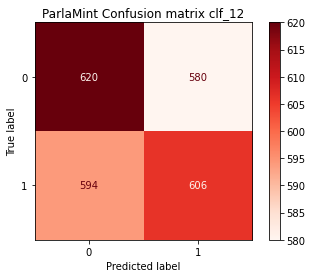

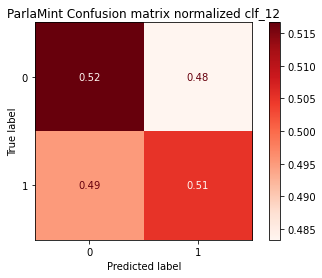

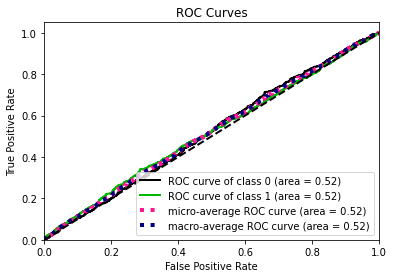

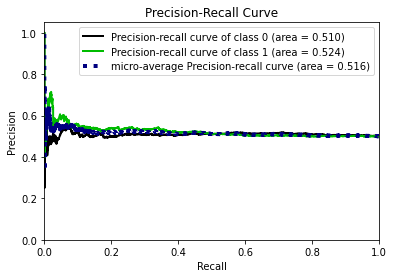

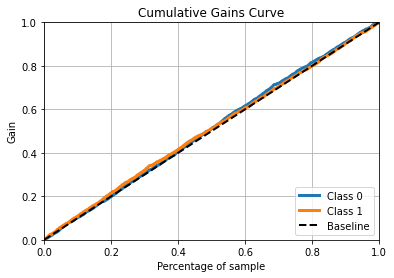

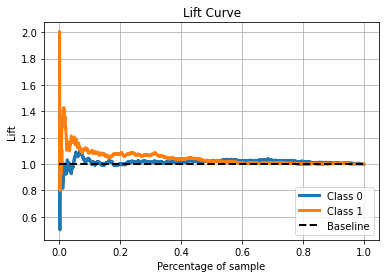

------------------------------------------------------------------------------------------------


In [79]:
lista_cm_normalizzate_svm_30_no_pretrain, lista_clf_report_30_no_pretrain = \
        plot_classification_results(diz_dist_30_svm_no_pretrain['df_dist_30'], False, diz_cmap['30'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.67      0.63      1200
           1       0.62      0.55      0.59      1200

    accuracy                           0.61      2400
   macro avg       0.61      0.61      0.61      2400
weighted avg       0.61      0.61      0.61      2400



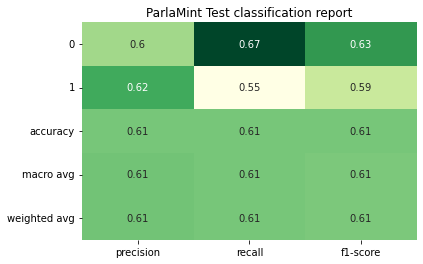


------------------------
  Confusion Matrix
------------------------


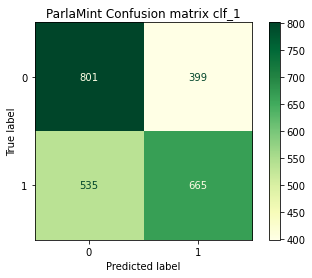

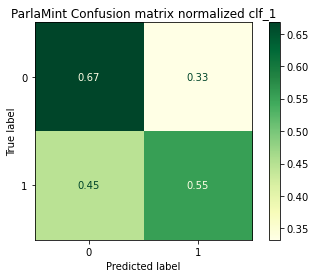

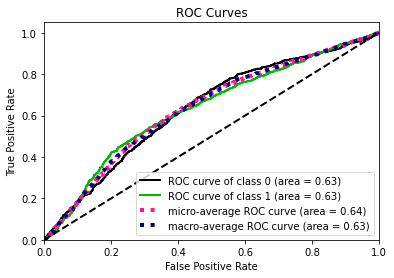

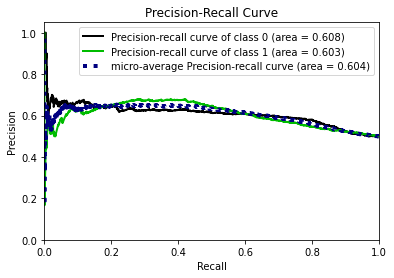

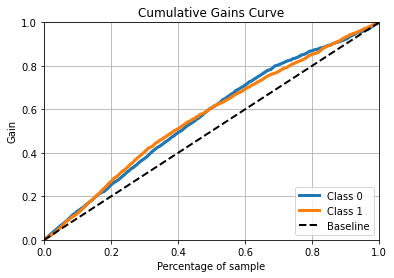

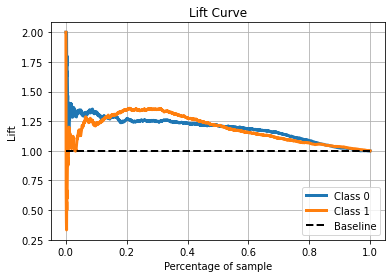

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.67      0.63      1200
           1       0.62      0.54      0.58      1200

    accuracy                           0.61      2400
   macro avg       0.61      0.61      0.61      2400
weighted avg       0.61      0.61      0.61      2400



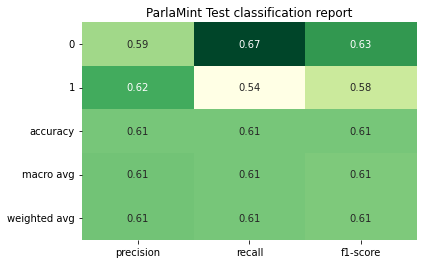


------------------------
  Confusion Matrix
------------------------


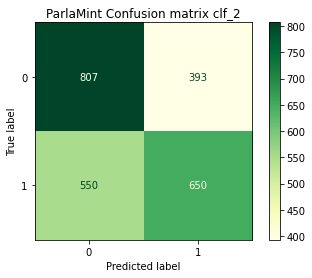

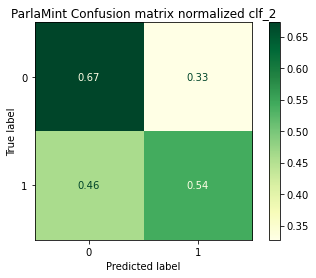

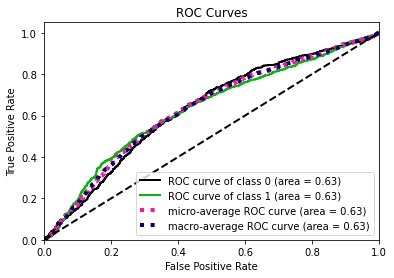

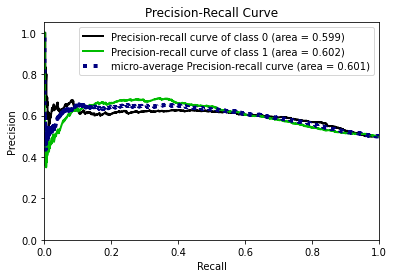

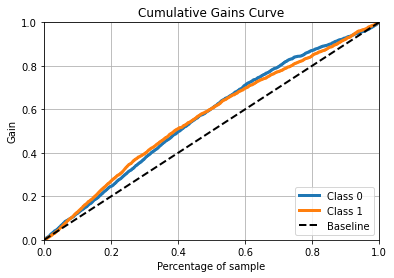

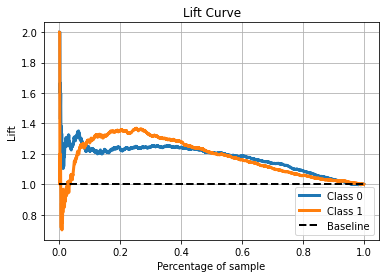

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.66      0.62      1200
           1       0.61      0.55      0.58      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



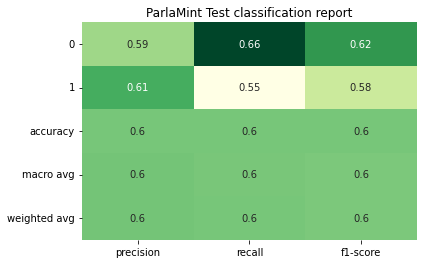


------------------------
  Confusion Matrix
------------------------


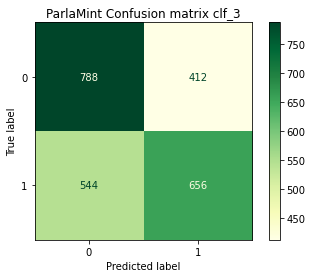

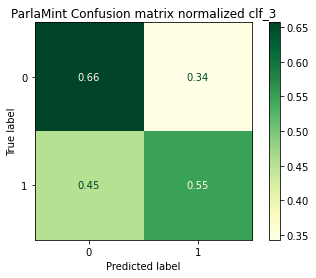

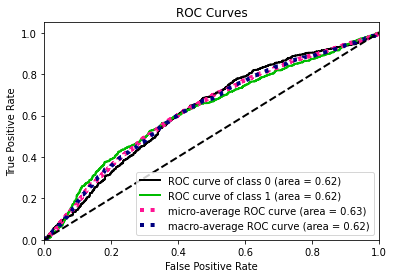

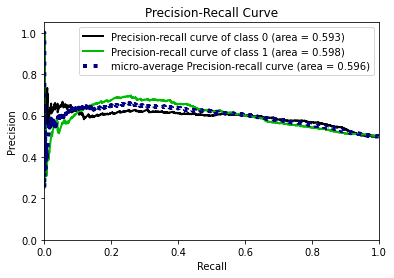

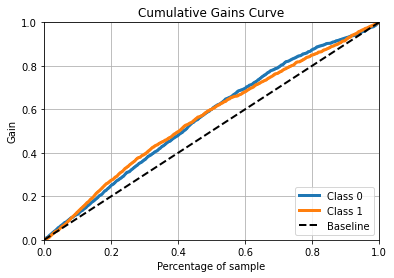

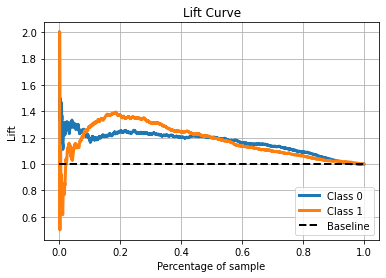

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.64      0.62      1200
           1       0.61      0.56      0.59      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



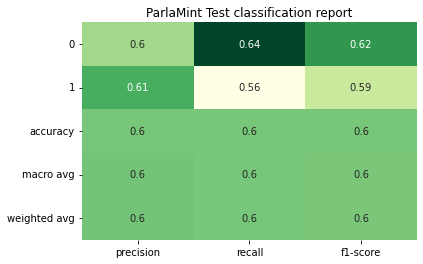


------------------------
  Confusion Matrix
------------------------


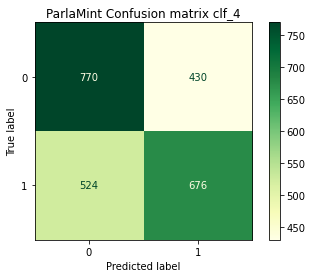

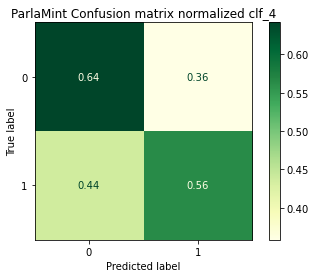

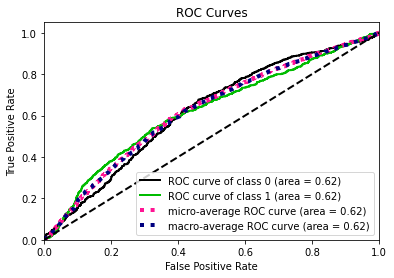

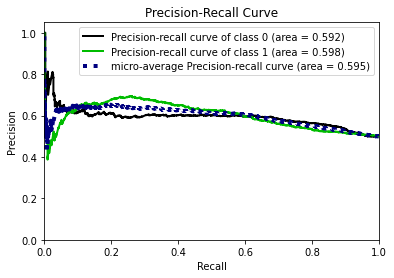

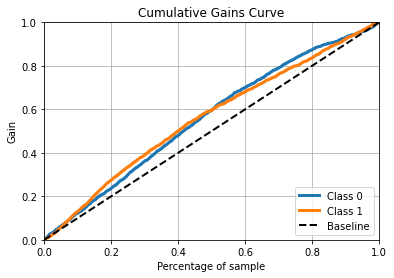

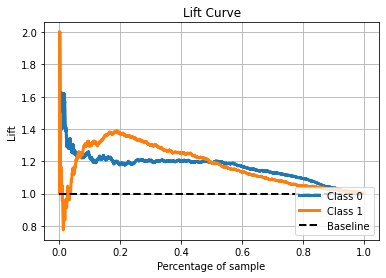

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.65      0.62      1200
           1       0.61      0.55      0.58      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



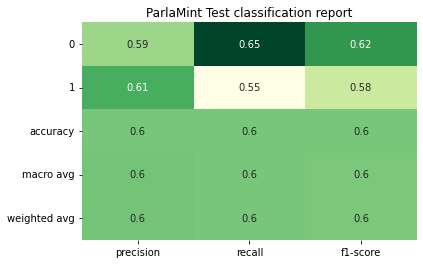


------------------------
  Confusion Matrix
------------------------


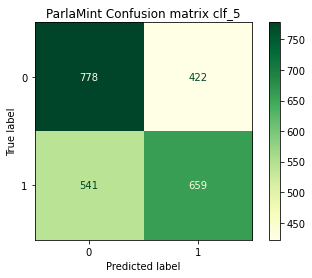

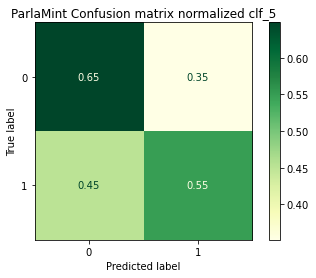

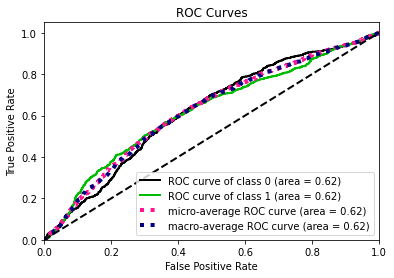

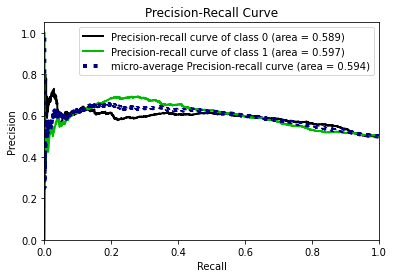

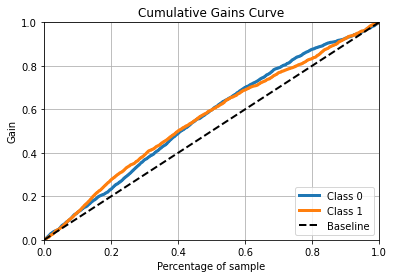

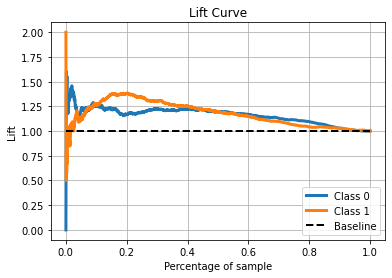

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.64      0.62      1200
           1       0.61      0.56      0.58      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



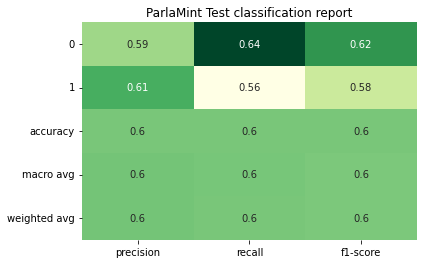


------------------------
  Confusion Matrix
------------------------


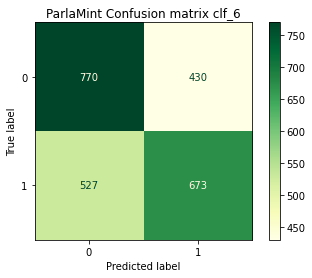

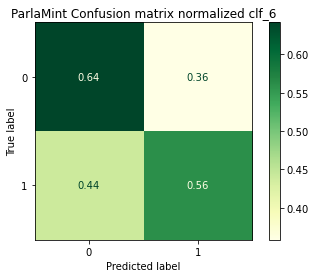

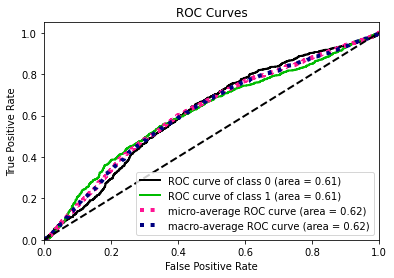

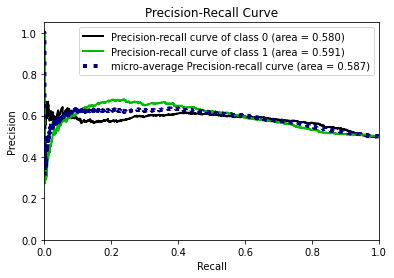

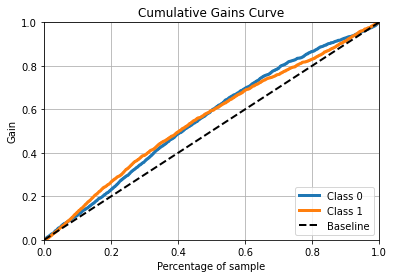

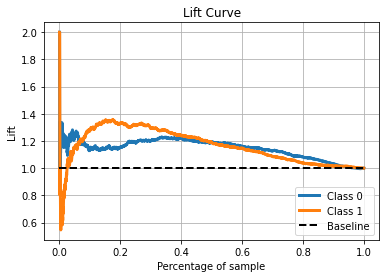

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.64      0.62      1200
           1       0.61      0.57      0.59      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



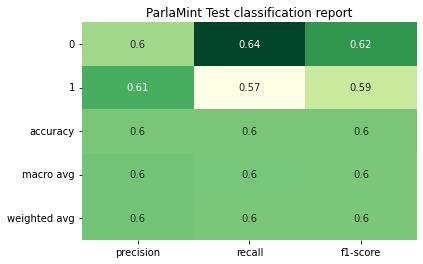


------------------------
  Confusion Matrix
------------------------


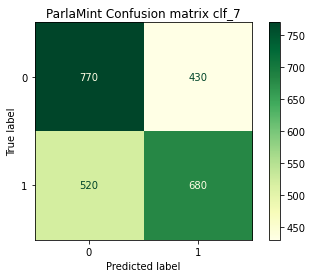

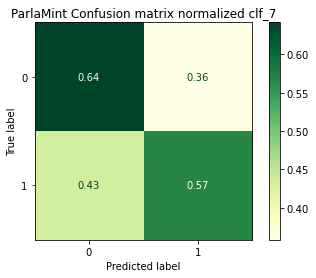

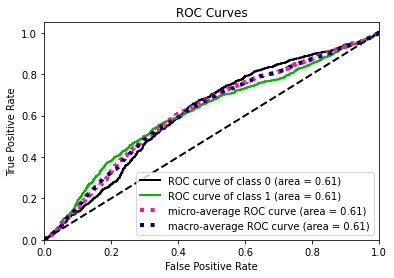

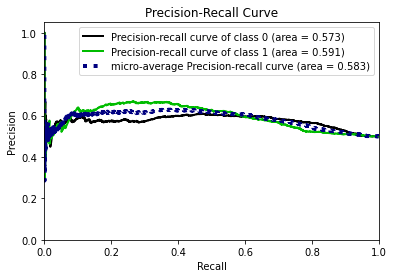

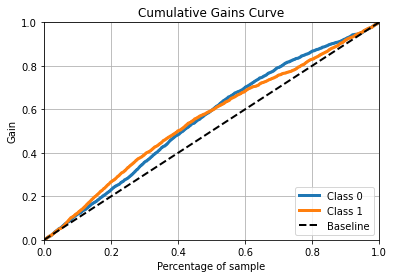

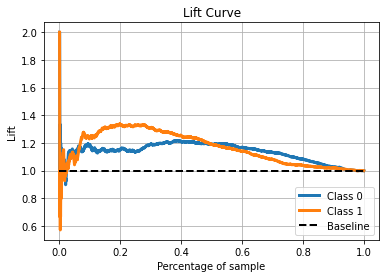

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.63      0.61      1200
           1       0.60      0.56      0.58      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



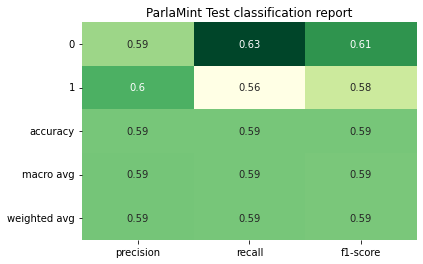


------------------------
  Confusion Matrix
------------------------


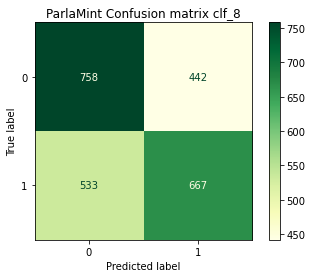

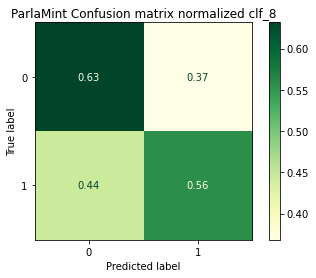

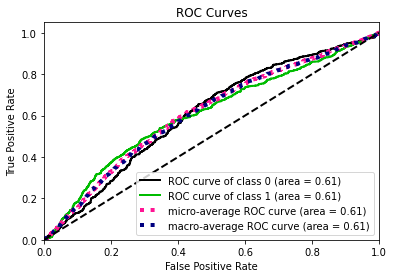

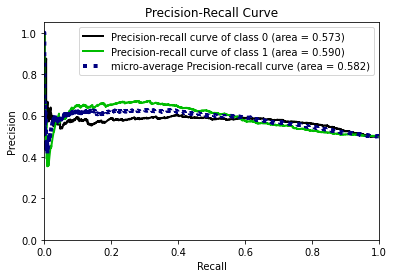

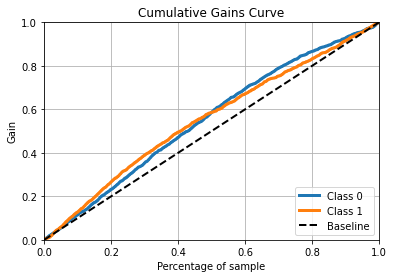

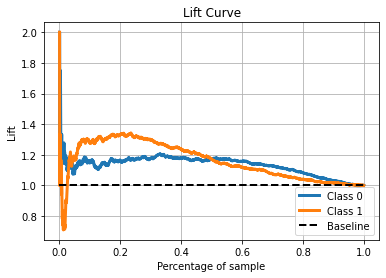

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.62      0.60      1200
           1       0.60      0.56      0.58      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



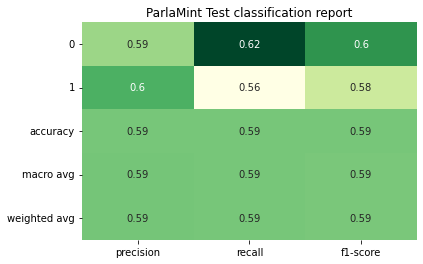


------------------------
  Confusion Matrix
------------------------


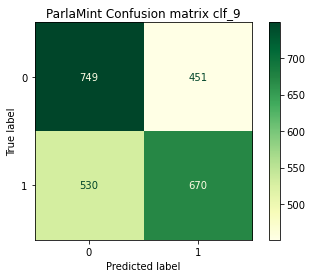

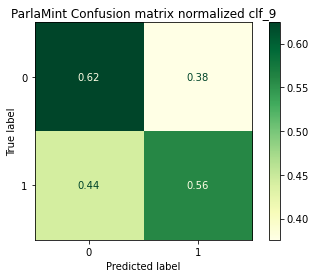

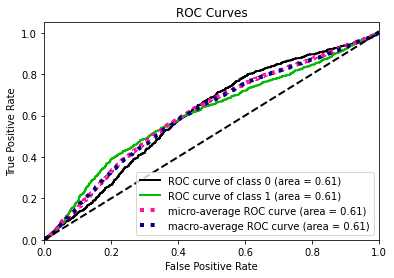

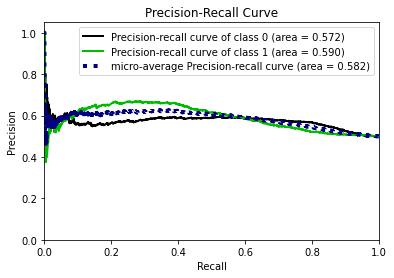

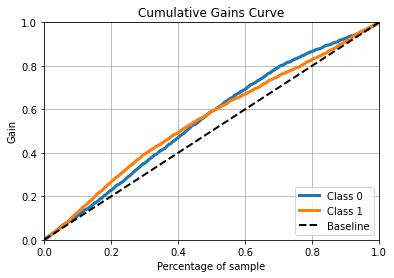

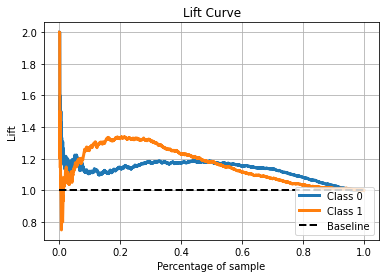

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.58      0.64      0.61      1200
           1       0.60      0.54      0.57      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



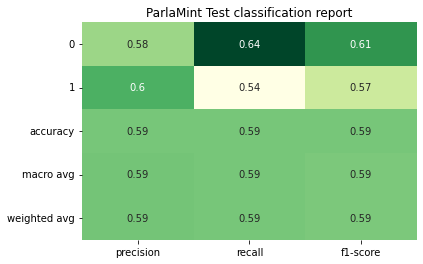


------------------------
  Confusion Matrix
------------------------


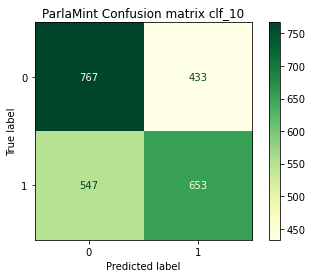

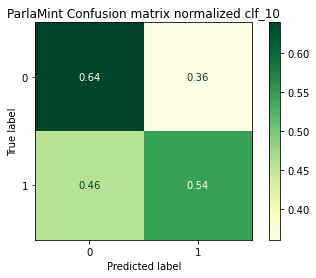

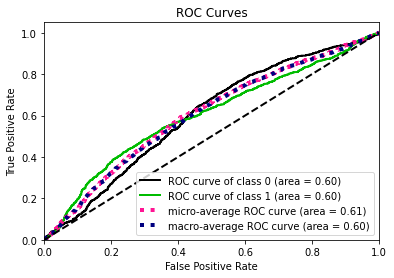

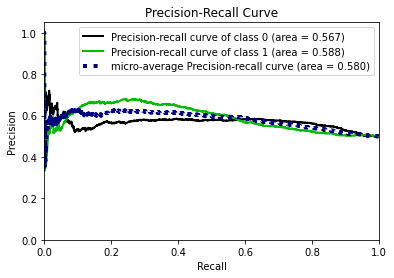

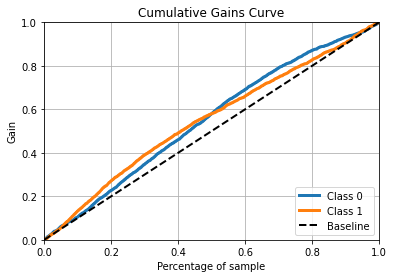

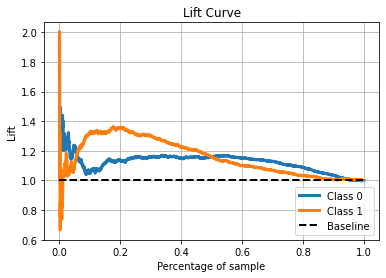

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.58      0.63      0.60      1200
           1       0.60      0.55      0.57      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



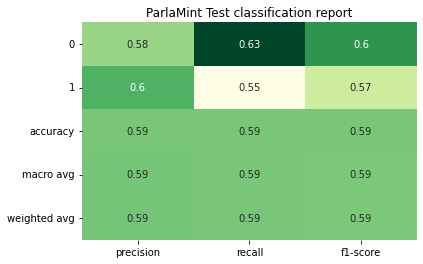


------------------------
  Confusion Matrix
------------------------


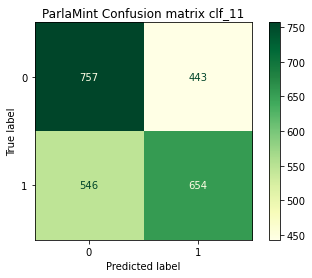

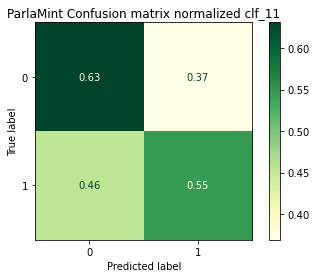

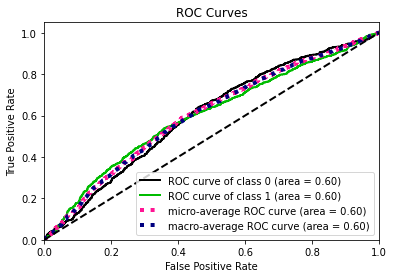

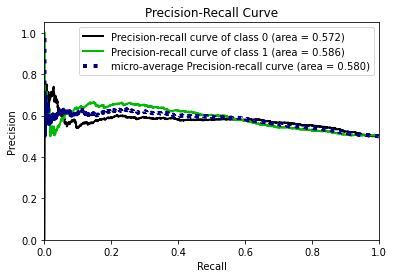

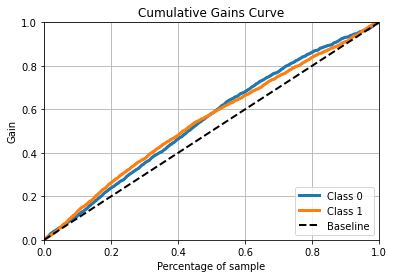

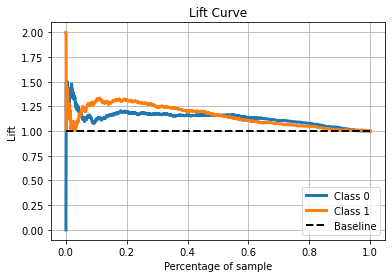

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.57      0.62      0.60      1200
           1       0.59      0.53      0.56      1200

    accuracy                           0.58      2400
   macro avg       0.58      0.58      0.58      2400
weighted avg       0.58      0.58      0.58      2400



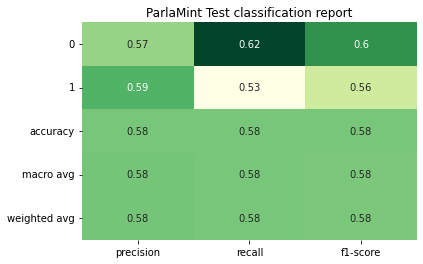


------------------------
  Confusion Matrix
------------------------


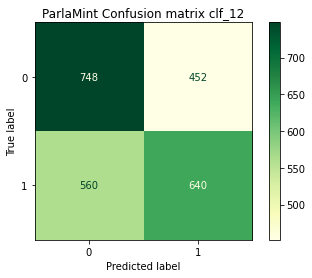

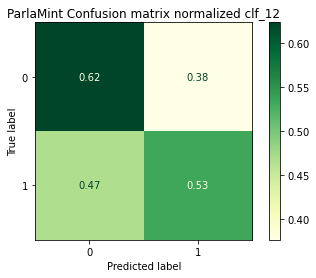

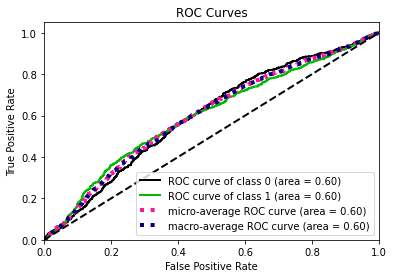

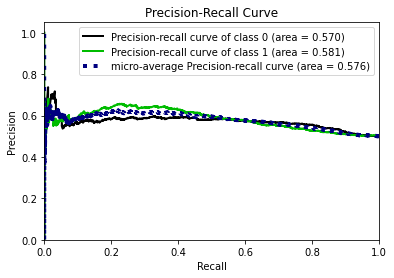

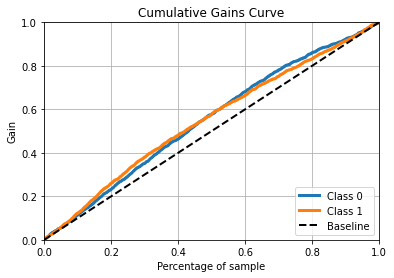

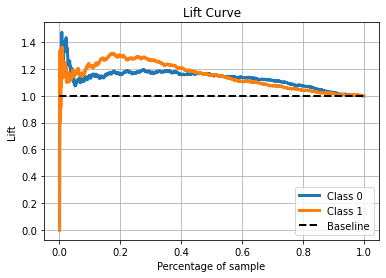

------------------------------------------------------------------------------------------------


In [80]:
lista_cm_normalizzate_svm_random_speech_no_pretrain, lista_clf_report_random_speech_no_pretrain = \
        plot_classification_results(diz_random_speech_svm_no_pretrain['df_random_speech'], False, diz_cmap['random_speech'])

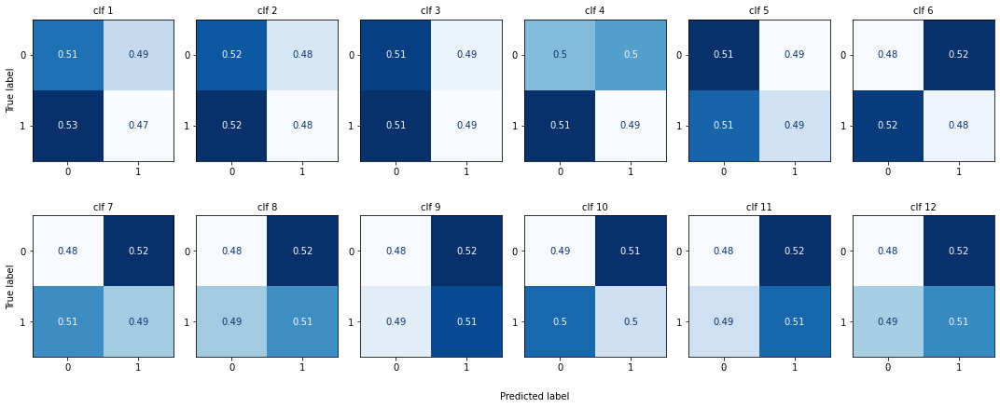

In [81]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_5_no_pretrain, 'SVM', '5', diz_cmap['5'], \
                                       titolo_ridotto='ridotto', no_pretrain='no_pr')

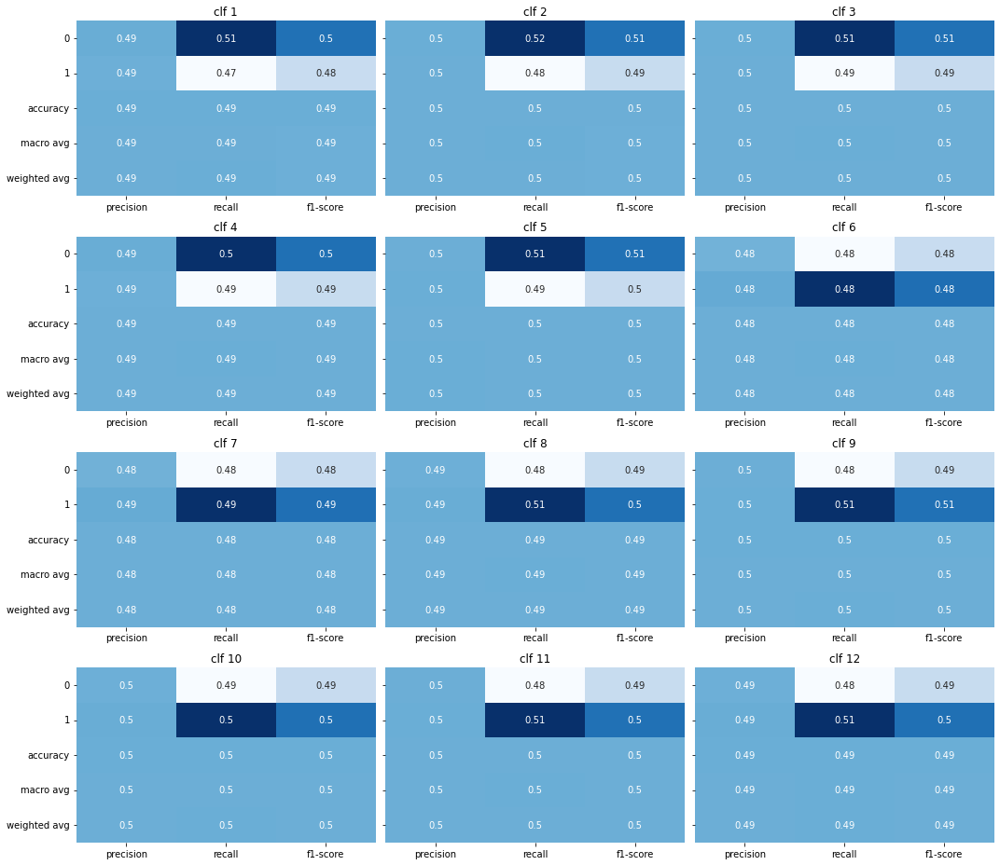

In [82]:
plot_all_classification_report(lista_clf_report_5_no_pretrain, '5', diz_cmap['5'], 'SVM',\
                              titolo_ridotto='ridotto', no_pretrain='no_pr')

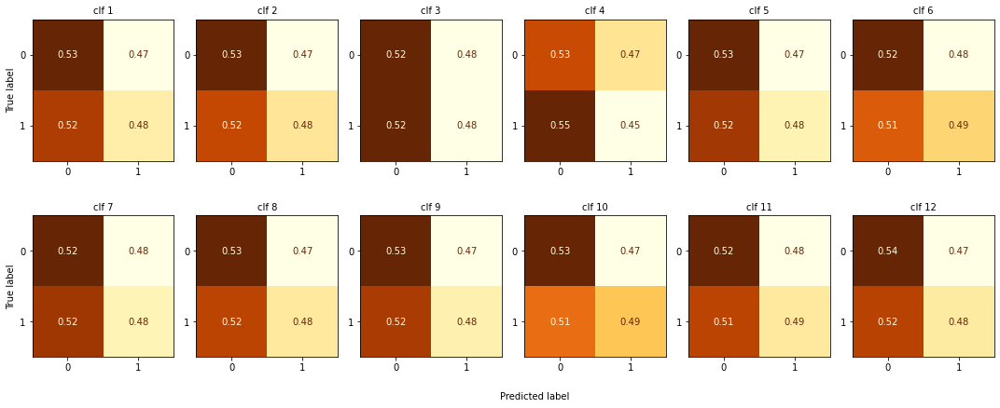

In [83]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_10_no_pretrain, 'SVM', '10', diz_cmap['10'], \
                                      titolo_ridotto='ridotto', no_pretrain='no_pr')

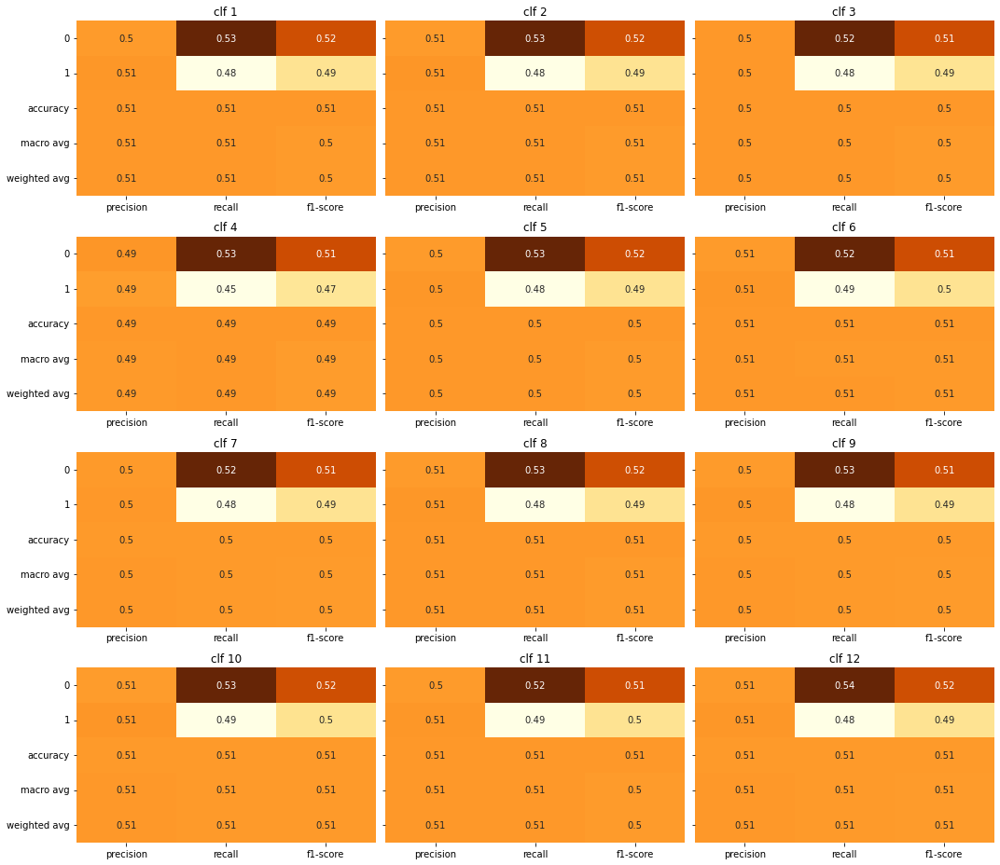

In [84]:
plot_all_classification_report(lista_clf_report_10_no_pretrain, '10', diz_cmap['10'], 'SVM', \
                              titolo_ridotto='ridotto', no_pretrain='no_pr')

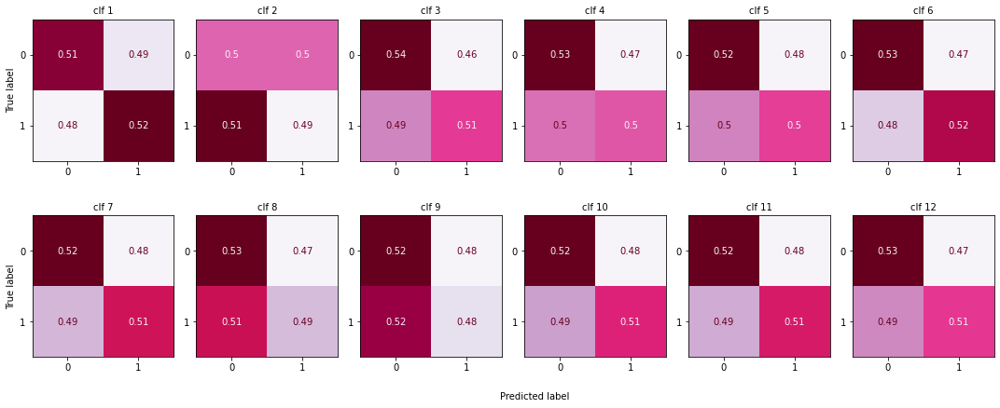

In [85]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_20_no_pretrain, 'SVM', '20', diz_cmap['20'], \
                                      titolo_ridotto='ridotto', no_pretrain='no_pr')

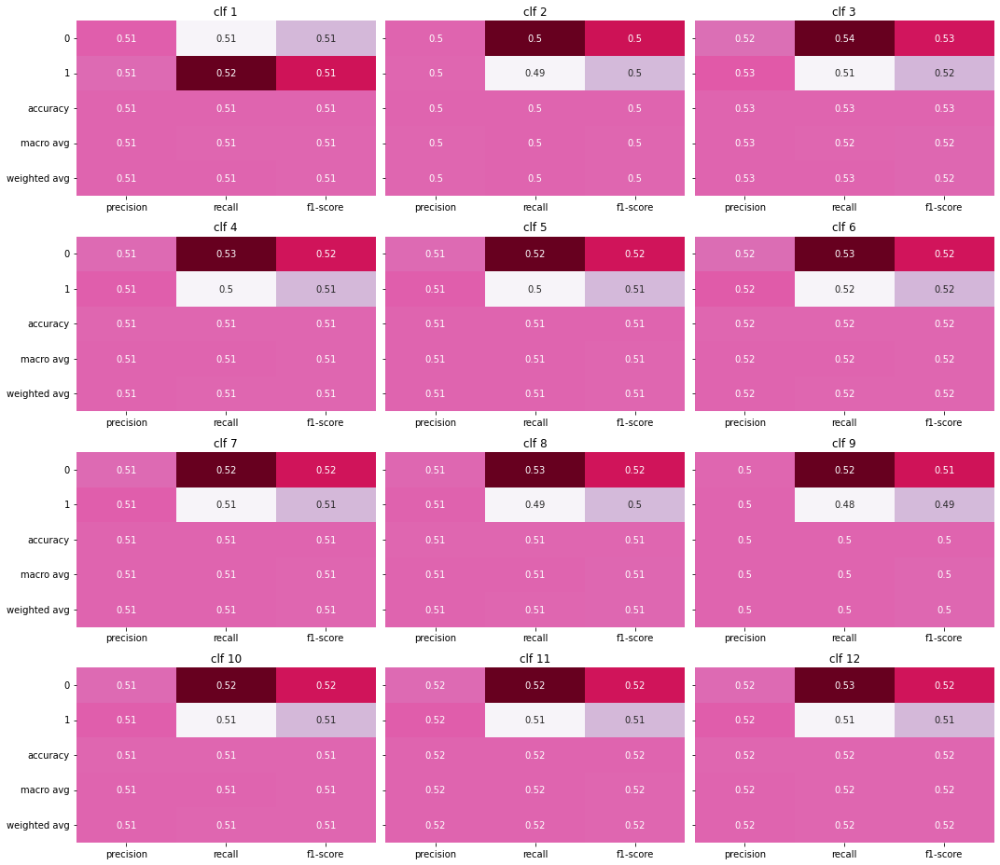

In [86]:
plot_all_classification_report(lista_clf_report_20_no_pretrain, '20', diz_cmap['20'], 'SVM', \
                              titolo_ridotto='ridotto', no_pretrain='no_pr')

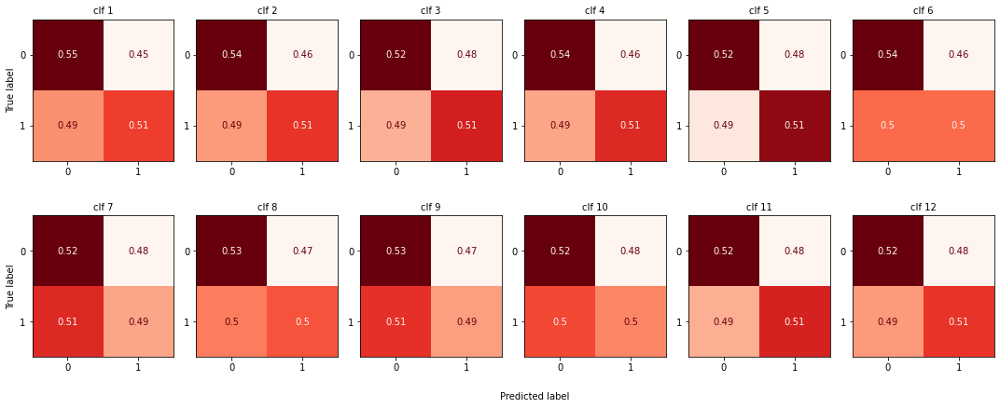

In [87]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_30_no_pretrain, 'SVM', '30', diz_cmap['30'], \
                                      titolo_ridotto='ridotto', no_pretrain='no_pr') 

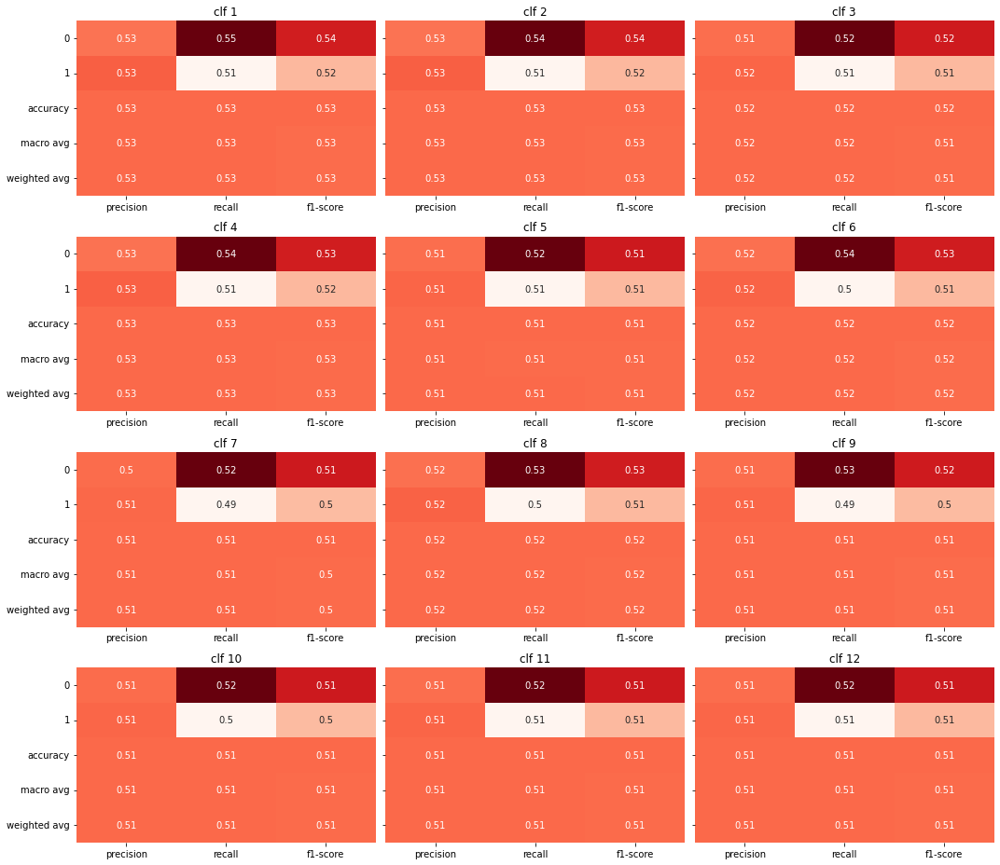

In [88]:
plot_all_classification_report(lista_clf_report_30_no_pretrain, '30', diz_cmap['30'], 'SVM', \
                              titolo_ridotto='ridotto', no_pretrain='no_pr')

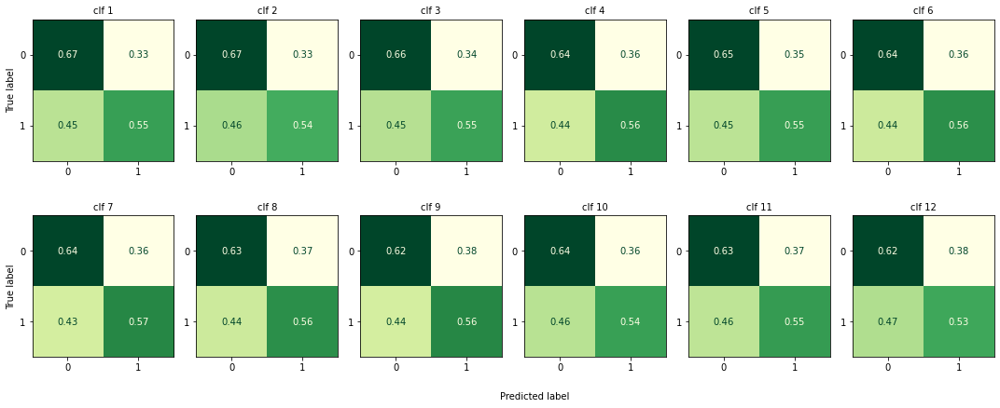

In [89]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_random_speech_no_pretrain, 'SVM', 'random_speech', \
                                       diz_cmap['random_speech'], titolo_ridotto='ridotto', no_pretrain='no_pr')

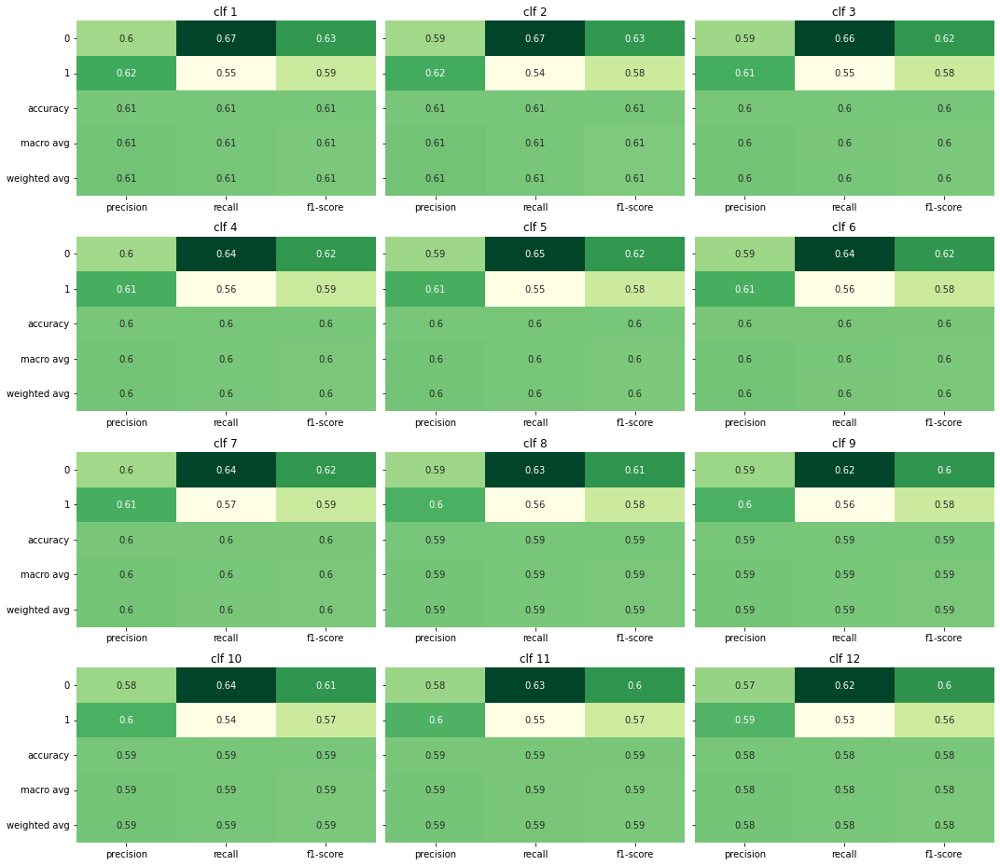

In [90]:
plot_all_classification_report(lista_clf_report_random_speech_no_pretrain, 'random_speech', \
                               diz_cmap['random_speech'], 'SVM', titolo_ridotto='ridotto', no_pretrain='no_pr')

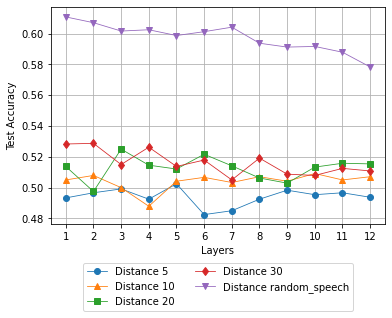

In [85]:
plot_loss_and_accuracy_of_all_distances_svm([diz_dist_5_svm_no_pretrain['df_dist_5'], \
                                             diz_dist_10_svm_no_pretrain['df_dist_10'], \
                                            diz_dist_20_svm_no_pretrain['df_dist_20'], \
                                             diz_dist_30_svm_no_pretrain['df_dist_30'], \
                                            diz_random_speech_svm_no_pretrain['df_random_speech']], \
                                           titolo_ridotto='ridotto', no_pretrain='no_pr')

# SVM

In [17]:
dist_5_svm = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_5.pickle", "rb")
dist_10_svm = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_10.pickle", "rb")
dist_20_svm = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_20.pickle", "rb")
dist_30_svm = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_dist_30.pickle", "rb")
dist_random_speech_svm = open(path_pickle + "/" + "diz_classifiers_bert_svm_df_random_speech.pickle", "rb")

diz_dist_5_svm = pickle.load(dist_5_svm)
diz_dist_10_svm = pickle.load(dist_10_svm)
diz_dist_20_svm = pickle.load(dist_20_svm)
diz_dist_30_svm = pickle.load(dist_30_svm)
diz_random_speech_svm = pickle.load(dist_random_speech_svm)

In [30]:
diz_dist_5_svm['df_dist_5']['clf_1']['y_test']

0       1
1       1
2       0
3       1
4       1
       ..
2395    0
2396    0
2397    1
2398    1
2399    1
Name: Class, Length: 2400, dtype: int64

In [29]:
diz_dist_5_svm['df_dist_5']['clf_1']['y_pred']

array([1, 0, 0, ..., 0, 1, 1])

In [13]:
list(diz_dist_10_svm['df_dist_10']['clf_1']['ids_preds'].keys()) == list(diz_dist_10_svm['df_dist_10']['clf_5']['ids_preds'].keys())

True

In [14]:
lista_ids_svm_5 = controlla_ids(diz_dist_5_svm['df_dist_5'])

inizializzo la lista con il classificatore clf_1


In [15]:
lista_ids_svm_10 = controlla_ids(diz_dist_10_svm['df_dist_10'])

inizializzo la lista con il classificatore clf_1


In [16]:
lista_ids_svm_20 = controlla_ids(diz_dist_20_svm['df_dist_20'])

inizializzo la lista con il classificatore clf_1


In [17]:
lista_ids_svm_30 = controlla_ids(diz_dist_30_svm['df_dist_30'])

inizializzo la lista con il classificatore clf_1


In [18]:
lista_ids_svm_random_speech = controlla_ids(diz_random_speech_svm['df_random_speech'])

inizializzo la lista con il classificatore clf_1


# SVM classification results

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.50      0.50      1200
           1       0.50      0.49      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



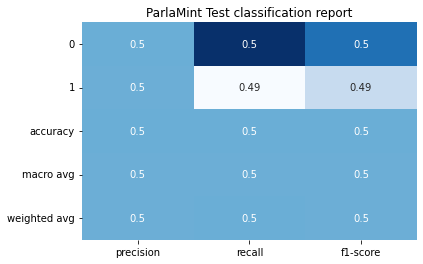


------------------------
  Confusion Matrix
------------------------


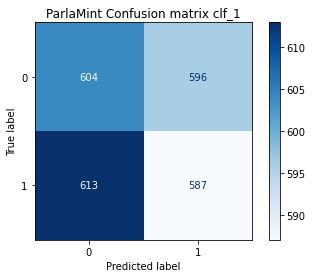

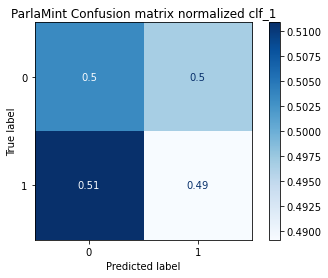

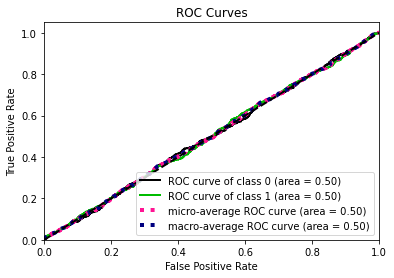

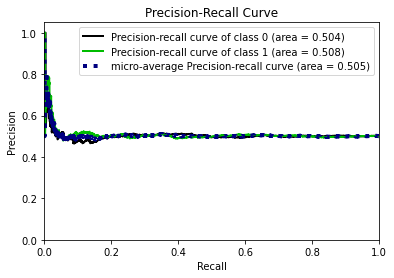

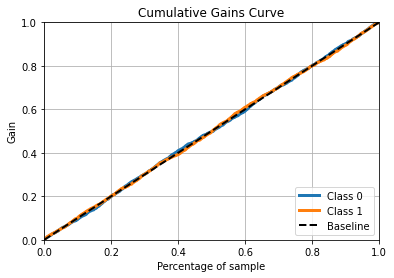

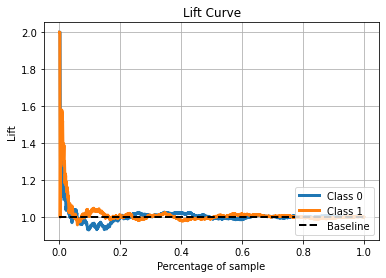

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.51      1200
           1       0.50      0.49      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



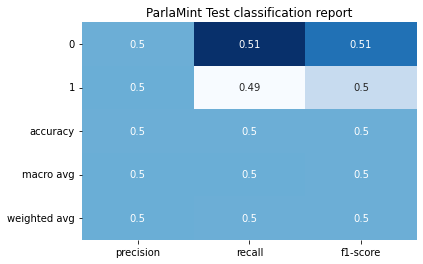


------------------------
  Confusion Matrix
------------------------


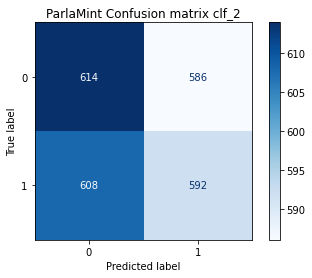

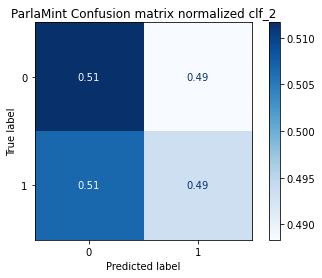

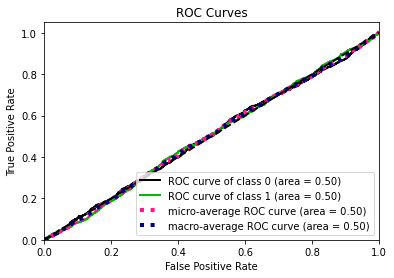

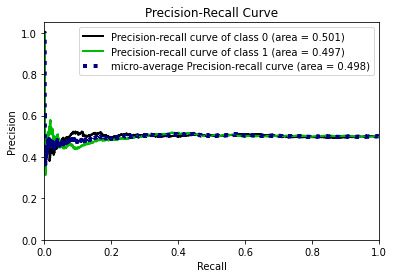

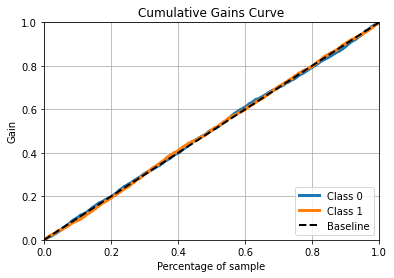

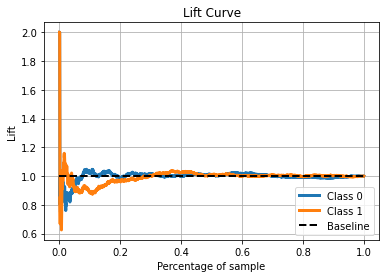

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.49      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



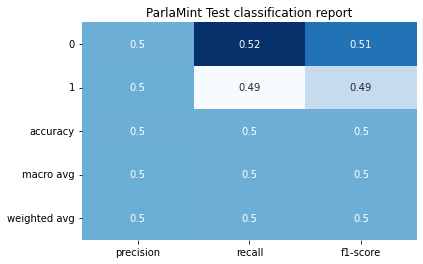


------------------------
  Confusion Matrix
------------------------


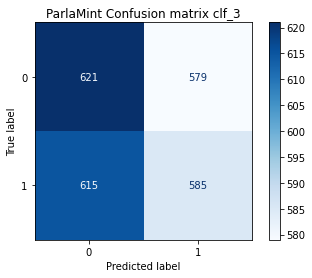

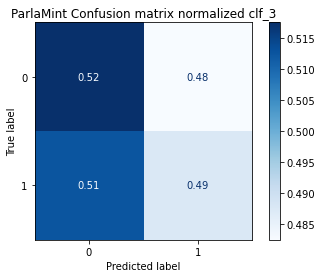

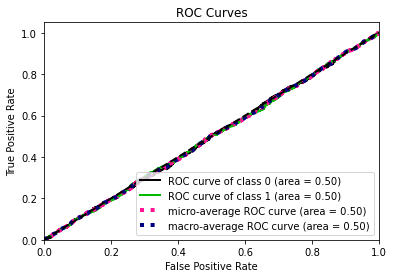

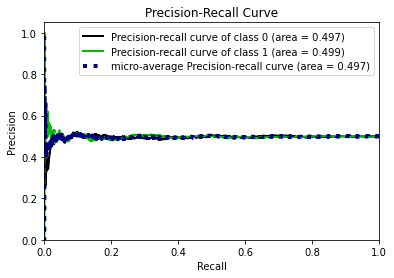

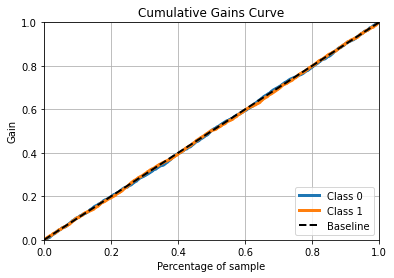

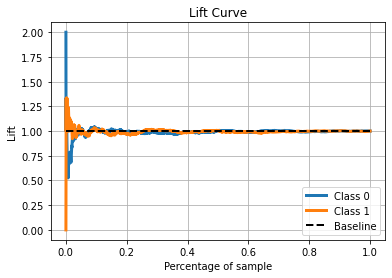

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.50      1200
           1       0.50      0.49      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



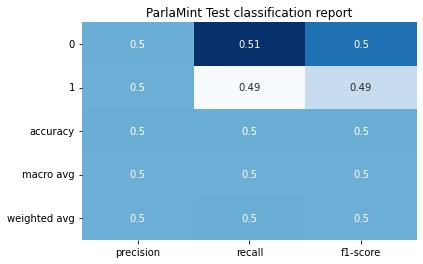


------------------------
  Confusion Matrix
------------------------


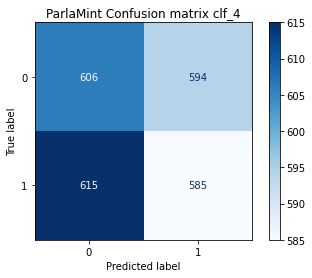

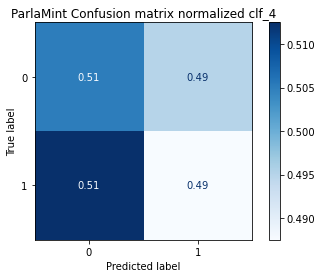

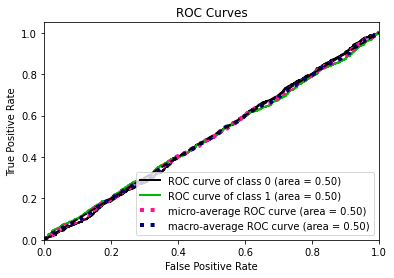

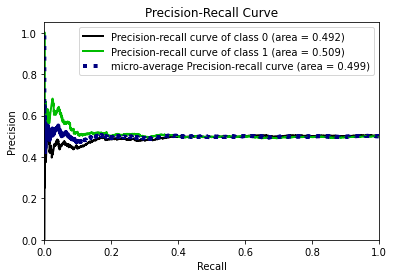

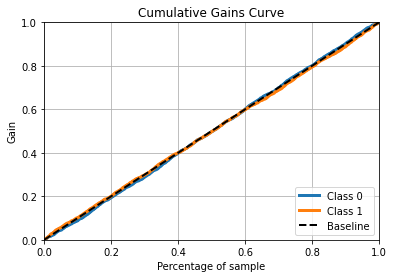

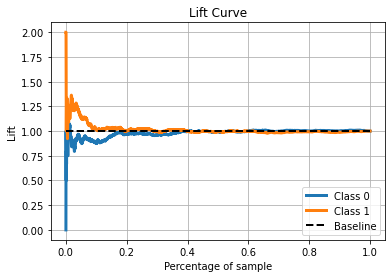

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.53      0.52      1200
           1       0.51      0.48      0.49      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.50      2400
weighted avg       0.51      0.51      0.50      2400



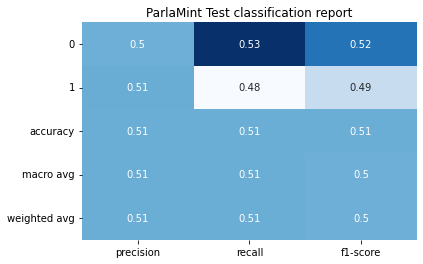


------------------------
  Confusion Matrix
------------------------


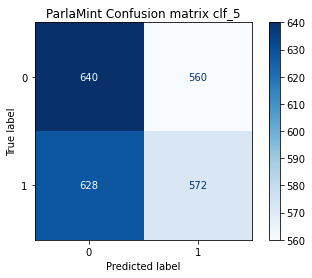

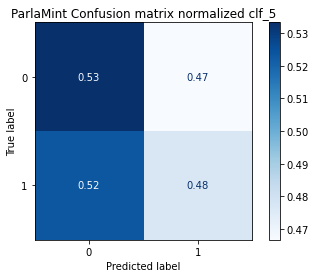

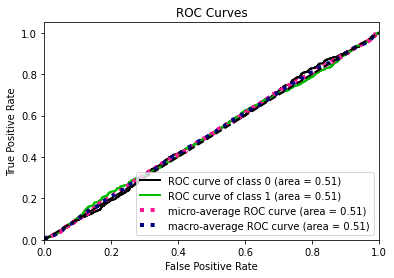

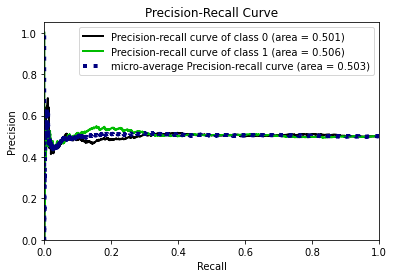

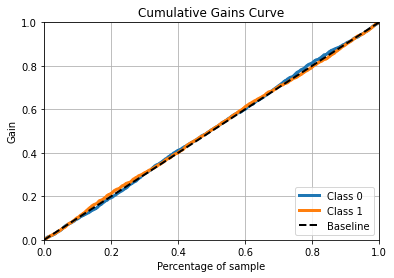

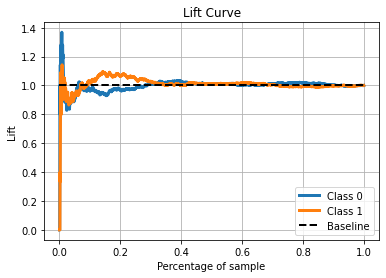

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.46      0.47      1200
           1       0.49      0.51      0.50      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



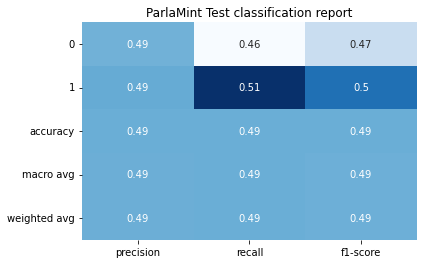


------------------------
  Confusion Matrix
------------------------


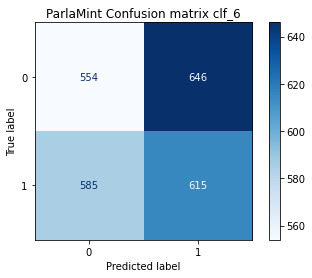

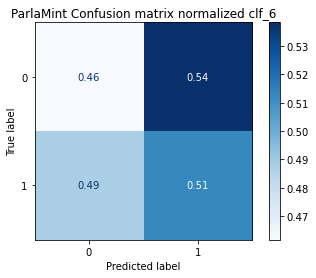

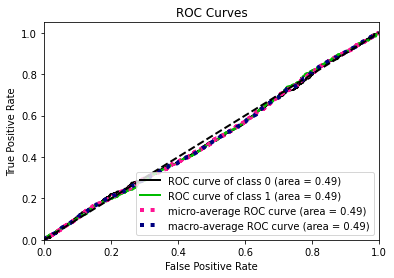

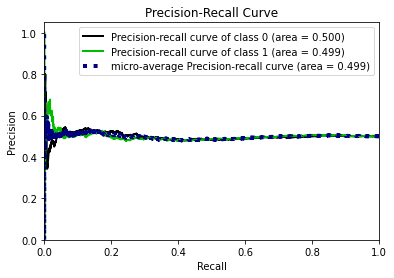

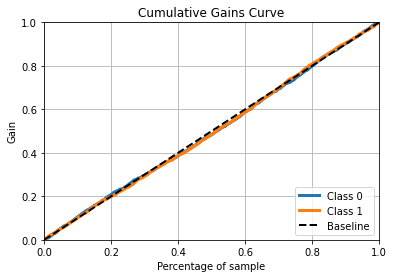

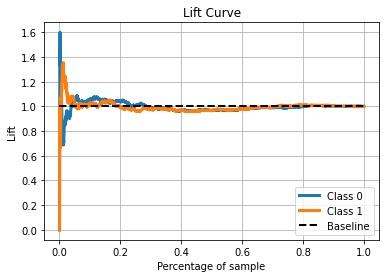

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.48      0.49      1200
           1       0.49      0.51      0.50      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



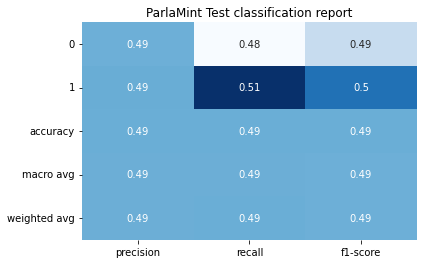


------------------------
  Confusion Matrix
------------------------


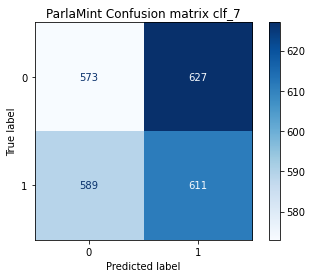

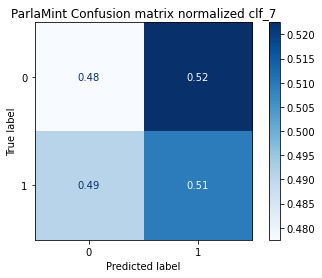

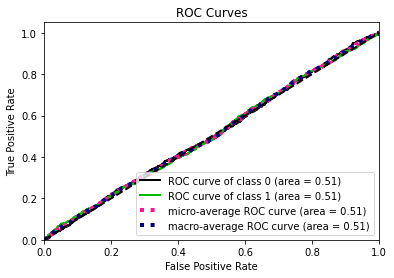

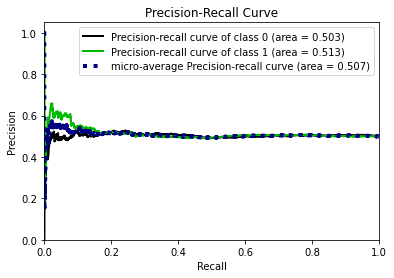

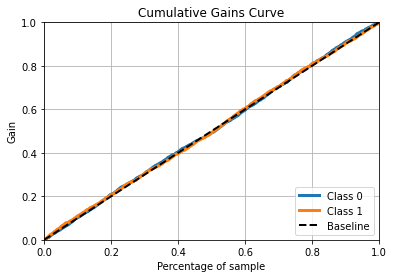

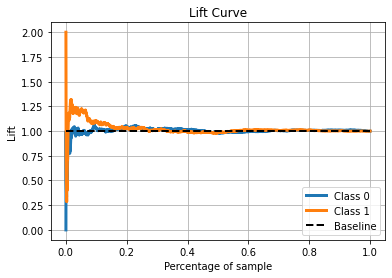

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.48      0.49      1200
           1       0.50      0.51      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



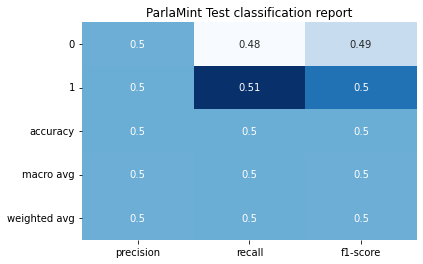


------------------------
  Confusion Matrix
------------------------


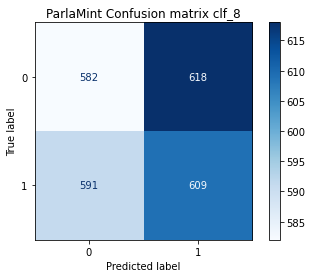

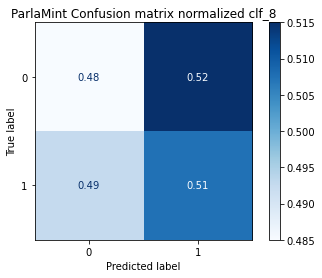

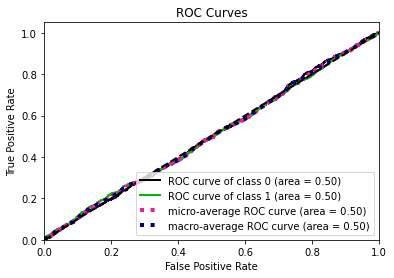

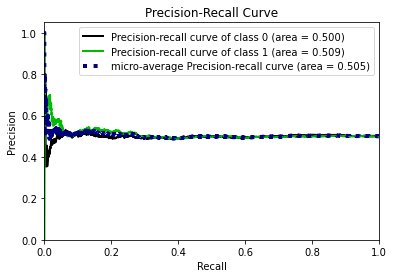

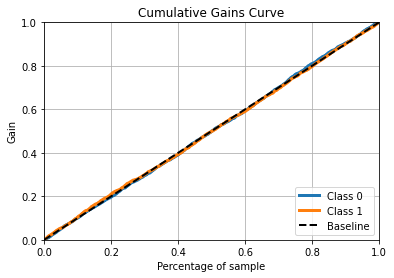

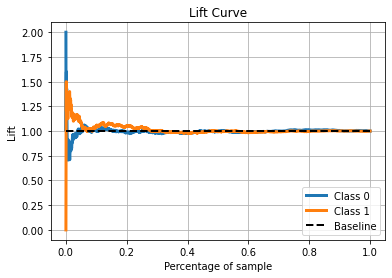

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.51      0.50      1200
           1       0.49      0.48      0.49      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.49      2400
weighted avg       0.49      0.49      0.49      2400



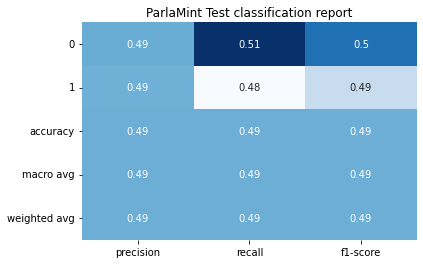


------------------------
  Confusion Matrix
------------------------


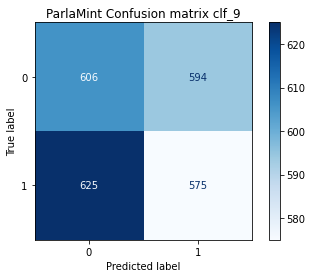

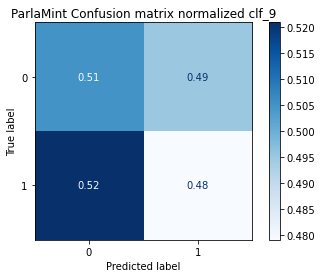

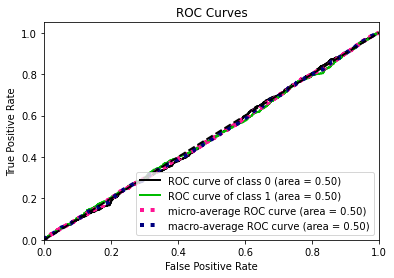

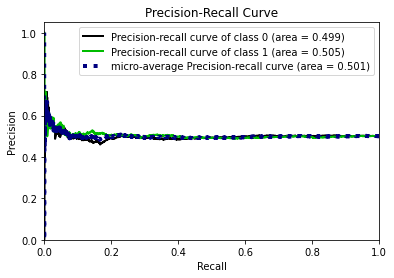

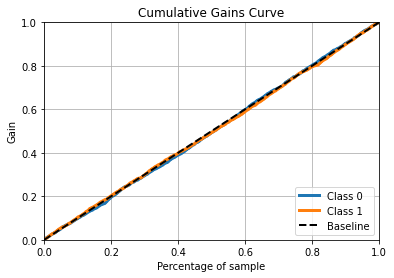

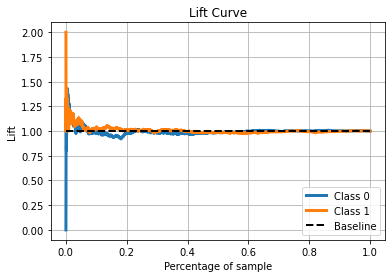

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.50      1200
           1       0.50      0.49      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



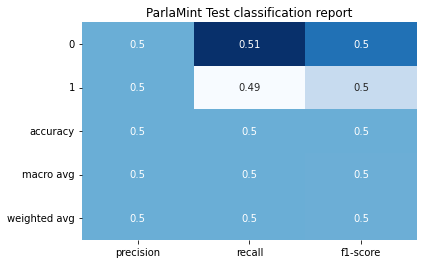


------------------------
  Confusion Matrix
------------------------


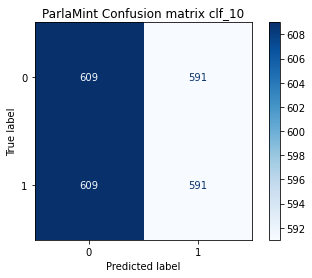

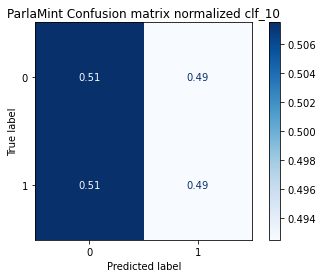

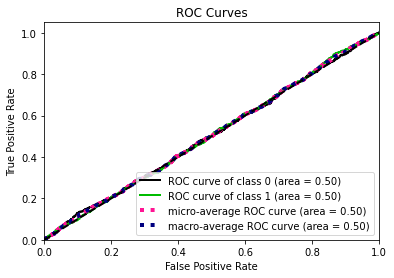

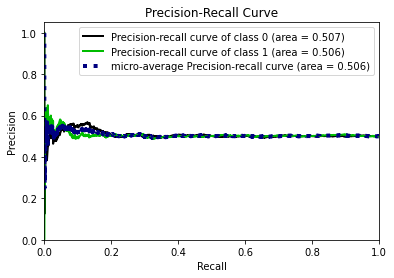

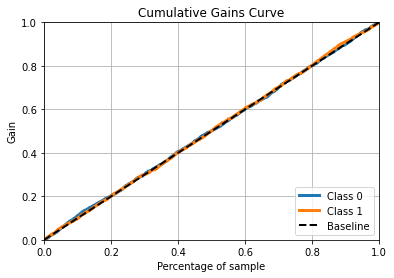

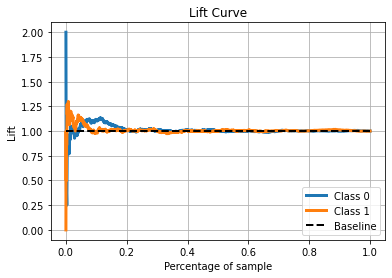

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.52      0.51      1200
           1       0.50      0.49      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



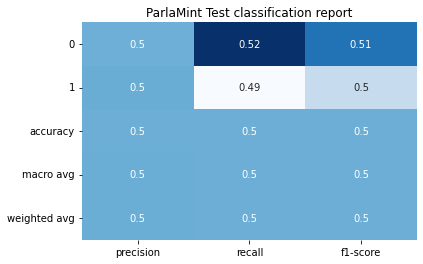


------------------------
  Confusion Matrix
------------------------


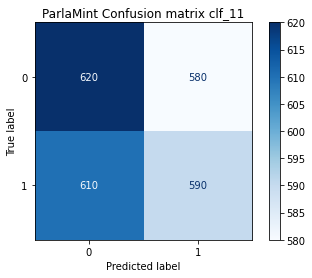

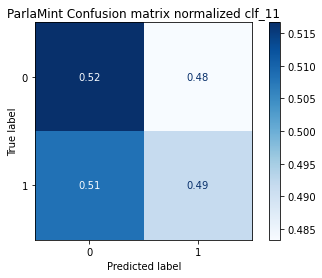

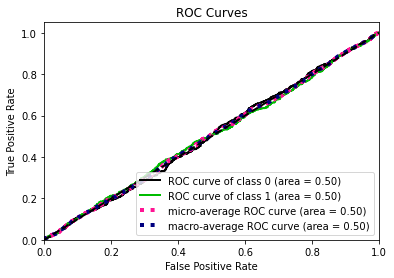

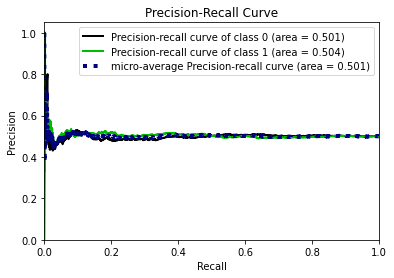

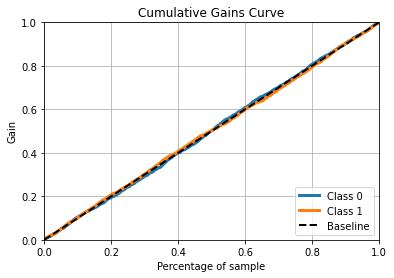

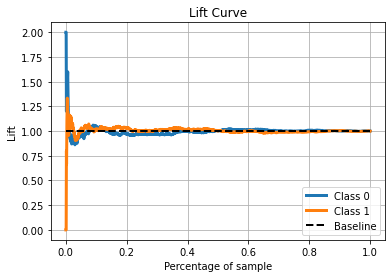

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.49      0.50      1200
           1       0.50      0.50      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



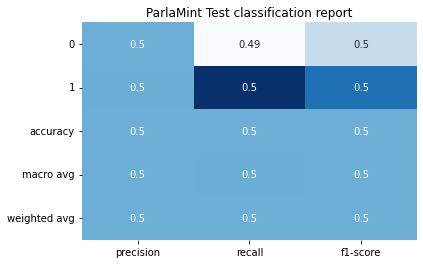


------------------------
  Confusion Matrix
------------------------


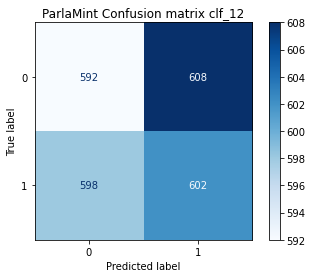

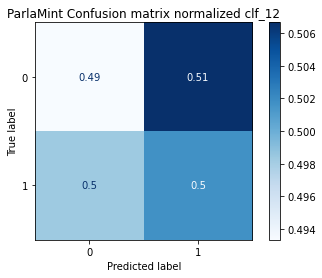

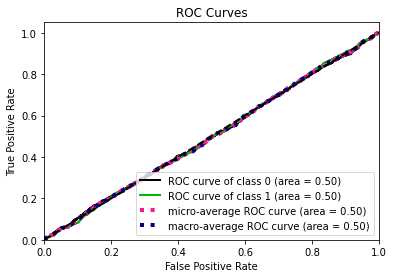

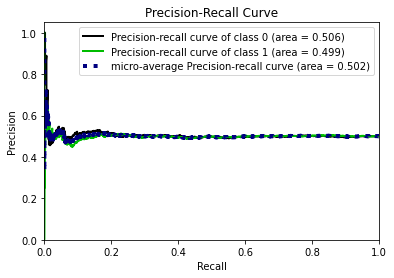

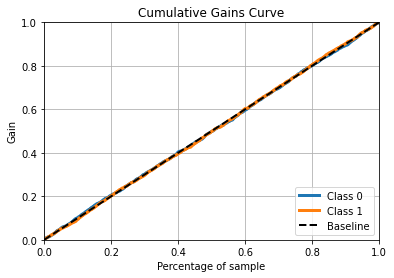

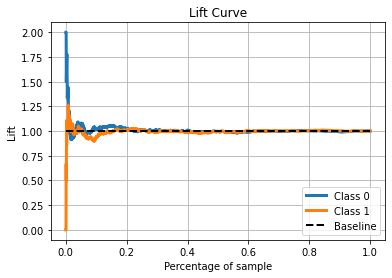

------------------------------------------------------------------------------------------------


In [19]:
lista_cm_normalizzate_svm_5, lista_clf_report_5 = \
        plot_classification_results(diz_dist_5_svm['df_dist_5'], False, diz_cmap['5'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.53      0.52      1200
           1       0.51      0.49      0.50      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



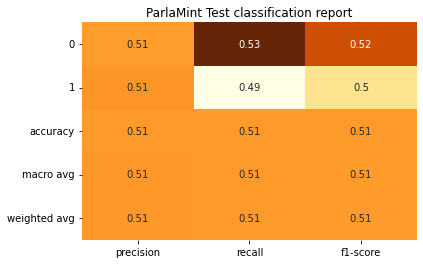


------------------------
  Confusion Matrix
------------------------


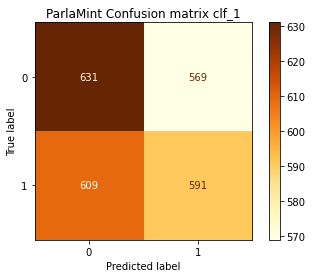

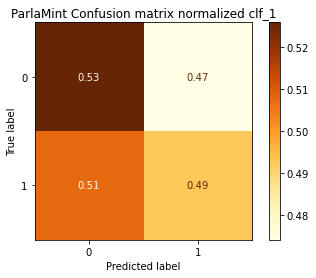

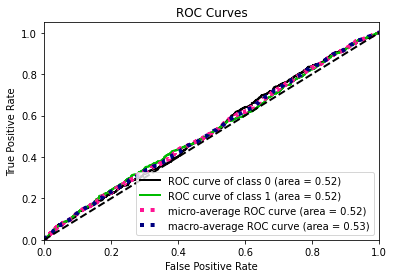

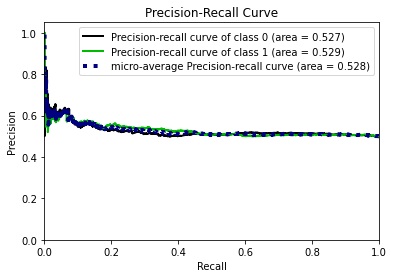

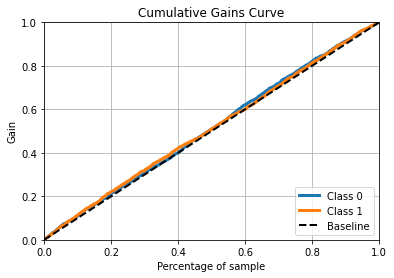

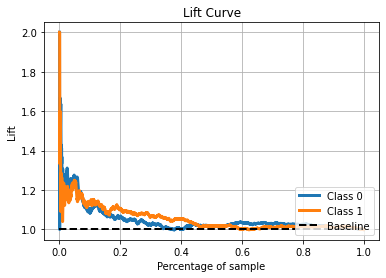

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.54      0.54      1200
           1       0.54      0.53      0.53      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



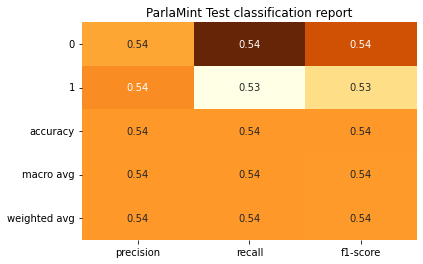


------------------------
  Confusion Matrix
------------------------


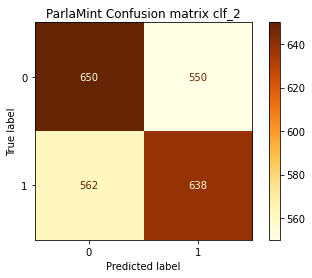

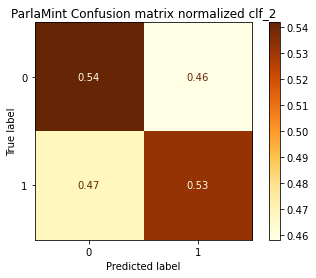

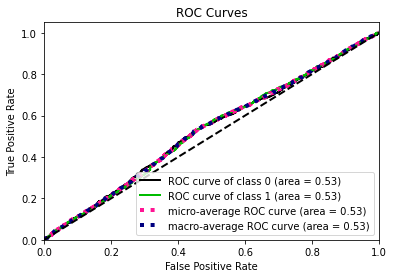

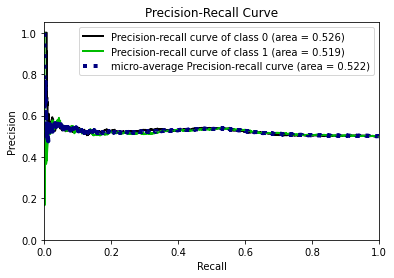

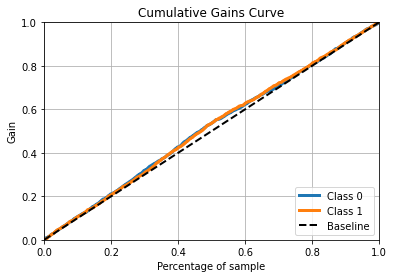

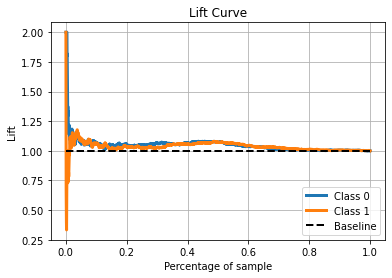

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.53      0.53      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



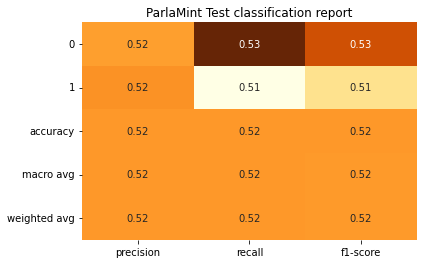


------------------------
  Confusion Matrix
------------------------


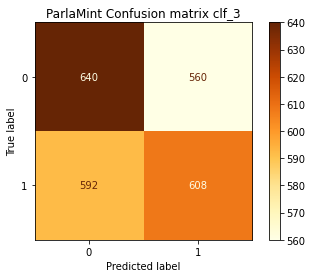

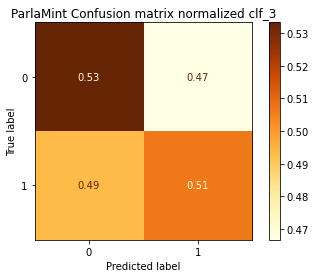

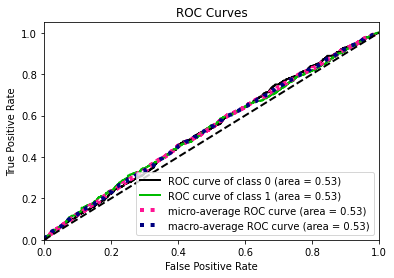

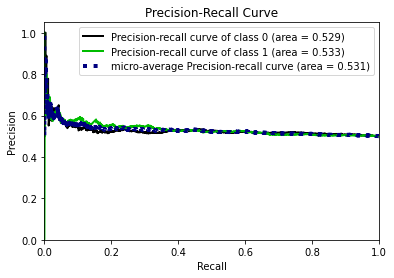

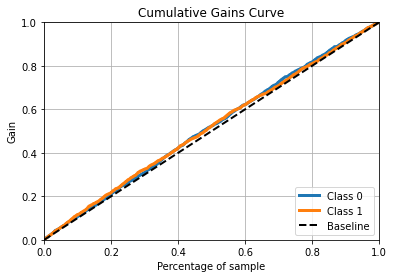

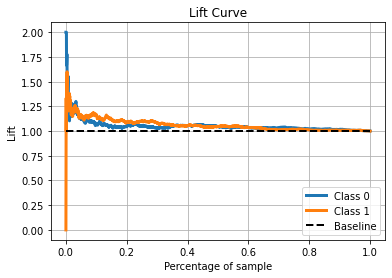

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.53      0.53      1200
           1       0.53      0.52      0.53      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



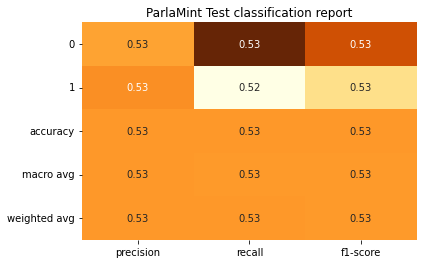


------------------------
  Confusion Matrix
------------------------


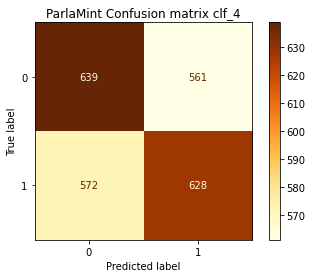

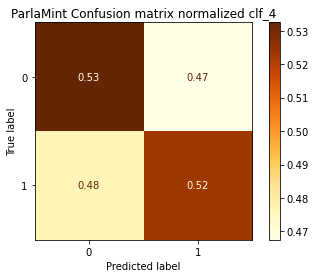

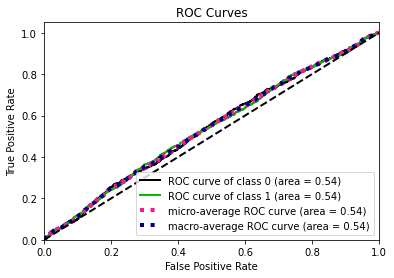

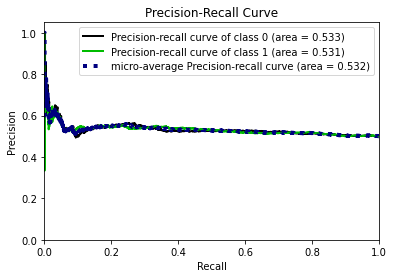

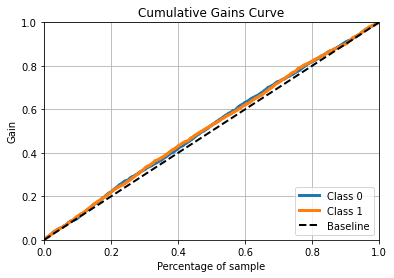

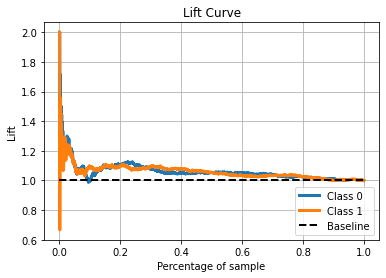

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.52      0.53      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



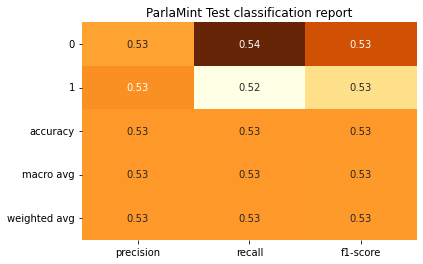


------------------------
  Confusion Matrix
------------------------


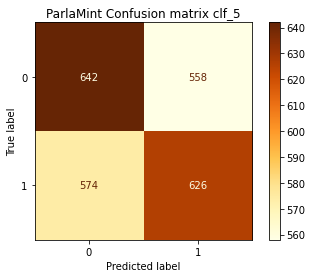

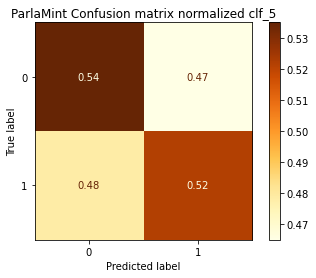

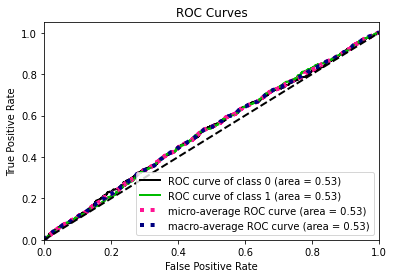

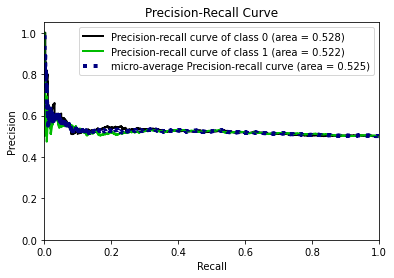

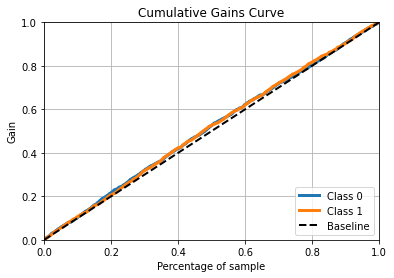

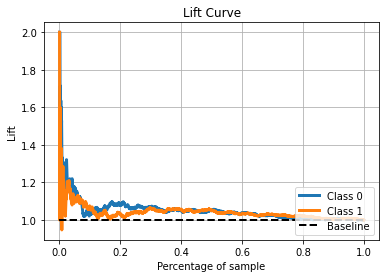

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.52      0.52      1200
           1       0.52      0.52      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



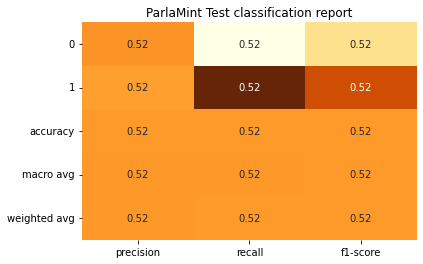


------------------------
  Confusion Matrix
------------------------


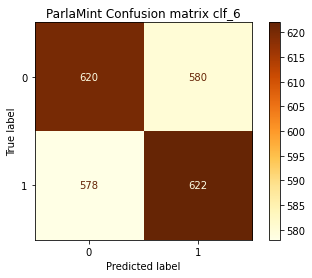

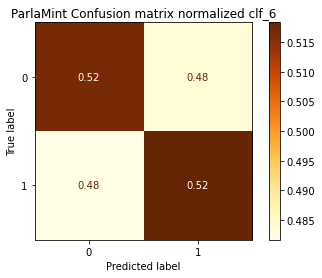

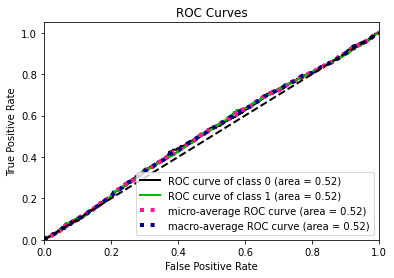

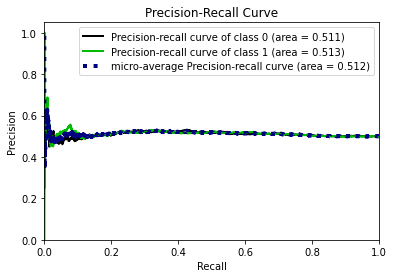

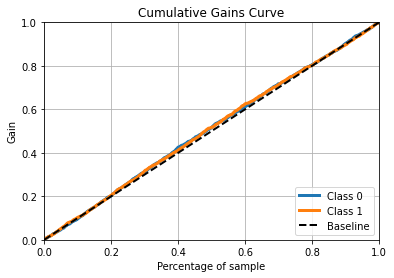

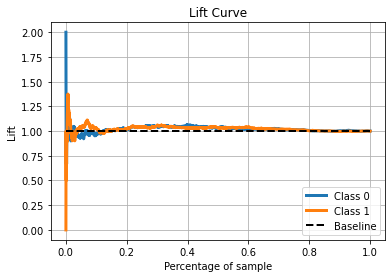

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.52      0.52      1200
           1       0.52      0.52      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



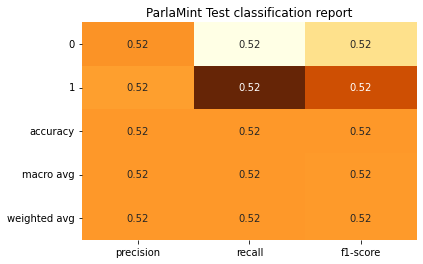


------------------------
  Confusion Matrix
------------------------


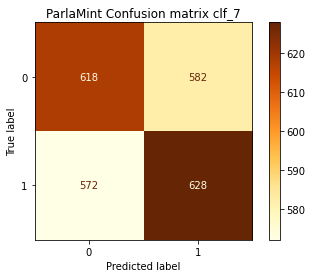

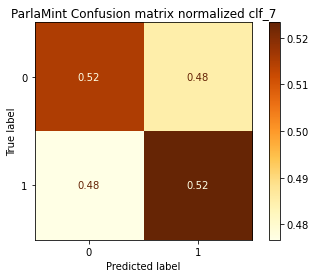

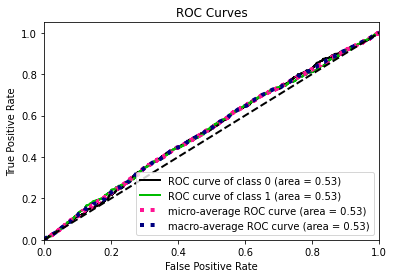

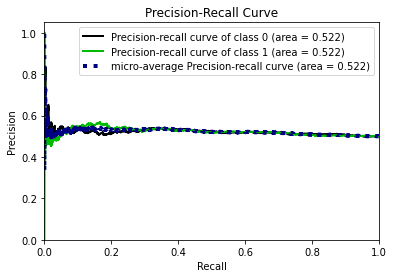

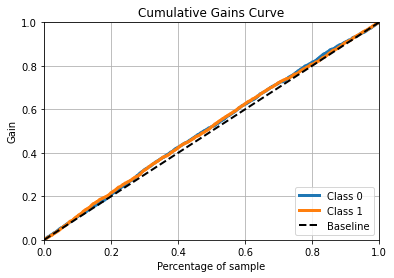

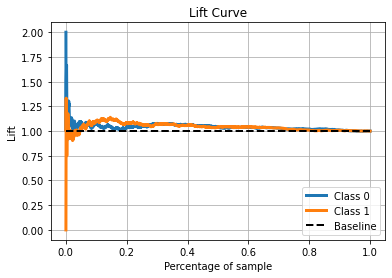

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.51      0.51      1200
           1       0.51      0.52      0.52      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



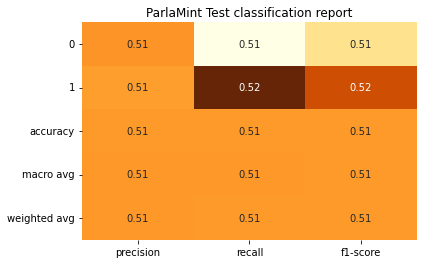


------------------------
  Confusion Matrix
------------------------


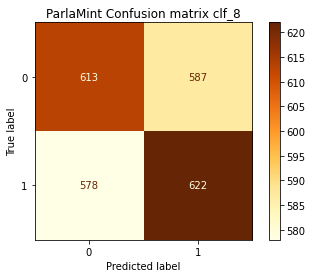

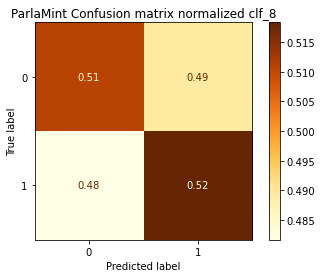

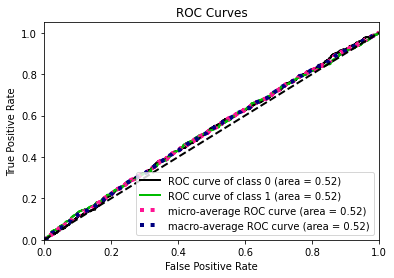

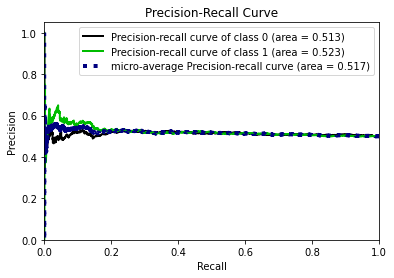

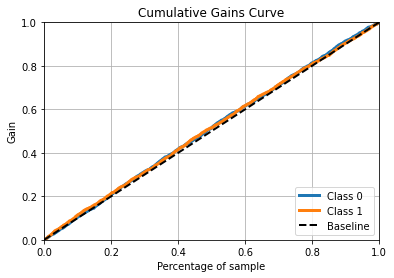

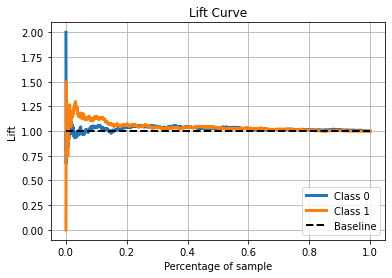

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.52      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



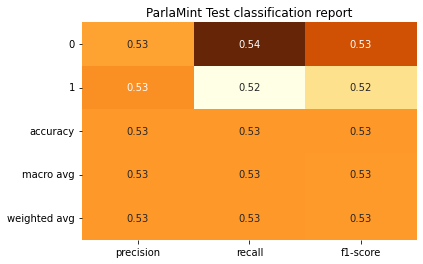


------------------------
  Confusion Matrix
------------------------


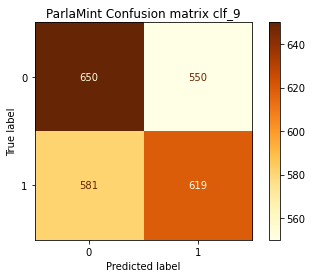

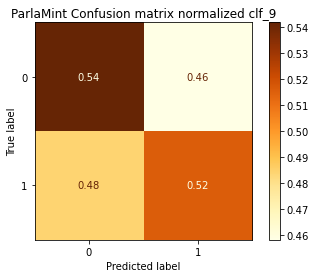

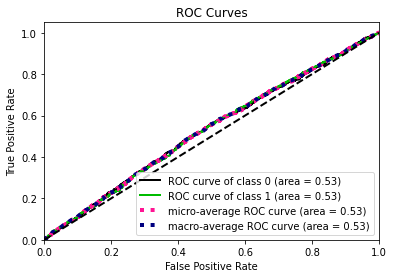

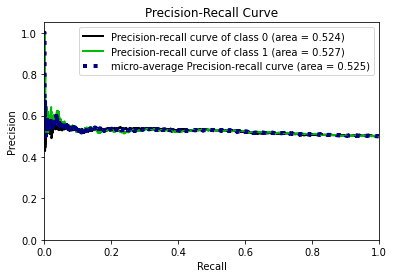

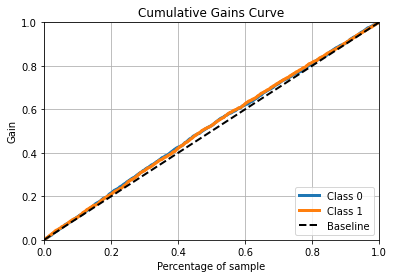

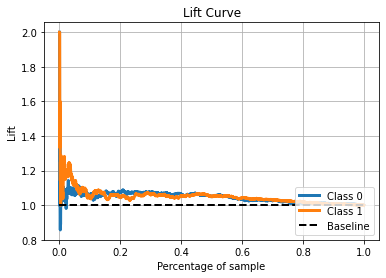

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.52      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



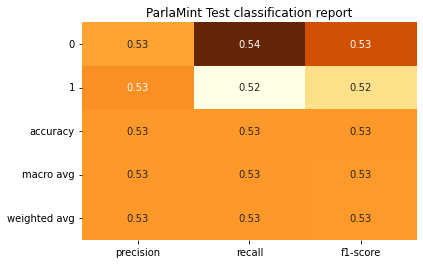


------------------------
  Confusion Matrix
------------------------


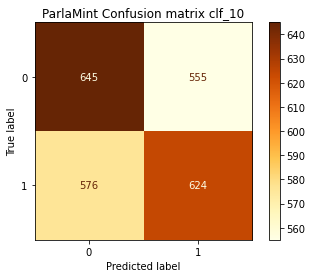

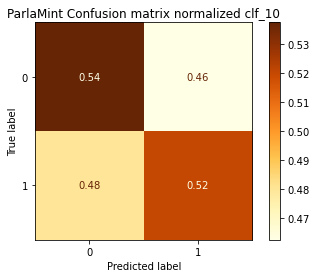

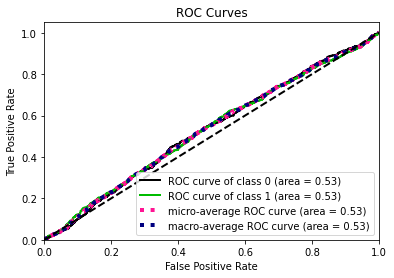

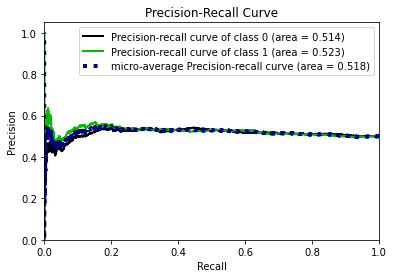

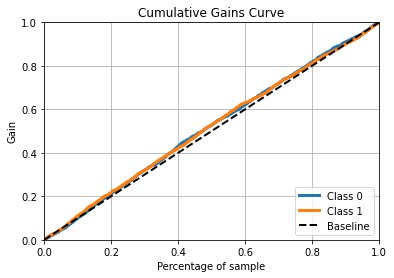

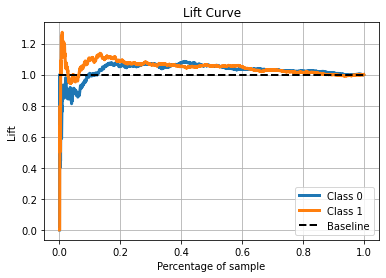

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.51      0.51      1200
           1       0.52      0.52      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



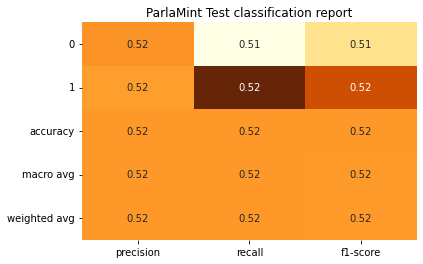


------------------------
  Confusion Matrix
------------------------


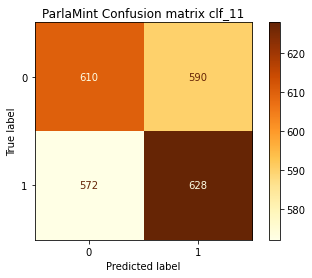

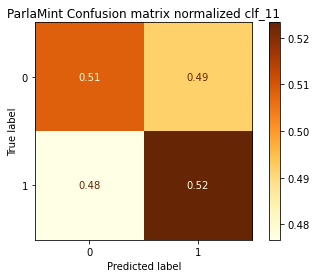

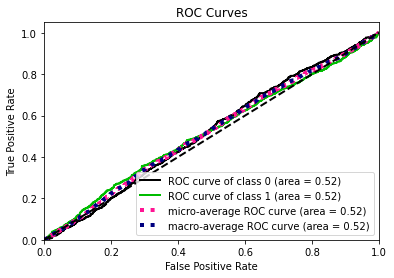

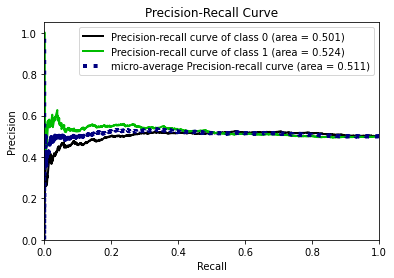

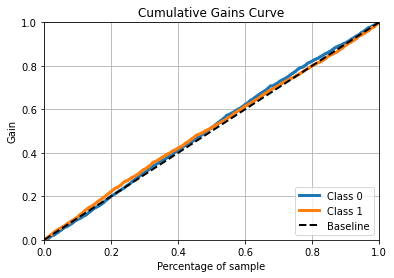

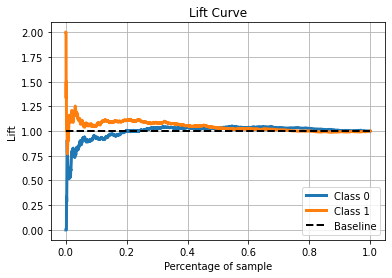

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.52      0.52      1200
           1       0.52      0.53      0.53      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



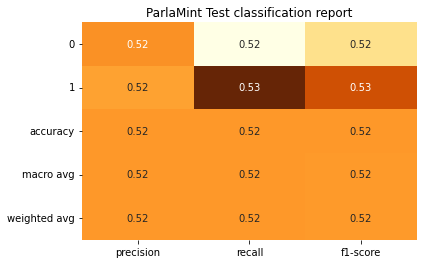


------------------------
  Confusion Matrix
------------------------


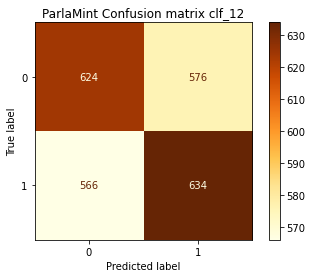

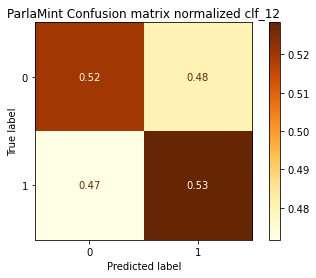

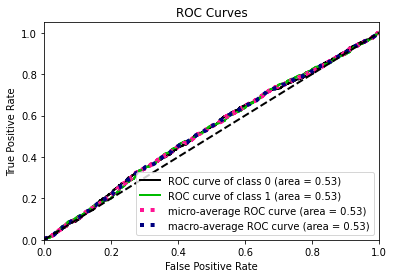

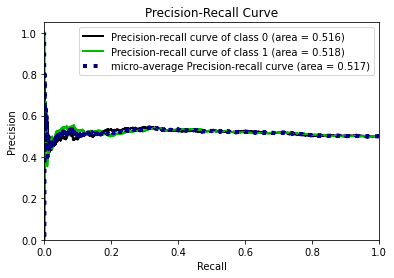

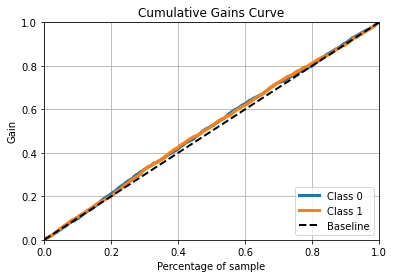

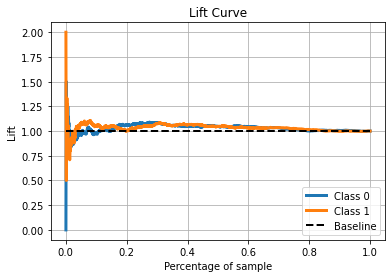

------------------------------------------------------------------------------------------------


In [20]:
lista_cm_normalizzate_svm_10, lista_clf_report_10 = \
        plot_classification_results(diz_dist_10_svm['df_dist_10'], False, diz_cmap['10'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.55      0.54      1200
           1       0.54      0.52      0.53      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



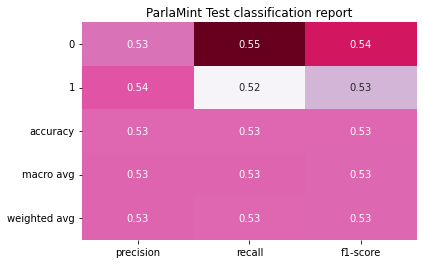


------------------------
  Confusion Matrix
------------------------


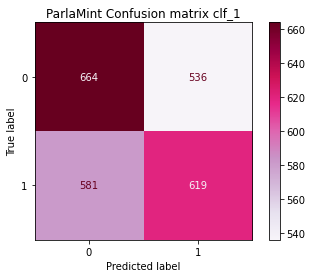

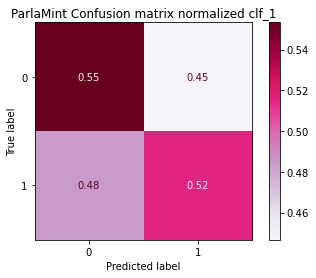

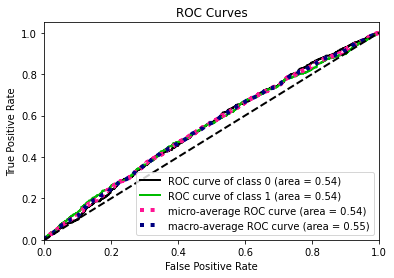

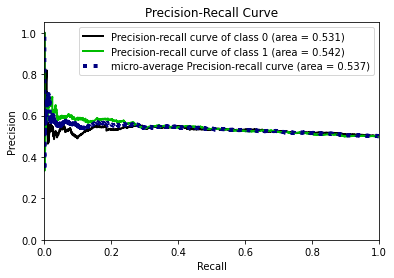

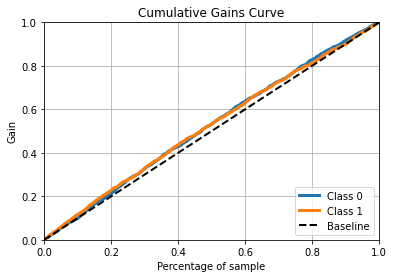

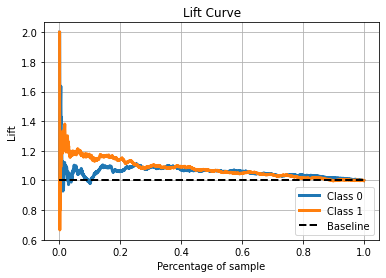

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.51      0.51      1200
           1       0.52      0.52      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



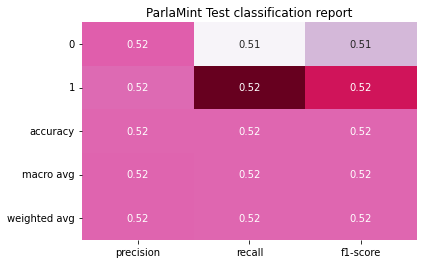


------------------------
  Confusion Matrix
------------------------


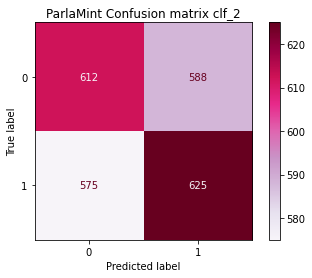

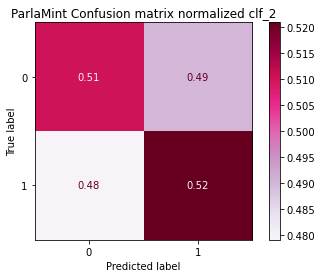

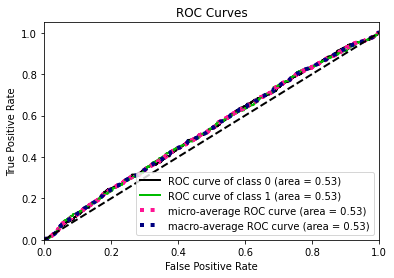

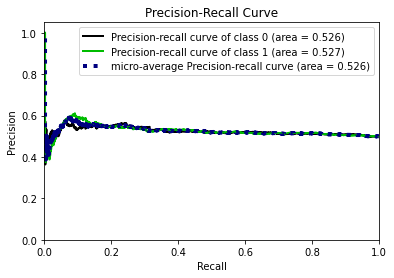

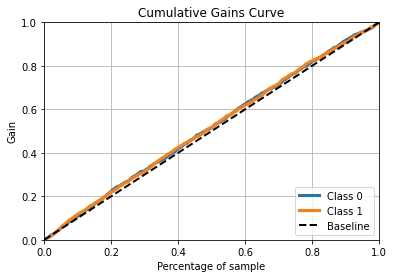

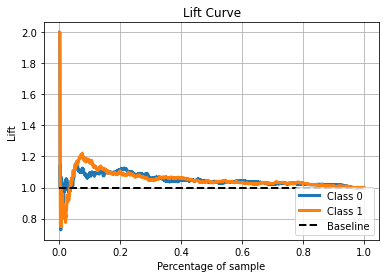

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.52      0.52      1200
           1       0.51      0.51      0.51      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



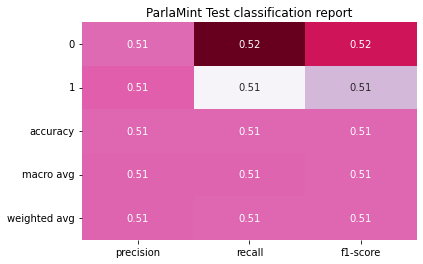


------------------------
  Confusion Matrix
------------------------


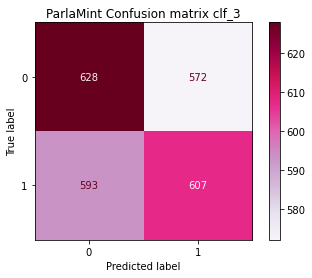

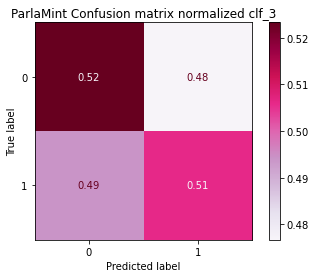

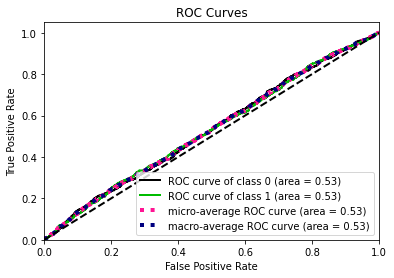

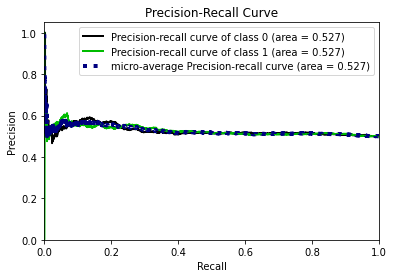

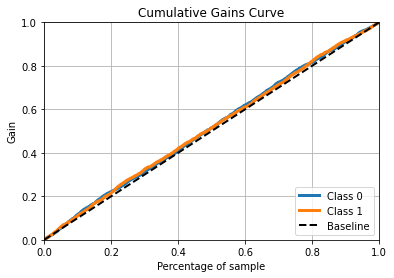

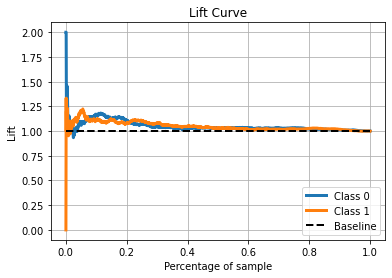

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.53      0.53      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



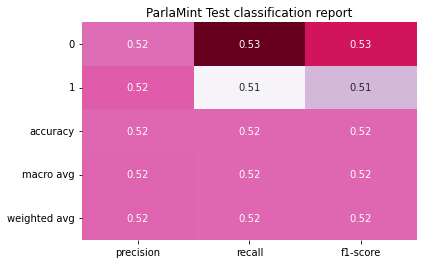


------------------------
  Confusion Matrix
------------------------


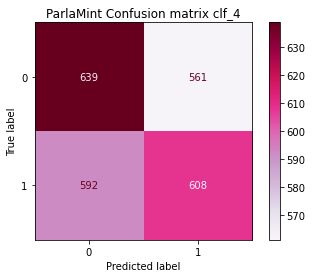

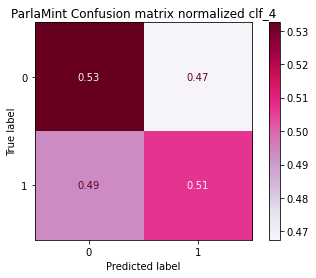

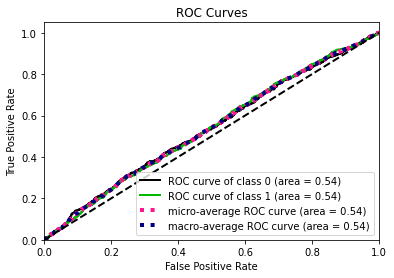

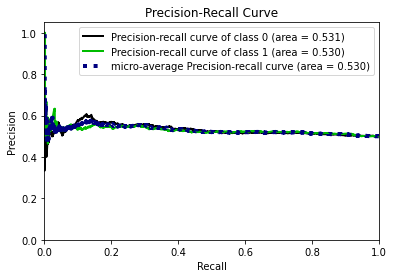

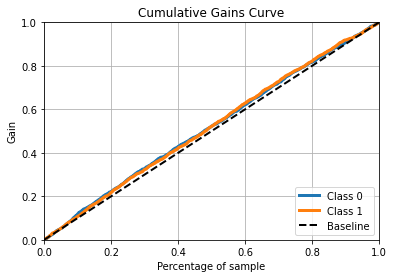

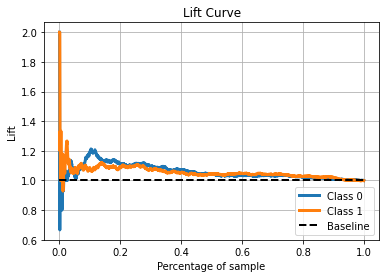

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.55      0.54      1200
           1       0.54      0.54      0.54      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



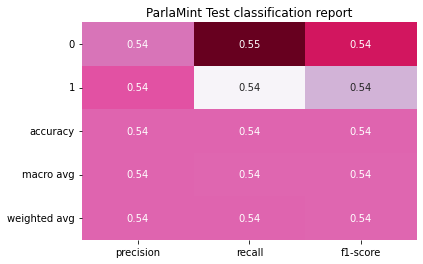


------------------------
  Confusion Matrix
------------------------


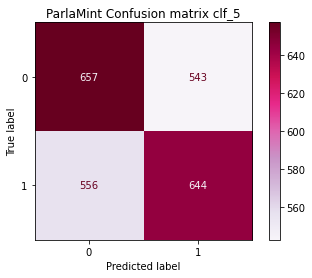

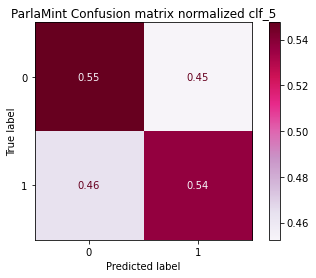

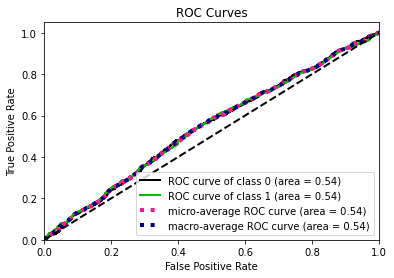

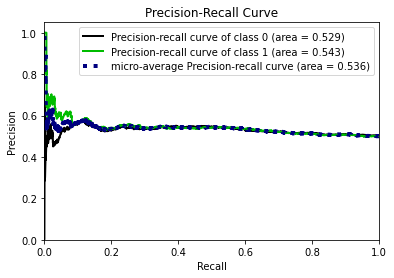

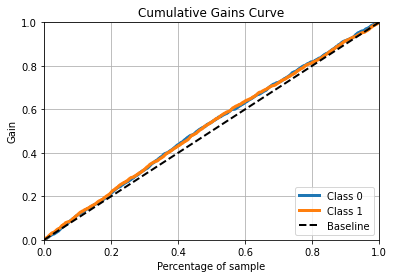

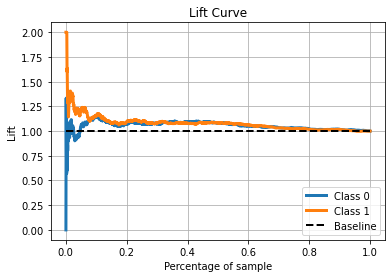

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.54      0.54      1200
           1       0.54      0.54      0.54      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



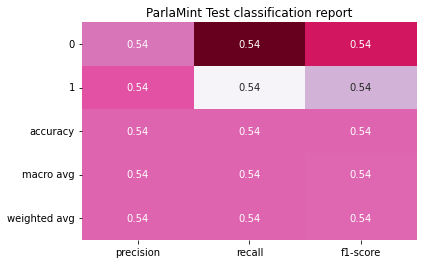


------------------------
  Confusion Matrix
------------------------


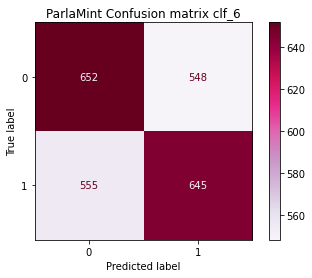

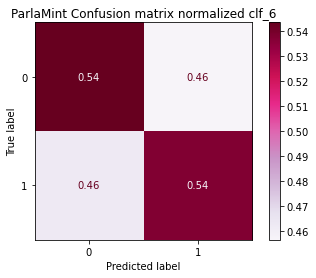

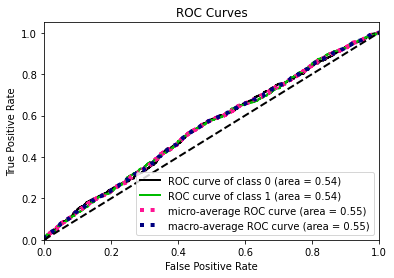

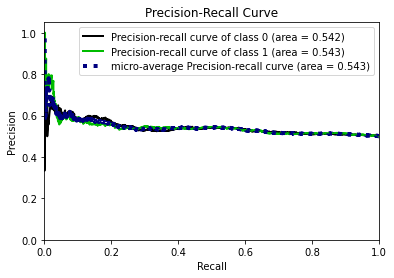

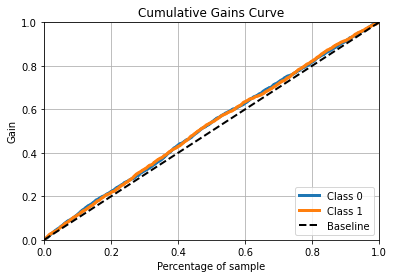

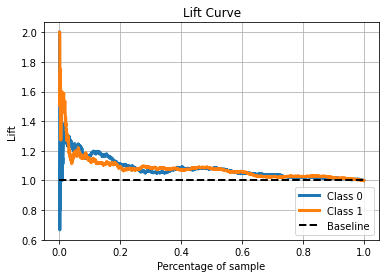

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.55      0.54      1200
           1       0.54      0.52      0.53      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



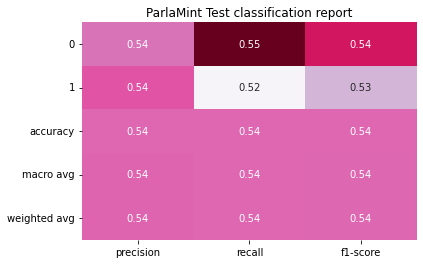


------------------------
  Confusion Matrix
------------------------


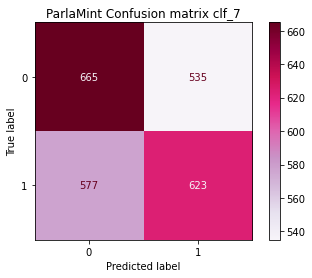

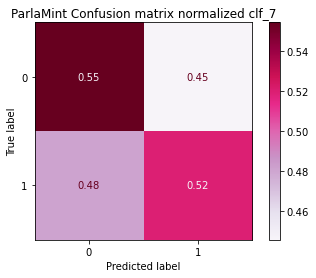

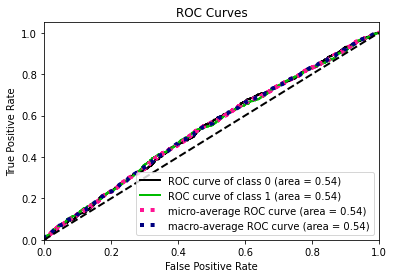

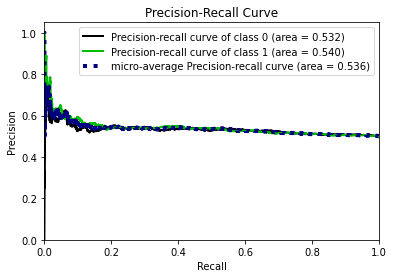

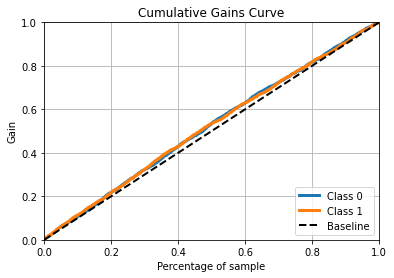

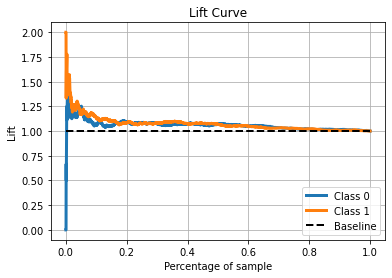

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.53      0.53      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



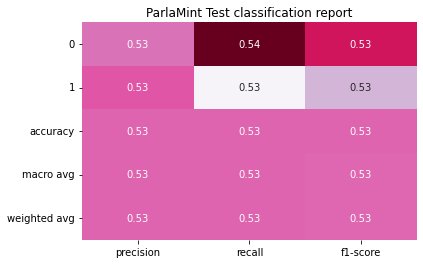


------------------------
  Confusion Matrix
------------------------


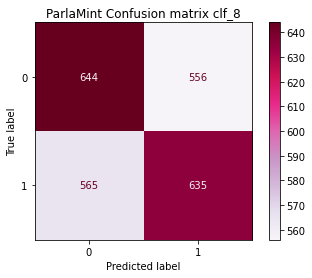

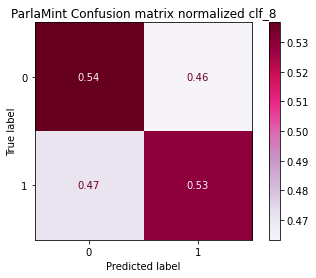

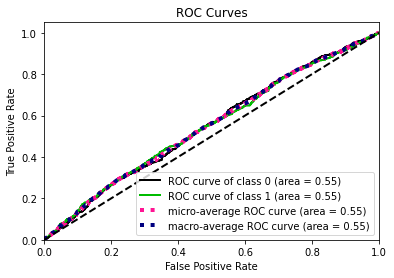

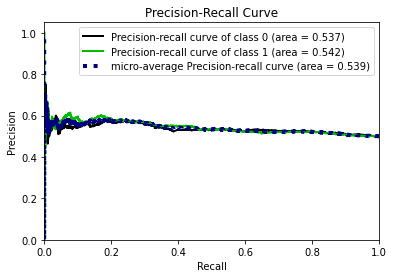

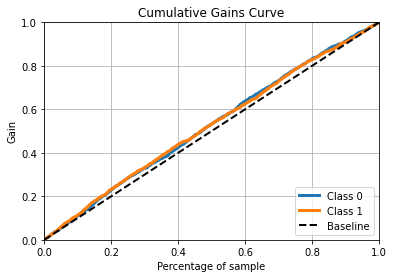

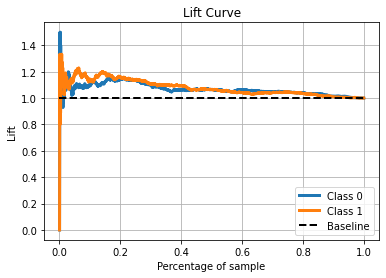

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.53      0.54      1200
           1       0.54      0.54      0.54      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



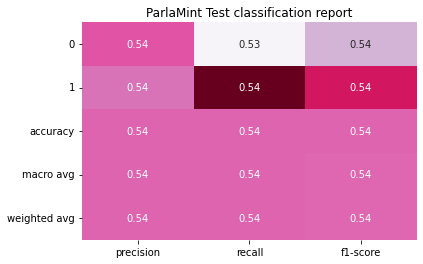


------------------------
  Confusion Matrix
------------------------


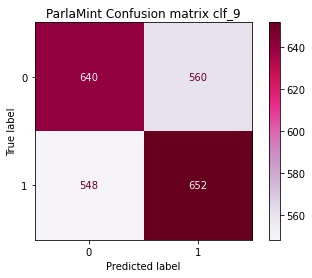

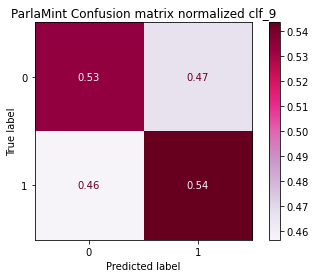

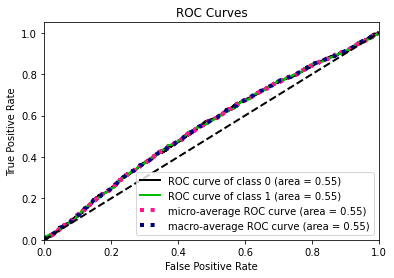

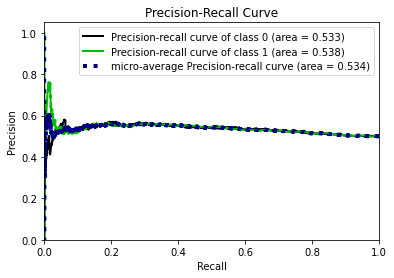

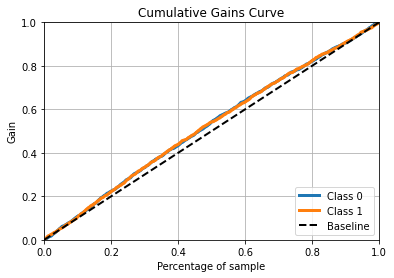

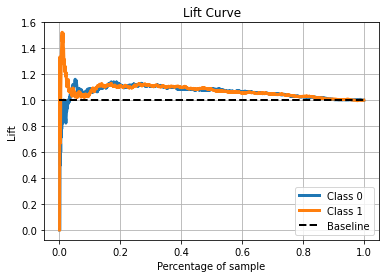

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.54      0.53      1200
           1       0.52      0.51      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



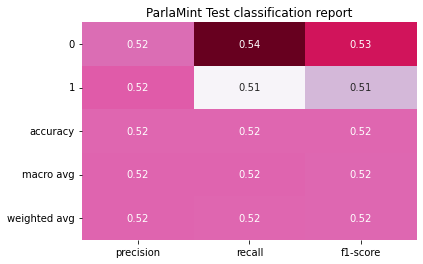


------------------------
  Confusion Matrix
------------------------


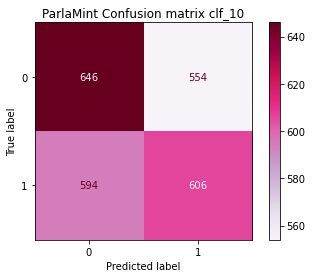

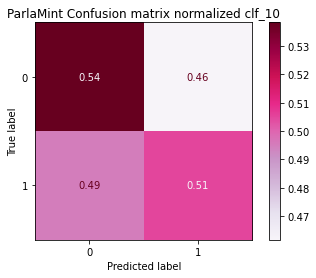

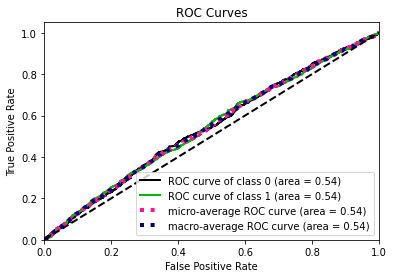

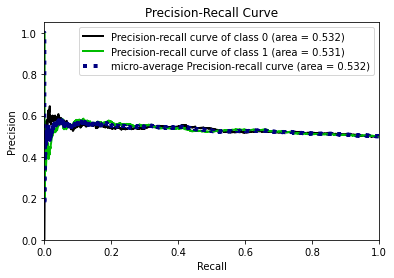

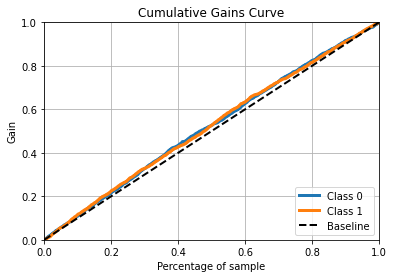

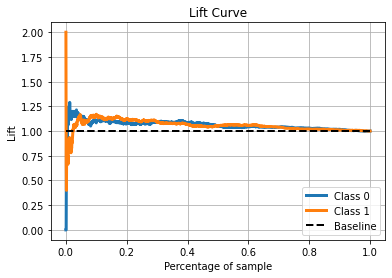

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.51      0.51      1200
           1       0.52      0.53      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



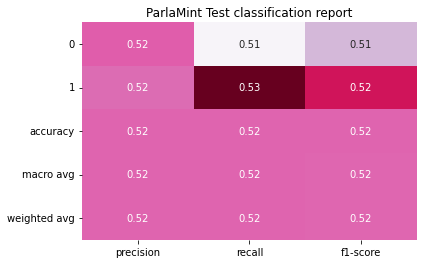


------------------------
  Confusion Matrix
------------------------


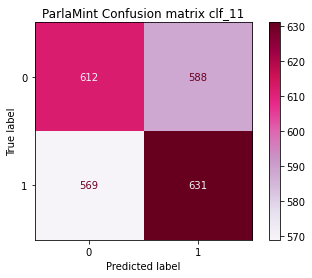

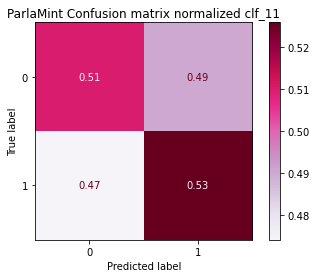

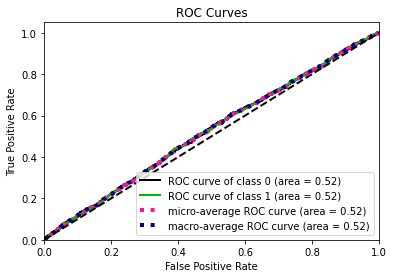

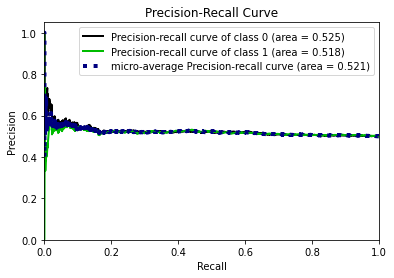

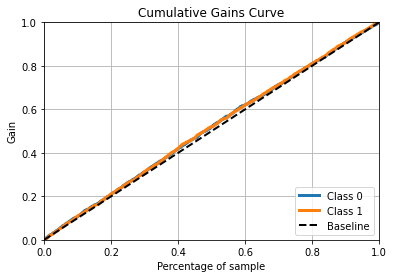

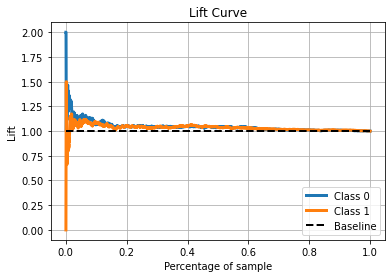

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.56      0.55      1200
           1       0.54      0.52      0.53      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



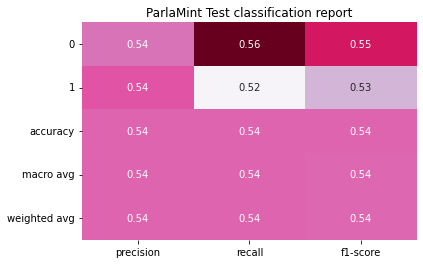


------------------------
  Confusion Matrix
------------------------


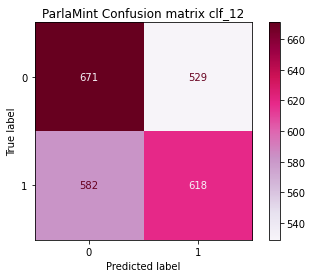

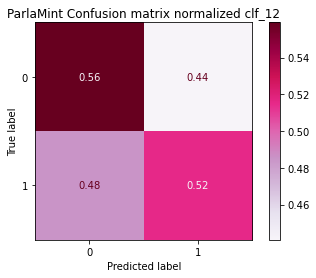

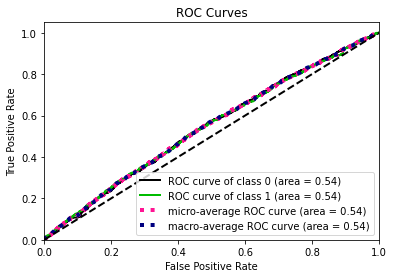

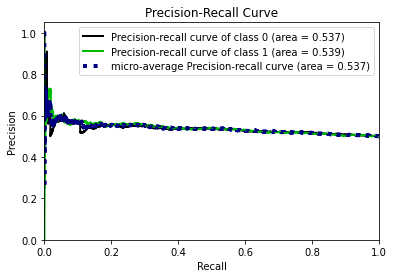

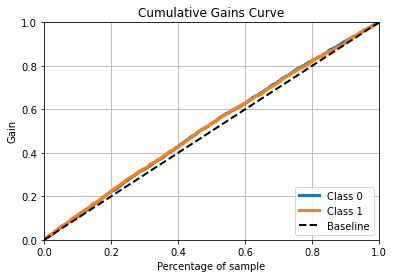

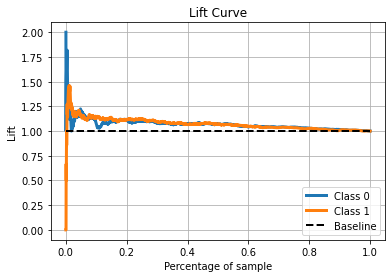

------------------------------------------------------------------------------------------------


In [21]:
lista_cm_normalizzate_svm_20, lista_clf_report_20 = \
        plot_classification_results(diz_dist_20_svm['df_dist_20'], False, diz_cmap['20'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.56      0.55      1200
           1       0.54      0.52      0.53      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



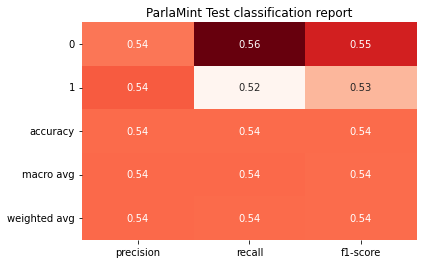


------------------------
  Confusion Matrix
------------------------


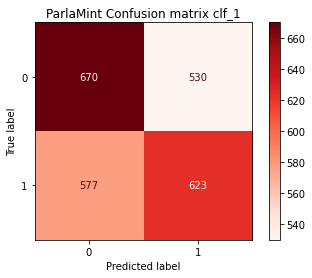

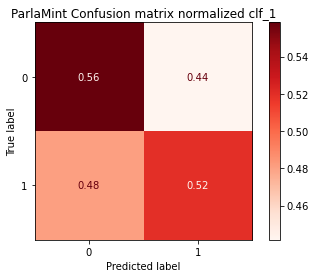

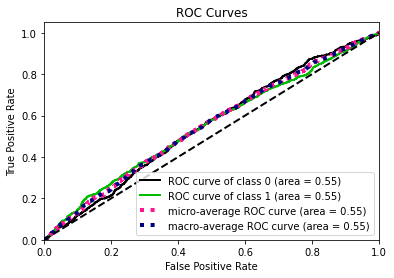

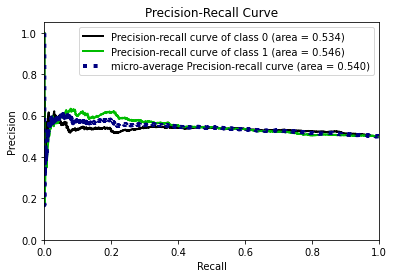

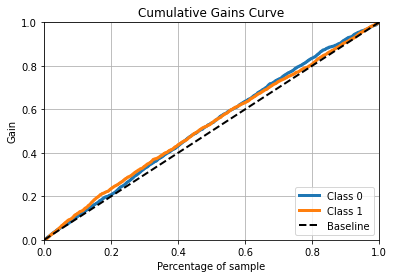

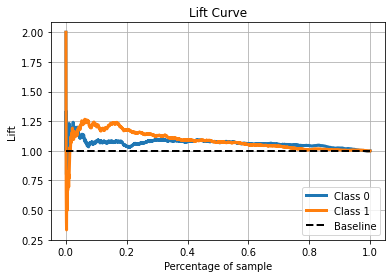

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.54      0.53      1200
           1       0.52      0.51      0.52      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



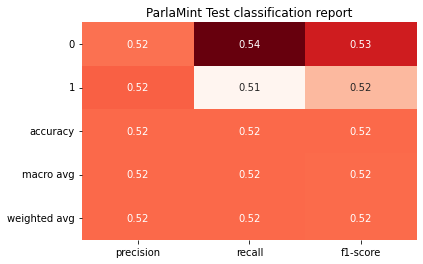


------------------------
  Confusion Matrix
------------------------


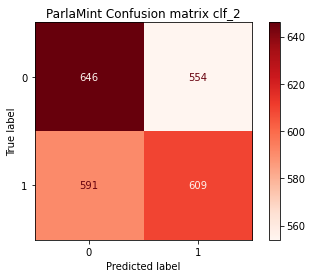

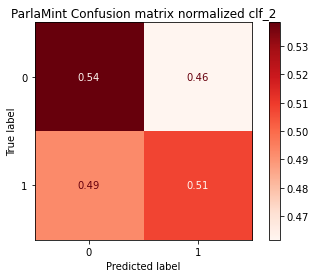

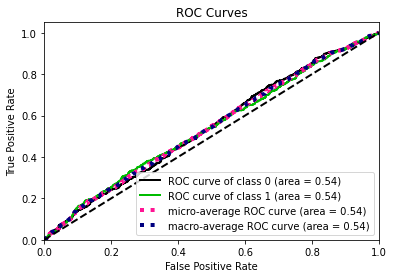

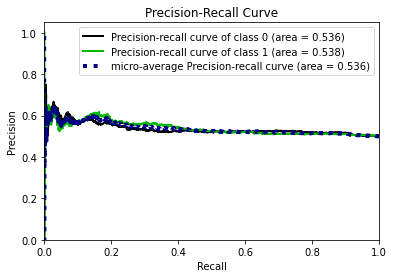

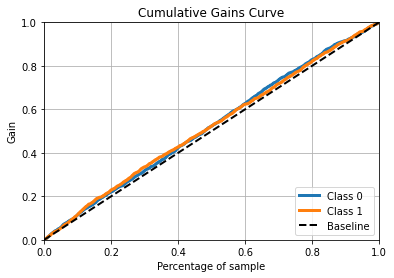

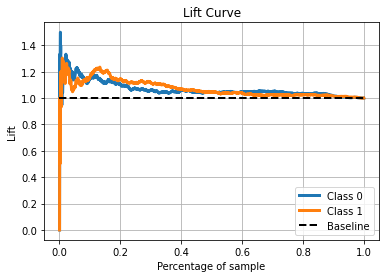

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.55      0.54      1200
           1       0.53      0.50      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



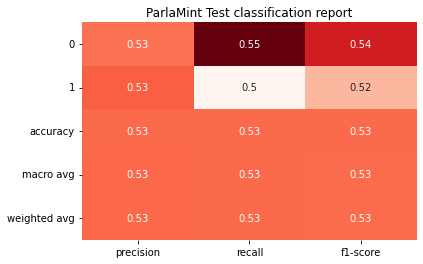


------------------------
  Confusion Matrix
------------------------


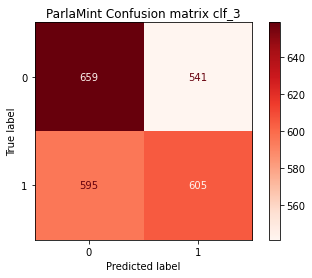

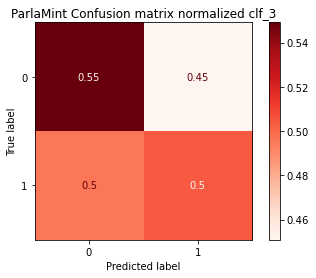

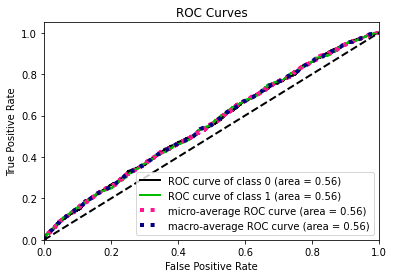

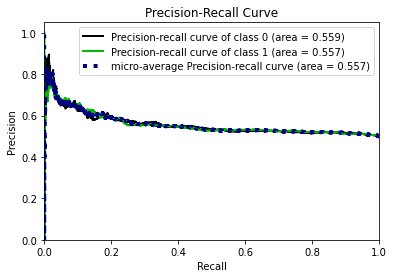

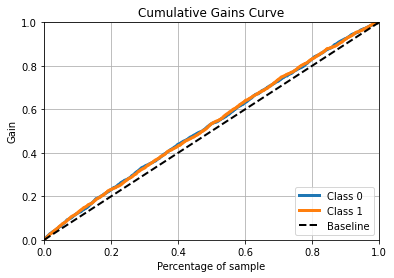

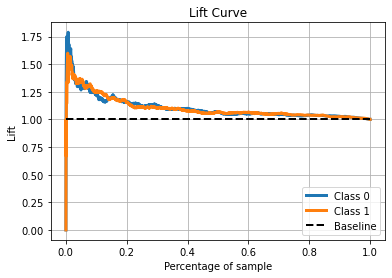

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.56      0.54      1200
           1       0.54      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



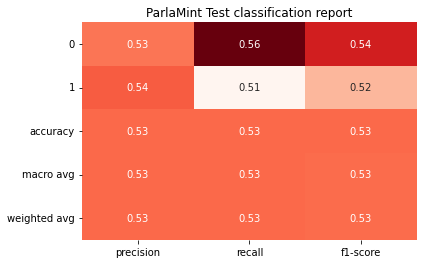


------------------------
  Confusion Matrix
------------------------


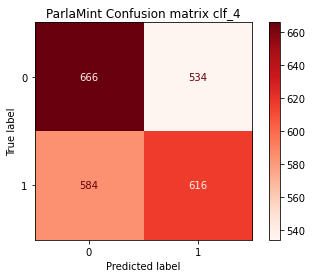

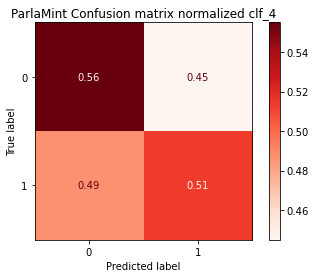

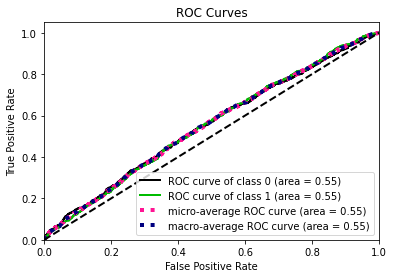

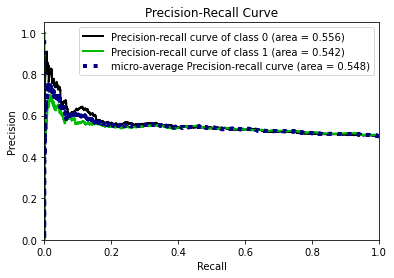

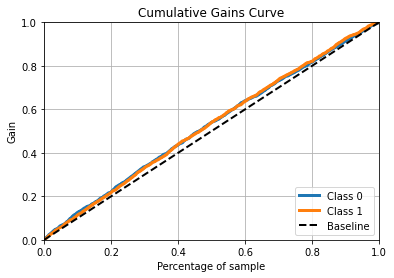

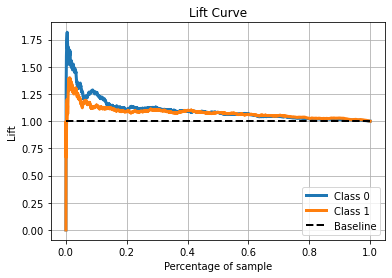

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.56      0.55      1200
           1       0.54      0.52      0.53      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



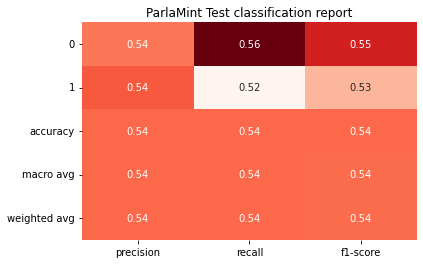


------------------------
  Confusion Matrix
------------------------


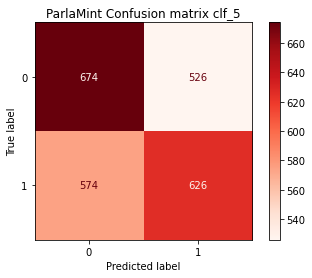

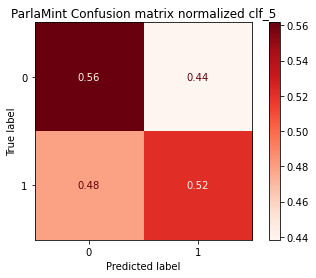

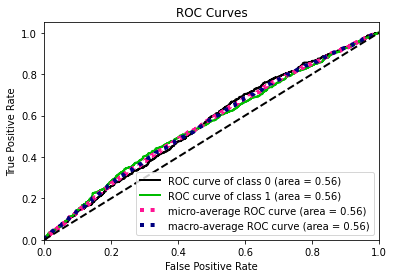

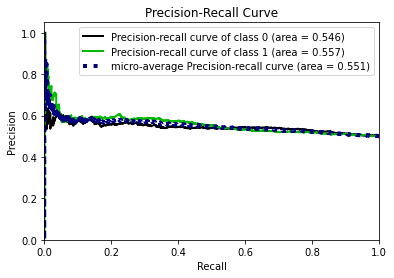

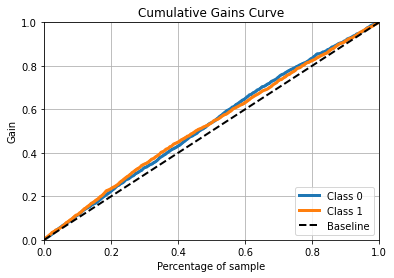

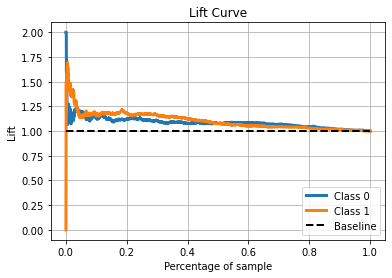

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.55      0.55      1200
           1       0.54      0.53      0.54      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



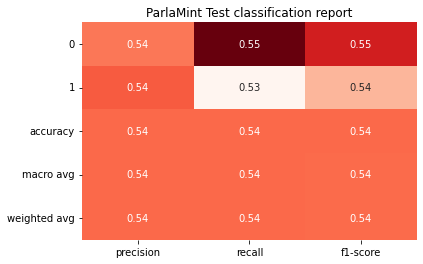


------------------------
  Confusion Matrix
------------------------


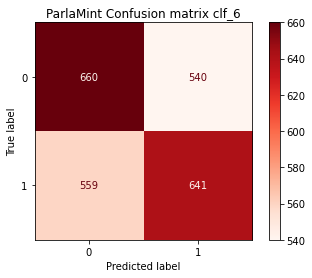

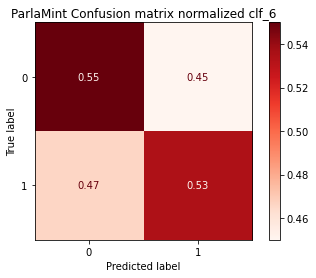

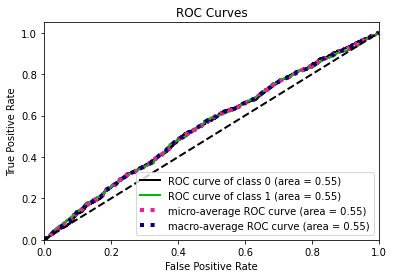

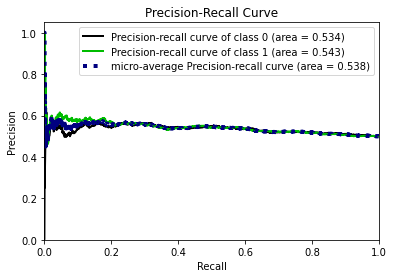

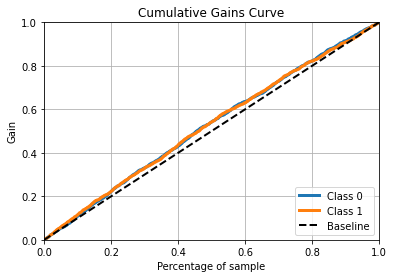

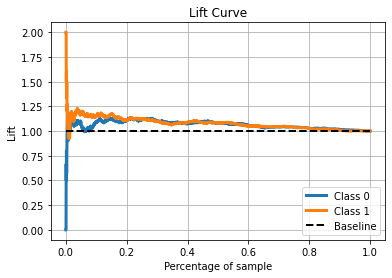

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.56      0.54      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



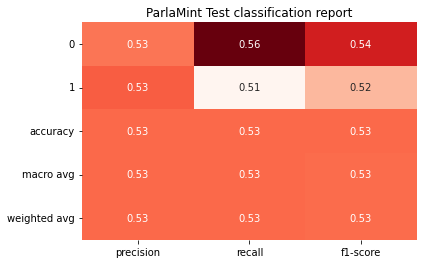


------------------------
  Confusion Matrix
------------------------


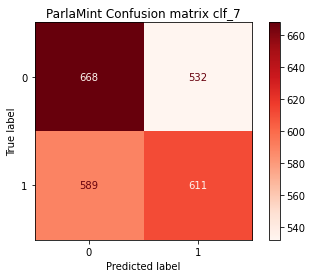

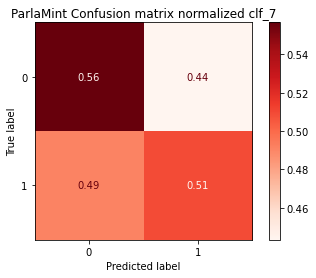

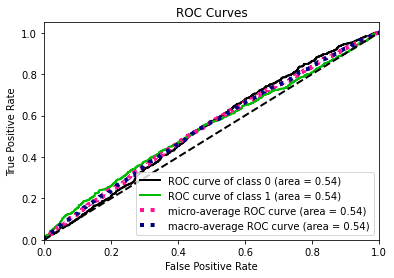

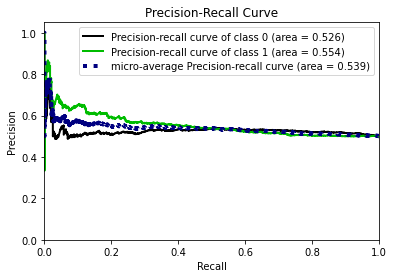

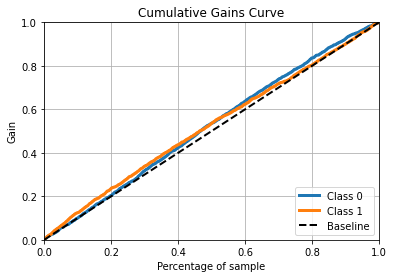

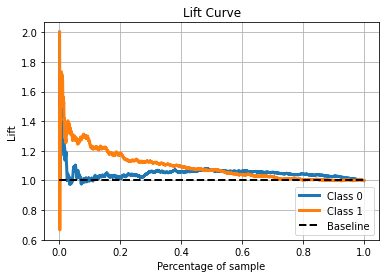

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.54      1200
           1       0.54      0.53      0.53      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



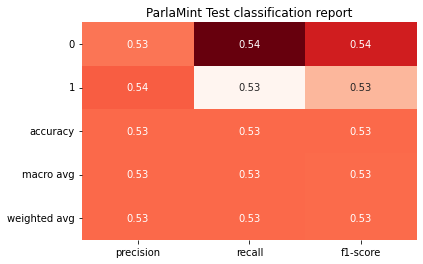


------------------------
  Confusion Matrix
------------------------


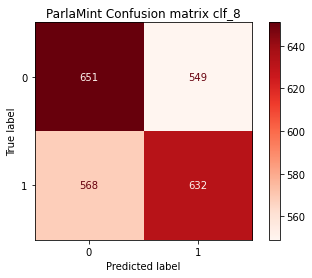

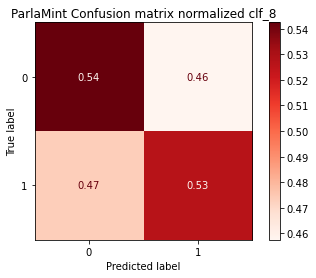

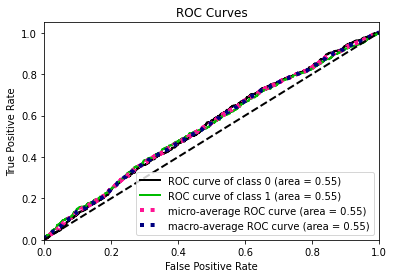

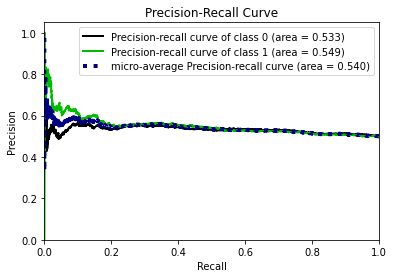

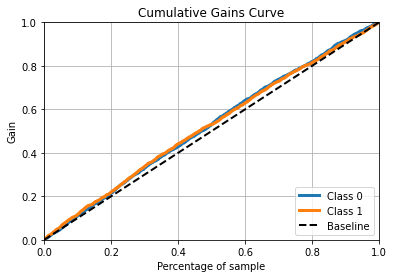

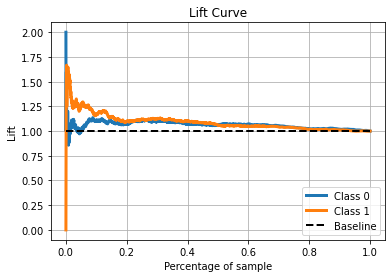

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.52      0.54      0.53      1200
           1       0.52      0.50      0.51      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.52      2400
weighted avg       0.52      0.52      0.52      2400



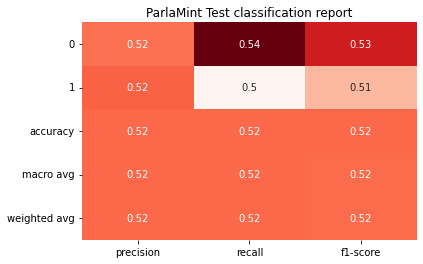


------------------------
  Confusion Matrix
------------------------


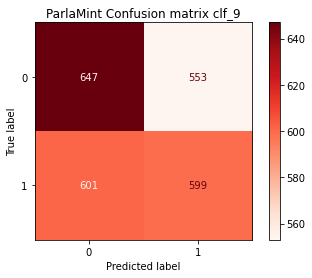

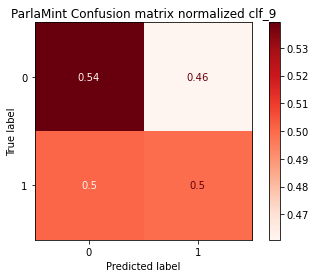

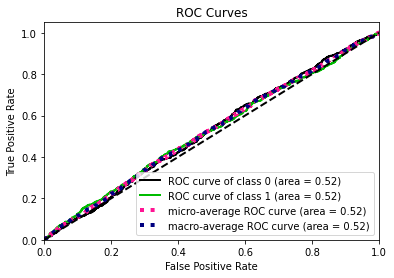

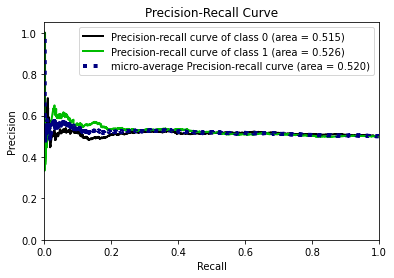

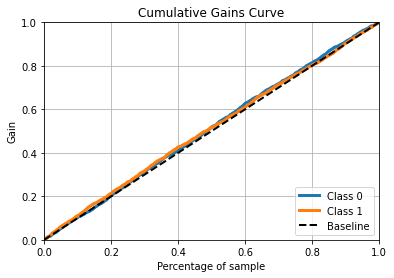

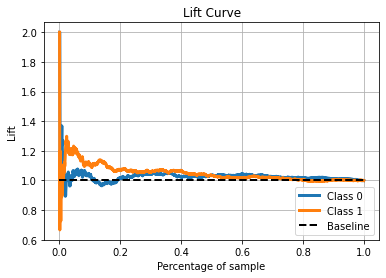

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.54      0.53      1200
           1       0.53      0.52      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



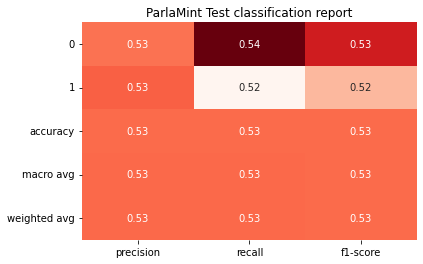


------------------------
  Confusion Matrix
------------------------


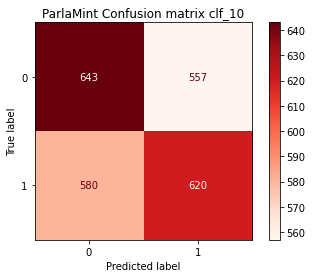

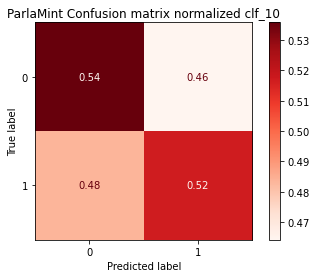

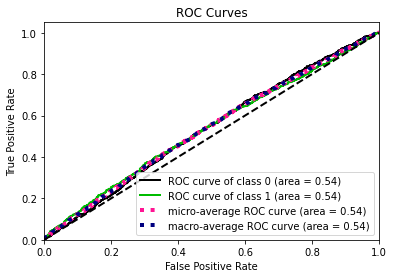

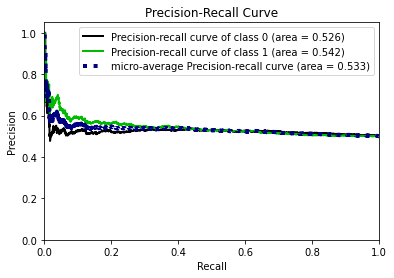

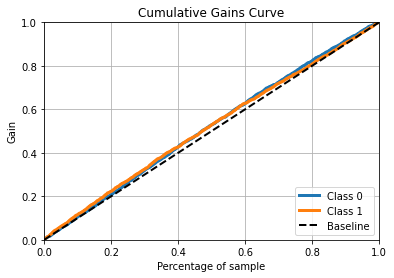

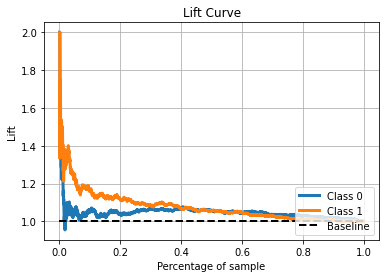

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.55      0.54      1200
           1       0.53      0.51      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



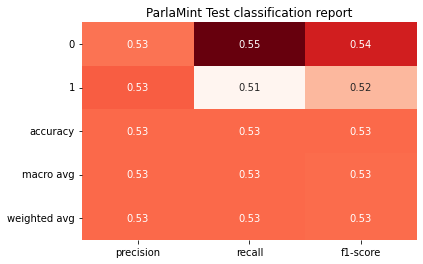


------------------------
  Confusion Matrix
------------------------


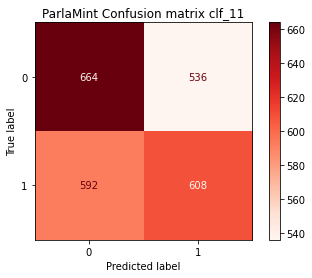

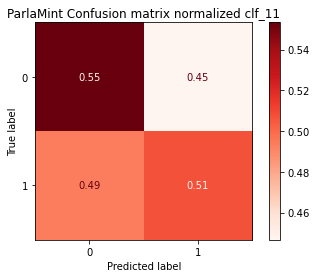

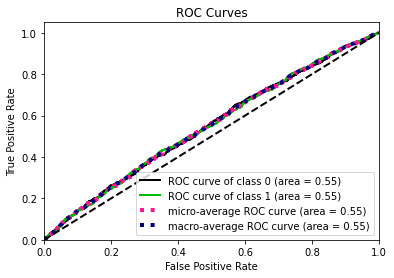

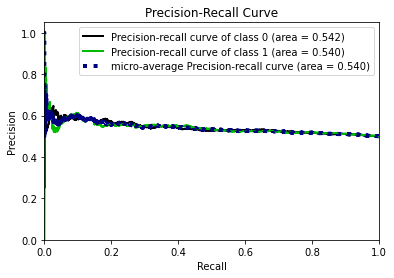

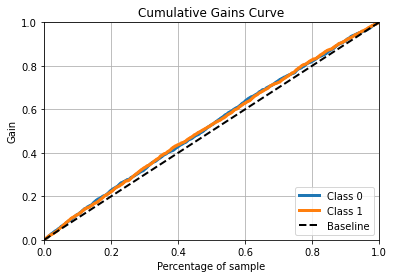

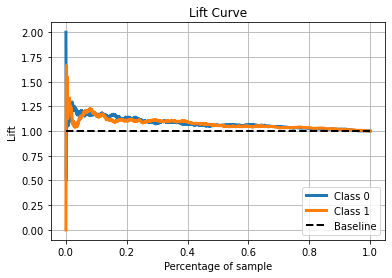

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.55      0.54      1200
           1       0.53      0.52      0.52      1200

    accuracy                           0.53      2400
   macro avg       0.53      0.53      0.53      2400
weighted avg       0.53      0.53      0.53      2400



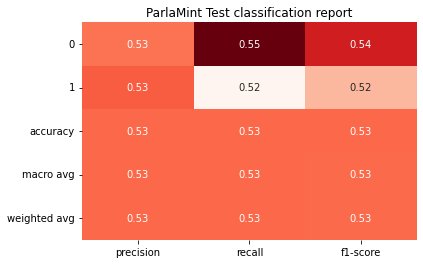


------------------------
  Confusion Matrix
------------------------


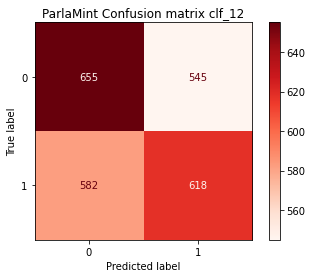

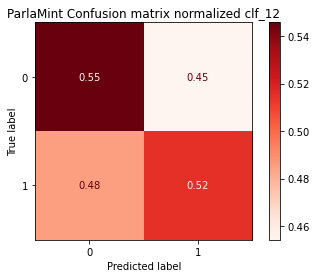

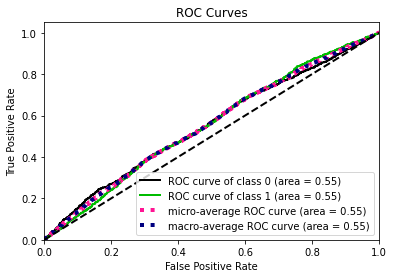

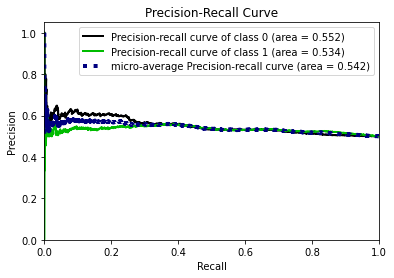

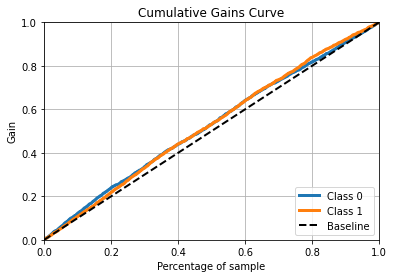

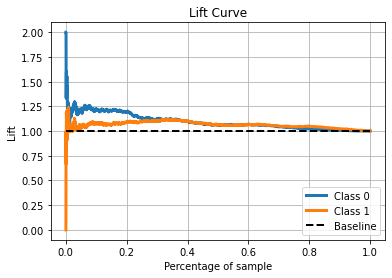

------------------------------------------------------------------------------------------------


In [22]:
lista_cm_normalizzate_svm_30, lista_clf_report_30 = \
        plot_classification_results(diz_dist_30_svm['df_dist_30'], False, diz_cmap['30'])

Clf_1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.61      0.68      0.64      1200
           1       0.64      0.56      0.60      1200

    accuracy                           0.62      2400
   macro avg       0.62      0.62      0.62      2400
weighted avg       0.62      0.62      0.62      2400



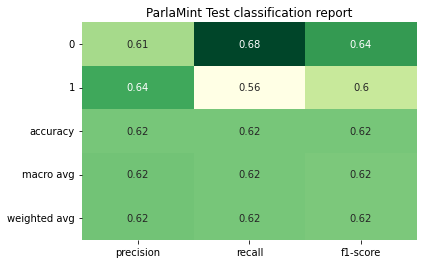


------------------------
  Confusion Matrix
------------------------


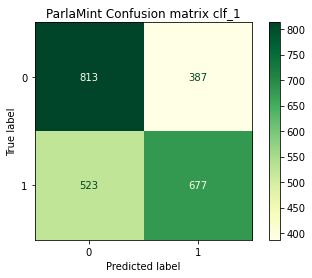

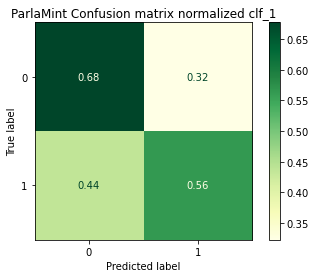

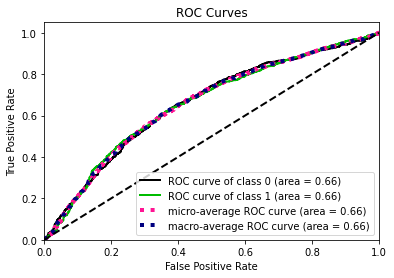

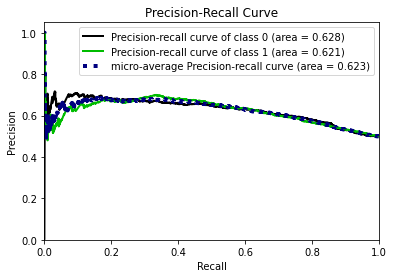

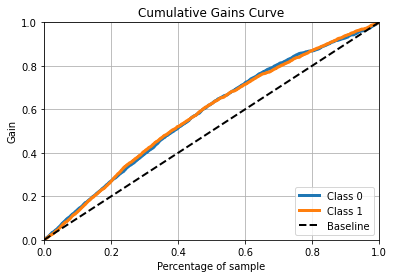

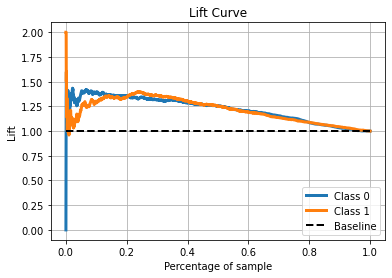

------------------------------------------------------------------------------------------------
Clf_2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.66      0.63      1200
           1       0.62      0.56      0.59      1200

    accuracy                           0.61      2400
   macro avg       0.61      0.61      0.61      2400
weighted avg       0.61      0.61      0.61      2400



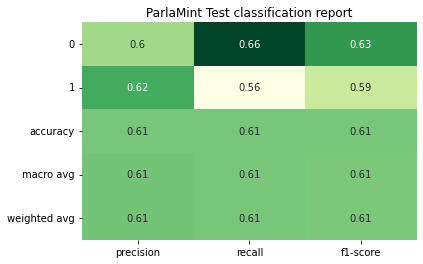


------------------------
  Confusion Matrix
------------------------


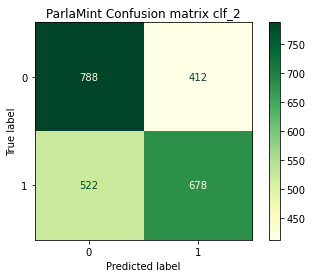

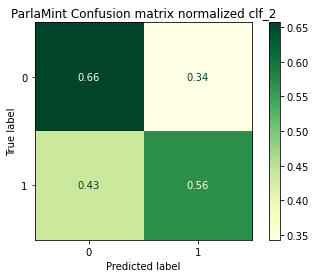

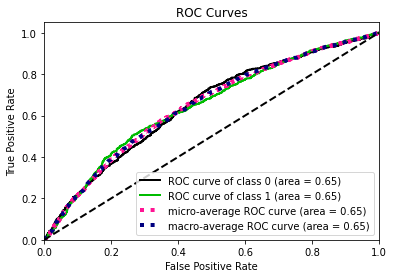

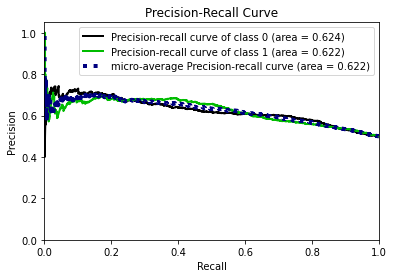

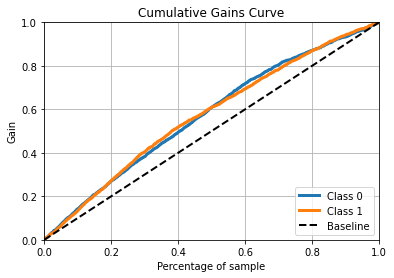

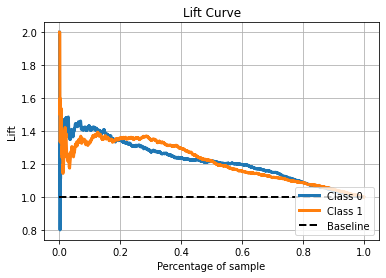

------------------------------------------------------------------------------------------------
Clf_3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.65      0.62      1200
           1       0.61      0.56      0.59      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



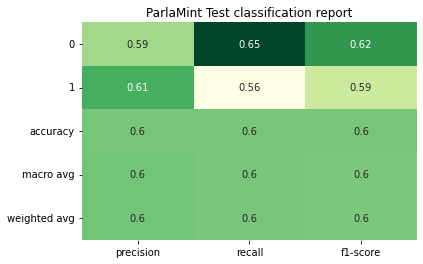


------------------------
  Confusion Matrix
------------------------


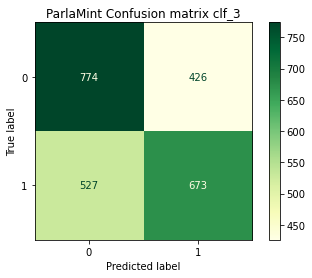

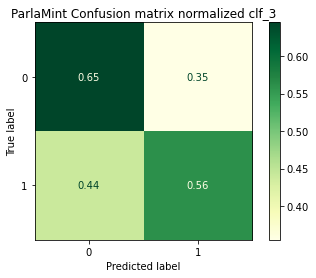

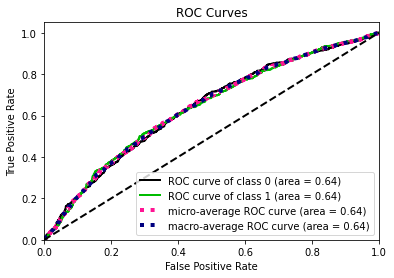

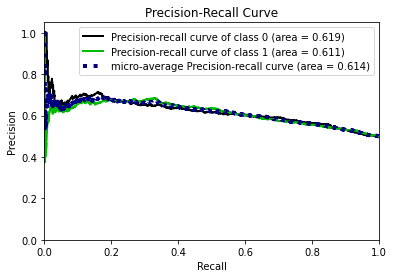

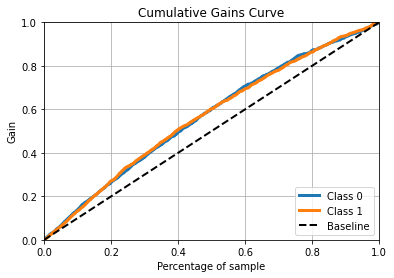

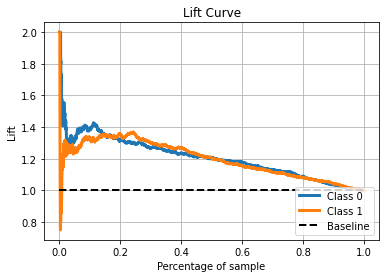

------------------------------------------------------------------------------------------------
Clf_4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.64      0.62      1200
           1       0.61      0.57      0.59      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



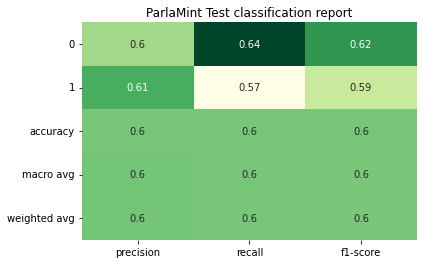


------------------------
  Confusion Matrix
------------------------


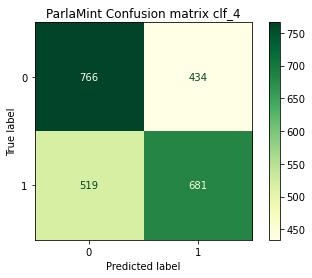

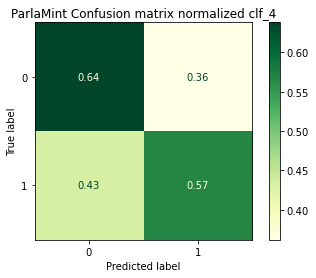

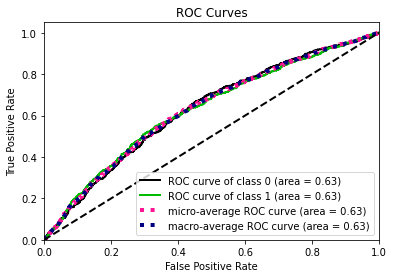

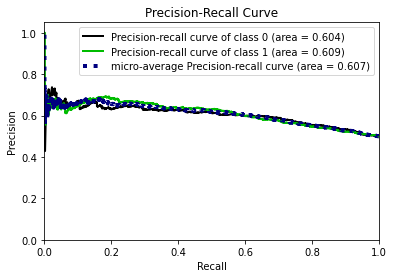

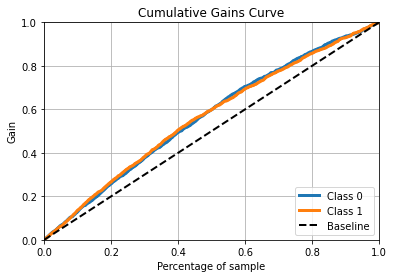

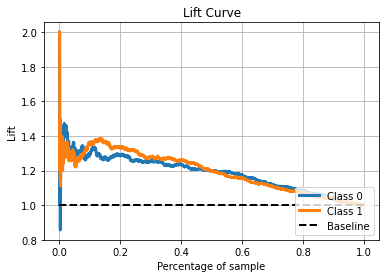

------------------------------------------------------------------------------------------------
Clf_5
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.64      0.61      1200
           1       0.61      0.55      0.58      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



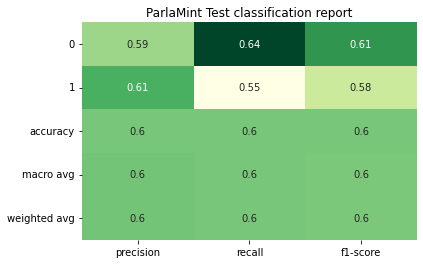


------------------------
  Confusion Matrix
------------------------


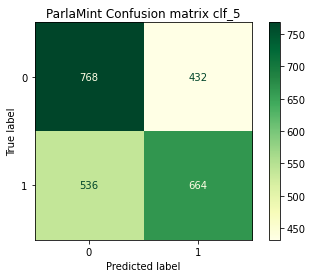

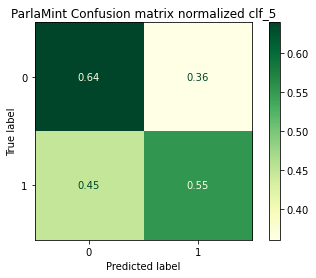

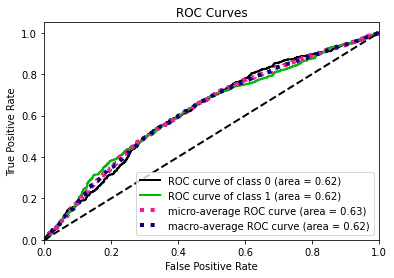

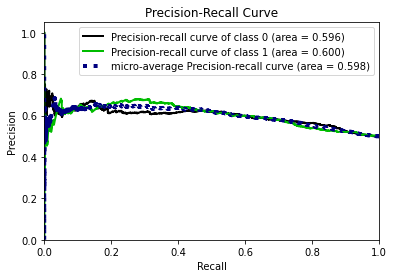

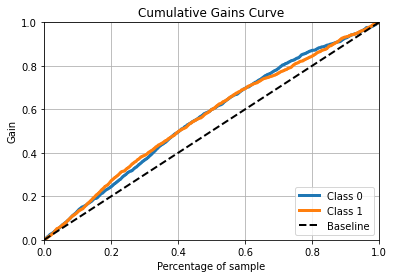

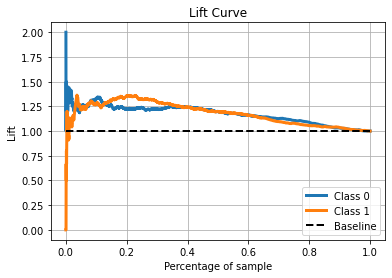

------------------------------------------------------------------------------------------------
Clf_6
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.64      0.62      1200
           1       0.61      0.56      0.58      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



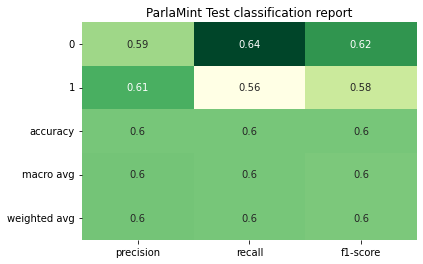


------------------------
  Confusion Matrix
------------------------


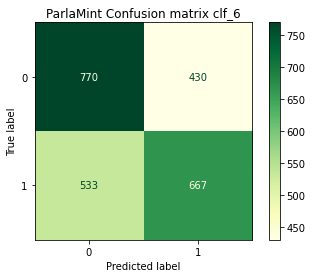

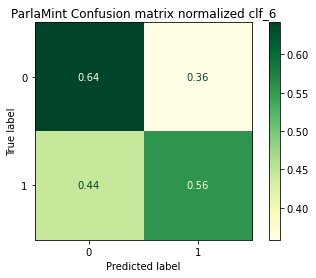

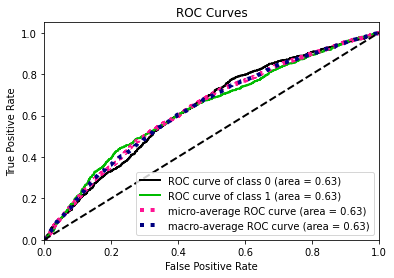

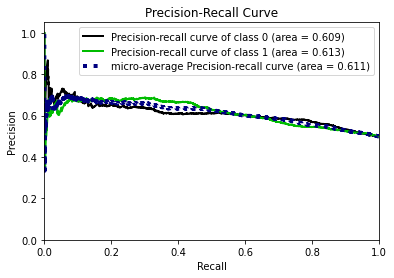

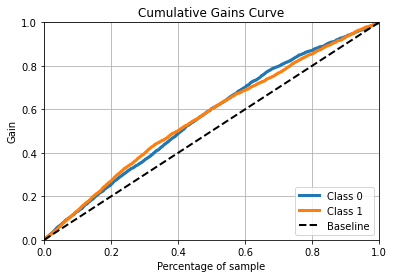

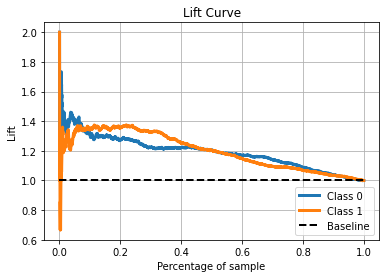

------------------------------------------------------------------------------------------------
Clf_7
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.64      0.62      1200
           1       0.62      0.58      0.60      1200

    accuracy                           0.61      2400
   macro avg       0.61      0.61      0.61      2400
weighted avg       0.61      0.61      0.61      2400



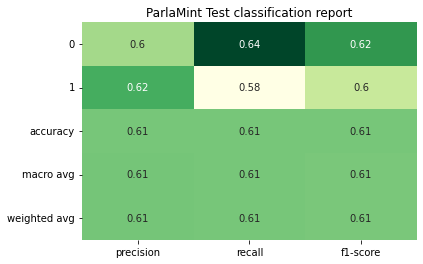


------------------------
  Confusion Matrix
------------------------


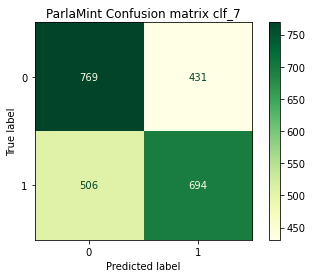

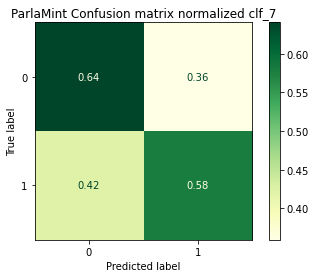

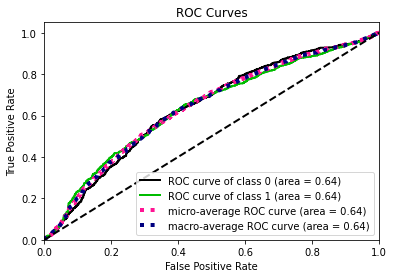

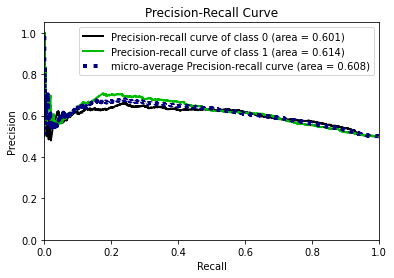

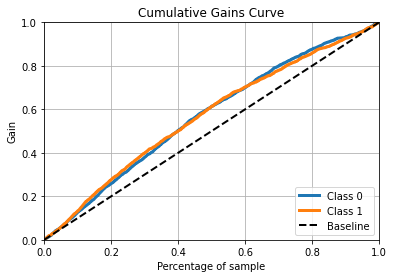

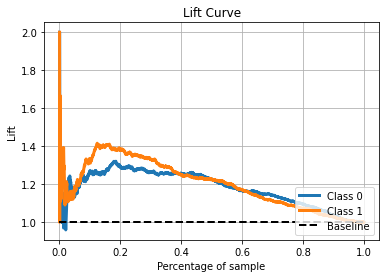

------------------------------------------------------------------------------------------------
Clf_8
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.62      0.60      1200
           1       0.60      0.56      0.58      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



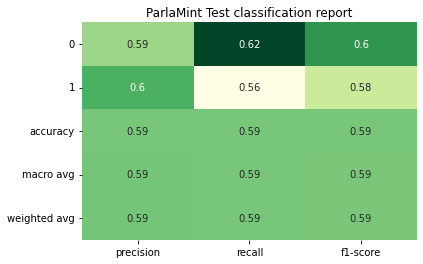


------------------------
  Confusion Matrix
------------------------


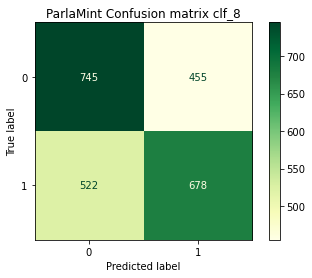

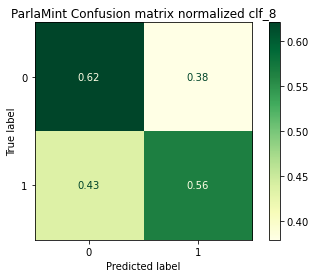

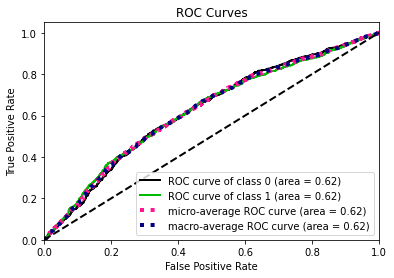

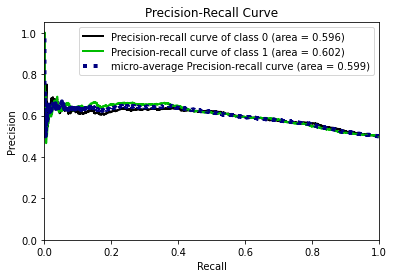

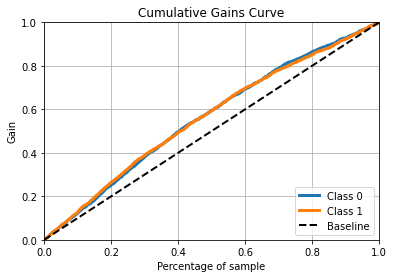

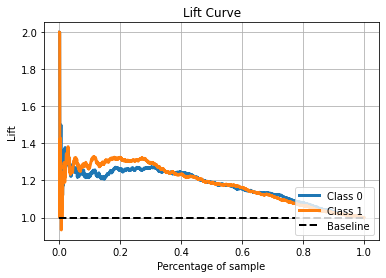

------------------------------------------------------------------------------------------------
Clf_9
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.58      0.64      0.61      1200
           1       0.60      0.55      0.57      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



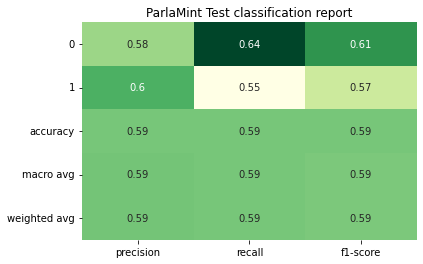


------------------------
  Confusion Matrix
------------------------


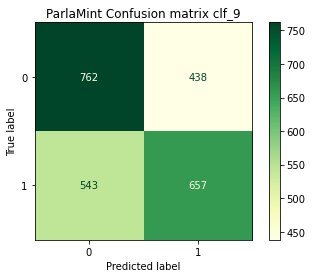

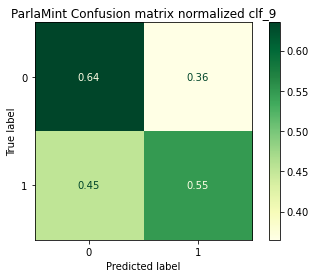

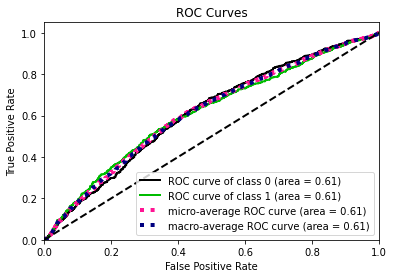

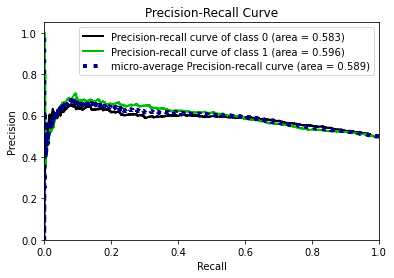

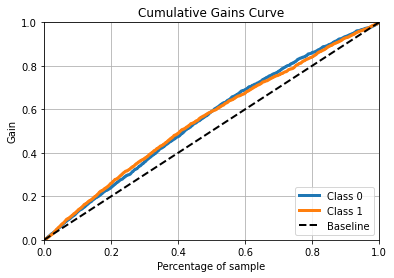

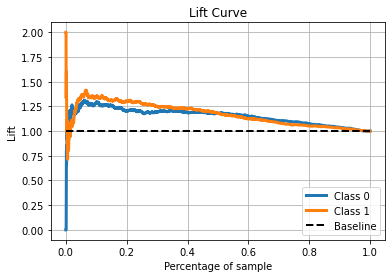

------------------------------------------------------------------------------------------------
Clf_10
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.58      0.64      0.61      1200
           1       0.60      0.54      0.57      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



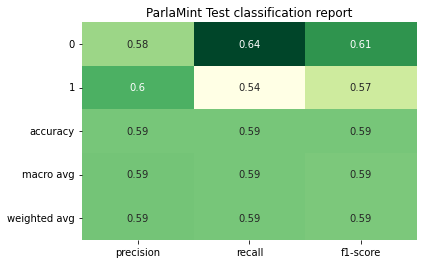


------------------------
  Confusion Matrix
------------------------


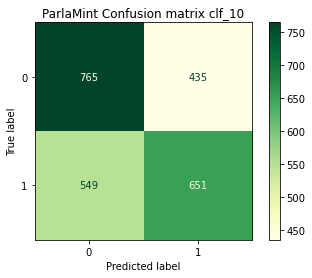

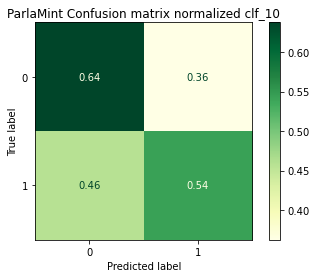

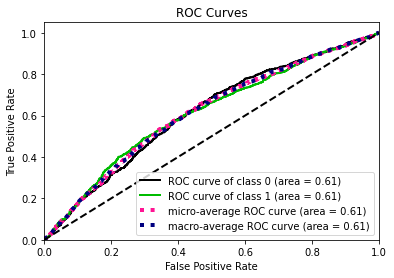

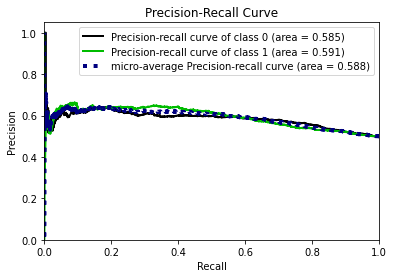

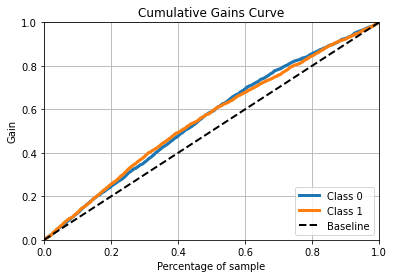

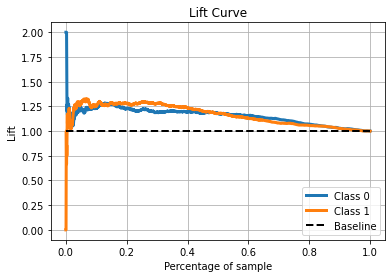

------------------------------------------------------------------------------------------------
Clf_11
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.63      0.61      1200
           1       0.60      0.56      0.58      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



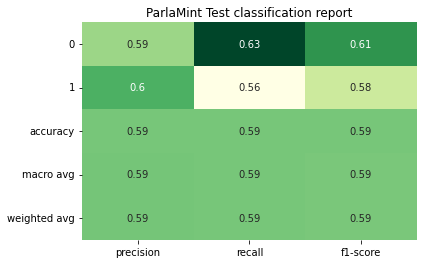


------------------------
  Confusion Matrix
------------------------


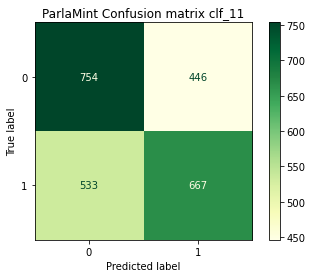

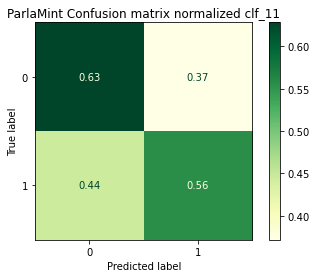

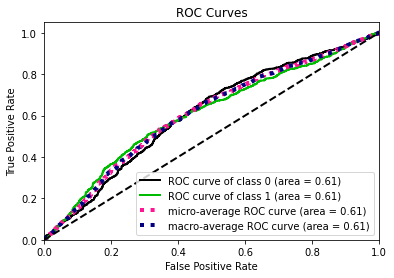

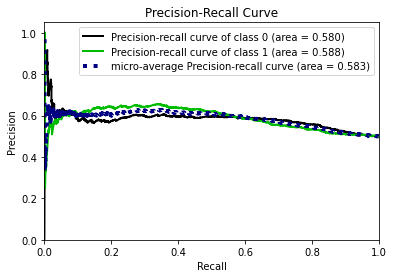

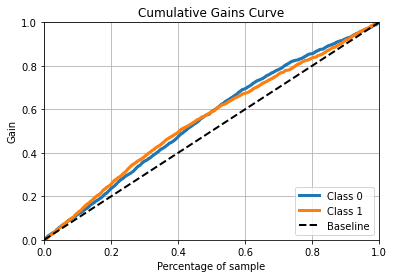

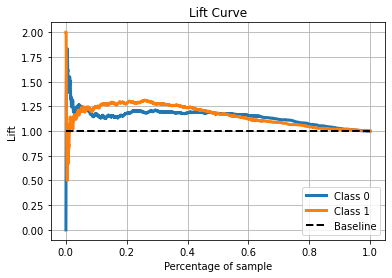

------------------------------------------------------------------------------------------------
Clf_12
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.61      0.68      0.64      1200
           1       0.64      0.57      0.60      1200

    accuracy                           0.62      2400
   macro avg       0.62      0.62      0.62      2400
weighted avg       0.62      0.62      0.62      2400



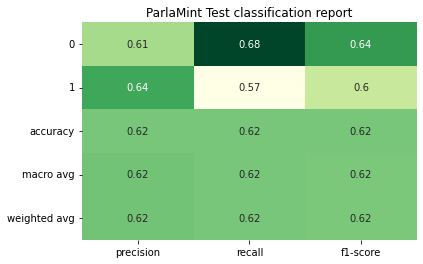


------------------------
  Confusion Matrix
------------------------


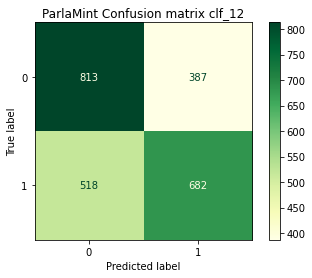

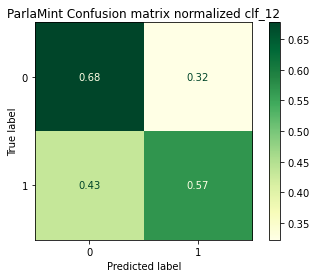

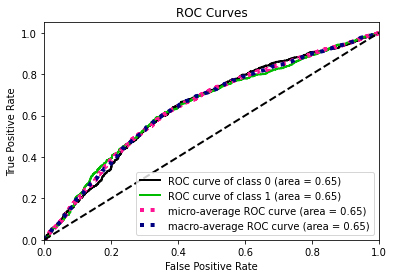

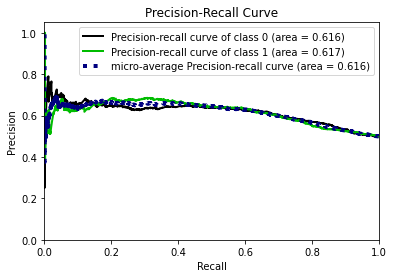

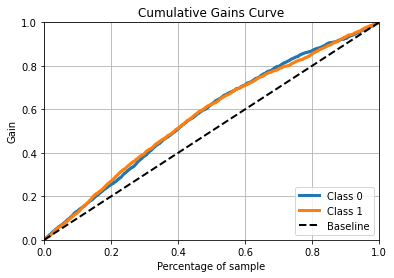

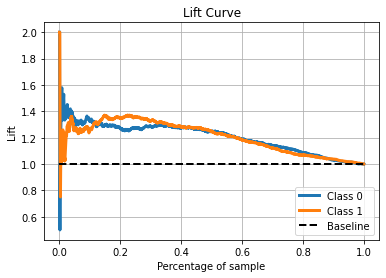

------------------------------------------------------------------------------------------------


In [23]:
lista_cm_normalizzate_svm_random_speech, lista_clf_report_random_speech = \
        plot_classification_results(diz_random_speech_svm['df_random_speech'], False, diz_cmap['random_speech'])

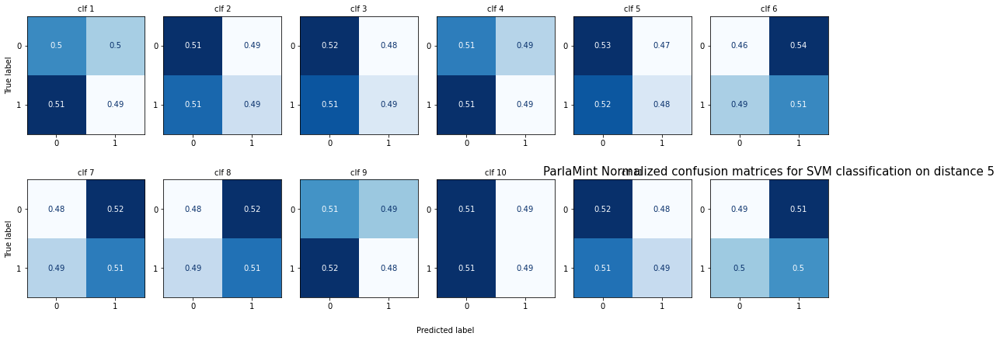

In [24]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_5, 'SVM', '5', diz_cmap['5'])

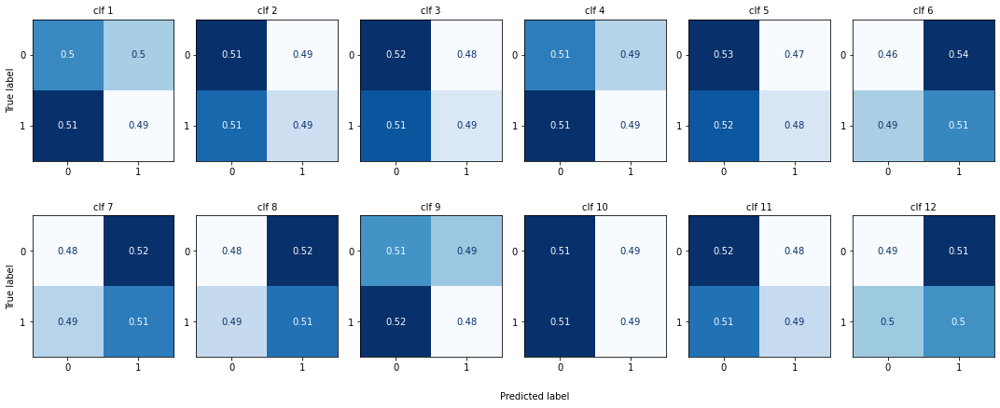

In [25]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_5, 'SVM', '5', diz_cmap['5'], 'ridotto')

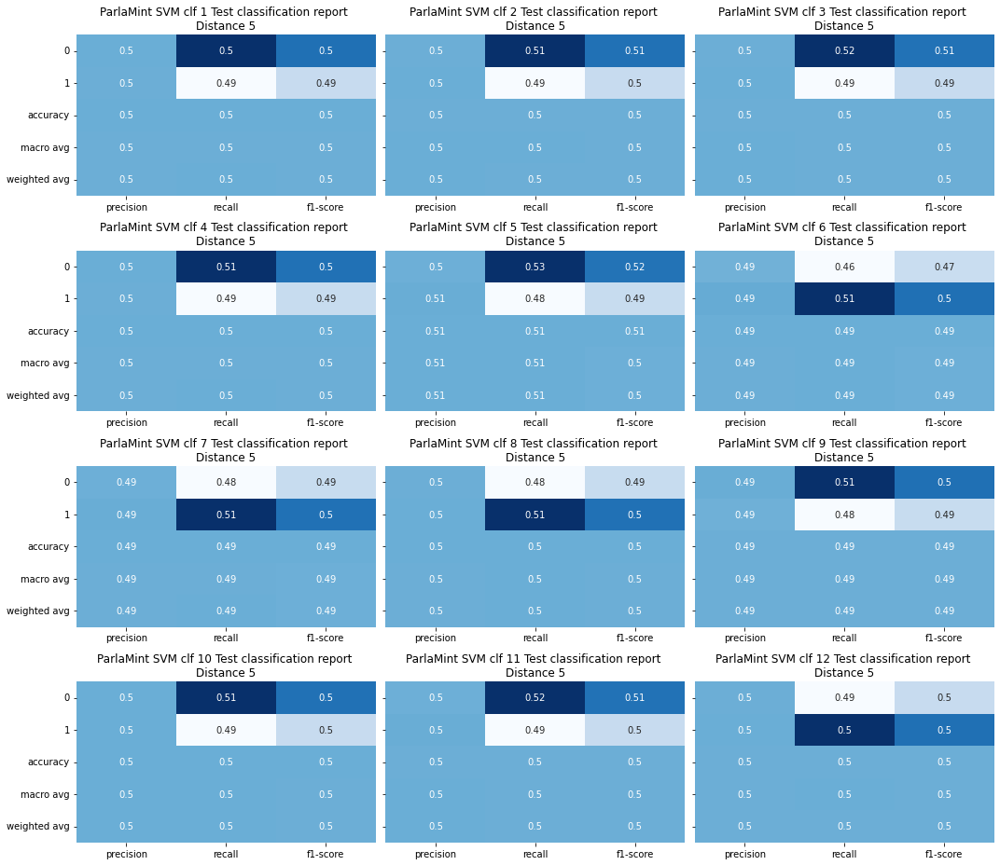

In [26]:
plot_all_classification_report(lista_clf_report_5, '5', diz_cmap['5'], 'SVM')

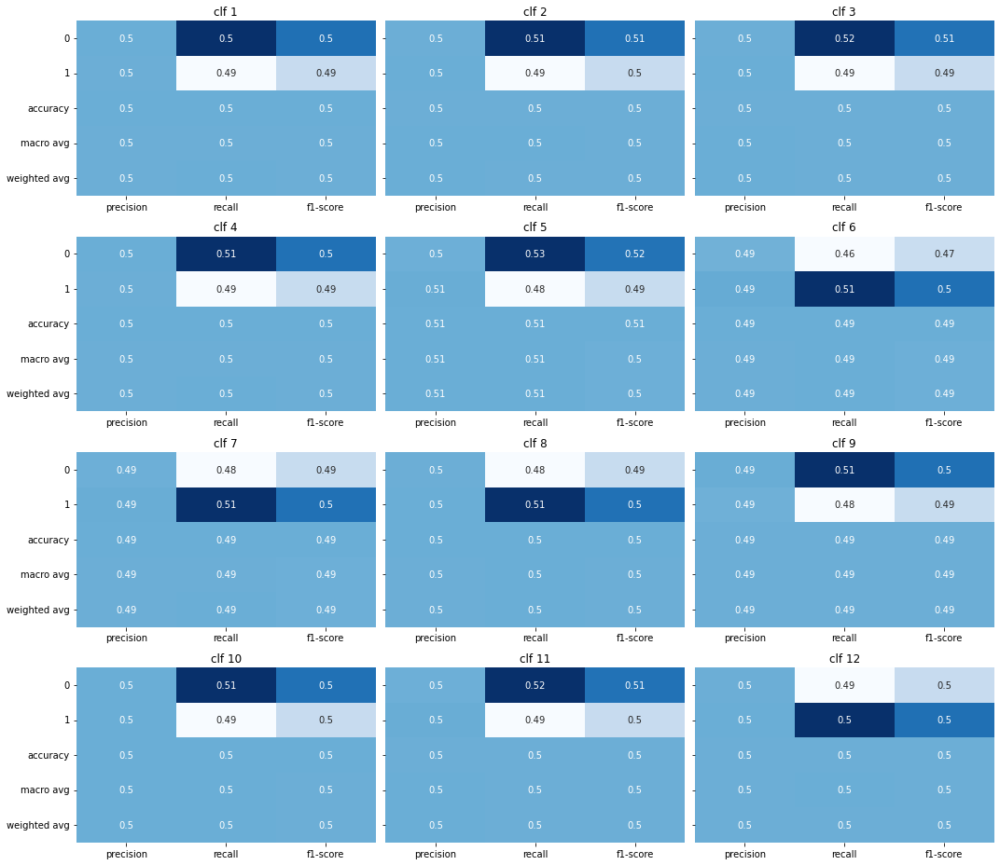

In [27]:
plot_all_classification_report(lista_clf_report_5, '5', diz_cmap['5'], 'SVM', 'ridotto')

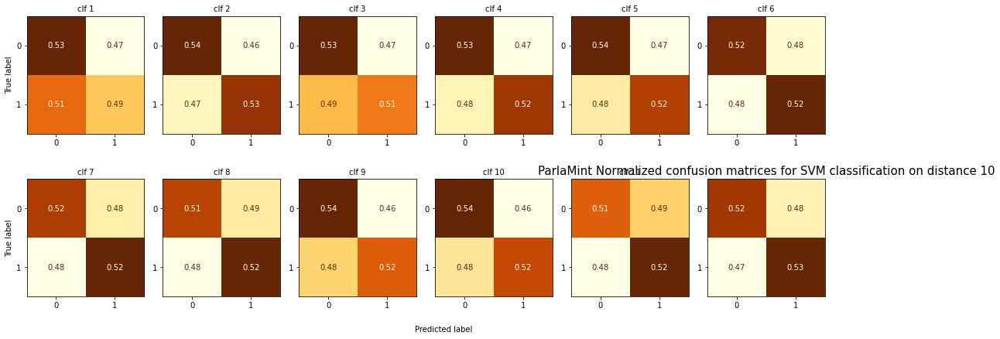

In [28]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_10, 'SVM', '10', diz_cmap['10'])    

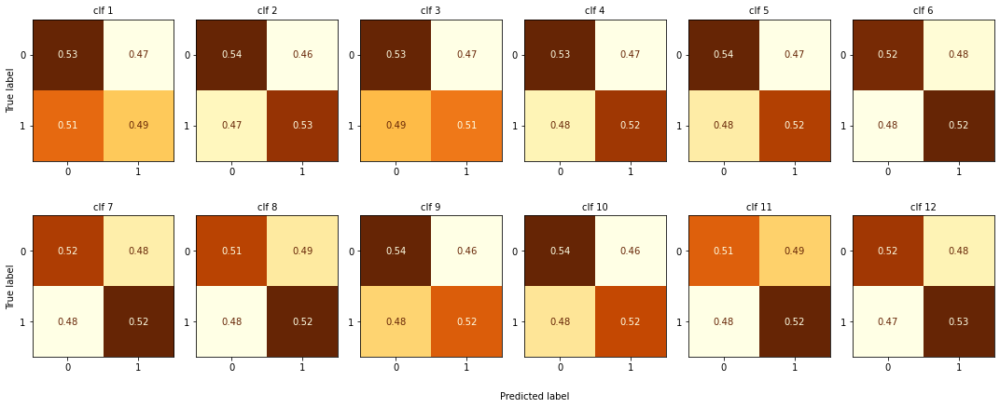

In [29]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_10, 'SVM', '10', diz_cmap['10'], 'ridotto')

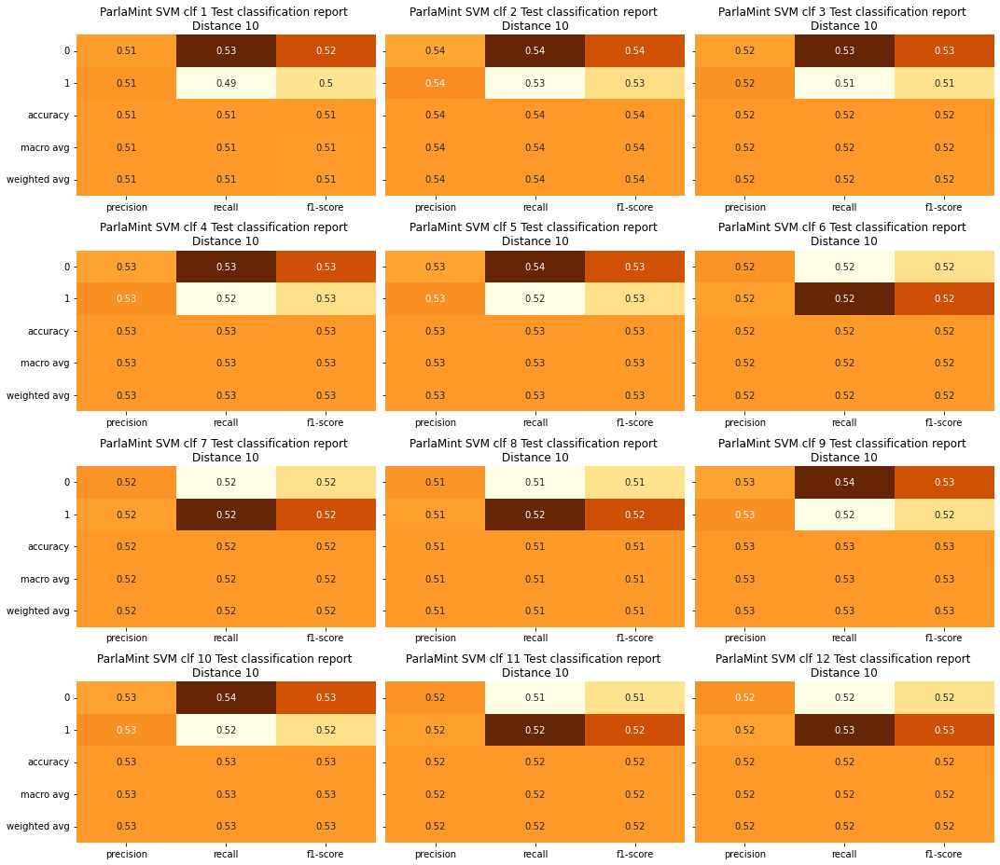

In [30]:
plot_all_classification_report(lista_clf_report_10, '10', diz_cmap['10'], 'SVM')

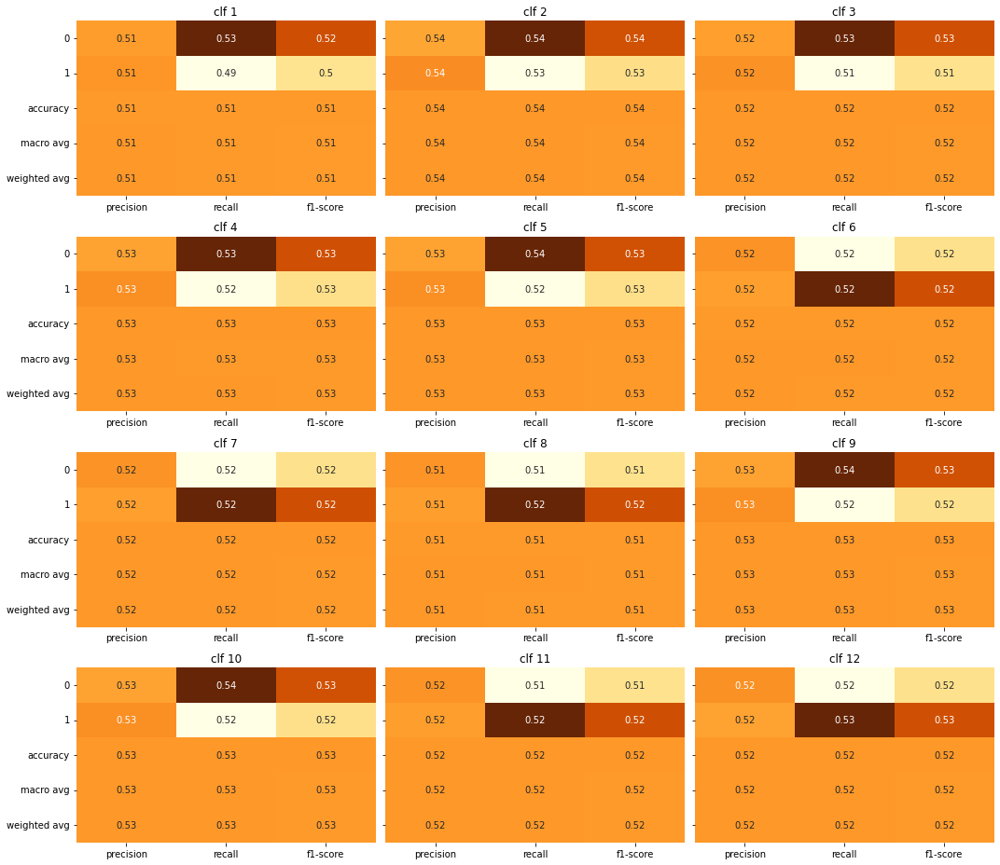

In [31]:
plot_all_classification_report(lista_clf_report_10, '10', diz_cmap['10'], 'SVM', 'ridotto')

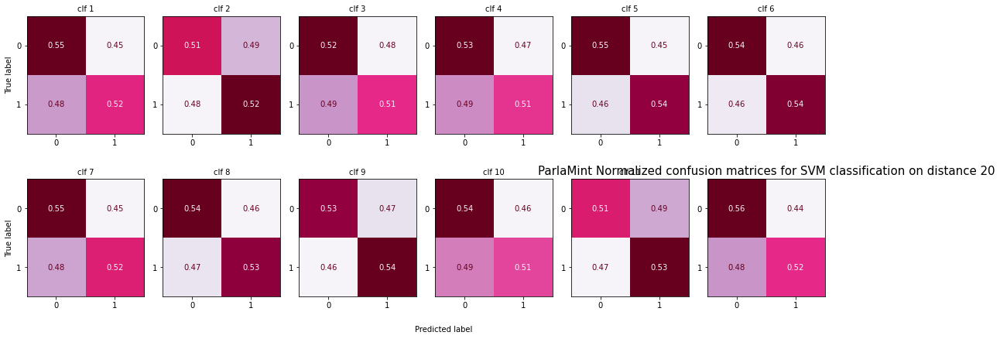

In [32]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_20, 'SVM', '20', diz_cmap['20'])    

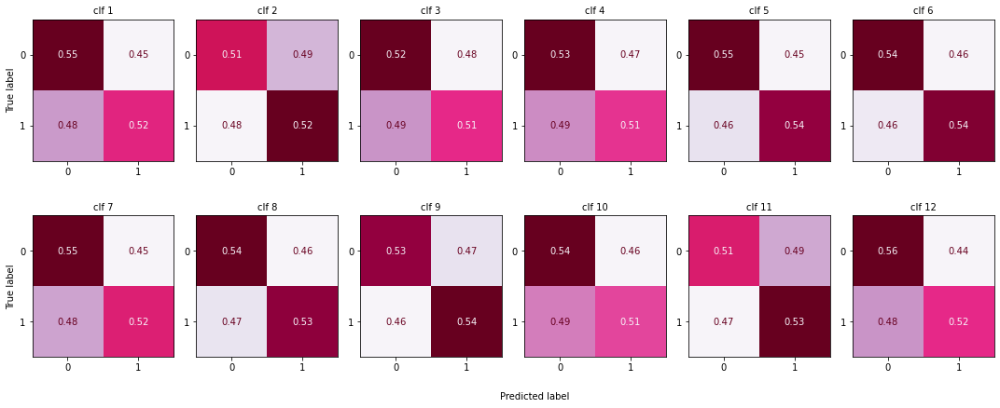

In [33]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_20, 'SVM', '20', diz_cmap['20'], 'ridotto')

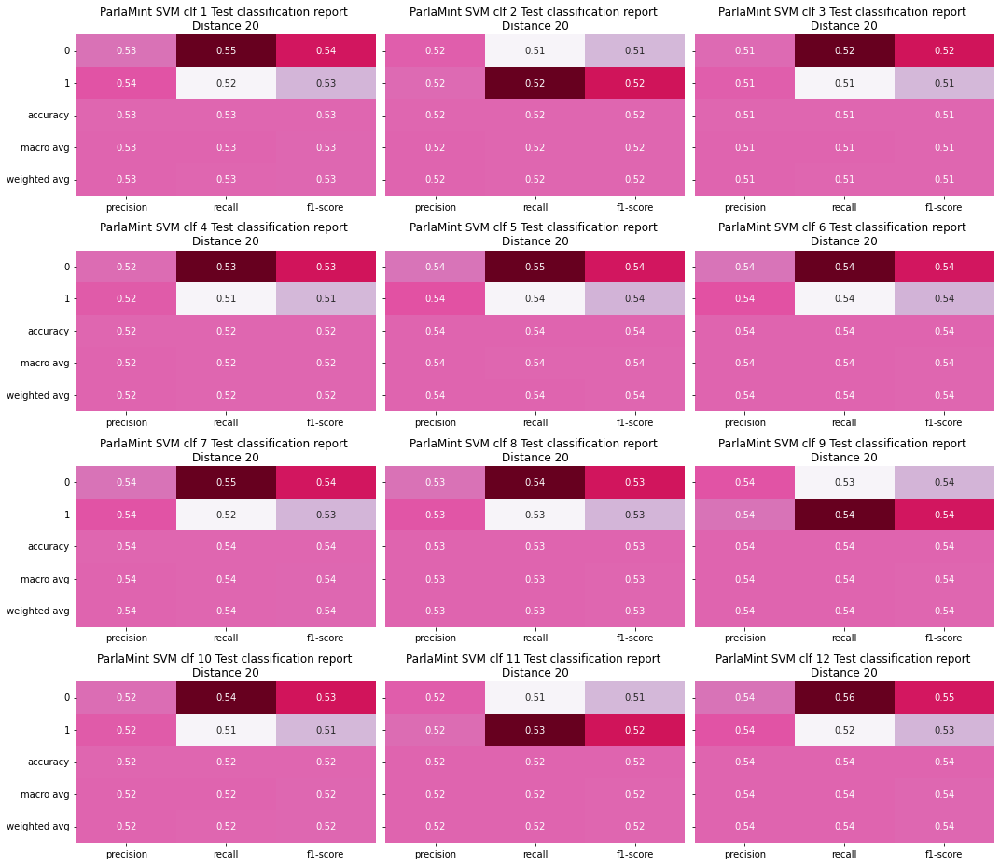

In [34]:
plot_all_classification_report(lista_clf_report_20, '20', diz_cmap['20'], 'SVM')

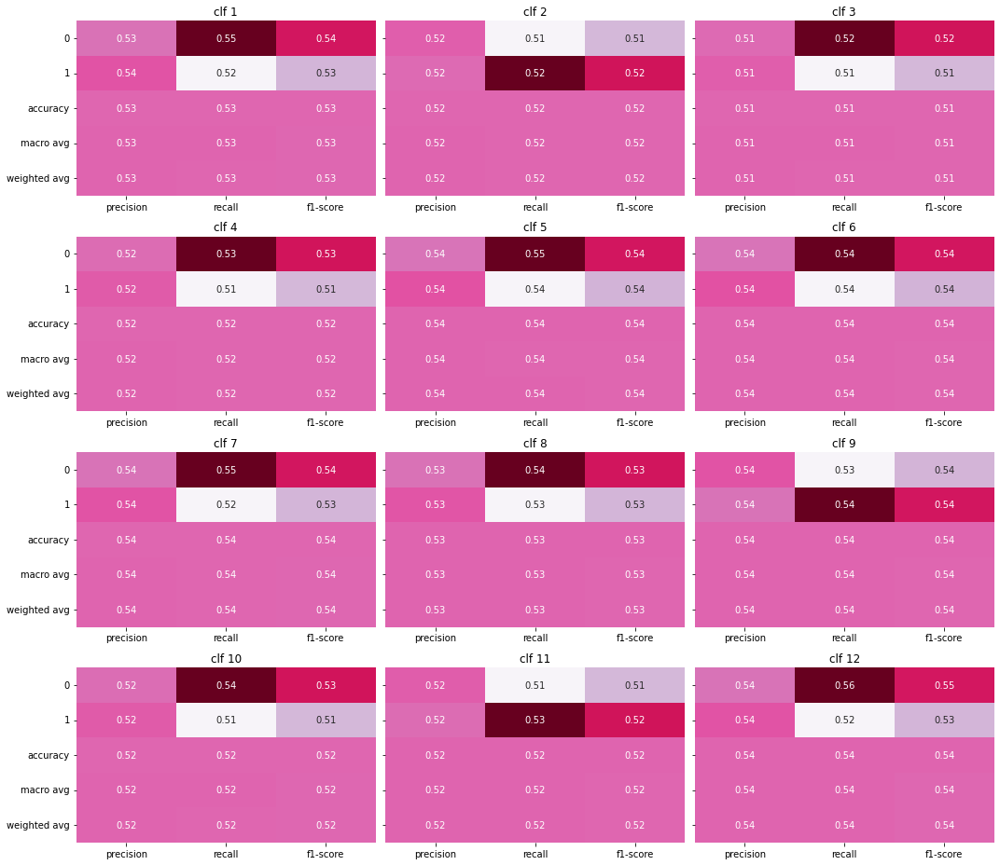

In [35]:
plot_all_classification_report(lista_clf_report_20, '20', diz_cmap['20'], 'SVM', 'ridotto')

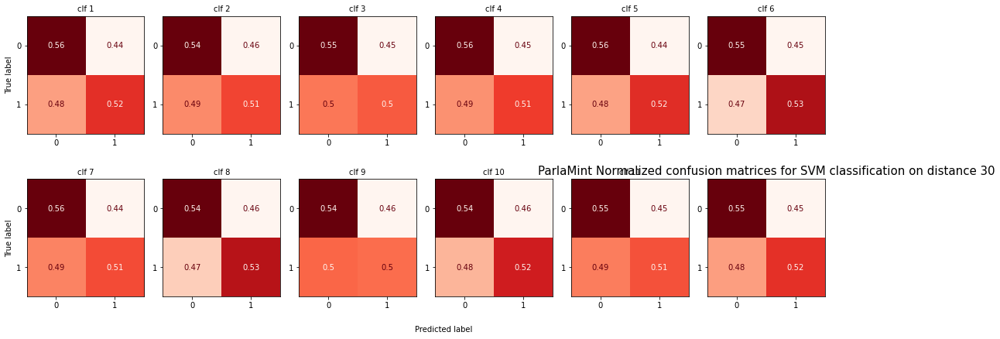

In [36]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_30, 'SVM', '30', diz_cmap['30'])    

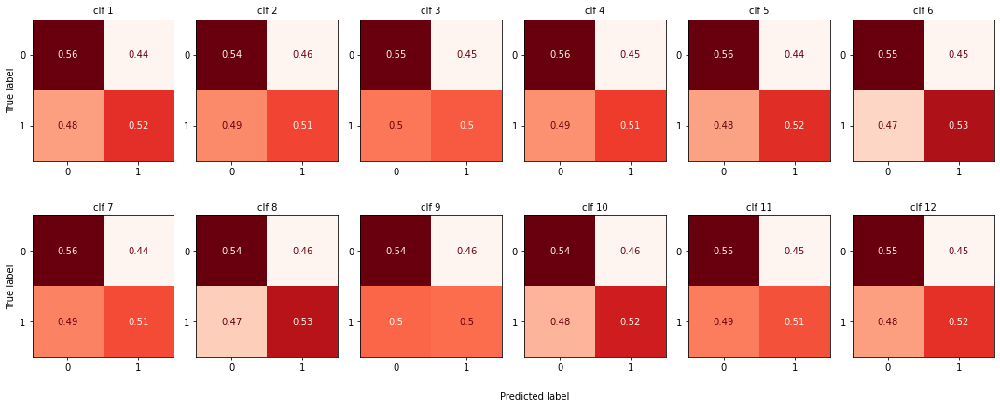

In [37]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_30, 'SVM', '30', diz_cmap['30'], 'ridotto') 

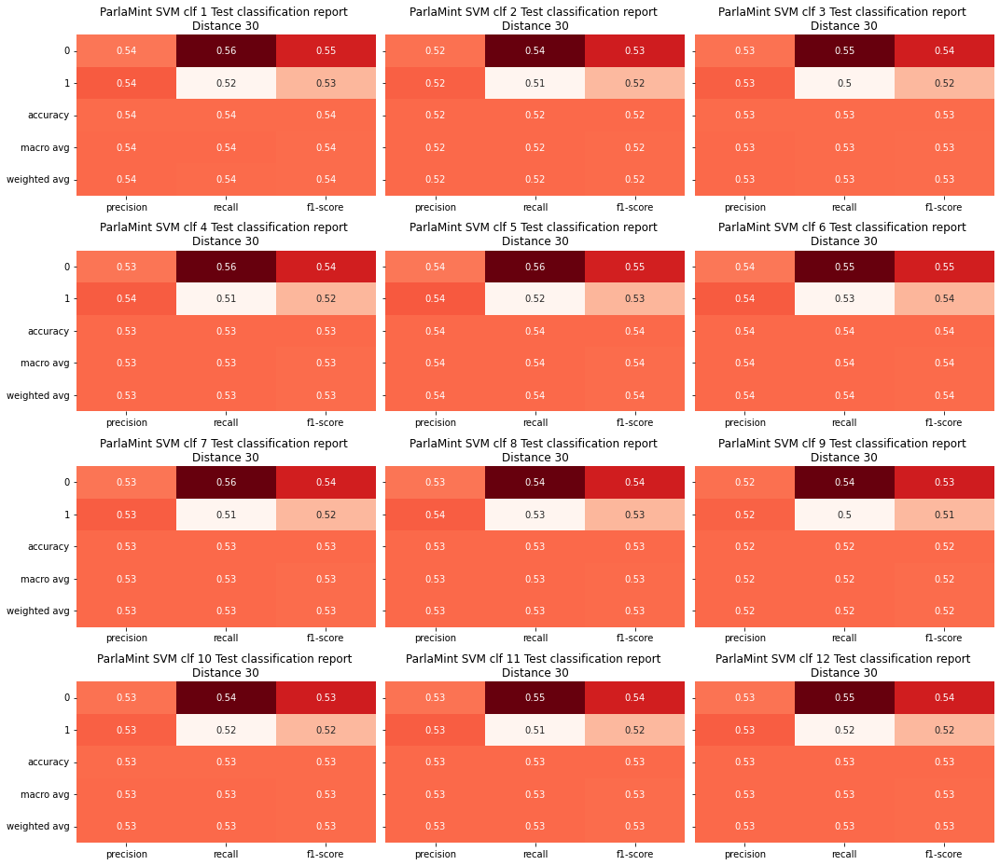

In [38]:
plot_all_classification_report(lista_clf_report_30, '30', diz_cmap['30'], 'SVM')

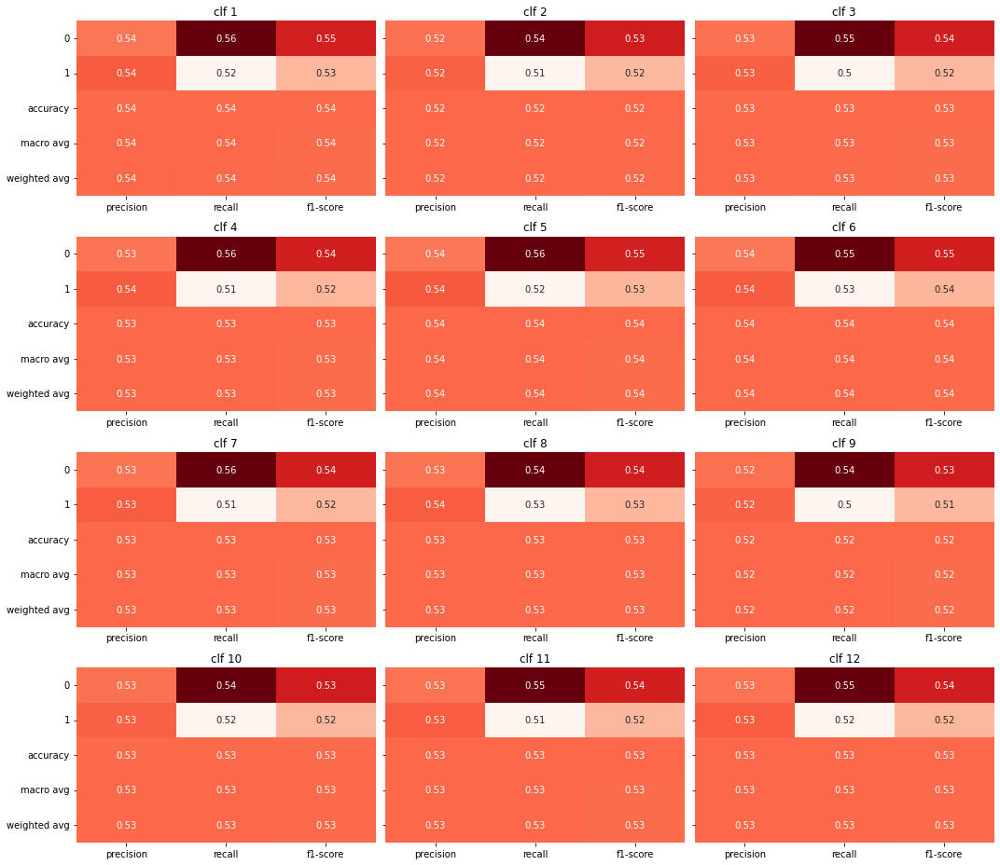

In [39]:
plot_all_classification_report(lista_clf_report_30, '30', diz_cmap['30'], 'SVM', 'ridotto')

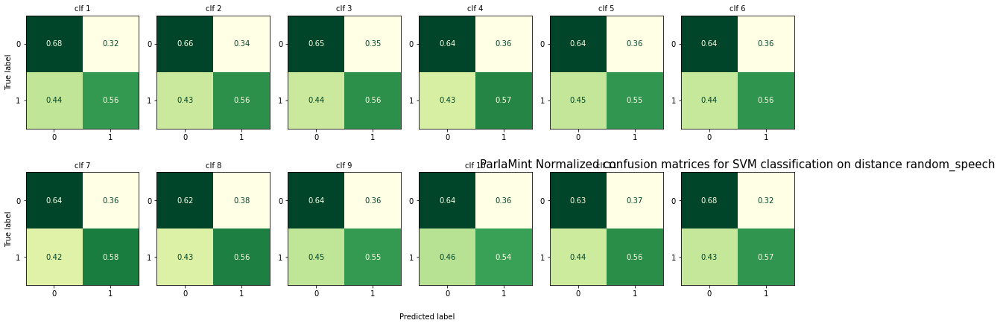

In [40]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_random_speech, 'SVM', 'random_speech', diz_cmap['random_speech'])

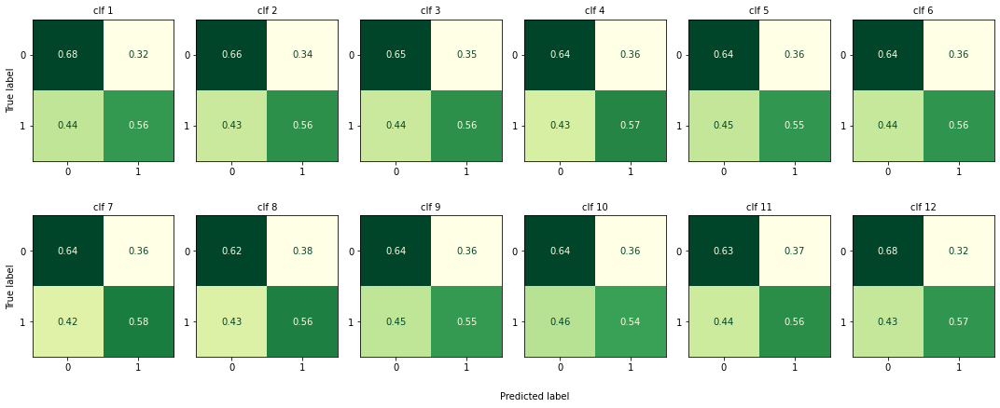

In [41]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_svm_random_speech, 'SVM', 'random_speech', diz_cmap['random_speech'], 'ridotto')

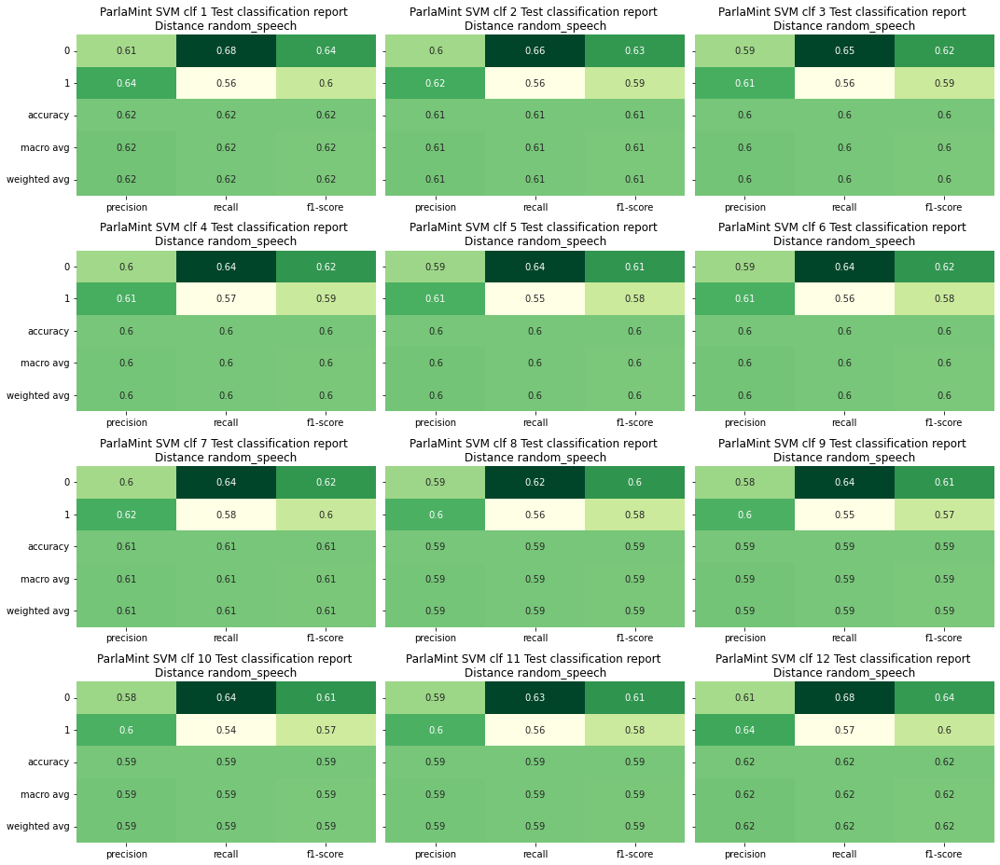

In [42]:
plot_all_classification_report(lista_clf_report_random_speech, 'random_speech', diz_cmap['random_speech'], 'SVM')

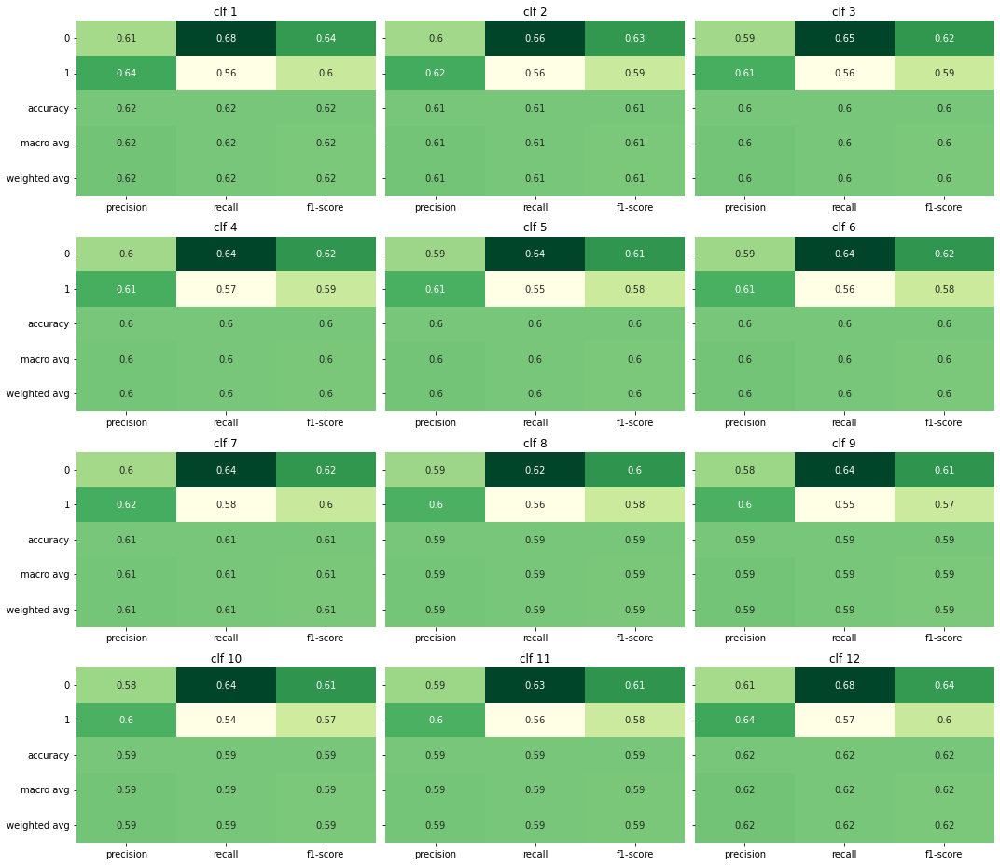

In [43]:
plot_all_classification_report(lista_clf_report_random_speech, 'random_speech', diz_cmap['random_speech'], 'SVM', 'ridotto')

In [44]:
diz_dist_5_svm['df_dist_5']['clf_1'].keys()

dict_keys(['accuracy', 'f1_score', 'y_test', 'y_pred', 'y_score', 'classes', 'ids_proba', 'ids_preds', 'proba_of_positive_class'])

In [50]:
diz_random_speech_svm['df_random_speech']['clf_1'].keys()

dict_keys(['accuracy', 'f1_score', 'y_test', 'y_pred', 'y_score', 'classes', 'ids_proba', 'ids_preds', 'proba_of_positive_class'])

In [55]:
confusion_matrix(diz_random_speech_svm['df_random_speech']['clf_1']['y_test'], \
                 diz_random_speech_svm['df_random_speech']['clf_1']['y_pred'], normalize='true')

array([[0.6775    , 0.3225    ],
       [0.43583333, 0.56416667]])

In [56]:
confusion_matrix(diz_random_speech_svm['df_random_speech']['clf_1']['y_test'], \
                 diz_random_speech_svm['df_random_speech']['clf_1']['y_pred'], normalize='all')

array([[0.33875   , 0.16125   ],
       [0.21791667, 0.28208333]])

In [ ]:
#https://scikit-learn.org/stable/modules/model_evaluation.html#confusion-matrix

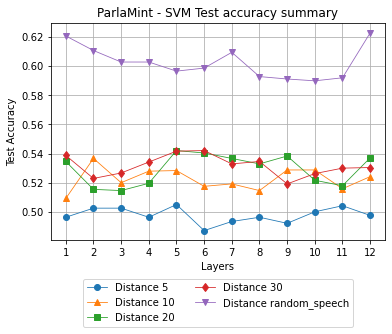

In [45]:
plot_loss_and_accuracy_of_all_distances_svm([diz_dist_5_svm['df_dist_5'], diz_dist_10_svm['df_dist_10'], \
                                            diz_dist_20_svm['df_dist_20'], diz_dist_30_svm['df_dist_30'], \
                                            diz_random_speech_svm['df_random_speech']])

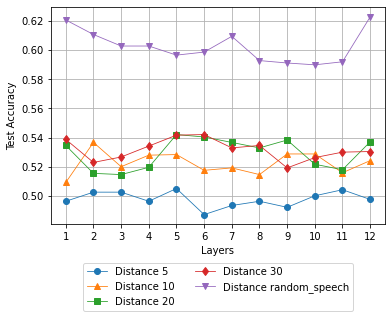

In [46]:
plot_loss_and_accuracy_of_all_distances_svm([diz_dist_5_svm['df_dist_5'], diz_dist_10_svm['df_dist_10'], \
                                            diz_dist_20_svm['df_dist_20'], diz_dist_30_svm['df_dist_30'], \
                                            diz_random_speech_svm['df_random_speech']], 'ridotto')

In [47]:
for z, i in enumerate(diz_dist_20_svm['df_dist_20']):
    print(z, diz_dist_20_svm['df_dist_20'][i]['accuracy'])

0 0.5345833333333333
1 0.5154166666666666
2 0.5145833333333333
3 0.5195833333333333
4 0.5420833333333334
5 0.5404166666666667
6 0.5366666666666666
7 0.5329166666666667
8 0.5383333333333333
9 0.5216666666666666
10 0.5179166666666667
11 0.5370833333333334


# BERT NO-PRETRAINED finetuning classification results

In [94]:
def plot_loss_and_accuracy(diz, dist, no_pretrain=''):
    
    train_losses = []
    test_losses = []
    test_acc = []

    for epoch in diz:
        train_losses.append(diz[epoch]["training_loss"])
        test_losses.append(diz[epoch]["avg_loss"])
        test_acc.append(diz[epoch]["accuracy"])
    
    fig, ax = plt.subplots(1, 1)
    
    plt.plot(range(1,len(num_epoch)+1), train_losses, label = "Training Loss")
    plt.plot(range(1,len(num_epoch)+1), test_losses, label = "Test Loss")
    title_1 = "{} Bert fine-tuned Loss (Distance {})".format(risorsa, str(dist))
    plt.title(title_1)
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.xticks(range(1,len(num_epoch)+1))
    plt.legend()
    plt.show()
    
    if no_pretrain:
        title_1+='_no_pretrain'
    
    fig.savefig(path_images + title_1 + '.png', dpi=fig.dpi)
    
    
    fig,ax = plt.subplots(1, 1)
    
    plt.plot(range(1,len(num_epoch)+1), test_acc, label = "Test Accuracy")
    title_2 = "{} Bert fine-tuned Test accuracy (Distance {})".format(risorsa, str(dist))
    plt.title(title_2)
    plt.xlabel("Epochs")
    plt.ylabel("Test Accuracy")
    plt.xticks(range(1,len(num_epoch)+1))
    plt.legend()
    plt.show()
    
    if no_pretrain:
        title_2+='_no_pretrain'
    
    fig.savefig(path_images + title_2 + '.png', dpi=fig.dpi, bbox_inches='tight')

In [95]:
def plot_loss_and_accuracy_of_all_distances(list_of_diz, titolo_ridotto='', no_pretrain=''):

    fig,ax = plt.subplots(1, 1)
        
    for diz, dist, marker in zip(list_of_diz, ['5', '10', '20', '30', 'random_speech'], ['o', '^', 's', 'd', 'v']):
        test_acc = []
        for epoch in diz:
            test_acc.append(diz[epoch]["accuracy"])

        plt.plot(range(1,len(num_epoch)+1), test_acc, label = "Distance {}".format(dist), \
                 linewidth=.8, marker=marker)
    
    plt.grid()
    title = "{} - Bert fine-tuned Test accuracy summary".format(risorsa, str(dist))
    plt.xlabel("Epochs")
    plt.xticks(range(1,len(num_epoch)+1))
    plt.ylabel("Test Accuracy")
    plt.legend(loc='lower center', bbox_to_anchor=(0.5, -0.35), ncol=3)
    
    if not titolo_ridotto:
        if no_pretrain:
            title+='_no_pretrain'
        fig.savefig(path_images + title + '.png', dpi=fig.dpi, bbox_inches='tight')
        plt.title(title)
    else:
        if no_pretrain:
            title+='_no_pretrain'
        fig.savefig(path_images_tit_ridotti + title + '.png', dpi=fig.dpi, bbox_inches='tight')
        
    plt.show()

In [96]:
num_epoch = range(5)

In [129]:
dist_5_bf_no_pretrain = open(path_pickle + "/" + "df_dist_5_diz_bert_finetuning_no_pretrain.pickle", "rb")
dist_10_bf_no_pretrain = open(path_pickle + "/" + "df_dist_10_diz_bert_finetuning_no_pretrain.pickle", "rb")
dist_20_bf_no_pretrain = open(path_pickle + "/" + "df_dist_20_diz_bert_finetuning_no_pretrain.pickle", "rb")
dist_30_bf_no_pretrain = open(path_pickle + "/" + "df_dist_30_diz_bert_finetuning_no_pretrain.pickle", "rb")
random_speech_bf_no_pretrain = open(path_pickle + "/" + "df_random_speech_diz_bert_finetuning_no_pretrain.pickle", "rb")

diz_dist_5_bf_no_pretrain = pickle.load(dist_5_bf_no_pretrain)
diz_dist_10_bf_no_pretrain = pickle.load(dist_10_bf_no_pretrain)
diz_dist_20_bf_no_pretrain = pickle.load(dist_20_bf_no_pretrain)
diz_dist_30_bf_no_pretrain = pickle.load(dist_30_bf_no_pretrain)
diz_random_speech_bf_no_pretrain = pickle.load(random_speech_bf_no_pretrain)

In [98]:
lista_ids_bf_5_no_pretrain = controlla_ids(diz_dist_5_bf_no_pretrain['df_dist_5'])

inizializzo la lista con il classificatore Epoch0


In [99]:
lista_ids_bf_10_no_pretrain = controlla_ids(diz_dist_10_bf_no_pretrain['df_dist_10'])

inizializzo la lista con il classificatore Epoch0


In [100]:
lista_ids_bf_20_no_pretrain = controlla_ids(diz_dist_20_bf_no_pretrain['df_dist_20'])

inizializzo la lista con il classificatore Epoch0


In [101]:
lista_ids_bf_30_no_pretrain = controlla_ids(diz_dist_30_bf_no_pretrain['df_dist_30'])

inizializzo la lista con il classificatore Epoch0


In [102]:
lista_ids_bf_random_speech_no_pretrain = controlla_ids(diz_random_speech_bf_no_pretrain['df_random_speech'])

inizializzo la lista con il classificatore Epoch0


Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.79      0.61      1200
           1       0.49      0.20      0.28      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.45      2400
weighted avg       0.49      0.49      0.45      2400



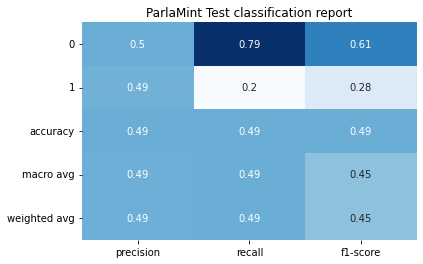


------------------------
  Confusion Matrix
------------------------


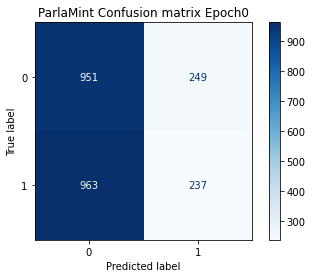

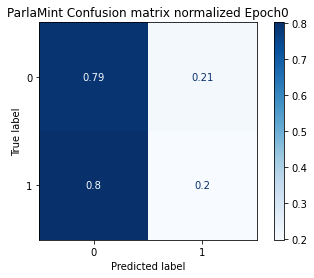

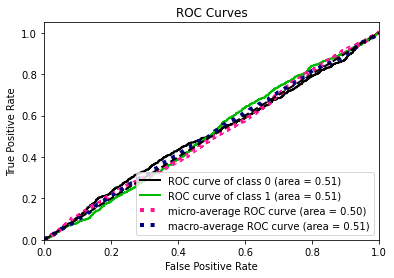

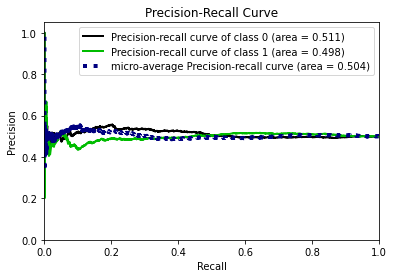

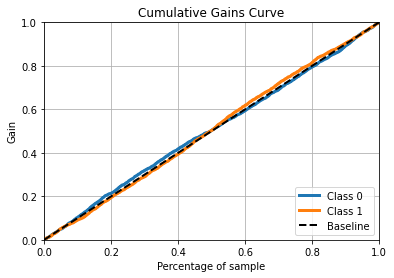

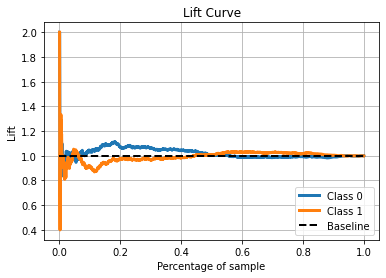

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.51      0.50      1200
           1       0.50      0.50      0.50      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



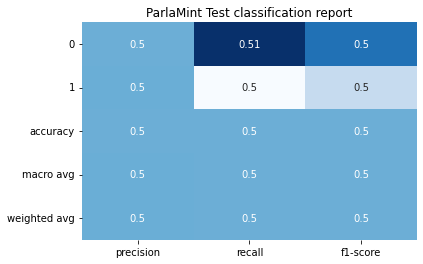


------------------------
  Confusion Matrix
------------------------


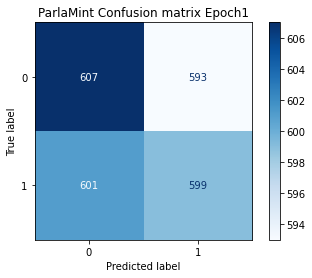

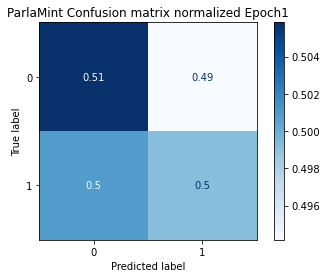

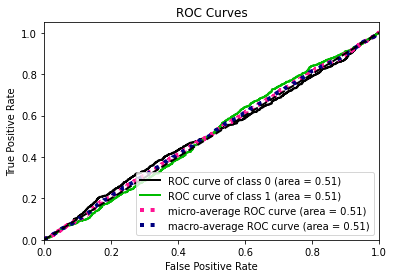

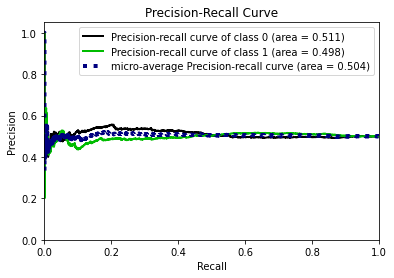

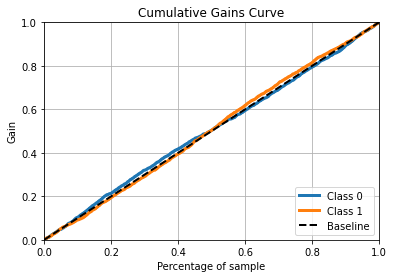

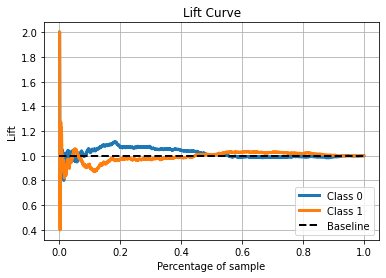

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.53      0.52      1200
           1       0.50      0.47      0.49      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



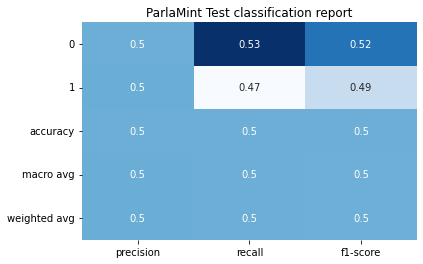


------------------------
  Confusion Matrix
------------------------


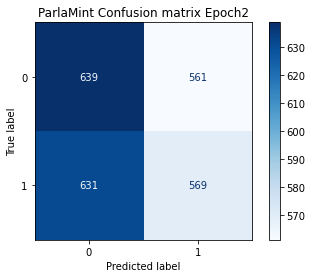

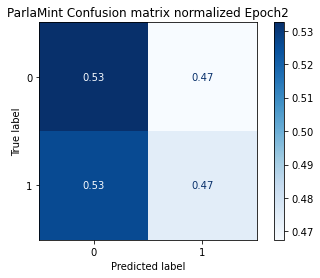

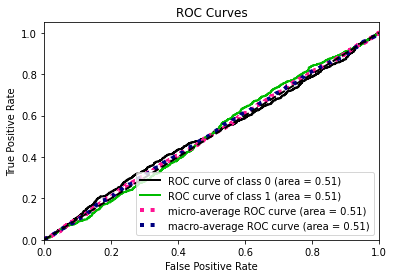

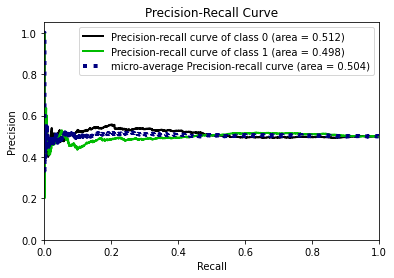

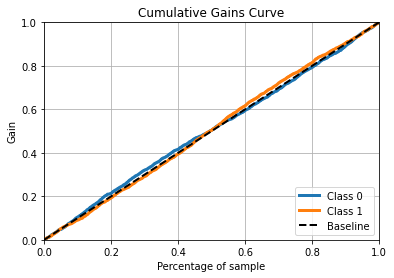

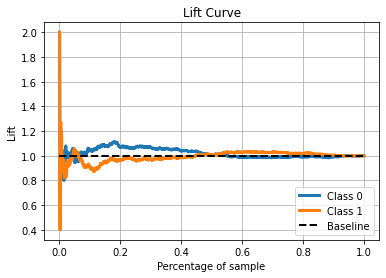

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.49      0.50      1200
           1       0.51      0.53      0.52      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.51      2400
weighted avg       0.51      0.51      0.51      2400



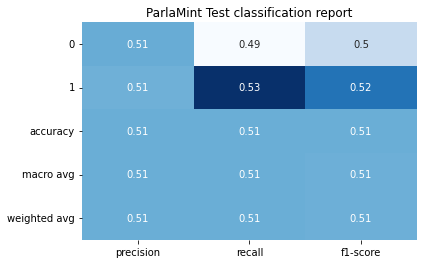


------------------------
  Confusion Matrix
------------------------


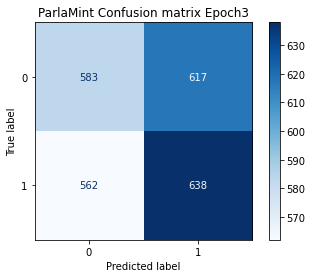

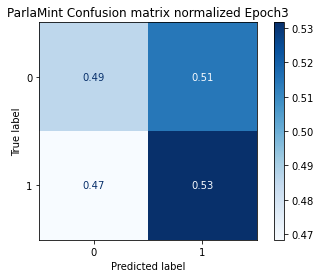

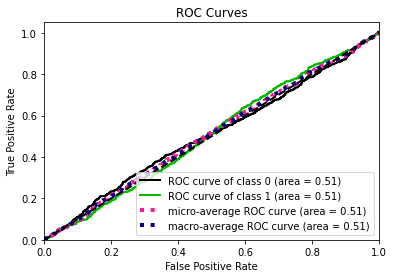

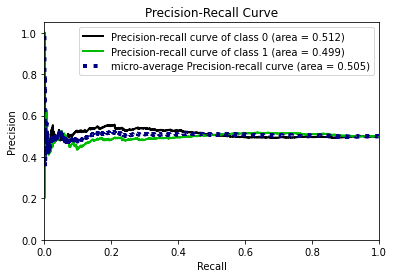

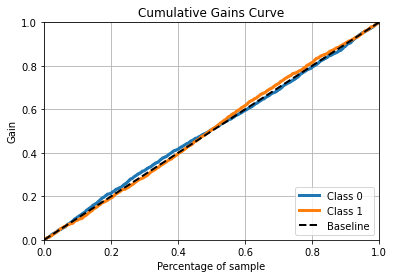

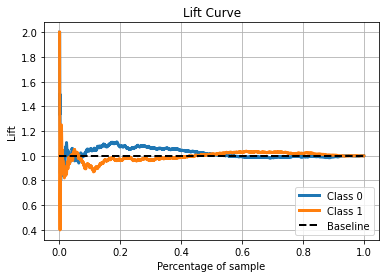

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.53      0.33      0.41      1200
           1       0.51      0.71      0.60      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.50      2400
weighted avg       0.52      0.52      0.50      2400



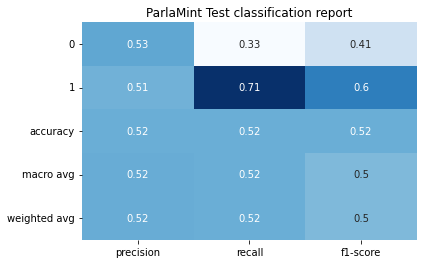


------------------------
  Confusion Matrix
------------------------


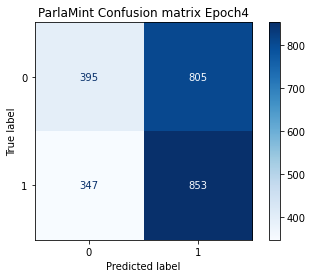

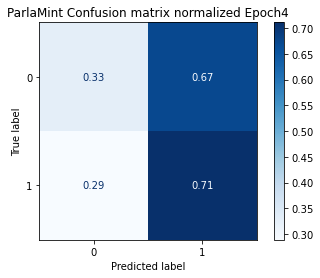

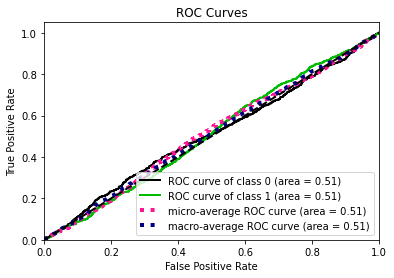

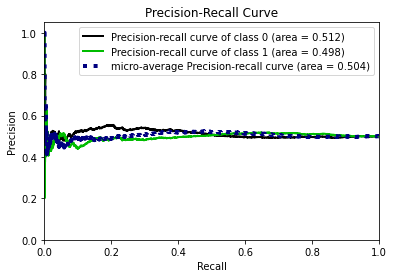

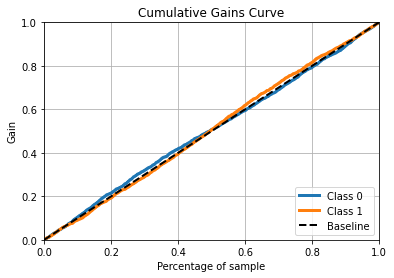

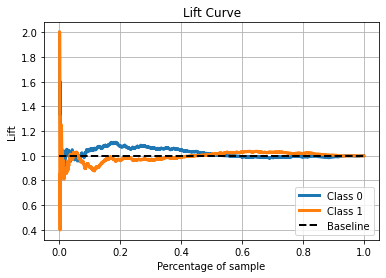

------------------------------------------------------------------------------------------------


In [103]:
lista_cm_normalizzate_bf_5_no_pretrain, lista_clf_report_bf_5_no_pretrain = \
        plot_classification_results(diz_dist_5_bf_no_pretrain['df_dist_5'], True, diz_cmap['5'])

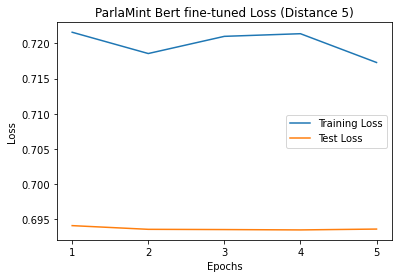

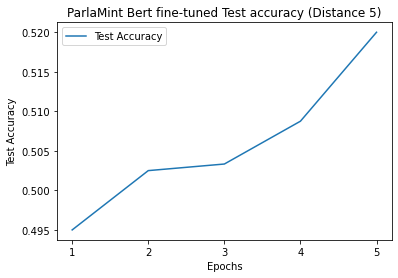

In [104]:
plot_loss_and_accuracy(diz_dist_5_bf_no_pretrain['df_dist_5'], 5)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.21      0.30      1200
           1       0.50      0.78      0.61      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.45      2400
weighted avg       0.50      0.50      0.45      2400



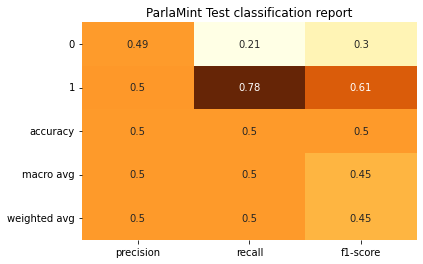


------------------------
  Confusion Matrix
------------------------


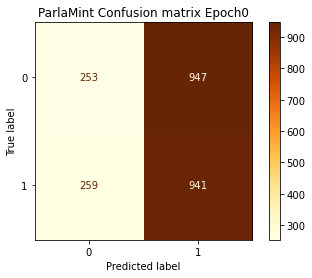

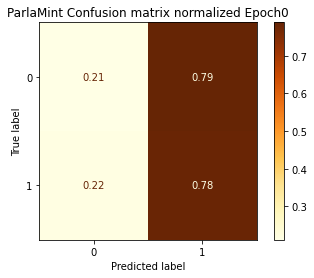

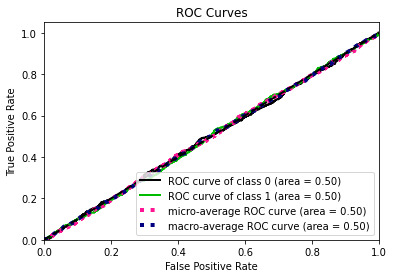

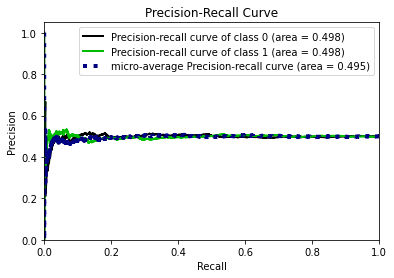

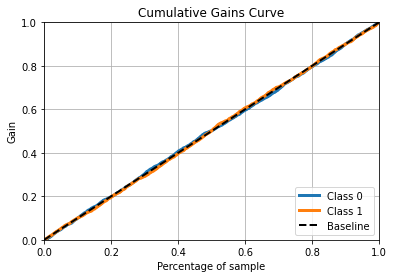

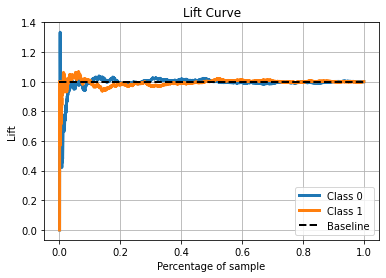

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.84      0.62      1200
           1       0.48      0.15      0.22      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.42      2400
weighted avg       0.49      0.49      0.42      2400



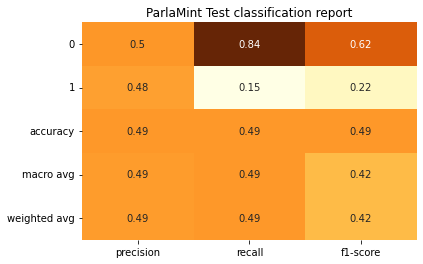


------------------------
  Confusion Matrix
------------------------


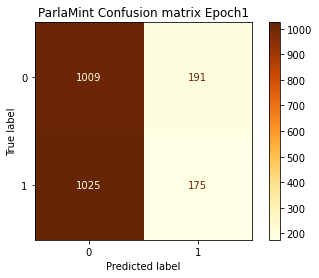

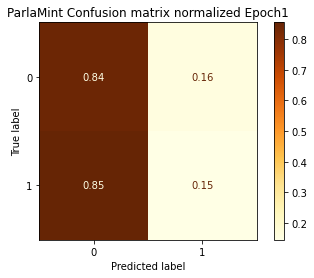

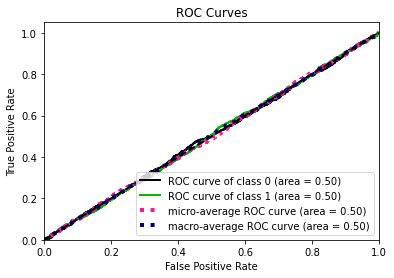

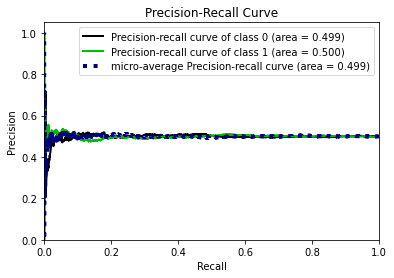

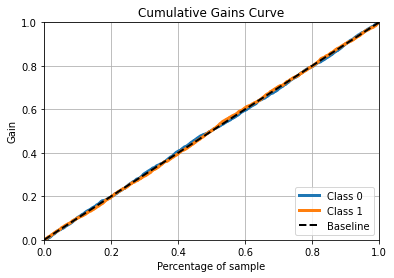

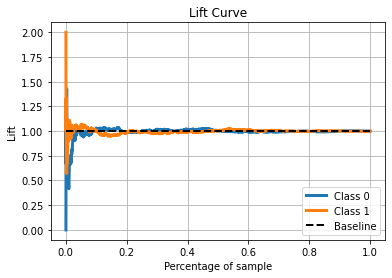

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.68      0.58      1200
           1       0.49      0.31      0.38      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.48      2400
weighted avg       0.50      0.50      0.48      2400



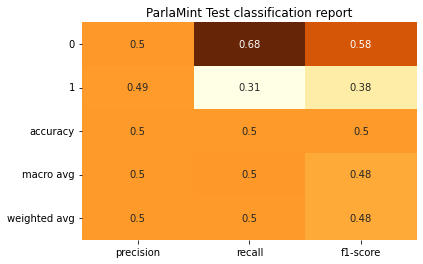


------------------------
  Confusion Matrix
------------------------


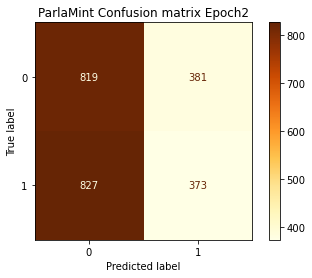

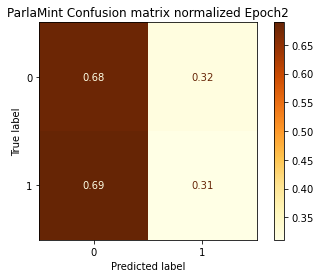

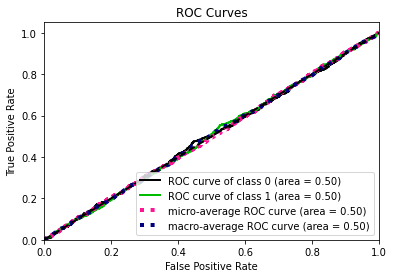

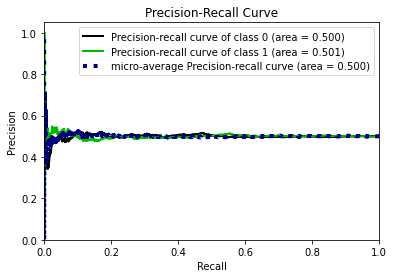

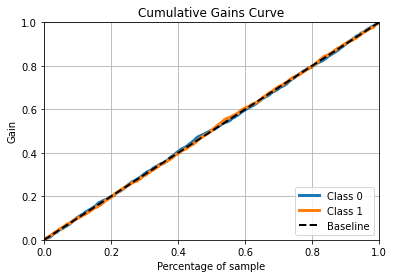

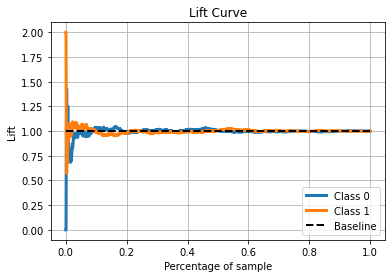

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.68      0.58      1200
           1       0.50      0.32      0.39      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.48      2400
weighted avg       0.50      0.50      0.48      2400



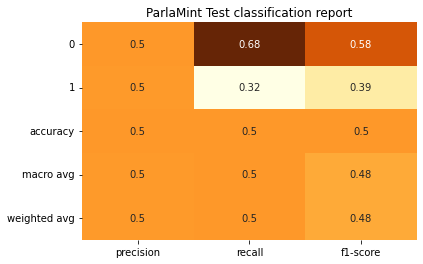


------------------------
  Confusion Matrix
------------------------


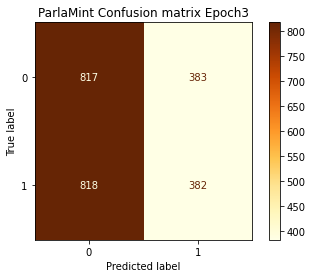

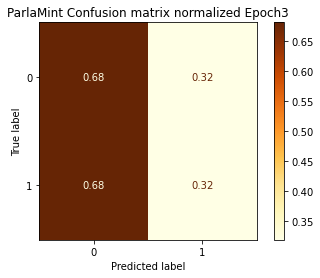

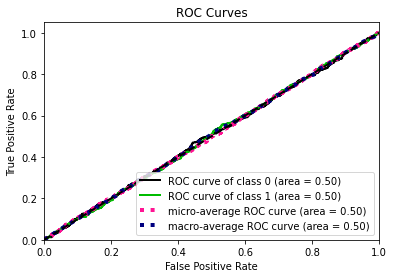

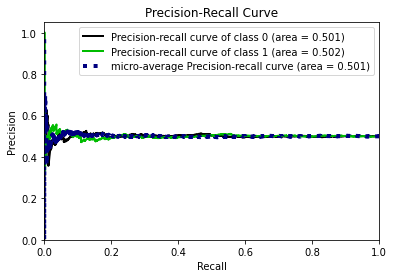

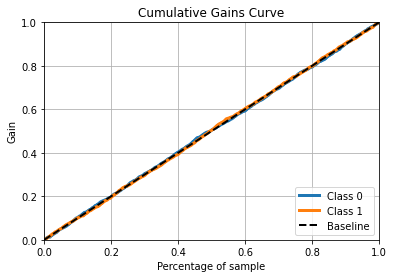

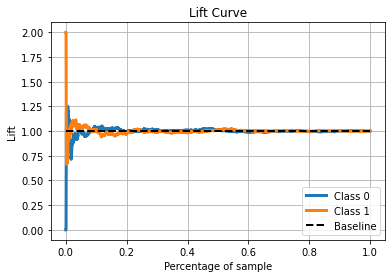

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.63      0.56      1200
           1       0.50      0.37      0.43      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.49      2400
weighted avg       0.50      0.50      0.49      2400



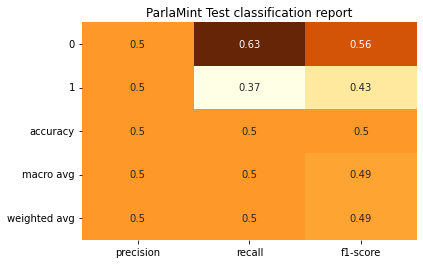


------------------------
  Confusion Matrix
------------------------


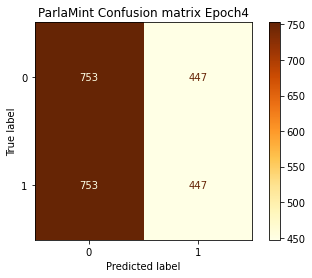

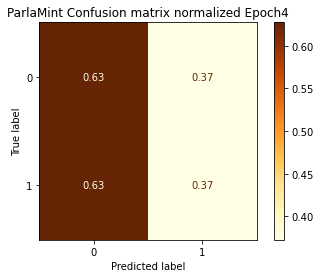

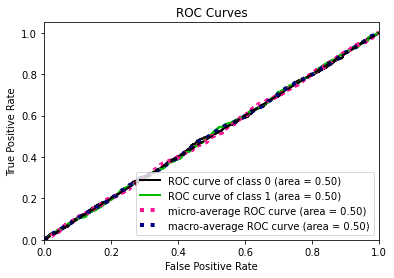

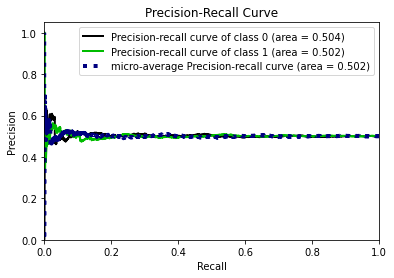

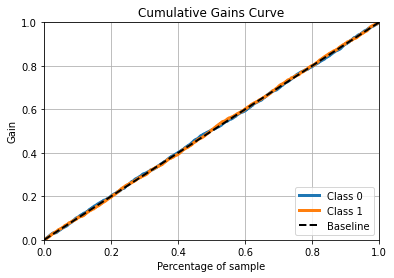

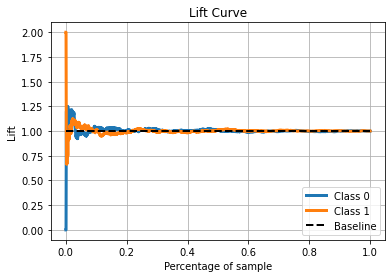

------------------------------------------------------------------------------------------------


In [105]:
lista_cm_normalizzate_bf_10_no_pretrain, lista_clf_report_bf_10_no_pretrain = \
        plot_classification_results(diz_dist_10_bf_no_pretrain['df_dist_10'], True, diz_cmap['10'])

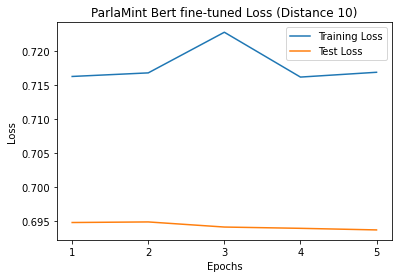

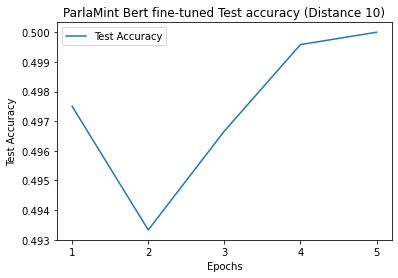

In [106]:
plot_loss_and_accuracy(diz_dist_10_bf_no_pretrain['df_dist_10'], 10)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.85      0.63      1200
           1       0.52      0.16      0.24      1200

    accuracy                           0.51      2400
   macro avg       0.51      0.51      0.44      2400
weighted avg       0.51      0.51      0.44      2400



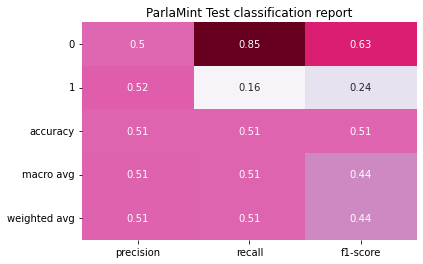


------------------------
  Confusion Matrix
------------------------


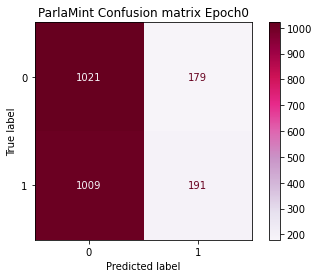

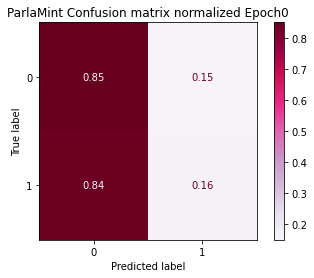

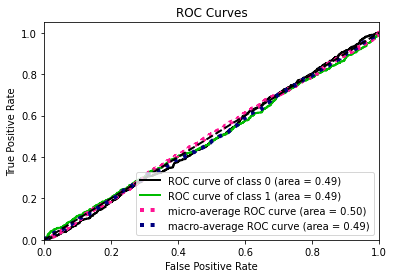

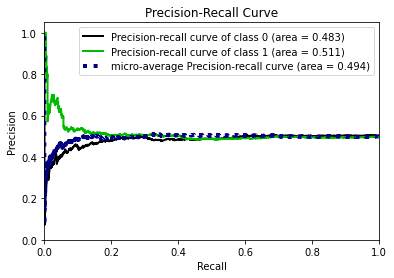

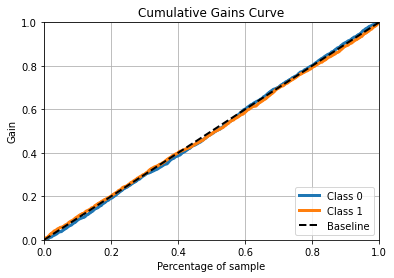

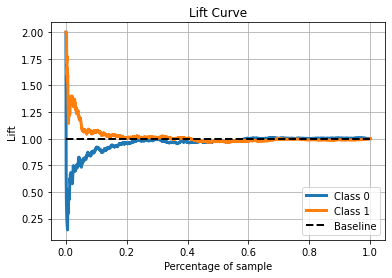

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.69      0.58      1200
           1       0.51      0.32      0.39      1200

    accuracy                           0.50      2400
   macro avg       0.51      0.50      0.49      2400
weighted avg       0.51      0.50      0.49      2400



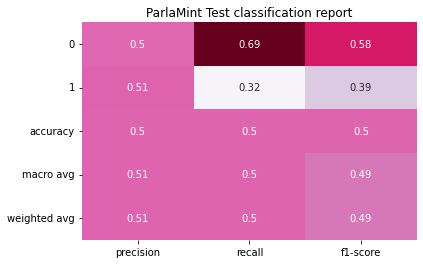


------------------------
  Confusion Matrix
------------------------


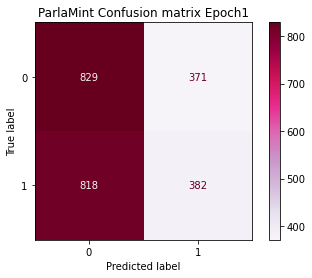

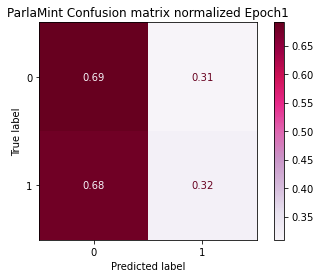

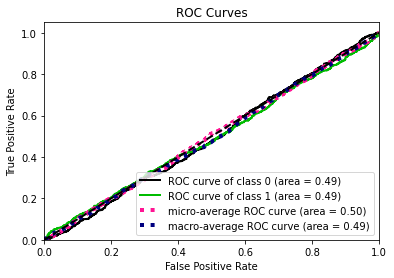

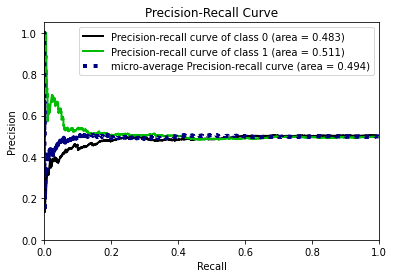

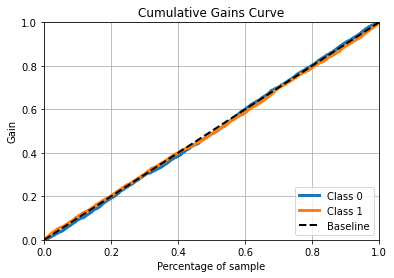

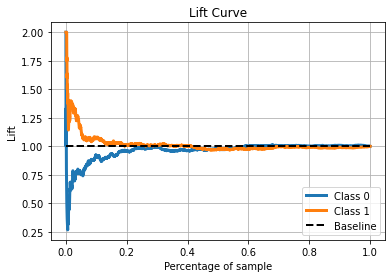

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.49      0.30      0.38      1200
           1       0.50      0.69      0.58      1200

    accuracy                           0.49      2400
   macro avg       0.49      0.49      0.48      2400
weighted avg       0.49      0.49      0.48      2400



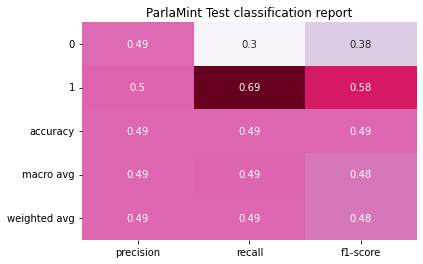


------------------------
  Confusion Matrix
------------------------


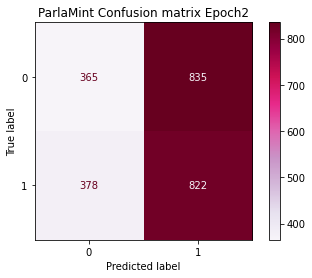

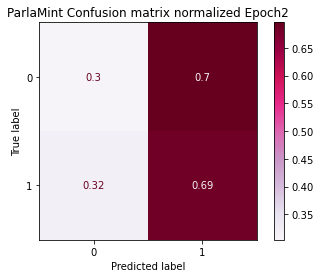

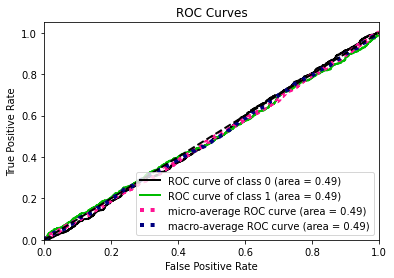

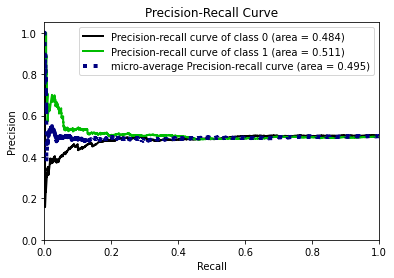

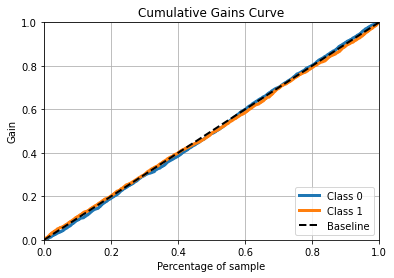

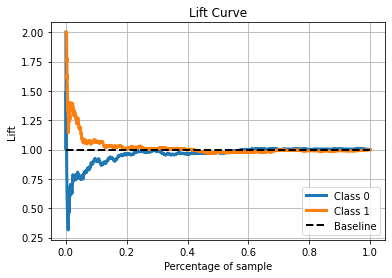

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.61      0.55      1200
           1       0.50      0.40      0.44      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.50      2400
weighted avg       0.50      0.50      0.50      2400



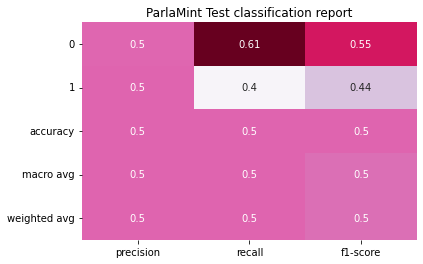


------------------------
  Confusion Matrix
------------------------


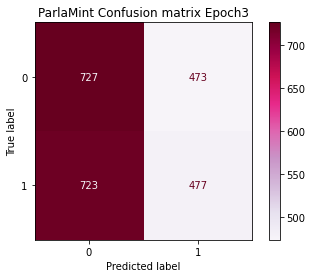

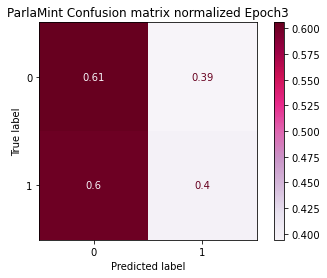

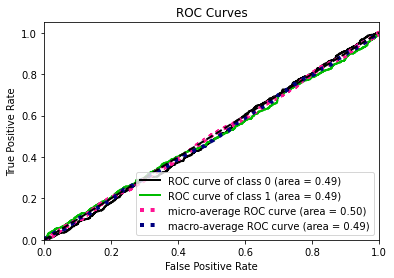

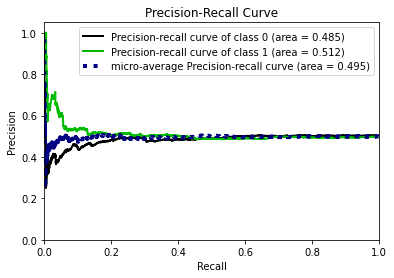

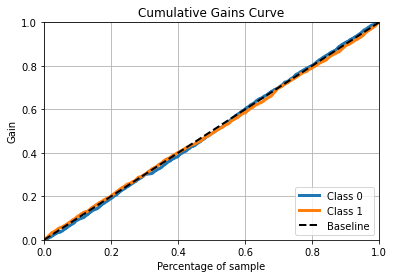

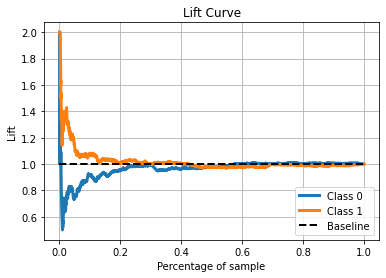

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.48      0.41      0.44      1200
           1       0.49      0.56      0.52      1200

    accuracy                           0.48      2400
   macro avg       0.48      0.48      0.48      2400
weighted avg       0.48      0.48      0.48      2400



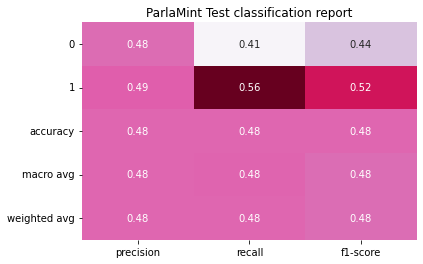


------------------------
  Confusion Matrix
------------------------


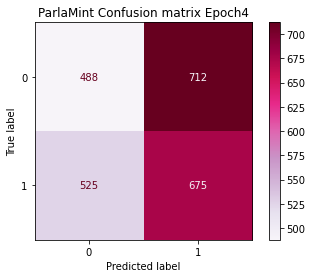

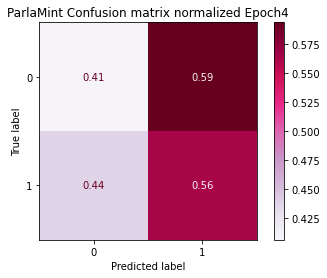

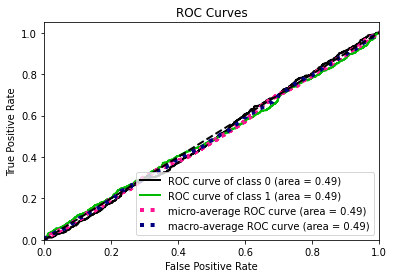

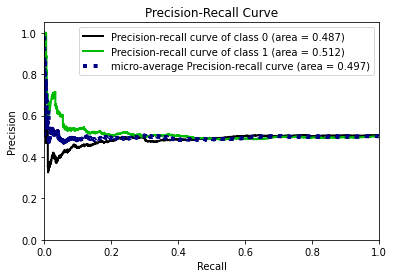

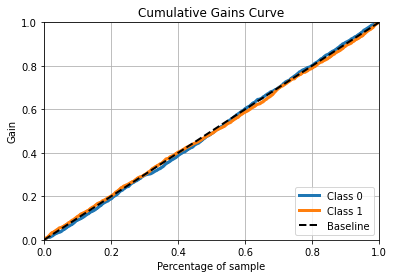

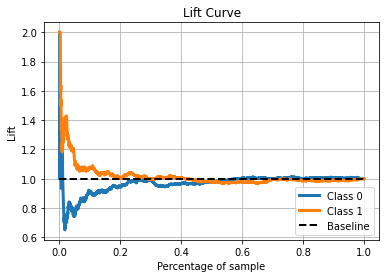

------------------------------------------------------------------------------------------------


In [107]:
lista_cm_normalizzate_bf_20_no_pretrain, lista_clf_report_bf_20_no_pretrain = \
        plot_classification_results(diz_dist_20_bf_no_pretrain['df_dist_20'], True, diz_cmap['20'])

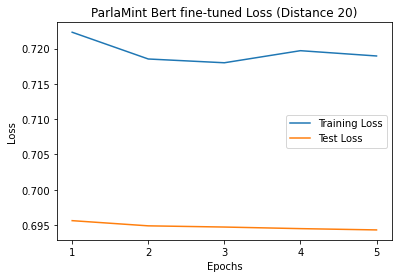

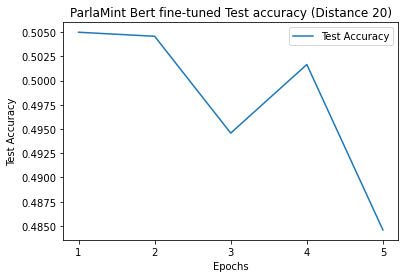

In [108]:
plot_loss_and_accuracy(diz_dist_20_bf_no_pretrain['df_dist_20'], 20)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.30      0.38      1200
           1       0.50      0.70      0.58      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.48      2400
weighted avg       0.50      0.50      0.48      2400



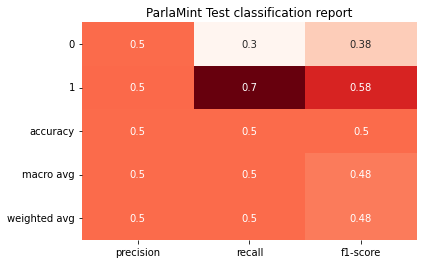


------------------------
  Confusion Matrix
------------------------


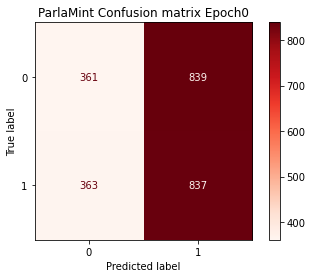

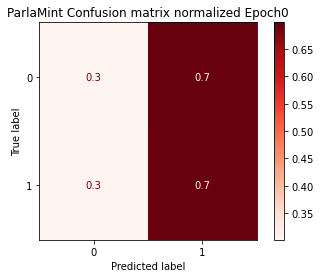

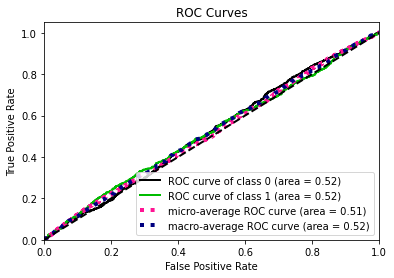

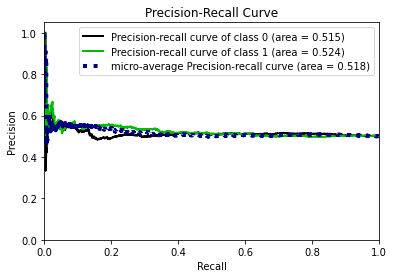

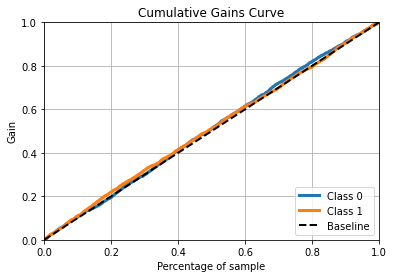

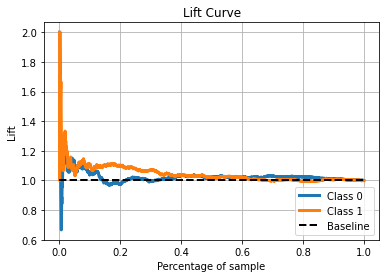

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.77      0.62      1200
           1       0.54      0.27      0.36      1200

    accuracy                           0.52      2400
   macro avg       0.53      0.52      0.49      2400
weighted avg       0.53      0.52      0.49      2400



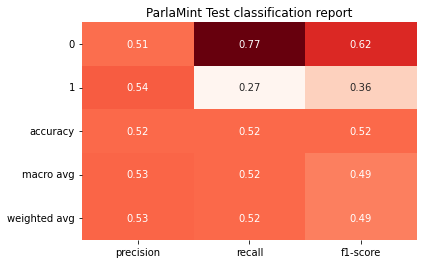


------------------------
  Confusion Matrix
------------------------


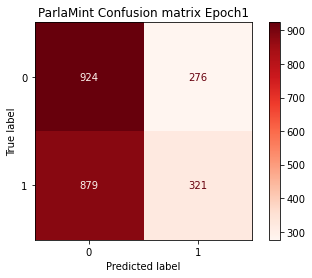

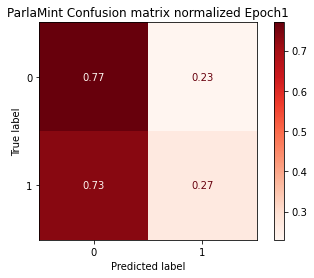

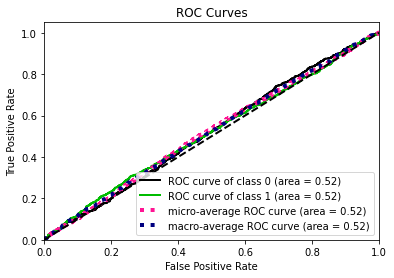

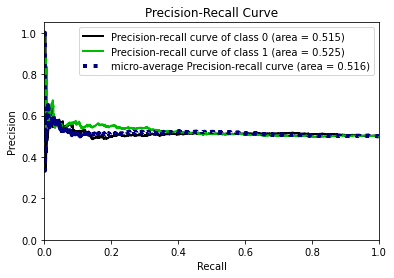

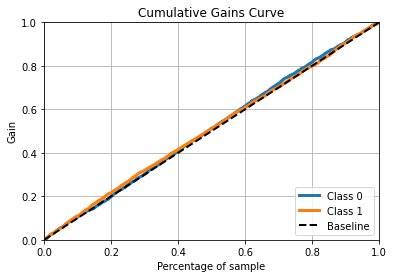

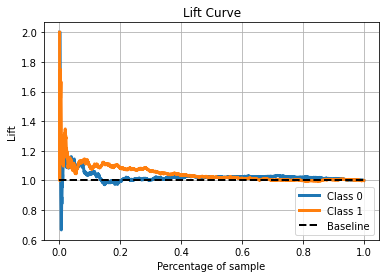

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.72      0.60      1200
           1       0.54      0.32      0.40      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.50      2400
weighted avg       0.52      0.52      0.50      2400



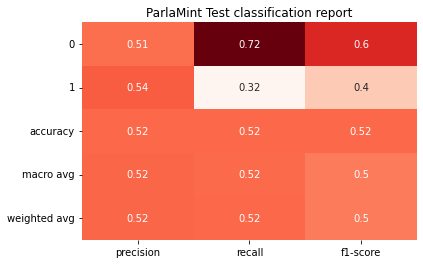


------------------------
  Confusion Matrix
------------------------


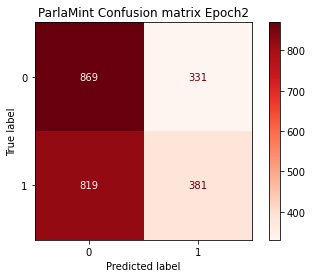

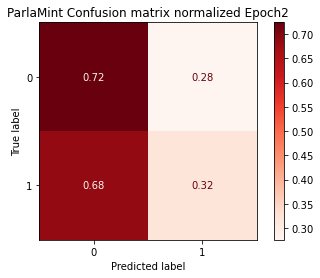

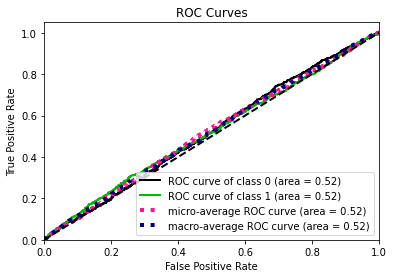

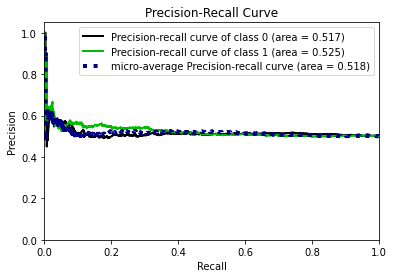

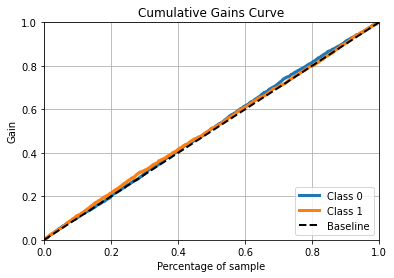

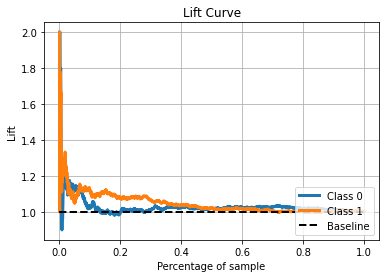

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.92      0.65      1200
           1       0.56      0.11      0.18      1200

    accuracy                           0.51      2400
   macro avg       0.53      0.51      0.42      2400
weighted avg       0.53      0.51      0.42      2400



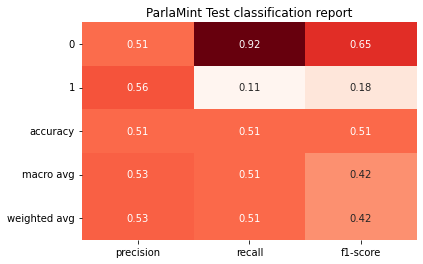


------------------------
  Confusion Matrix
------------------------


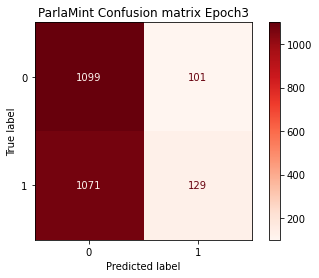

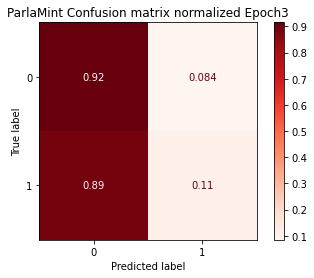

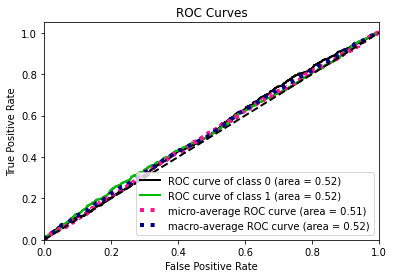

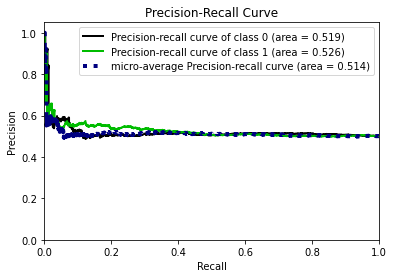

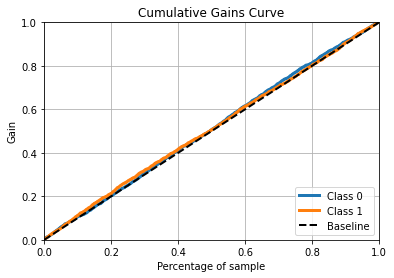

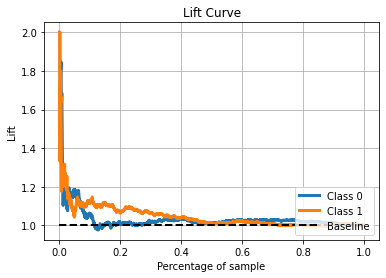

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.72      0.60      1200
           1       0.53      0.32      0.40      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.50      2400
weighted avg       0.52      0.52      0.50      2400



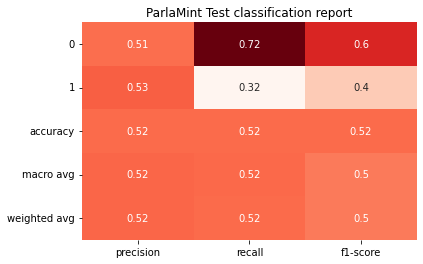


------------------------
  Confusion Matrix
------------------------


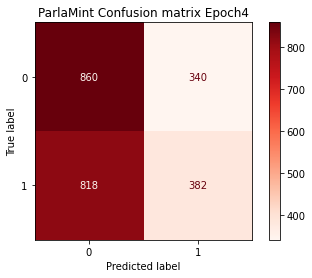

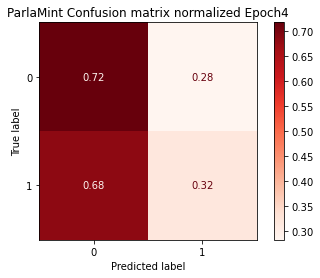

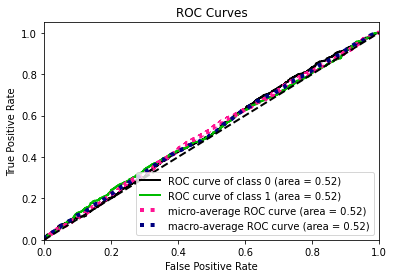

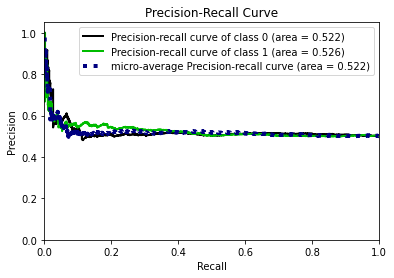

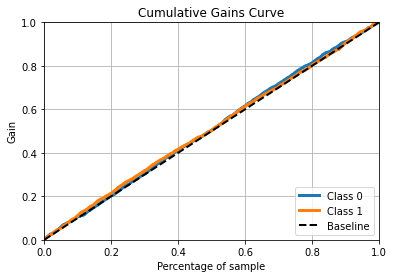

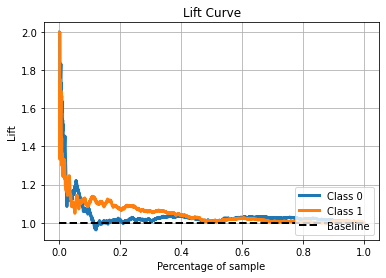

------------------------------------------------------------------------------------------------


In [109]:
lista_cm_normalizzate_bf_30_no_pretrain, lista_clf_report_bf_30_no_pretrain = \
        plot_classification_results(diz_dist_30_bf_no_pretrain['df_dist_30'], True, diz_cmap['30'])

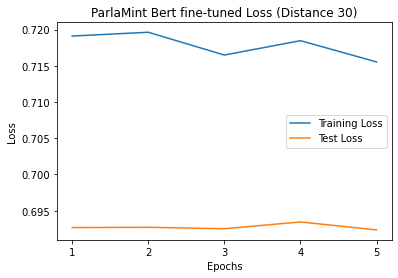

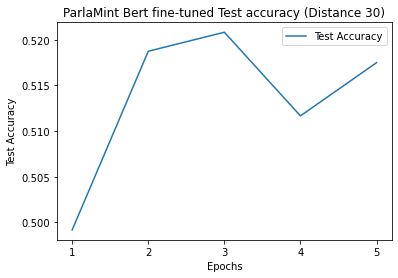

In [110]:
plot_loss_and_accuracy(diz_dist_30_bf_no_pretrain['df_dist_30'], 30)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.83      0.63      1200
           1       0.50      0.17      0.25      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.44      2400
weighted avg       0.50      0.50      0.44      2400



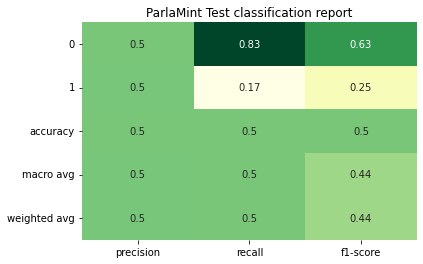


------------------------
  Confusion Matrix
------------------------


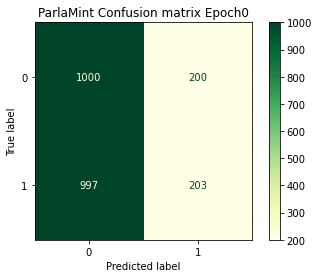

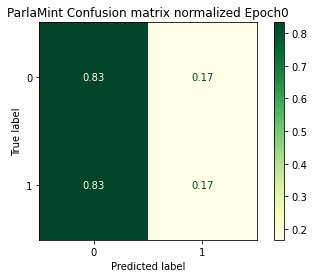

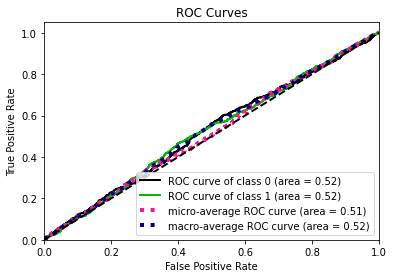

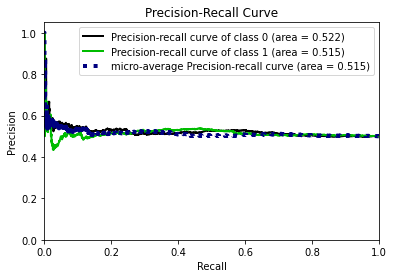

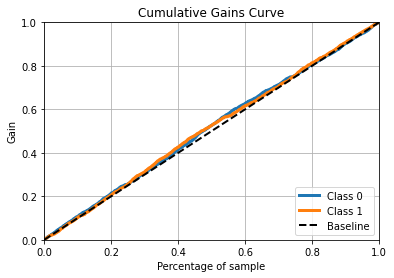

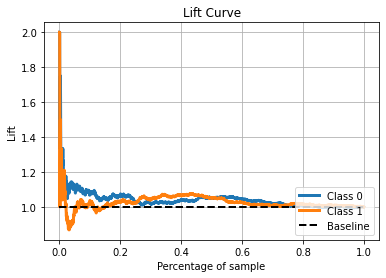

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.50      0.94      0.65      1200
           1       0.50      0.06      0.11      1200

    accuracy                           0.50      2400
   macro avg       0.50      0.50      0.38      2400
weighted avg       0.50      0.50      0.38      2400



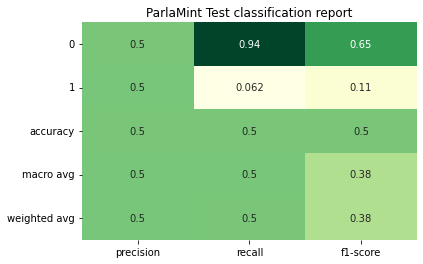


------------------------
  Confusion Matrix
------------------------


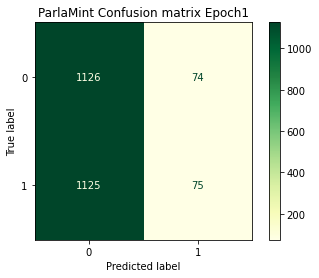

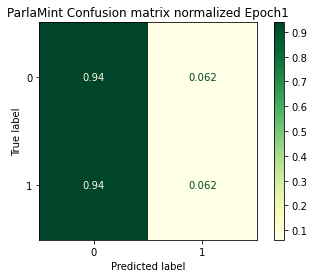

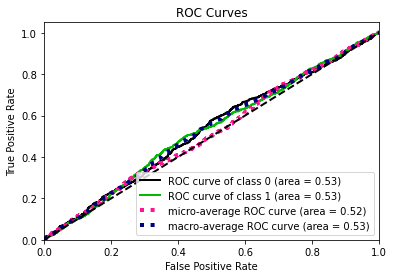

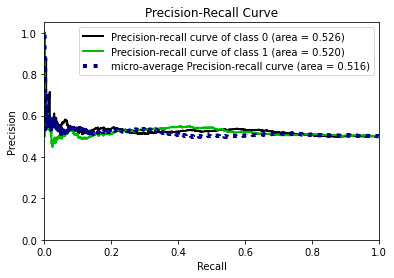

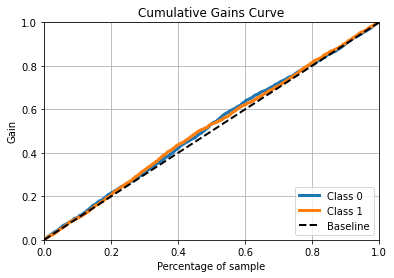

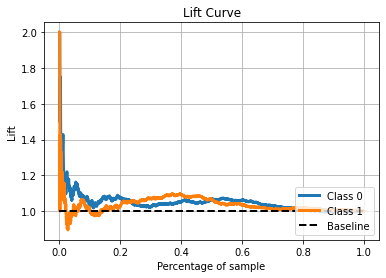

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.55      0.19      0.28      1200
           1       0.51      0.85      0.64      1200

    accuracy                           0.52      2400
   macro avg       0.53      0.52      0.46      2400
weighted avg       0.53      0.52      0.46      2400



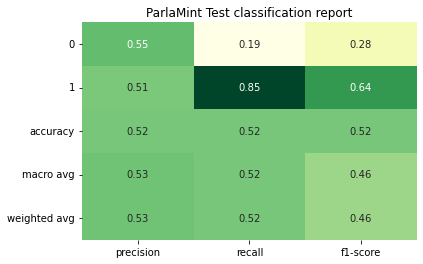


------------------------
  Confusion Matrix
------------------------


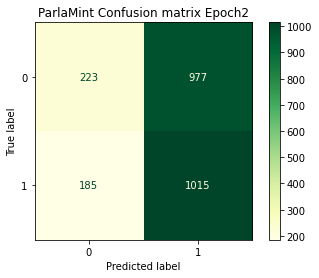

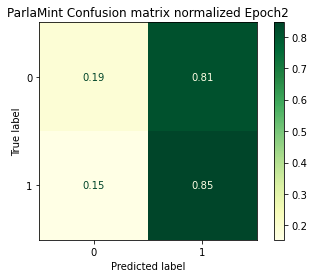

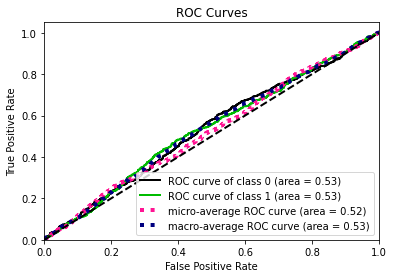

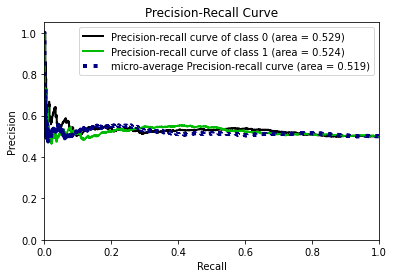

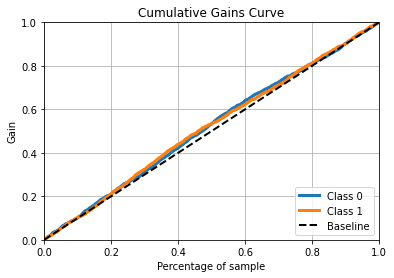

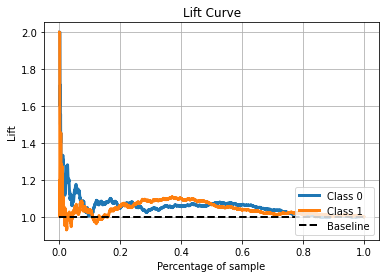

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.54      0.50      0.52      1200
           1       0.54      0.57      0.55      1200

    accuracy                           0.54      2400
   macro avg       0.54      0.54      0.54      2400
weighted avg       0.54      0.54      0.54      2400



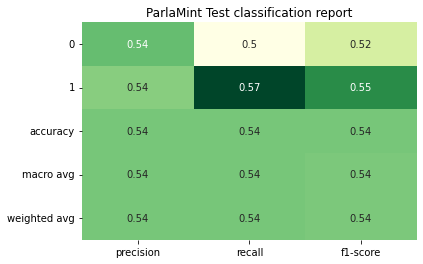


------------------------
  Confusion Matrix
------------------------


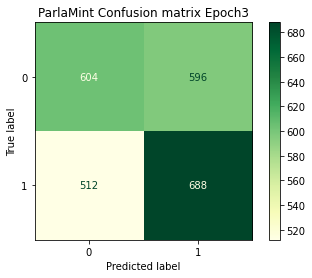

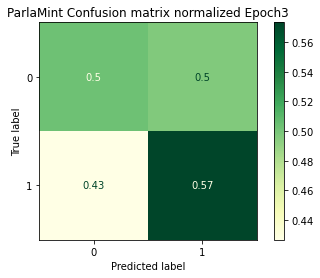

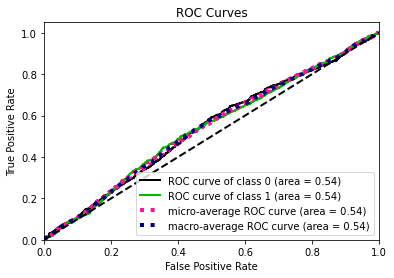

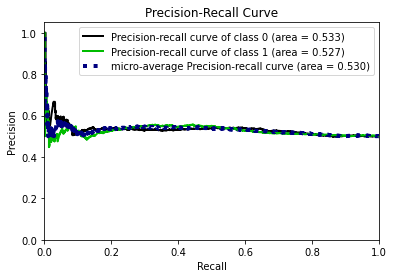

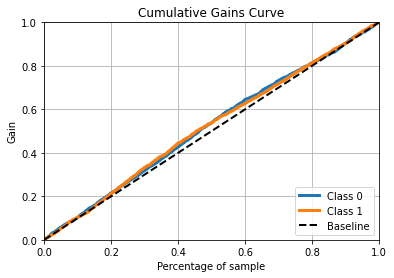

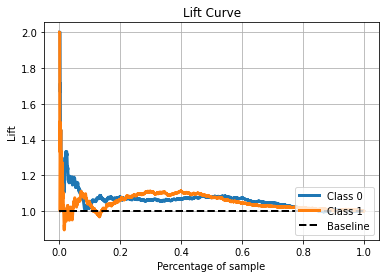

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.51      0.80      0.62      1200
           1       0.54      0.23      0.32      1200

    accuracy                           0.52      2400
   macro avg       0.52      0.52      0.47      2400
weighted avg       0.52      0.52      0.47      2400



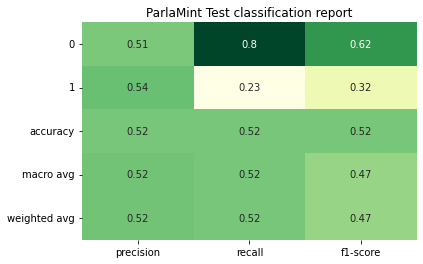


------------------------
  Confusion Matrix
------------------------


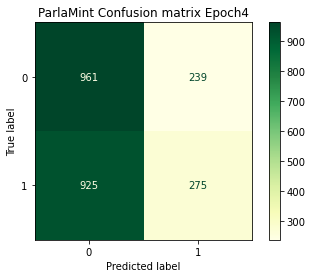

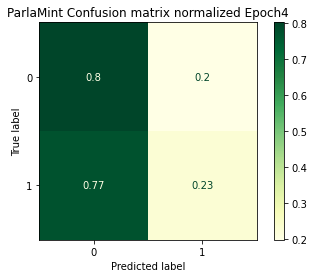

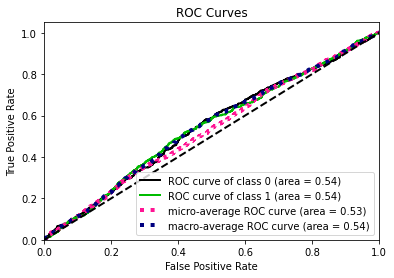

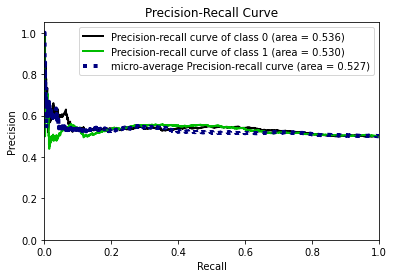

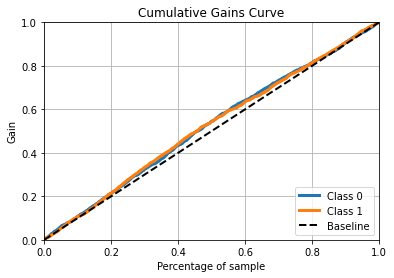

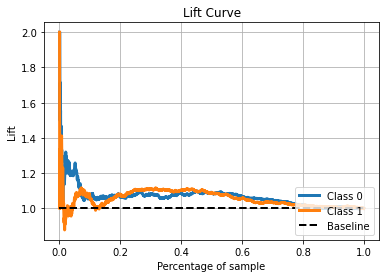

------------------------------------------------------------------------------------------------


In [111]:
lista_cm_normalizzate_bf_random_speech_no_pretrain, lista_clf_report_bf_random_speech_no_pretrain = \
        plot_classification_results(diz_random_speech_bf_no_pretrain['df_random_speech'], True, \
                                    diz_cmap['random_speech'])

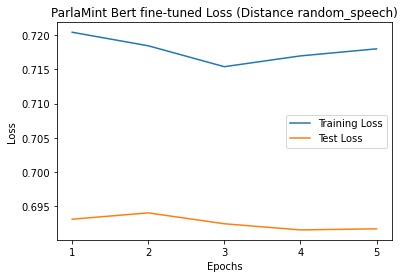

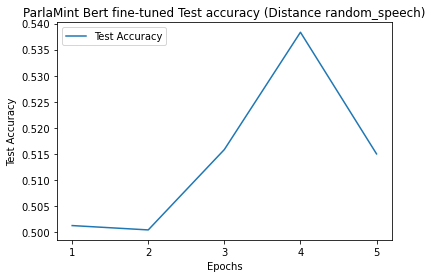

In [112]:
plot_loss_and_accuracy(diz_random_speech_bf_no_pretrain['df_random_speech'], 'random_speech')

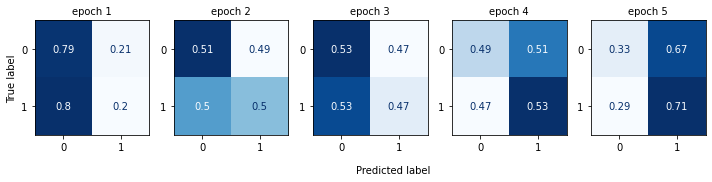

In [113]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_5_no_pretrain, 'BERT fine-tuned', \
                                       '5', diz_cmap['5'], 'ridotto','no_pr')  

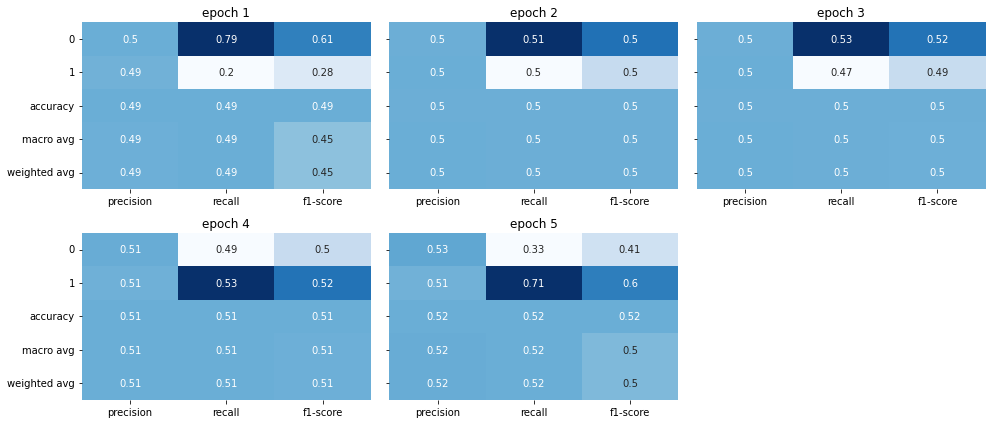

In [114]:
plot_all_classification_report(lista_clf_report_bf_5_no_pretrain, '5', diz_cmap['5'], \
                               'BERT fine-tuned', 'ridotto', 'no_pr')

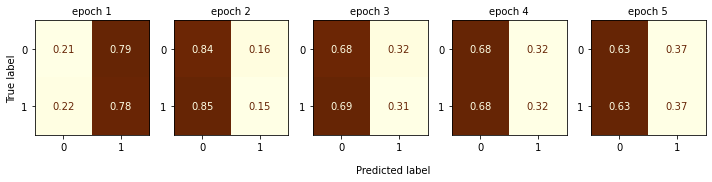

In [115]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_10_no_pretrain, 'BERT fine-tuned', \
                                       '10', diz_cmap['10'], 'ridotto', 'no_pr')    

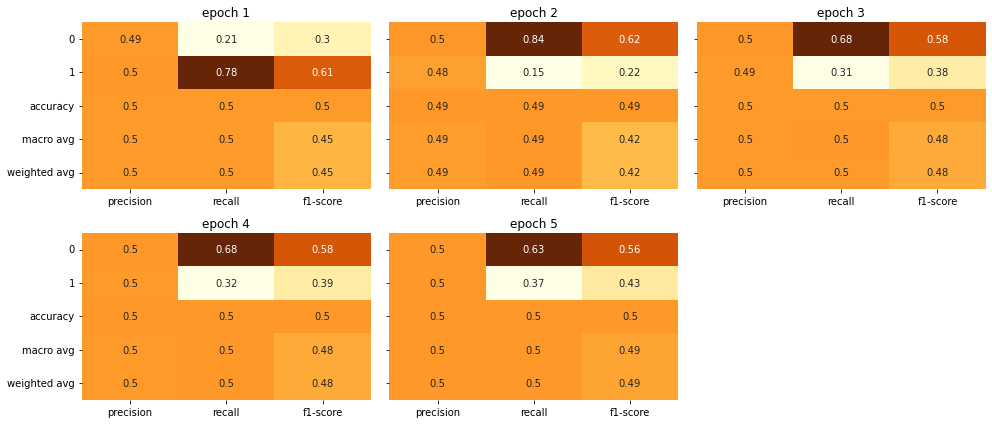

In [116]:
plot_all_classification_report(lista_clf_report_bf_10_no_pretrain, '10', diz_cmap['10'], \
                               'BERT fine-tuned', 'ridotto', 'no_pr')

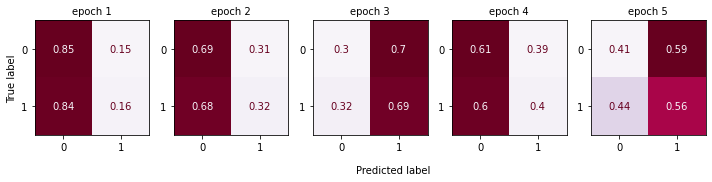

In [117]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_20_no_pretrain, 'BERT fine-tuned', \
                                       '20', diz_cmap['20'], 'ridotto', 'no_pr')  

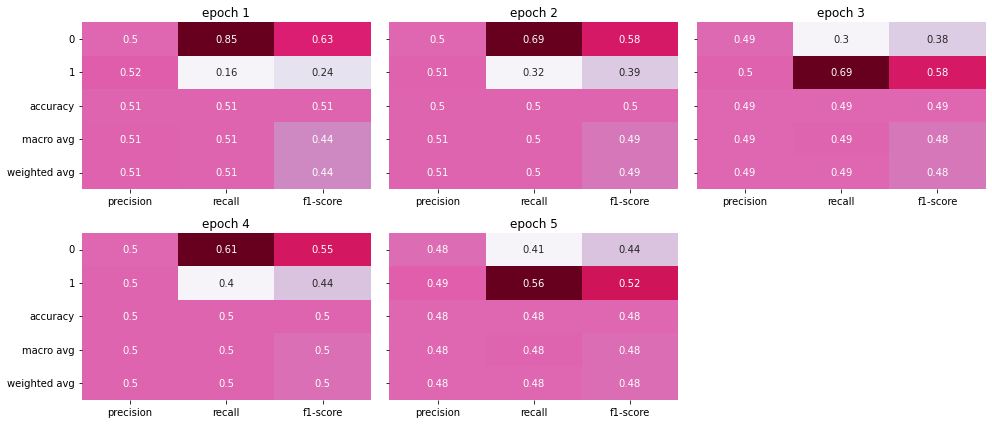

In [118]:
plot_all_classification_report(lista_clf_report_bf_20_no_pretrain, '20', diz_cmap['20'], \
                               'BERT fine-tuned', 'ridotto', 'no_pr')

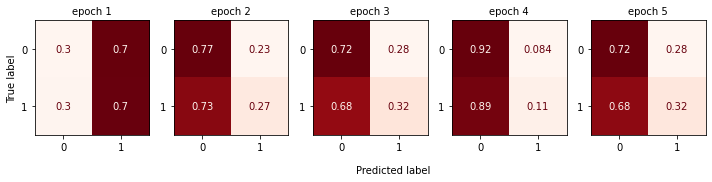

In [119]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_30_no_pretrain, 'BERT fine-tuned', \
                                       '30', diz_cmap['30'], 'ridotto', 'no_pr') 

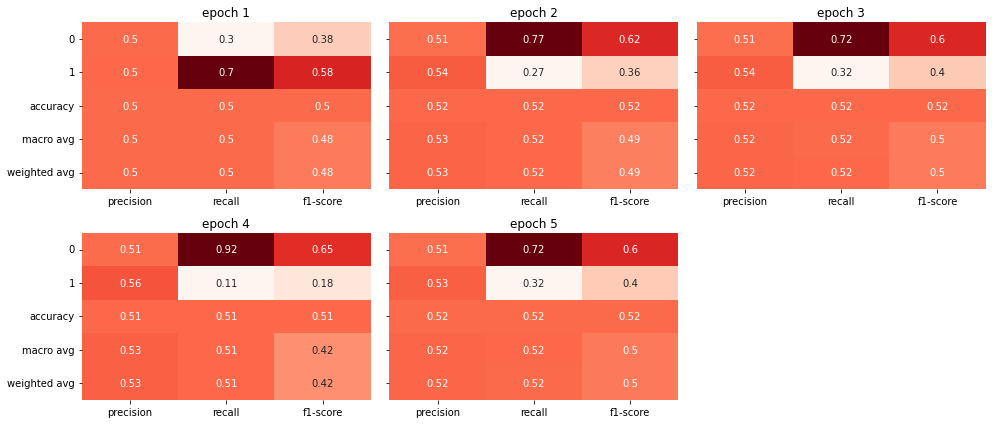

In [120]:
plot_all_classification_report(lista_clf_report_bf_30_no_pretrain, '30', diz_cmap['30'], \
                               'BERT fine-tuned', 'ridotto', 'no_pr')

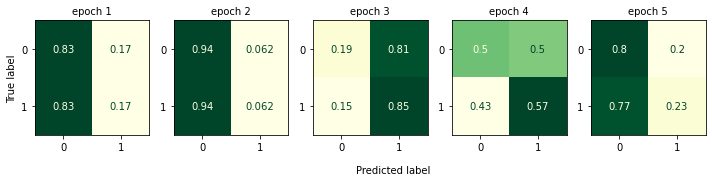

In [121]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_random_speech_no_pretrain, 'BERT fine-tuned', \
                                       'random_speech', diz_cmap['random_speech'], 'ridotto', 'no_pr')

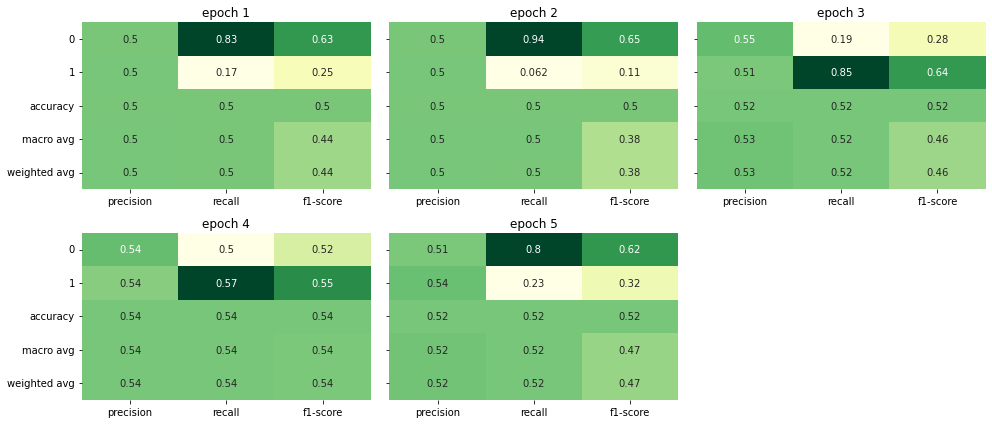

In [122]:
plot_all_classification_report(lista_clf_report_bf_random_speech_no_pretrain, 'random_speech', \
                               diz_cmap['random_speech'], 'BERT fine-tuned', 'ridotto', 'no_pr')

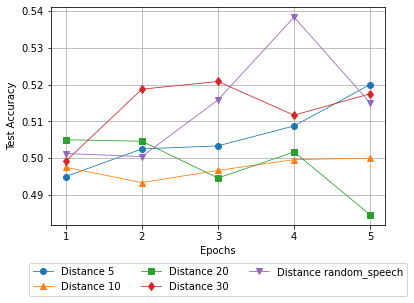

In [123]:
plot_loss_and_accuracy_of_all_distances([diz_dist_5_bf_no_pretrain['df_dist_5'], \
                                         diz_dist_10_bf_no_pretrain['df_dist_10'], \
                                        diz_dist_20_bf_no_pretrain['df_dist_20'], \
                                         diz_dist_30_bf_no_pretrain['df_dist_30'], \
                                        diz_random_speech_bf_no_pretrain['df_random_speech']], 'ridotto', 'no_pr')

# BERT finetuning classification results

In [7]:
dist_5_bf = open(path_pickle + "/" + "df_dist_5_diz_bert_finetuning.pickle", "rb")
dist_10_bf = open(path_pickle + "/" + "df_dist_10_diz_bert_finetuning.pickle", "rb")
dist_20_bf = open(path_pickle + "/" + "df_dist_20_diz_bert_finetuning.pickle", "rb")
dist_30_bf = open(path_pickle + "/" + "df_dist_30_diz_bert_finetuning.pickle", "rb")
random_speech_bf = open(path_pickle + "/" + "df_random_speech_diz_bert_finetuning.pickle", "rb")

diz_dist_5_bf = pickle.load(dist_5_bf)
diz_dist_10_bf = pickle.load(dist_10_bf)
diz_dist_20_bf = pickle.load(dist_20_bf)
diz_dist_30_bf = pickle.load(dist_30_bf)
diz_random_speech_bf = pickle.load(random_speech_bf)

In [16]:
diz_dist_5_bf['df_dist_5']['Epoch0']['gold_classes']

array([1, 1, 0, ..., 1, 1, 1])

In [154]:
lista_ids_bf_5 = controlla_ids(diz_dist_5_bf['df_dist_5'])

inizializzo la lista con il classificatore Epoch0


In [155]:
lista_ids_bf_10 = controlla_ids(diz_dist_10_bf['df_dist_10'])

inizializzo la lista con il classificatore Epoch0


In [156]:
lista_ids_bf_20 = controlla_ids(diz_dist_20_bf['df_dist_20'])

inizializzo la lista con il classificatore Epoch0


In [157]:
lista_ids_bf_30 = controlla_ids(diz_dist_30_bf['df_dist_30'])

inizializzo la lista con il classificatore Epoch0


In [158]:
lista_ids_bf_random_speech = controlla_ids(diz_random_speech_bf['df_random_speech'])

inizializzo la lista con il classificatore Epoch0


In [159]:
diz_dist_5_bf['df_dist_5']['Epoch0']['probabilities']

array([[0.41669473, 0.5833053 ],
       [0.52730846, 0.47269154],
       [0.72762954, 0.27237043],
       ...,
       [0.5023985 , 0.49760154],
       [0.45663714, 0.5433629 ],
       [0.5776616 , 0.42233843]], dtype=float32)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.59      0.58      0.58      1200
           1       0.58      0.59      0.59      1200

    accuracy                           0.59      2400
   macro avg       0.59      0.59      0.59      2400
weighted avg       0.59      0.59      0.59      2400



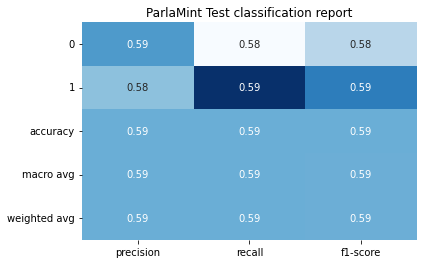


------------------------
  Confusion Matrix
------------------------


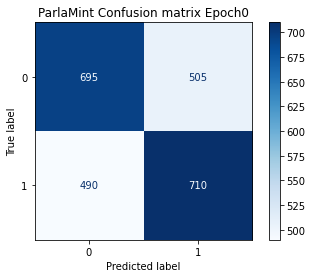

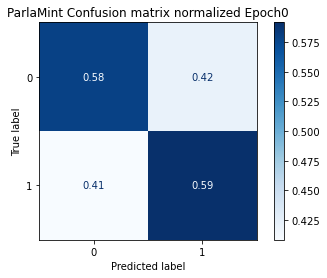

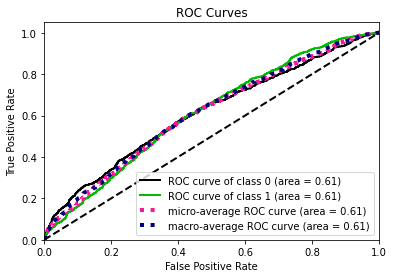

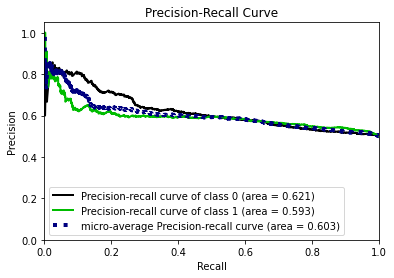

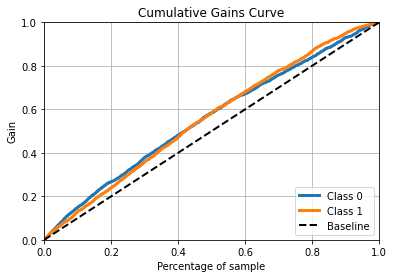

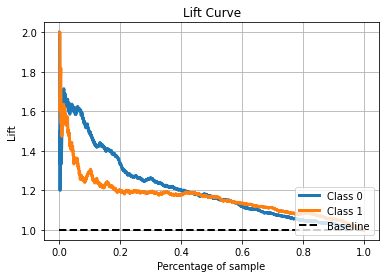

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.58      0.74      0.65      1200
           1       0.65      0.46      0.54      1200

    accuracy                           0.60      2400
   macro avg       0.61      0.60      0.60      2400
weighted avg       0.61      0.60      0.60      2400



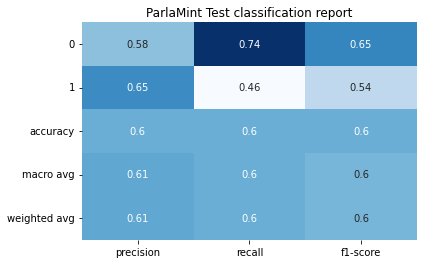


------------------------
  Confusion Matrix
------------------------


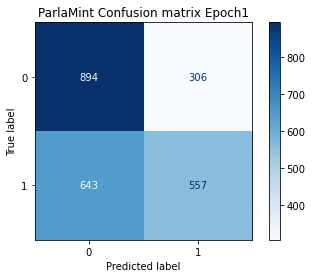

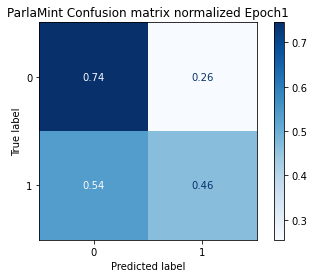

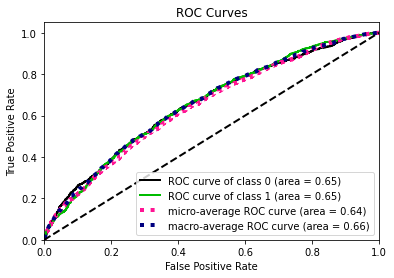

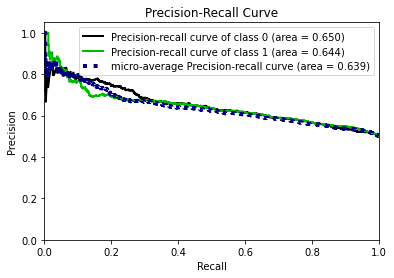

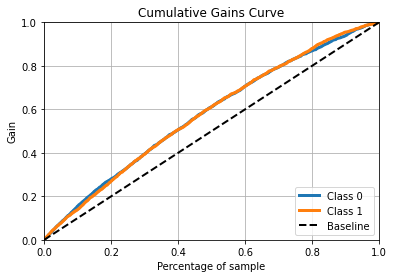

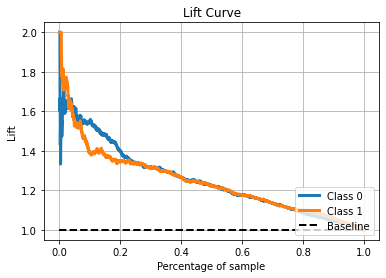

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.62      0.49      0.55      1200
           1       0.58      0.70      0.63      1200

    accuracy                           0.59      2400
   macro avg       0.60      0.59      0.59      2400
weighted avg       0.60      0.59      0.59      2400



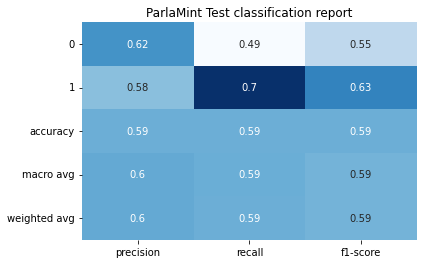


------------------------
  Confusion Matrix
------------------------


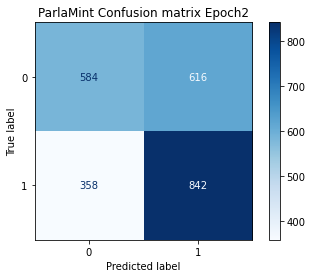

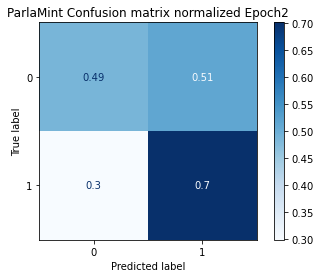

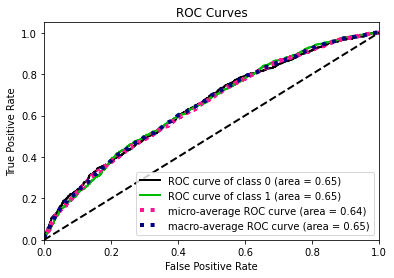

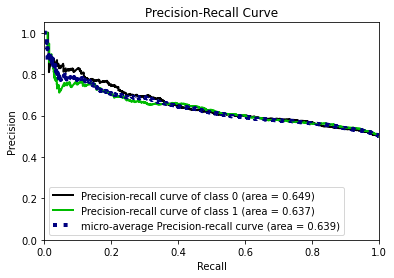

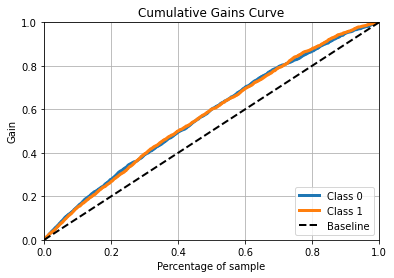

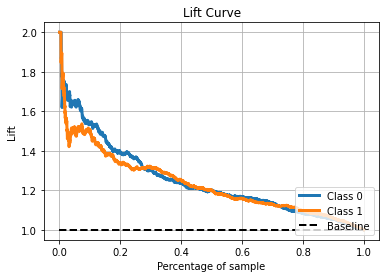

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.62      0.61      1200
           1       0.61      0.58      0.59      1200

    accuracy                           0.60      2400
   macro avg       0.60      0.60      0.60      2400
weighted avg       0.60      0.60      0.60      2400



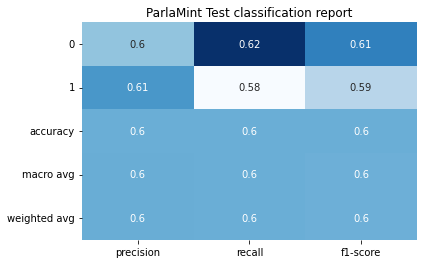


------------------------
  Confusion Matrix
------------------------


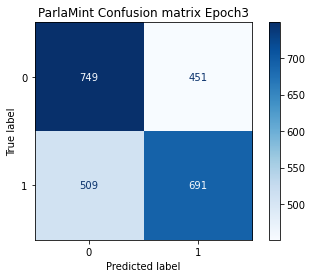

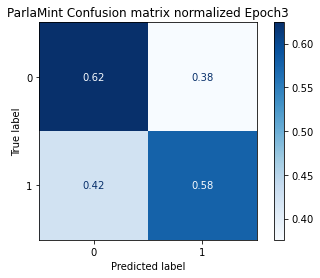

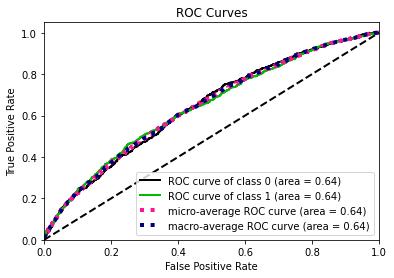

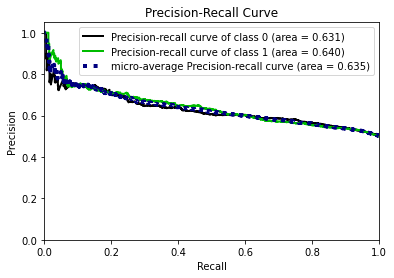

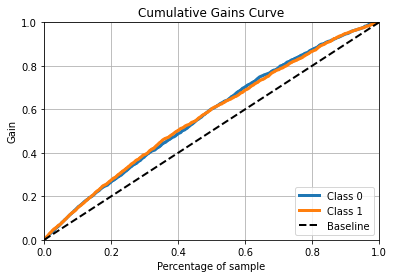

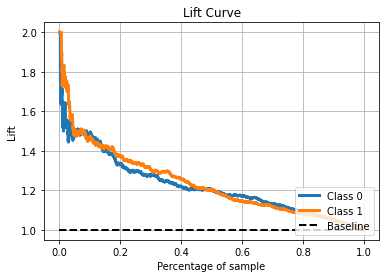

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.62      0.41      0.49      1200
           1       0.56      0.75      0.64      1200

    accuracy                           0.58      2400
   macro avg       0.59      0.58      0.57      2400
weighted avg       0.59      0.58      0.57      2400



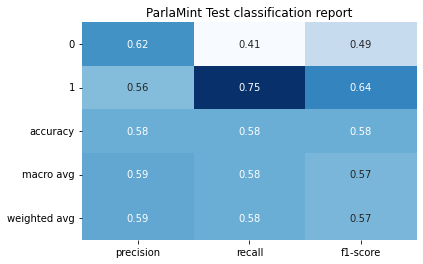


------------------------
  Confusion Matrix
------------------------


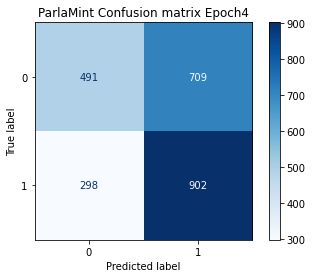

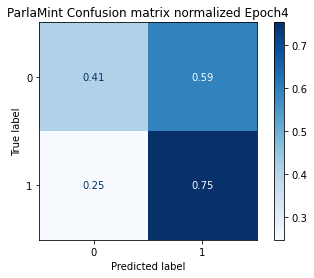

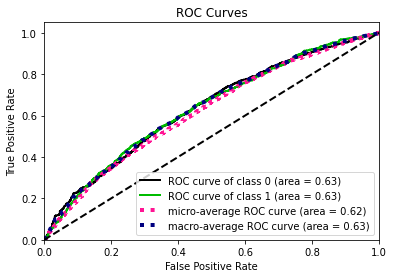

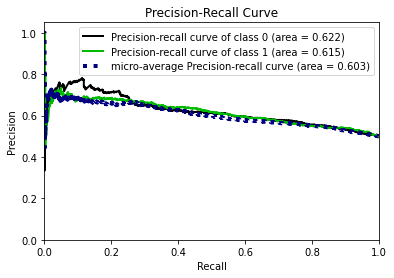

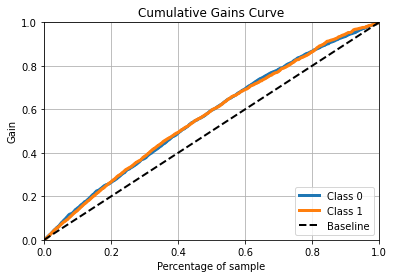

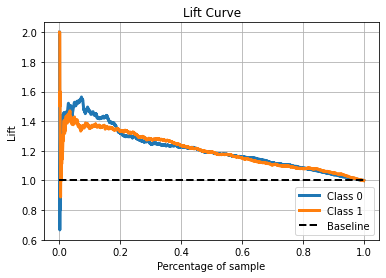

------------------------------------------------------------------------------------------------


In [160]:
lista_cm_normalizzate_bf_5, lista_clf_report_bf_5 = \
        plot_classification_results(diz_dist_5_bf['df_dist_5'], True, diz_cmap['5'])

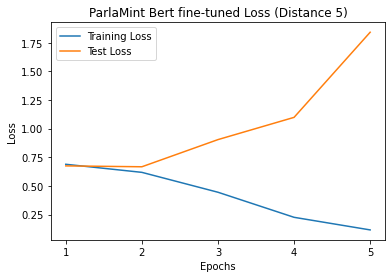

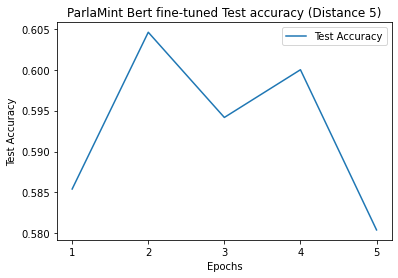

In [161]:
plot_loss_and_accuracy(diz_dist_5_bf['df_dist_5'], 5)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.67      0.51      0.58      1200
           1       0.60      0.74      0.67      1200

    accuracy                           0.63      2400
   macro avg       0.63      0.63      0.62      2400
weighted avg       0.63      0.63      0.62      2400



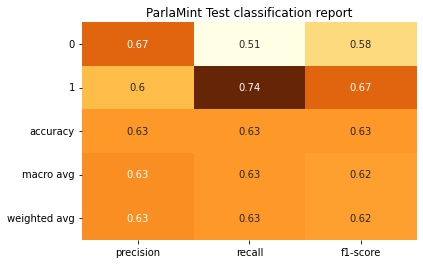


------------------------
  Confusion Matrix
------------------------


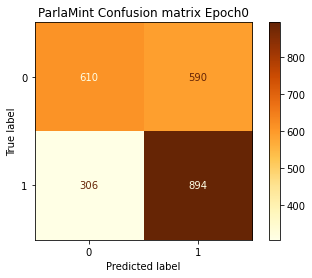

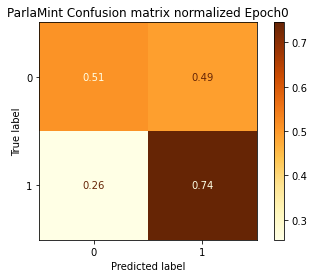

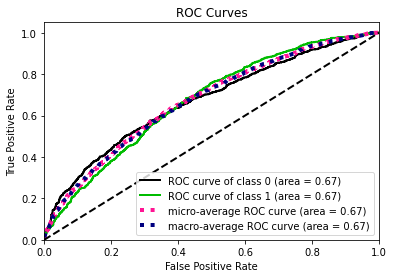

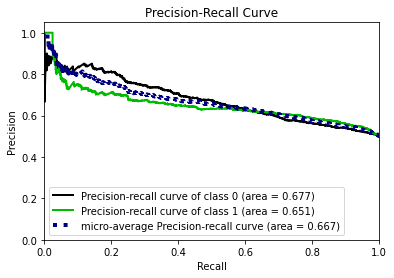

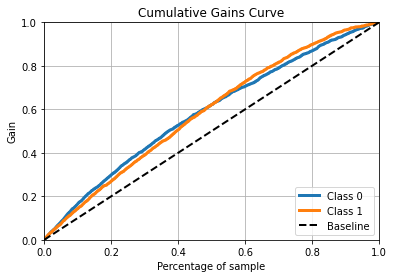

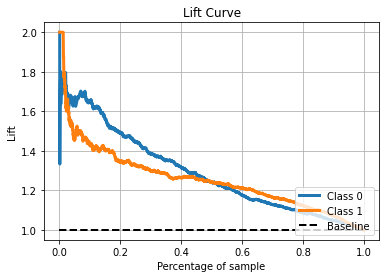

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.64      0.72      0.68      1200
           1       0.68      0.59      0.63      1200

    accuracy                           0.65      2400
   macro avg       0.66      0.65      0.65      2400
weighted avg       0.66      0.65      0.65      2400



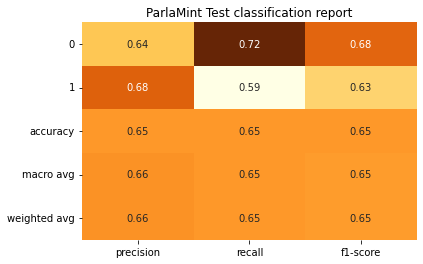


------------------------
  Confusion Matrix
------------------------


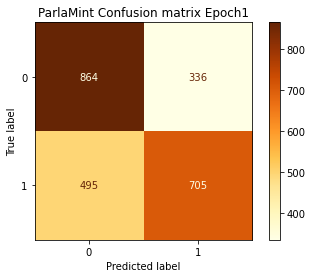

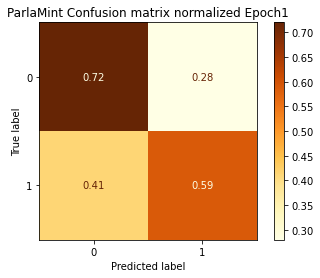

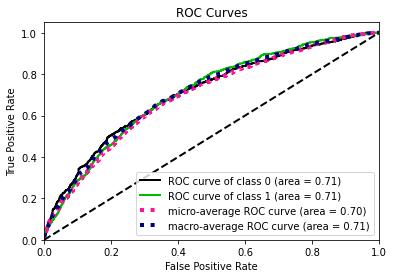

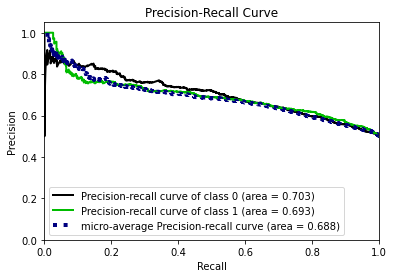

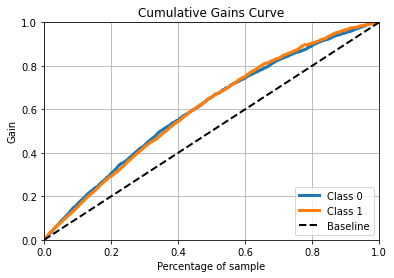

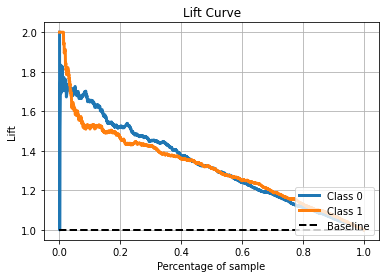

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.64      0.65      0.64      1200
           1       0.64      0.64      0.64      1200

    accuracy                           0.64      2400
   macro avg       0.64      0.64      0.64      2400
weighted avg       0.64      0.64      0.64      2400



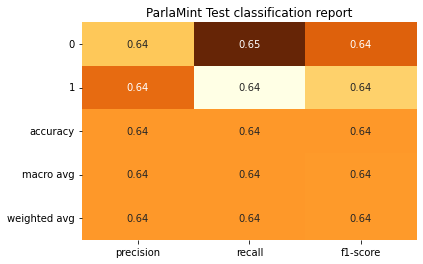


------------------------
  Confusion Matrix
------------------------


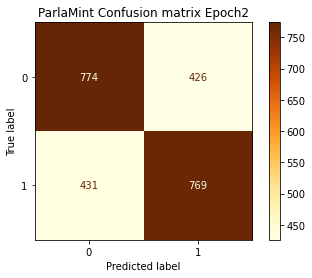

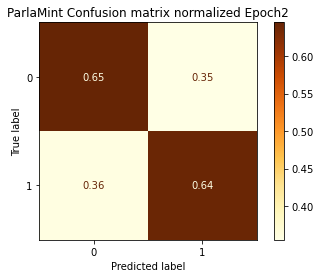

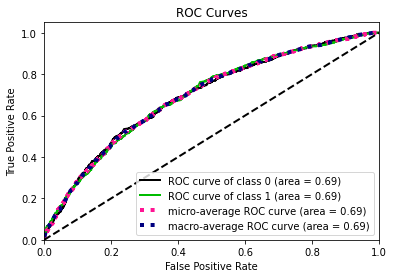

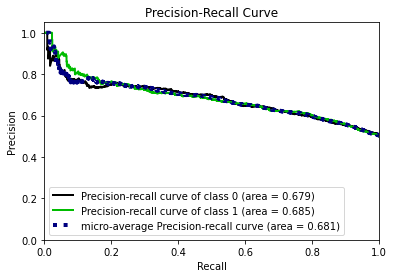

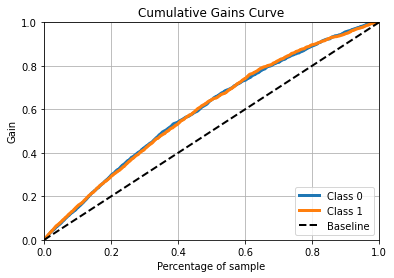

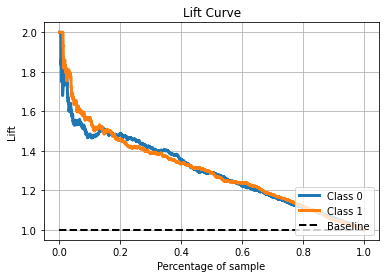

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.64      0.64      0.64      1200
           1       0.64      0.63      0.63      1200

    accuracy                           0.64      2400
   macro avg       0.64      0.64      0.64      2400
weighted avg       0.64      0.64      0.64      2400



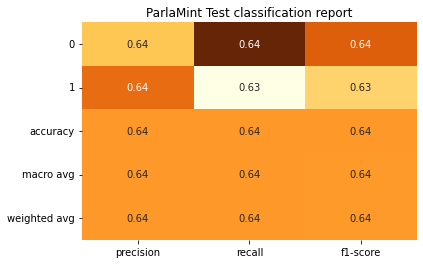


------------------------
  Confusion Matrix
------------------------


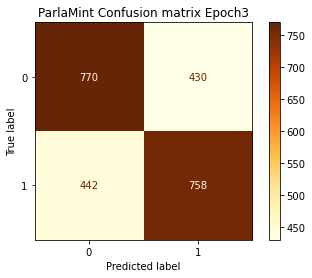

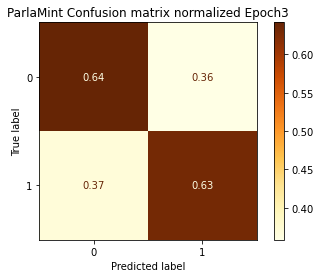

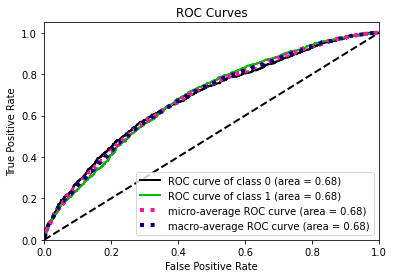

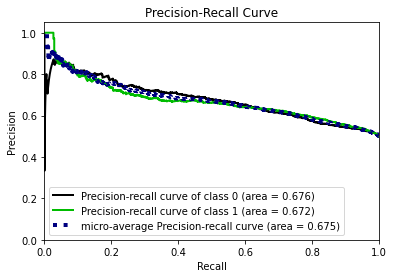

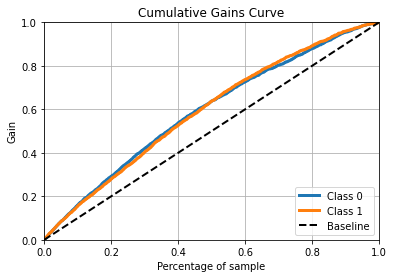

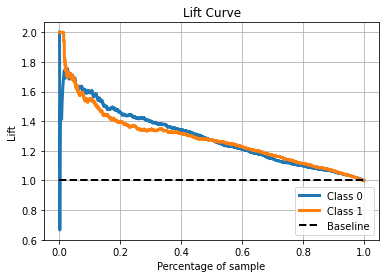

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.60      0.75      0.66      1200
           1       0.66      0.49      0.56      1200

    accuracy                           0.62      2400
   macro avg       0.63      0.62      0.61      2400
weighted avg       0.63      0.62      0.61      2400



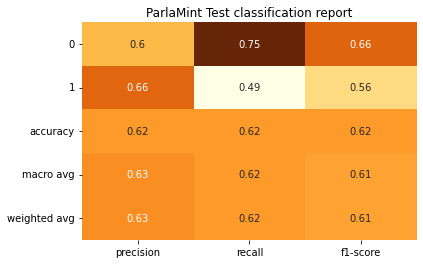


------------------------
  Confusion Matrix
------------------------


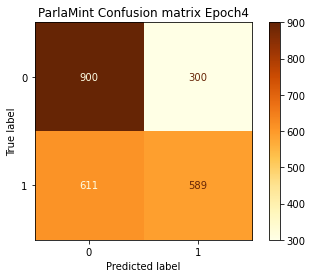

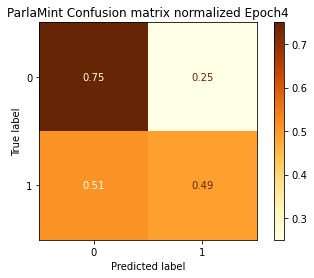

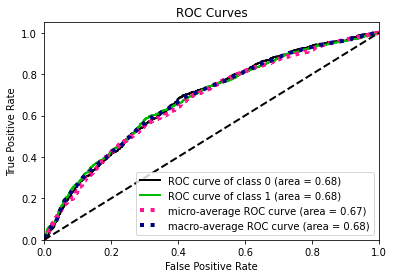

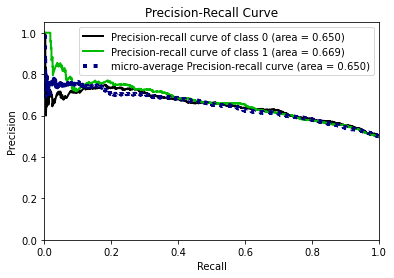

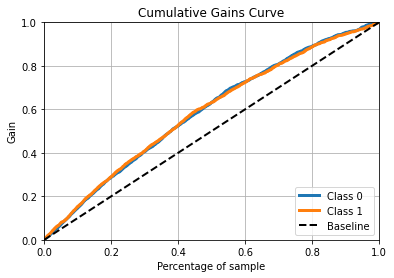

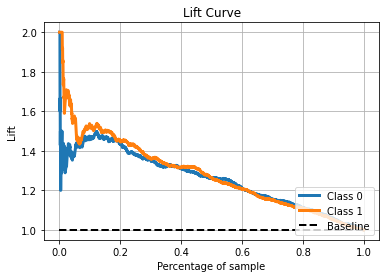

------------------------------------------------------------------------------------------------


In [162]:
lista_cm_normalizzate_bf_10, lista_clf_report_bf_10 = \
        plot_classification_results(diz_dist_10_bf['df_dist_10'], True, diz_cmap['10'])

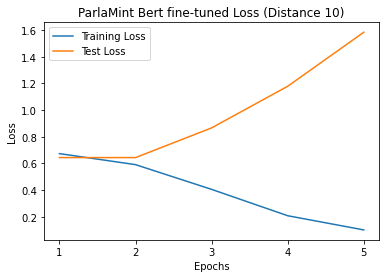

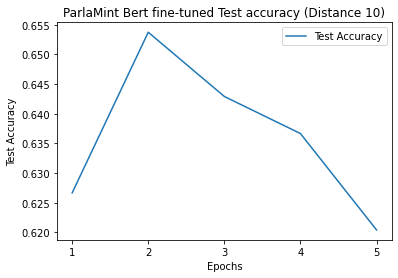

In [163]:
plot_loss_and_accuracy(diz_dist_10_bf['df_dist_10'], 10)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.68      0.61      0.64      1200
           1       0.65      0.71      0.68      1200

    accuracy                           0.66      2400
   macro avg       0.66      0.66      0.66      2400
weighted avg       0.66      0.66      0.66      2400



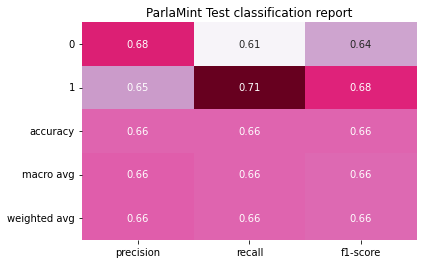


------------------------
  Confusion Matrix
------------------------


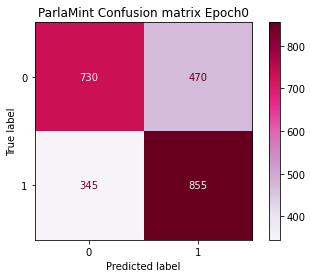

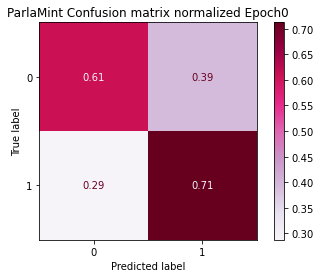

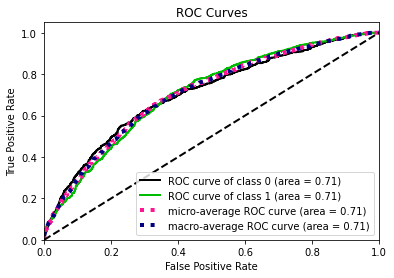

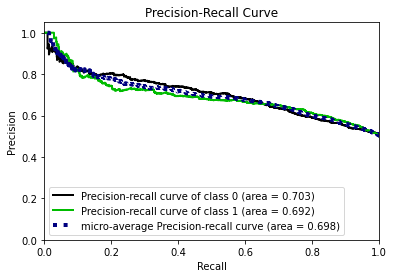

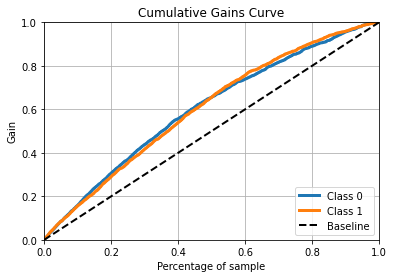

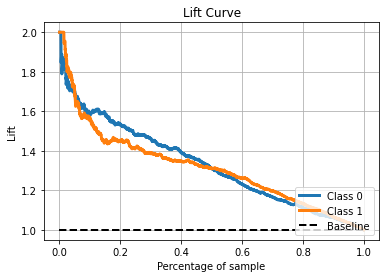

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.70      0.52      0.60      1200
           1       0.62      0.78      0.69      1200

    accuracy                           0.65      2400
   macro avg       0.66      0.65      0.64      2400
weighted avg       0.66      0.65      0.64      2400



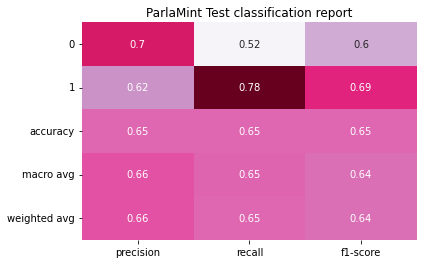


------------------------
  Confusion Matrix
------------------------


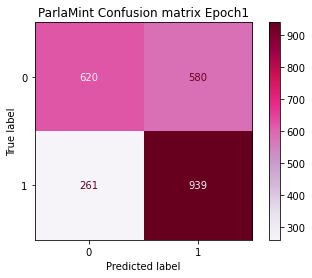

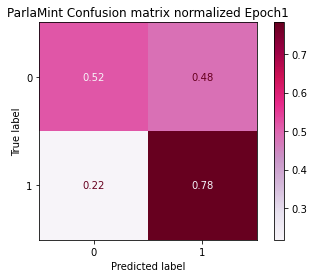

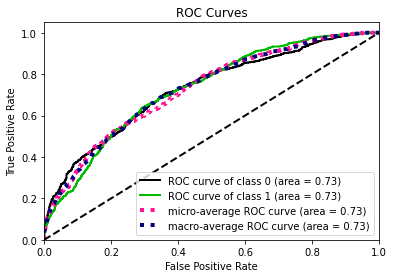

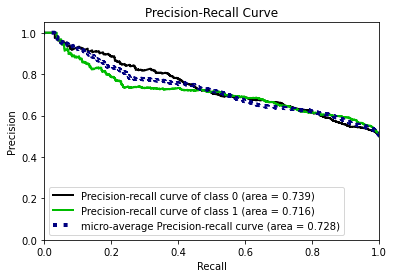

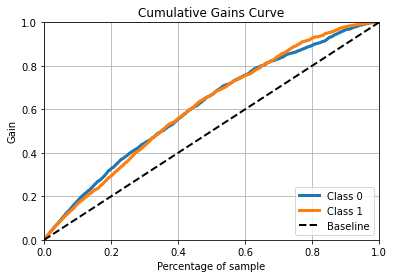

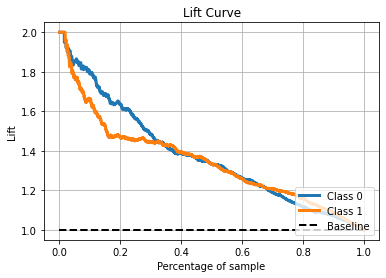

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.69      0.65      0.67      1200
           1       0.67      0.71      0.69      1200

    accuracy                           0.68      2400
   macro avg       0.68      0.68      0.68      2400
weighted avg       0.68      0.68      0.68      2400



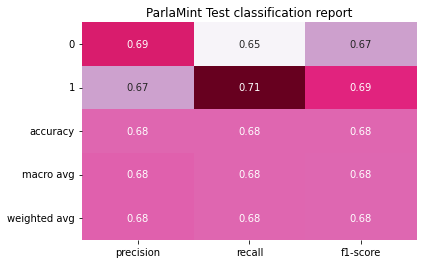


------------------------
  Confusion Matrix
------------------------


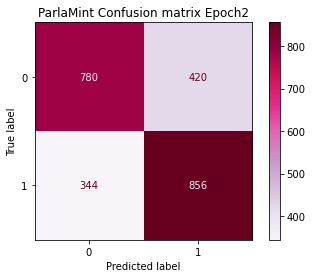

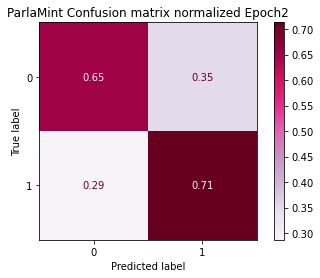

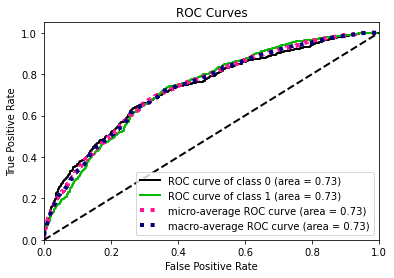

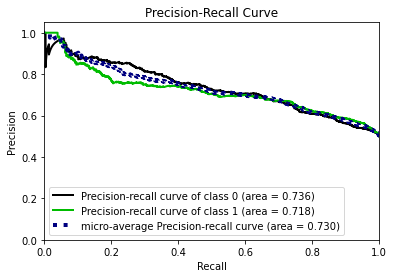

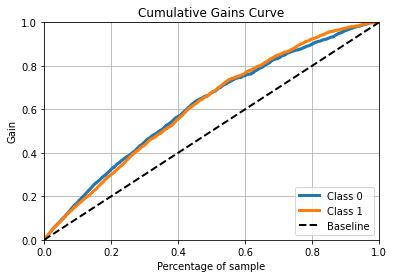

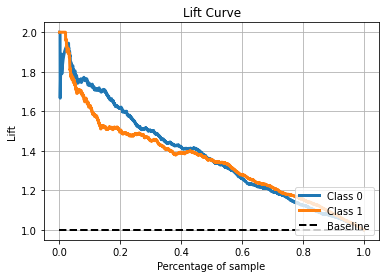

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.62      0.81      0.70      1200
           1       0.72      0.51      0.60      1200

    accuracy                           0.66      2400
   macro avg       0.67      0.66      0.65      2400
weighted avg       0.67      0.66      0.65      2400



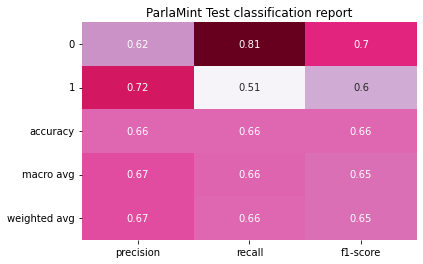


------------------------
  Confusion Matrix
------------------------


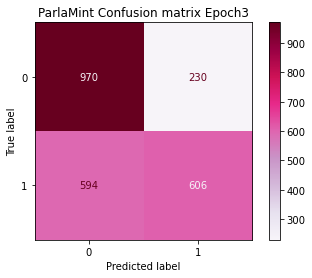

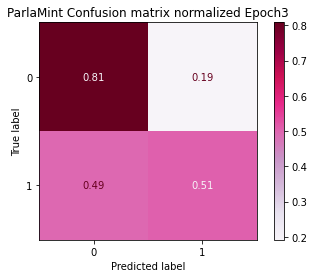

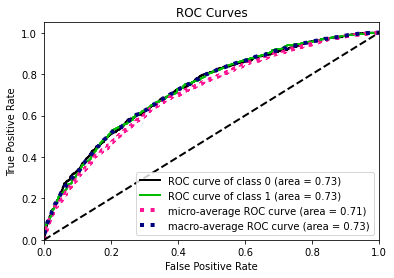

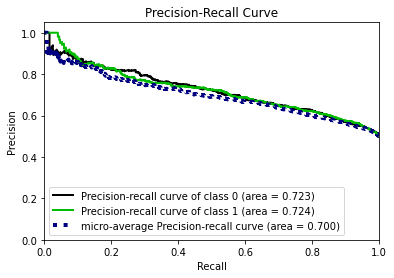

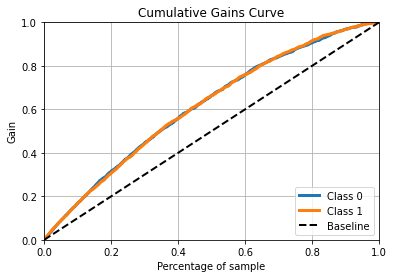

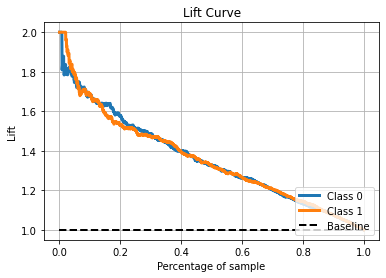

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.66      0.68      0.67      1200
           1       0.67      0.64      0.66      1200

    accuracy                           0.66      2400
   macro avg       0.66      0.66      0.66      2400
weighted avg       0.66      0.66      0.66      2400



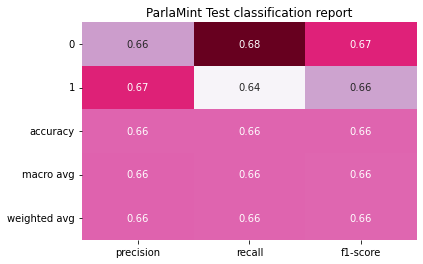


------------------------
  Confusion Matrix
------------------------


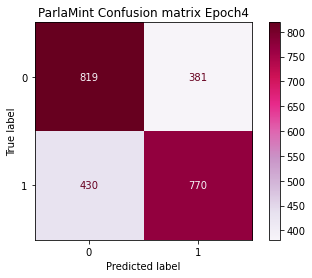

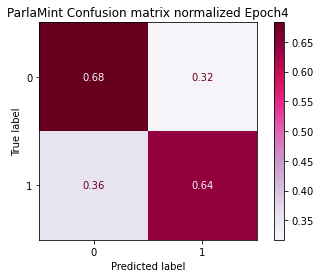

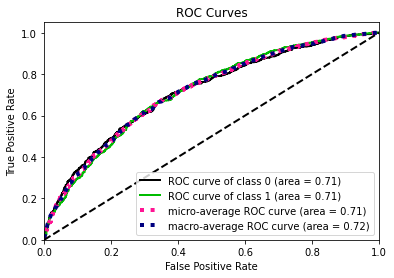

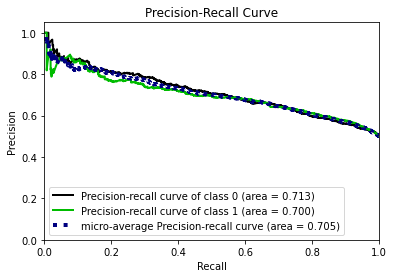

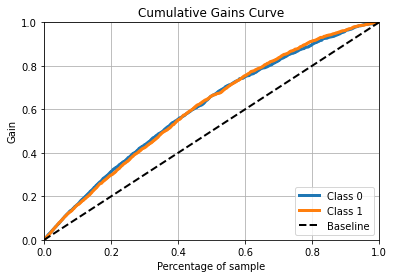

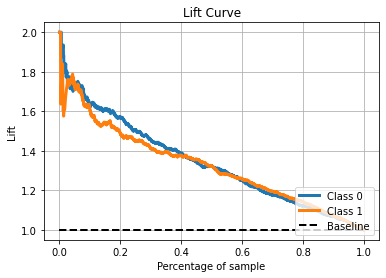

------------------------------------------------------------------------------------------------


In [164]:
lista_cm_normalizzate_bf_20, lista_clf_report_bf_20 = \
        plot_classification_results(diz_dist_20_bf['df_dist_20'], True, diz_cmap['20'])

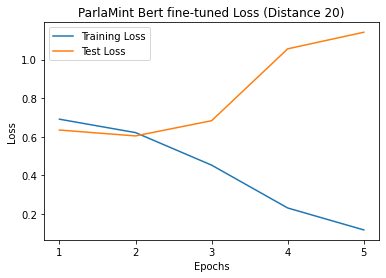

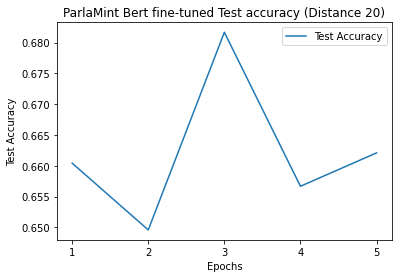

In [165]:
plot_loss_and_accuracy(diz_dist_20_bf['df_dist_20'], 20)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.67      0.67      0.67      1200
           1       0.67      0.67      0.67      1200

    accuracy                           0.67      2400
   macro avg       0.67      0.67      0.67      2400
weighted avg       0.67      0.67      0.67      2400



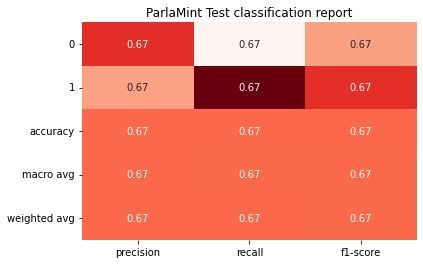


------------------------
  Confusion Matrix
------------------------


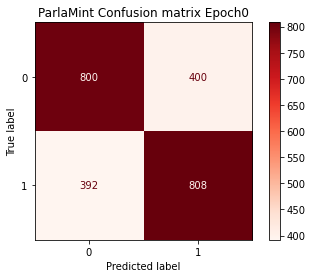

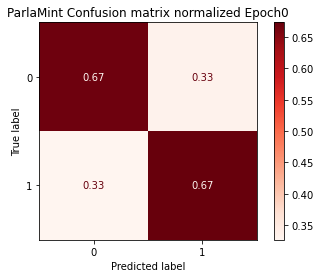

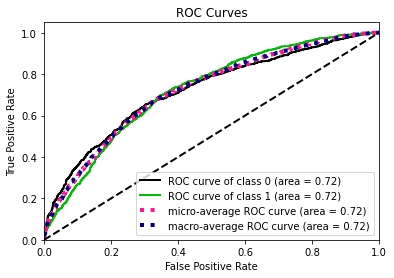

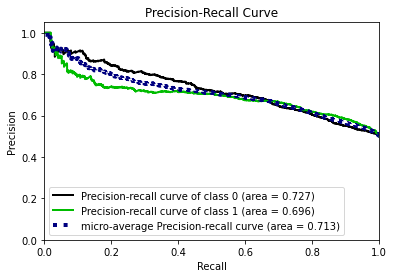

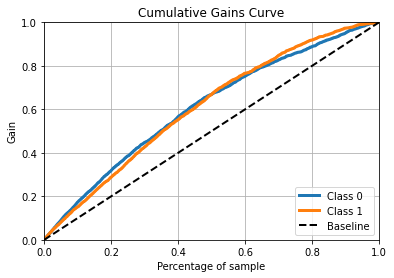

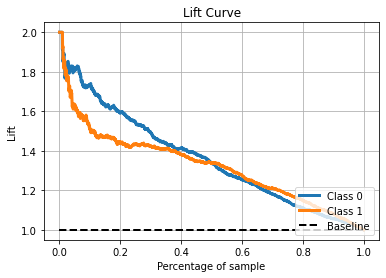

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.65      0.74      0.69      1200
           1       0.70      0.60      0.65      1200

    accuracy                           0.67      2400
   macro avg       0.67      0.67      0.67      2400
weighted avg       0.67      0.67      0.67      2400



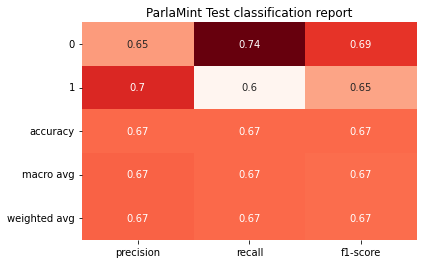


------------------------
  Confusion Matrix
------------------------


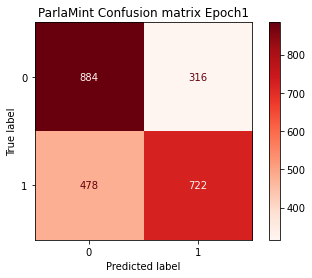

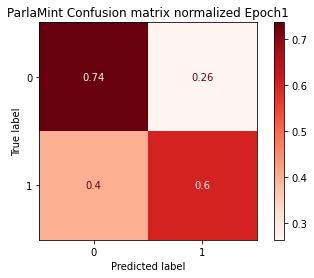

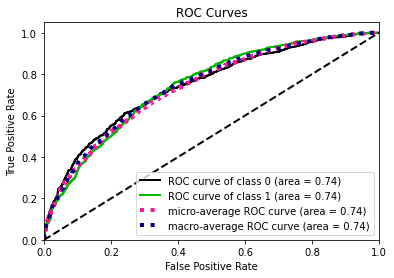

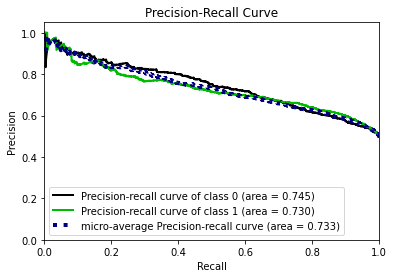

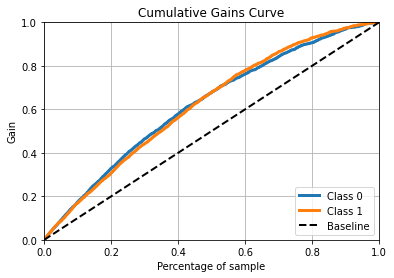

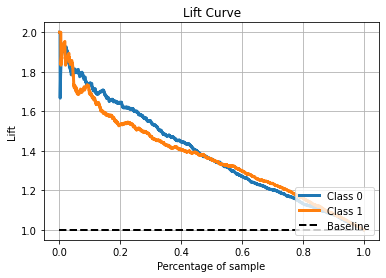

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.69      0.62      0.65      1200
           1       0.65      0.73      0.69      1200

    accuracy                           0.67      2400
   macro avg       0.67      0.67      0.67      2400
weighted avg       0.67      0.67      0.67      2400



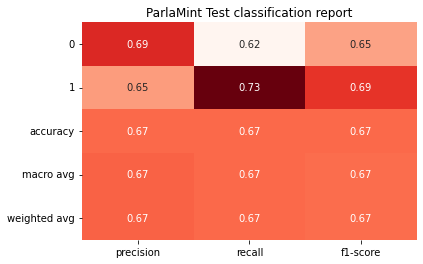


------------------------
  Confusion Matrix
------------------------


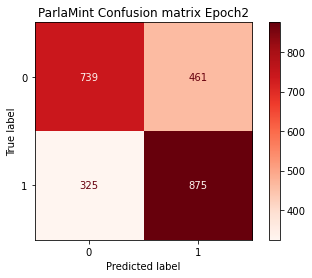

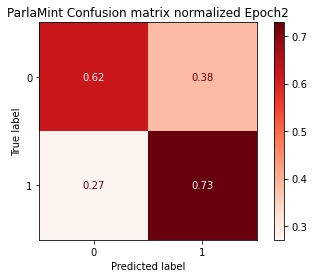

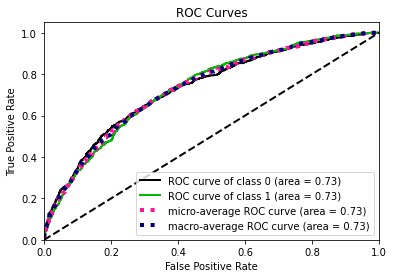

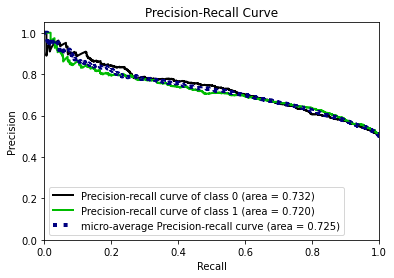

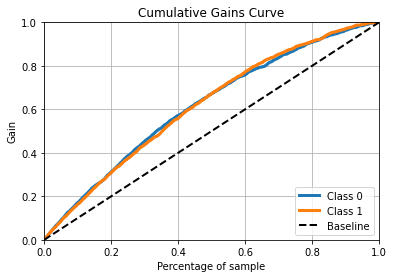

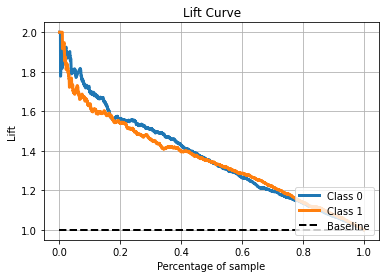

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.66      0.67      0.67      1200
           1       0.67      0.66      0.66      1200

    accuracy                           0.66      2400
   macro avg       0.66      0.66      0.66      2400
weighted avg       0.66      0.66      0.66      2400



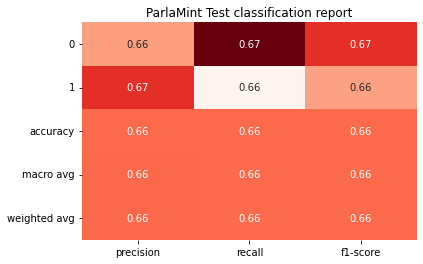


------------------------
  Confusion Matrix
------------------------


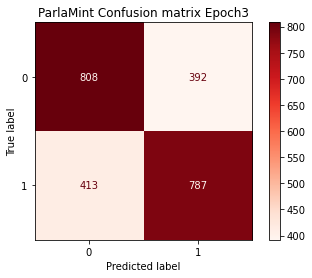

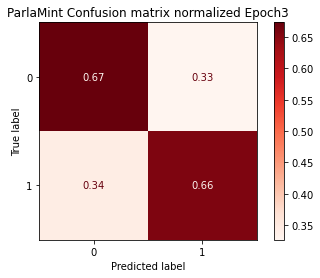

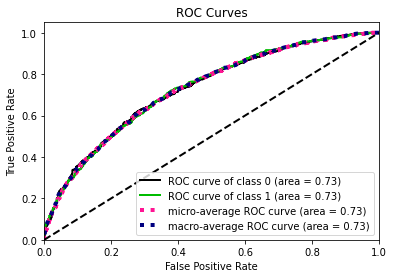

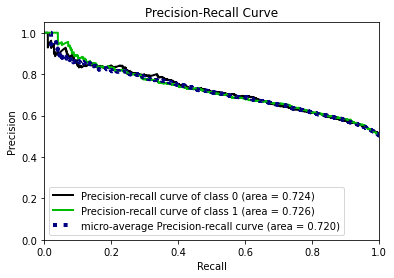

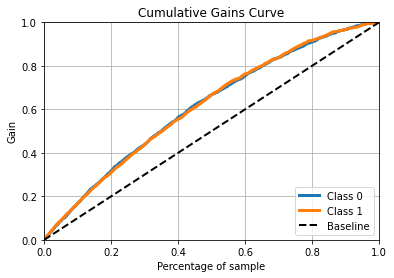

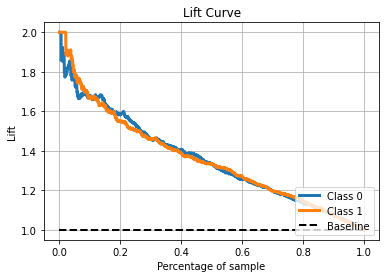

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.68      0.66      0.67      1200
           1       0.67      0.69      0.68      1200

    accuracy                           0.67      2400
   macro avg       0.67      0.67      0.67      2400
weighted avg       0.67      0.67      0.67      2400



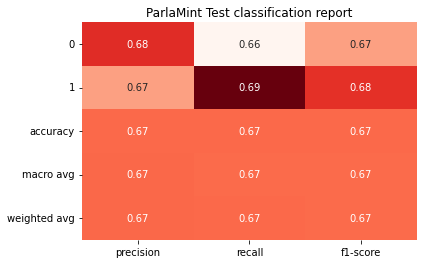


------------------------
  Confusion Matrix
------------------------


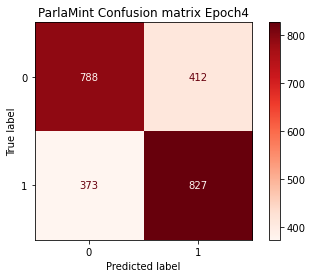

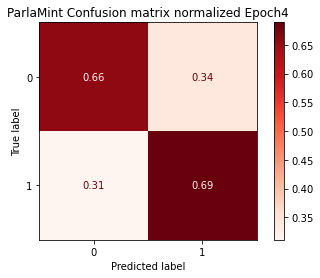

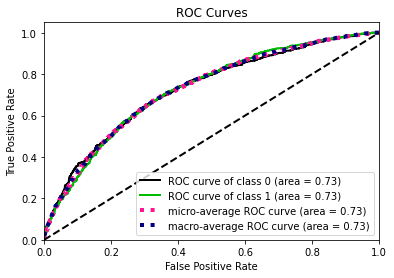

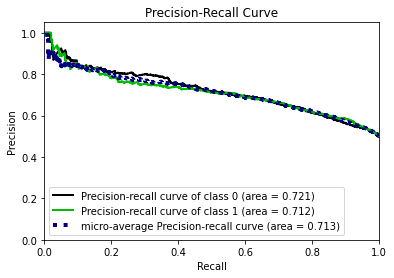

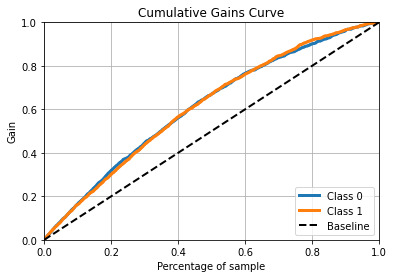

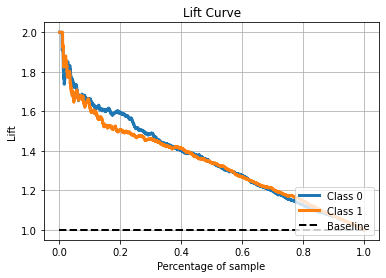

------------------------------------------------------------------------------------------------


In [166]:
lista_cm_normalizzate_bf_30, lista_clf_report_bf_30 = \
        plot_classification_results(diz_dist_30_bf['df_dist_30'], True, diz_cmap['30'])

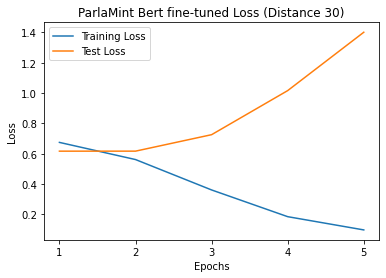

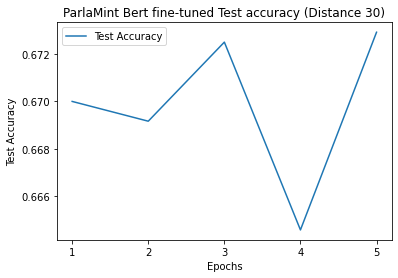

In [167]:
plot_loss_and_accuracy(diz_dist_30_bf['df_dist_30'], 30)

Epoch0
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.87      0.70      0.78      1200
           1       0.75      0.90      0.82      1200

    accuracy                           0.80      2400
   macro avg       0.81      0.80      0.80      2400
weighted avg       0.81      0.80      0.80      2400



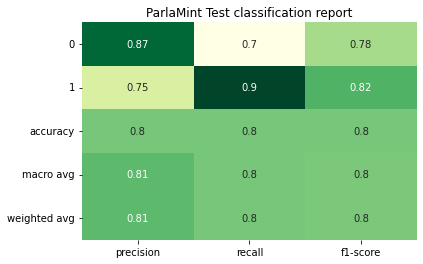


------------------------
  Confusion Matrix
------------------------


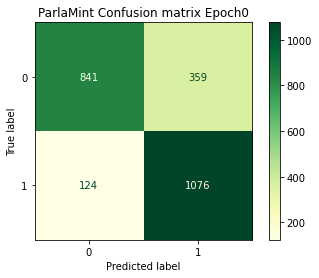

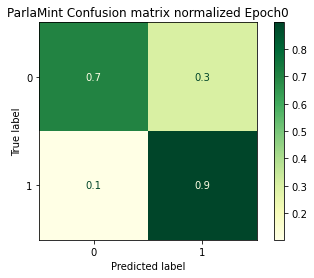

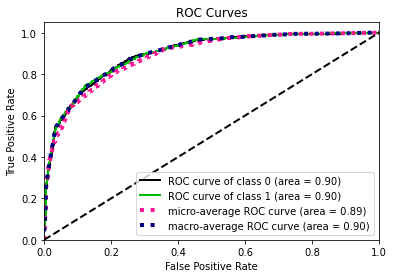

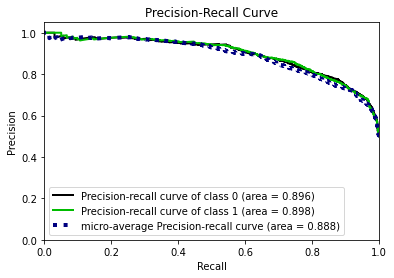

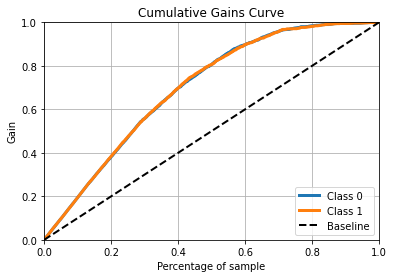

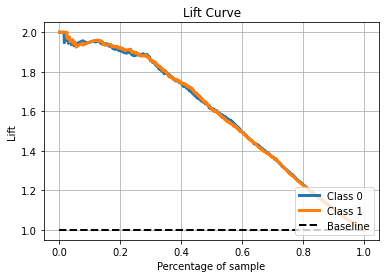

------------------------------------------------------------------------------------------------
Epoch1
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.90      0.62      0.74      1200
           1       0.71      0.93      0.81      1200

    accuracy                           0.78      2400
   macro avg       0.81      0.78      0.77      2400
weighted avg       0.81      0.78      0.77      2400



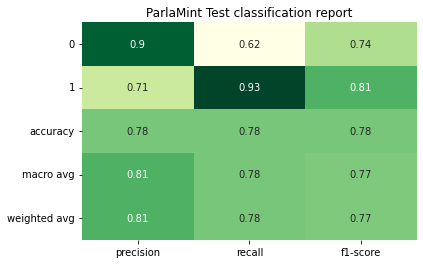


------------------------
  Confusion Matrix
------------------------


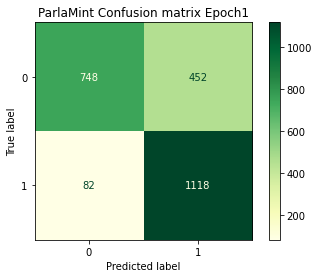

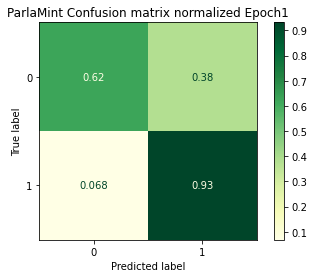

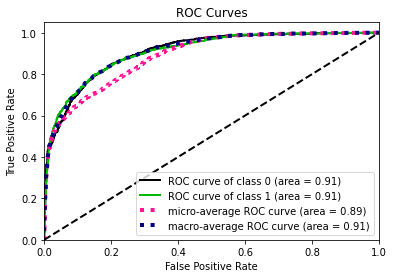

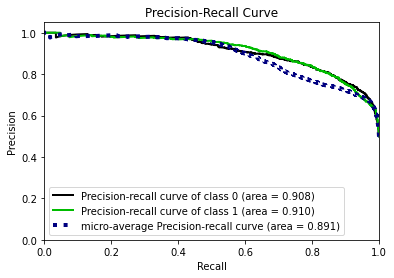

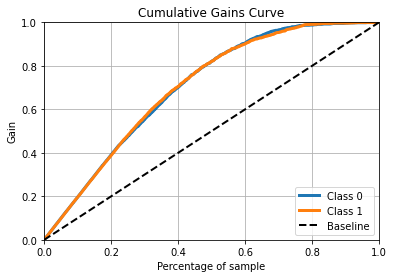

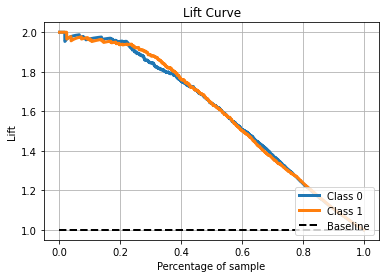

------------------------------------------------------------------------------------------------
Epoch2
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.85      0.77      0.81      1200
           1       0.79      0.86      0.83      1200

    accuracy                           0.82      2400
   macro avg       0.82      0.82      0.82      2400
weighted avg       0.82      0.82      0.82      2400



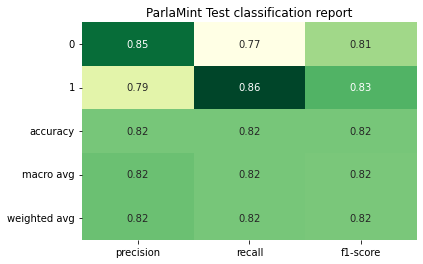


------------------------
  Confusion Matrix
------------------------


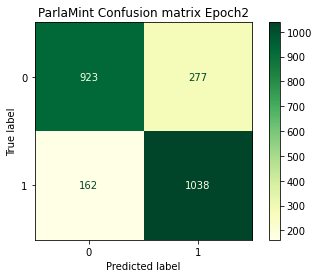

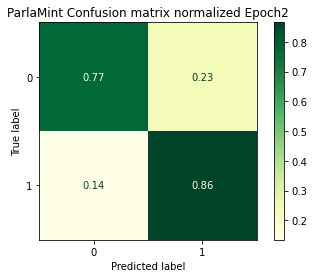

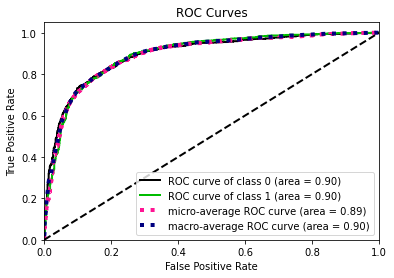

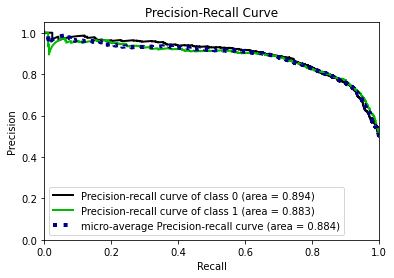

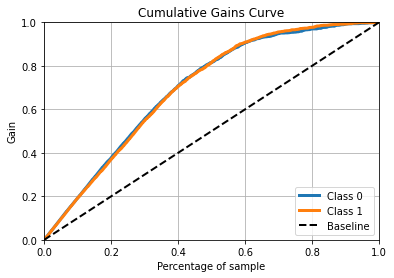

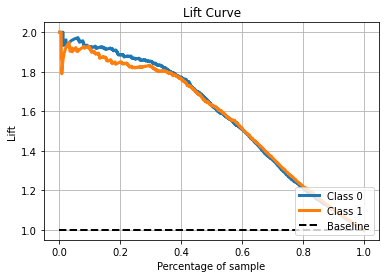

------------------------------------------------------------------------------------------------
Epoch3
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.81      0.86      0.83      1200
           1       0.85      0.80      0.82      1200

    accuracy                           0.83      2400
   macro avg       0.83      0.83      0.83      2400
weighted avg       0.83      0.83      0.83      2400



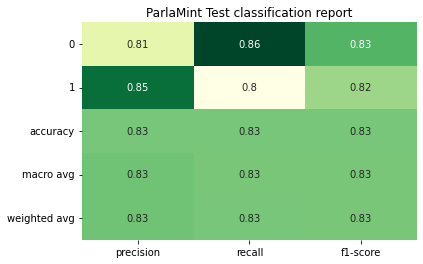


------------------------
  Confusion Matrix
------------------------


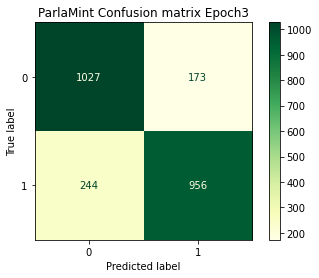

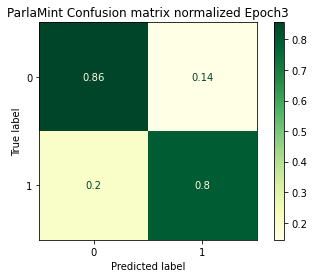

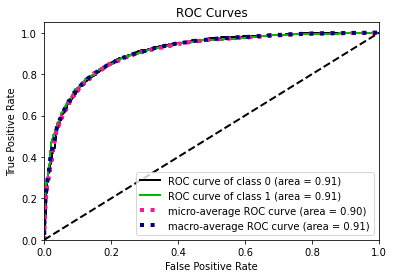

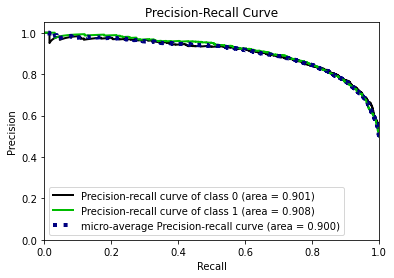

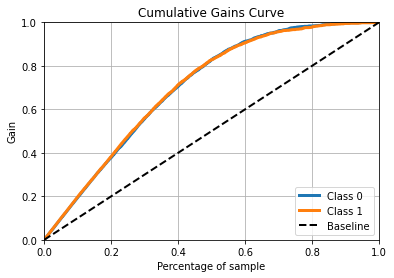

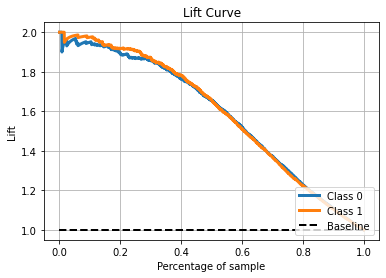

------------------------------------------------------------------------------------------------
Epoch4
------------------------
  Summary
------------------------
              precision    recall  f1-score   support

           0       0.82      0.82      0.82      1200
           1       0.82      0.82      0.82      1200

    accuracy                           0.82      2400
   macro avg       0.82      0.82      0.82      2400
weighted avg       0.82      0.82      0.82      2400



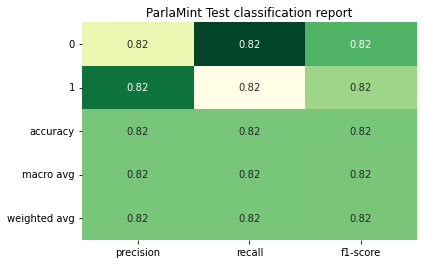


------------------------
  Confusion Matrix
------------------------


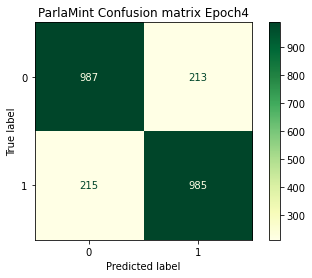

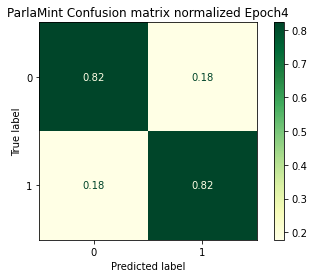

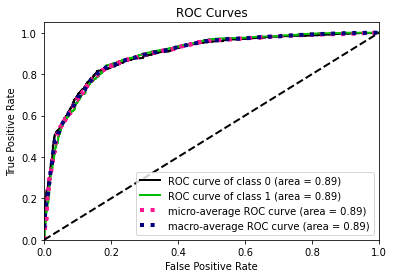

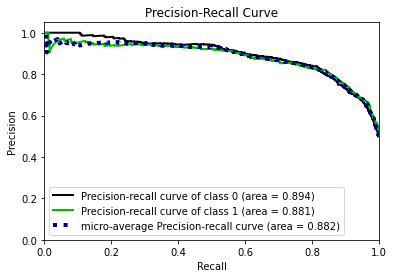

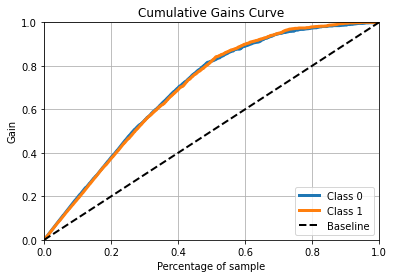

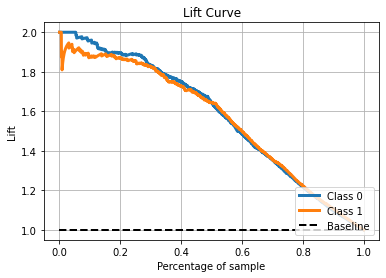

------------------------------------------------------------------------------------------------


In [168]:
lista_cm_normalizzate_bf_random_speech, lista_clf_report_bf_random_speech = \
        plot_classification_results(diz_random_speech_bf['df_random_speech'], True, diz_cmap['random_speech'])

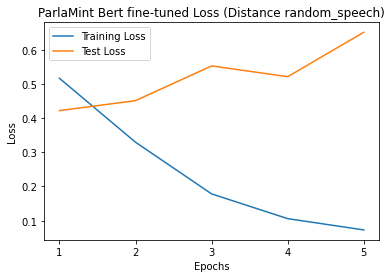

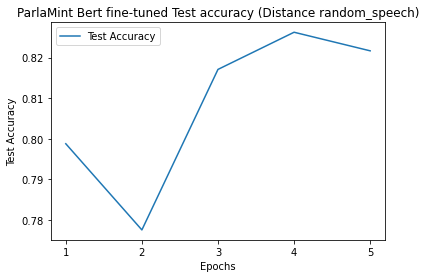

In [169]:
plot_loss_and_accuracy(diz_random_speech_bf['df_random_speech'], 'random_speech')

In [170]:
diz_dist_5_bf['df_dist_5']['Epoch0'].keys()

dict_keys(['accuracy', 'avg_loss', 'ids_proba', 'ids_preds', 'gold_classes', 'system_classes', 'label_list', 'probabilities', 'total_sentences_ids', 'training_loss', 'training_time', 'test_time'])

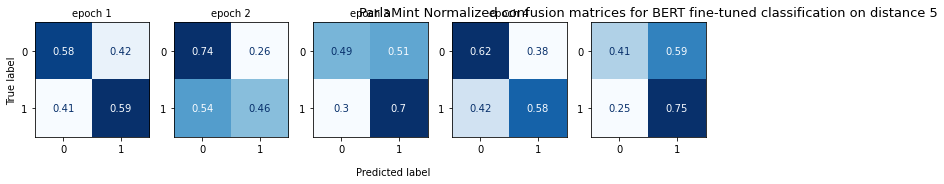

In [171]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_5, 'BERT fine-tuned', '5', diz_cmap['5'])    

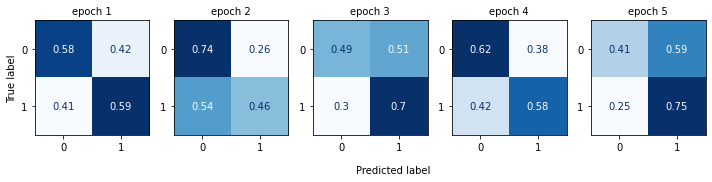

In [172]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_5, 'BERT fine-tuned', '5', diz_cmap['5'], 'ridotto')  

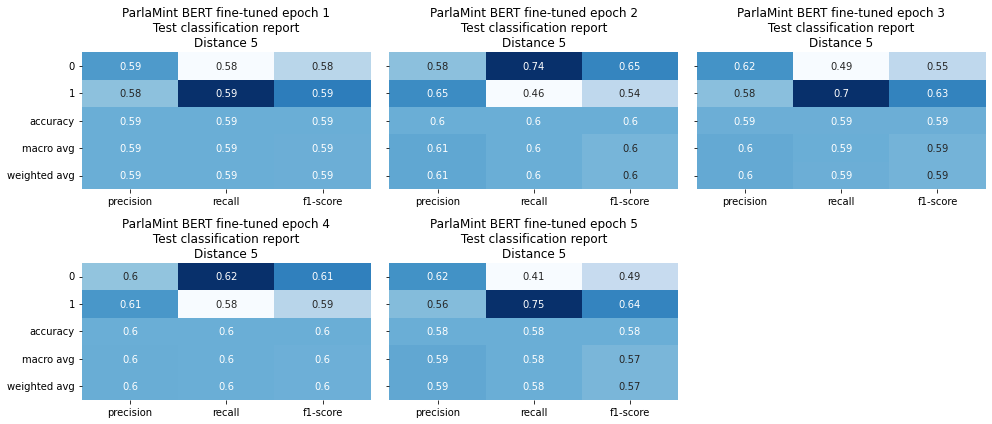

In [173]:
plot_all_classification_report(lista_clf_report_bf_5, '5', diz_cmap['5'], 'BERT fine-tuned')

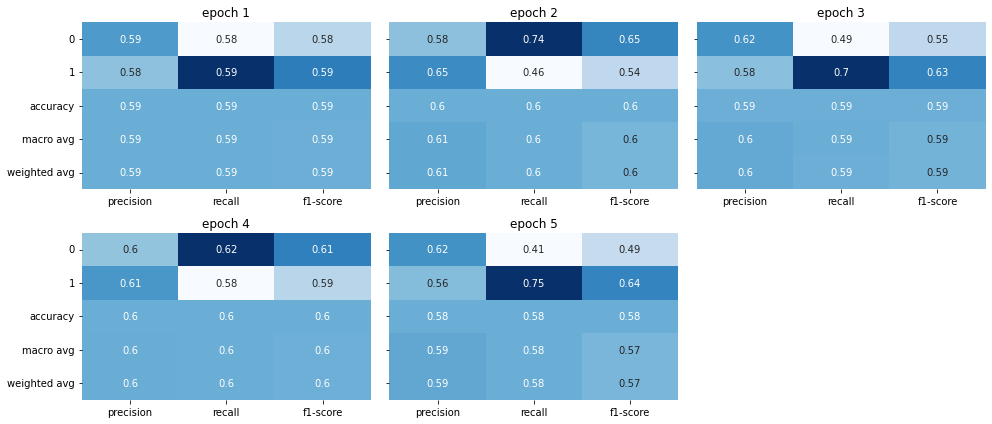

In [174]:
plot_all_classification_report(lista_clf_report_bf_5, '5', diz_cmap['5'], 'BERT fine-tuned', 'ridotto')

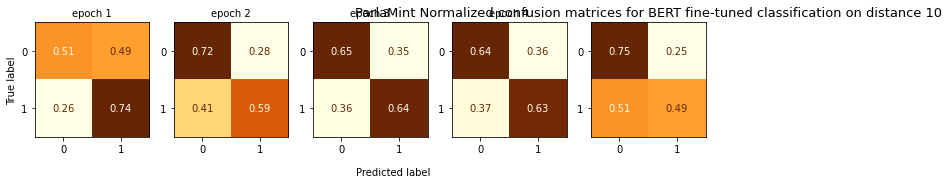

In [175]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_10, 'BERT fine-tuned', '10', diz_cmap['10'])    

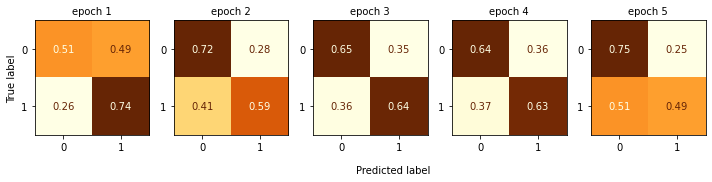

In [176]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_10, 'BERT fine-tuned', '10', diz_cmap['10'], 'ridotto')    

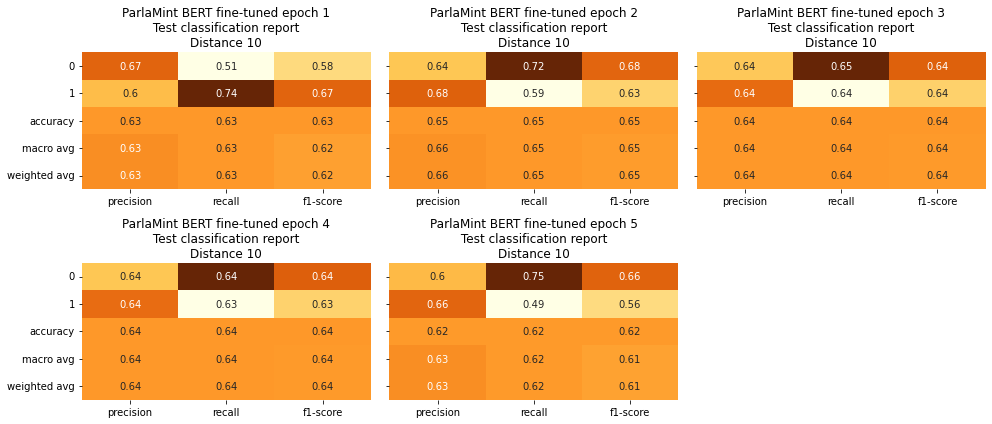

In [177]:
plot_all_classification_report(lista_clf_report_bf_10, '10', diz_cmap['10'], 'BERT fine-tuned')

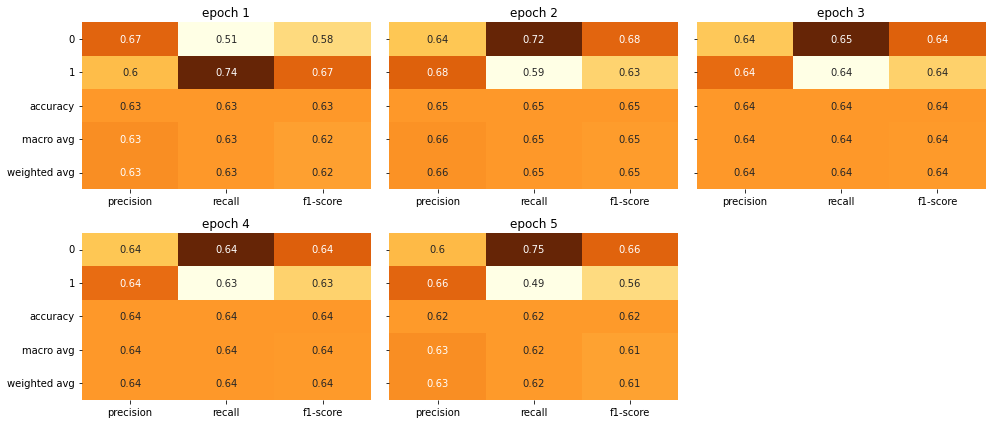

In [178]:
plot_all_classification_report(lista_clf_report_bf_10, '10', diz_cmap['10'], 'BERT fine-tuned', 'ridotto')

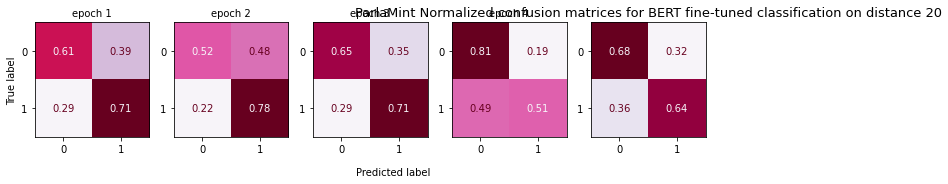

In [179]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_20, 'BERT fine-tuned', '20', diz_cmap['20'])    

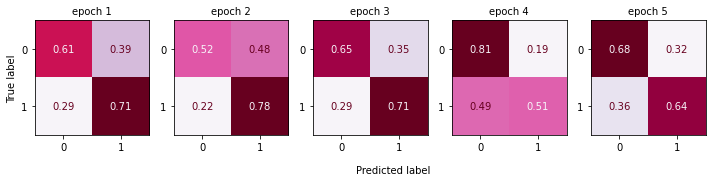

In [180]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_20, 'BERT fine-tuned', '20', diz_cmap['20'], 'ridotto')  

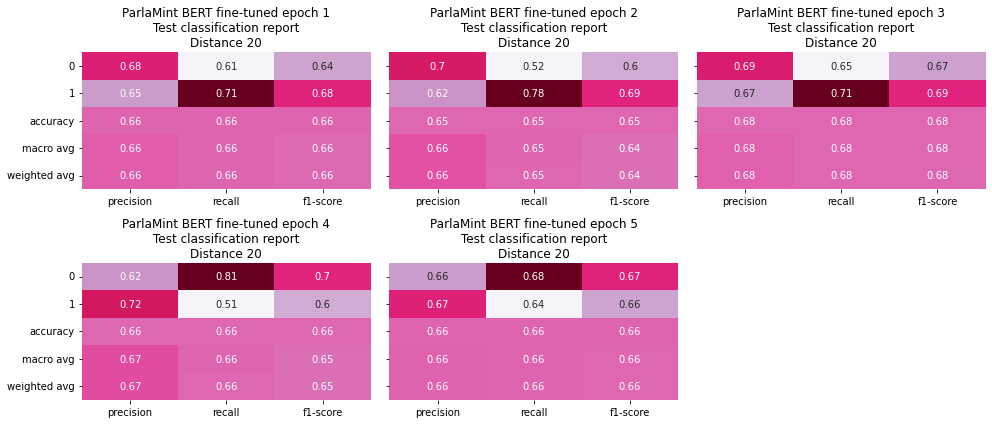

In [181]:
plot_all_classification_report(lista_clf_report_bf_20, '20', diz_cmap['20'], 'BERT fine-tuned')

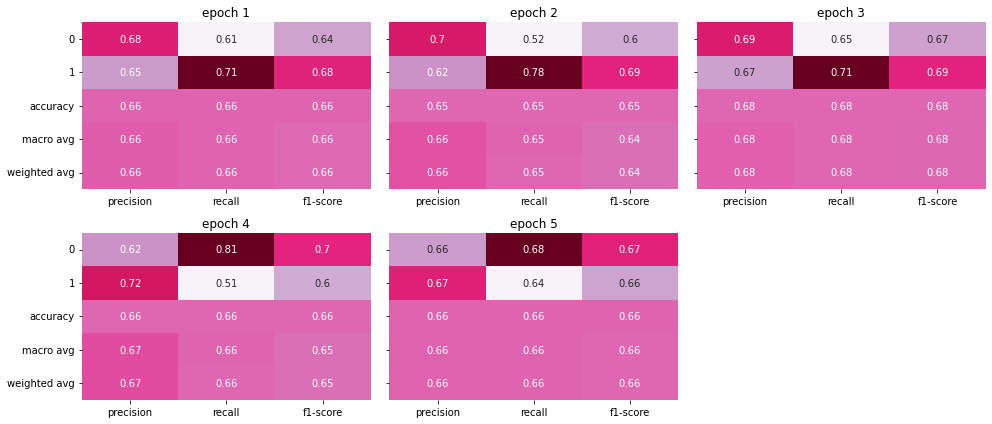

In [182]:
plot_all_classification_report(lista_clf_report_bf_20, '20', diz_cmap['20'], 'BERT fine-tuned', 'ridotto')

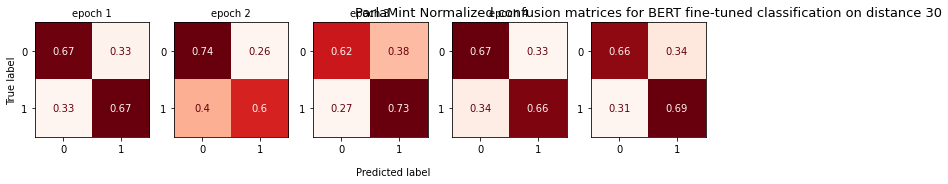

In [183]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_30, 'BERT fine-tuned', '30', diz_cmap['30'])    

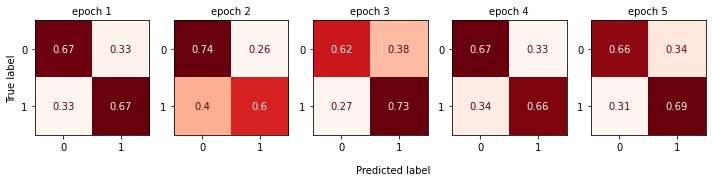

In [184]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_30, 'BERT fine-tuned', '30', diz_cmap['30'], 'ridotto') 

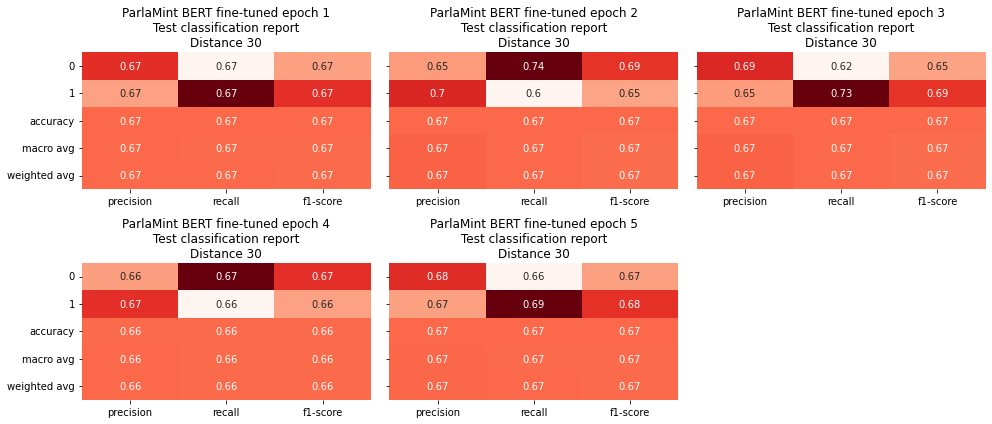

In [185]:
plot_all_classification_report(lista_clf_report_bf_30, '30', diz_cmap['30'], 'BERT fine-tuned')

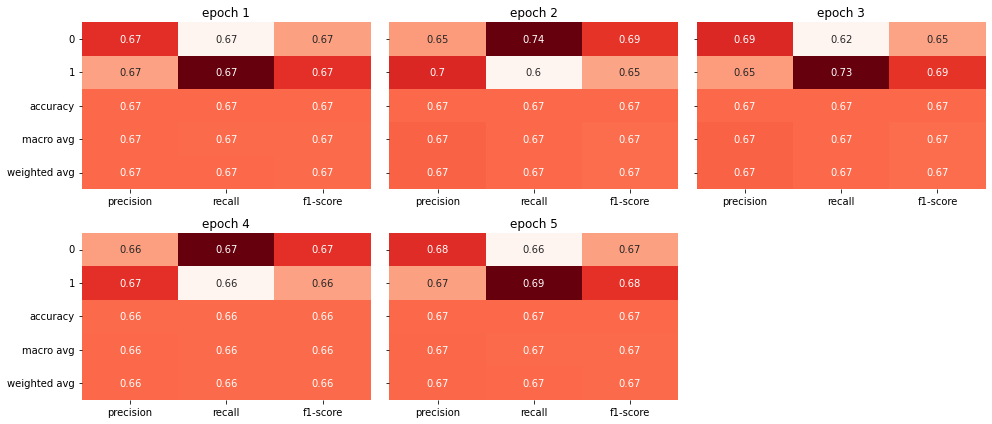

In [186]:
plot_all_classification_report(lista_clf_report_bf_30, '30', diz_cmap['30'], 'BERT fine-tuned', 'ridotto')

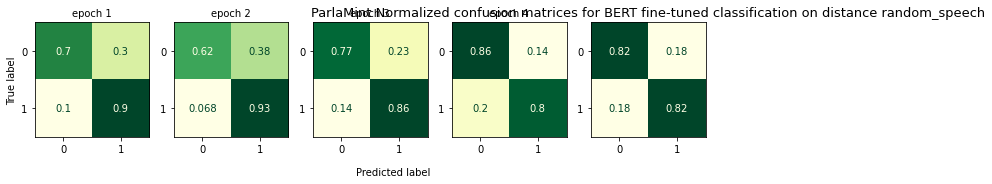

In [187]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_random_speech, 'BERT fine-tuned', \
                                       'random_speech', diz_cmap['random_speech'])

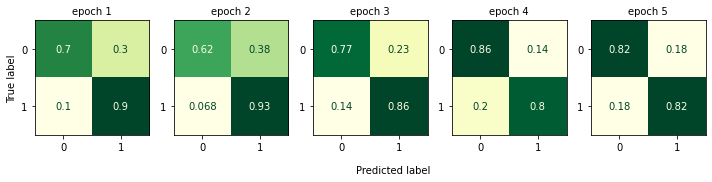

In [188]:
plot_all_normalized_confusion_matrices(lista_cm_normalizzate_bf_random_speech, 'BERT fine-tuned', \
                                       'random_speech', diz_cmap['random_speech'], 'ridotto')

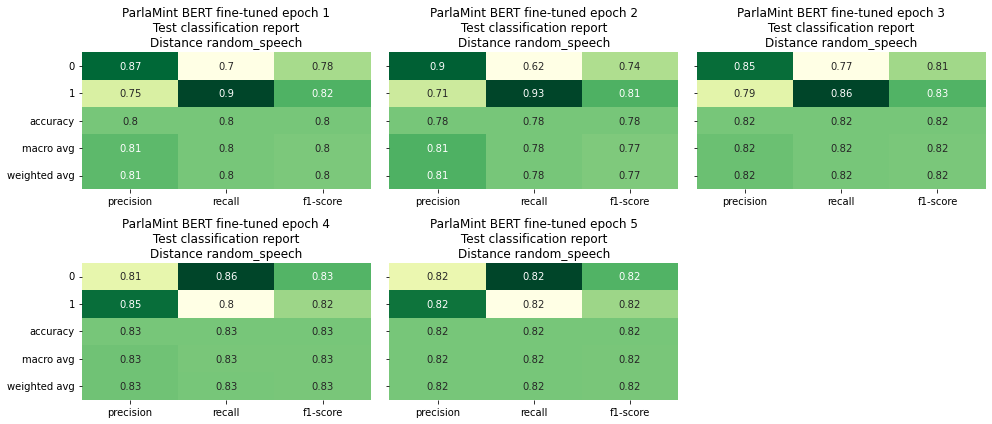

In [189]:
plot_all_classification_report(lista_clf_report_bf_random_speech, 'random_speech', diz_cmap['random_speech'], \
                               'BERT fine-tuned')

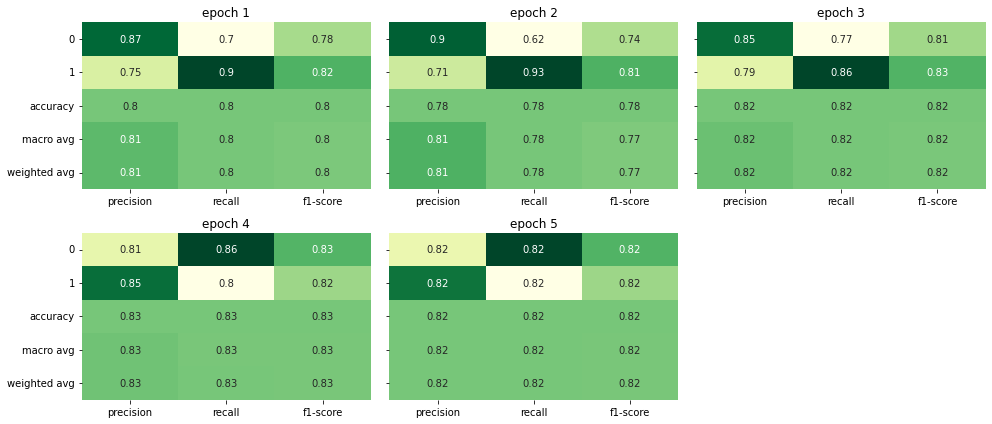

In [190]:
plot_all_classification_report(lista_clf_report_bf_random_speech, 'random_speech', diz_cmap['random_speech'], \
                               'BERT fine-tuned', 'ridotto')

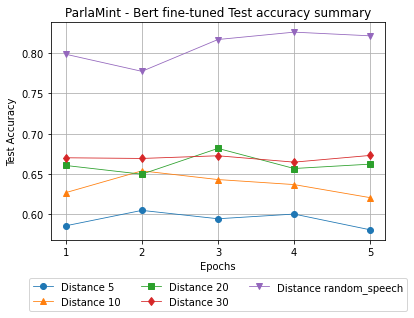

In [191]:
plot_loss_and_accuracy_of_all_distances([diz_dist_5_bf['df_dist_5'], diz_dist_10_bf['df_dist_10'], \
                                        diz_dist_20_bf['df_dist_20'], diz_dist_30_bf['df_dist_30'], \
                                        diz_random_speech_bf['df_random_speech']])

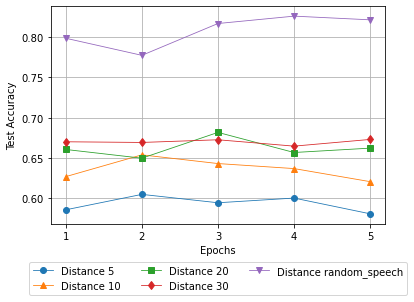

In [192]:
plot_loss_and_accuracy_of_all_distances([diz_dist_5_bf['df_dist_5'], diz_dist_10_bf['df_dist_10'], \
                                        diz_dist_20_bf['df_dist_20'], diz_dist_30_bf['df_dist_30'], \
                                        diz_random_speech_bf['df_random_speech']], 'ridotto')

# Correlazione fra probabilità delle predizioni nei vari scenari di classificazione e le distanze coseniche

### Dataset con distanze coseniche

In [131]:
path_risorse = "../dataset/cosine_distances/"

In [132]:
df_dist_5_cosine_distance = pd.read_csv("{}df_dist_5_cosine_distance.csv".format(path_risorse), sep="\t")
df_dist_10_cosine_distance = pd.read_csv("{}df_dist_10_cosine_distance.csv".format(path_risorse), sep="\t")
df_dist_20_cosine_distance = pd.read_csv("{}df_dist_20_cosine_distance.csv".format(path_risorse), sep="\t")
df_dist_30_cosine_distance = pd.read_csv("{}df_dist_30_cosine_distance.csv".format(path_risorse), sep="\t")
df_random_speech_cosine_distance = pd.read_csv("{}df_random_speech_cosine_distance.csv".format(path_risorse), sep="\t")

In [144]:
df_dist_5_cosine_distance

,Id,Sentence_1,Sentence_2,Class,Cosine_distance_layer_1,Cosine_distance_layer_2,Cosine_distance_layer_3,Cosine_distance_layer_4,Cosine_distance_layer_5,Cosine_distance_layer_6,Cosine_distance_layer_7,Cosine_distance_layer_8,Cosine_distance_layer_9,Cosine_distance_layer_10,Cosine_distance_layer_11,Cosine_distance_layer_12
0,3511,È questo «in nome del popolo italiano»?,"Signor Presidente, ho chiesto di intervenire a...",1,0.0389,0.0744,0.0671,0.0486,0.0503,0.0466,0.0550,0.1028,0.1344,0.2293,0.4122,0.3089
1,443194,Non guardiamo a soluzioni come l'erezione di m...,Tutto ciò deve necessariamente avvenire attrav...,1,0.0124,0.0260,0.0184,0.0151,0.0161,0.0159,0.0244,0.0252,0.0181,0.0187,0.0295,0.0327
2,438394,La popolazione carceraria è scesa a 52.164 e s...,Sei anni fa i detenuti erano 67.971 e 21.494 l...,0,0.0130,0.0277,0.0341,0.0217,0.0200,0.0163,0.0177,0.0198,0.0198,0.0247,0.0307,0.0836
3,313751,"Mi fermo perché non voglio offendere nessuno, ...",Ci ridono dietro!,1,0.0559,0.0784,0.0858,0.0645,0.0745,0.0717,0.1765,0.2912,0.3930,0.6366,0.9081,0.6541
4,488165,La prima riunione europea dei Ministri della s...,"Siamo un grande Paese, che ha svolto un lavoro...",1,0.0201,0.0299,0.0267,0.0151,0.0153,0.0137,0.0146,0.0150,0.0106,0.0139,0.0261,0.0575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2395,35231,Non è un caso che il Governo e la maggioranza ...,Ma neanche il testo di mediazione che la Commi...,0,0.0427,0.0588,0.0769,0.0474,0.0479,0.0595,0.0697,0.1056,0.1404,0.1767,0.2470,0.2281
2396,300044,"Anzi, svolse sempre con passione e consapevole...",Con lui scompare una figura importante della s...,0,0.0188,0.0342,0.0239,0.0180,0.0247,0.0227,0.0293,0.0234,0.0179,0.0180,0.0357,0.0530
2397,74207,È chiaro che una catastrofe delle dimensioni d...,"Cito, prima di invitare l'Assemblea all'approv...",1,0.0250,0.0534,0.0756,0.0465,0.0647,0.0588,0.0522,0.0778,0.1135,0.1868,0.3574,0.3438
2398,390608,"Se doveva cadere così in basso, era più dignit...","Un'Assemblea tanto grande quanto debole, i cui...",1,0.0349,0.0850,0.0874,0.0495,0.0510,0.0459,0.0468,0.0750,0.1241,0.2103,0.3841,0.3227


# Verifica della distribuzione delle distanze coseniche

**Per capire quale metodo di correlazione applicare fra probabilità e distanze coseniche, verifichiamo se le distanze coseniche sono normalmente distribuite oppure no**

-------------------------------------------------------------------------------------------------------------------
#### Pearson’s Correlation

The Pearson correlation coefficient (named for Karl Pearson) can be used to summarize the strength of the linear relationship between two data samples.

The Pearson’s correlation coefficient is calculated as the covariance of the two variables divided by the product of the standard deviation of each data sample. It is the normalization of the covariance between the two variables to give an interpretable score.

**The use of mean and standard deviation in the calculation suggests the need for the two data samples to have a Gaussian or Gaussian-like distribution.**

The result of the calculation, the correlation coefficient can be interpreted to understand the relationship.

The coefficient returns a value between -1 and 1 that represents the limits of correlation from a full negative correlation to a full positive correlation. A value of 0 means no correlation. The value must be interpreted, where often a value below -0.5 or above 0.5 indicates a notable correlation, and values below those values suggests a less notable correlation.



#### Spearman’s Correlation

Two variables may be related by a nonlinear relationship, such that the relationship is stronger or weaker across the distribution of the variables.

Further, the two variables being considered may have a non-Gaussian distribution.

In this case, the Spearman’s correlation coefficient (named for Charles Spearman) can be used to summarize the strength between the two data samples. This test of relationship can also be used if there is a linear relationship between the variables, but will have slightly less power (e.g. may result in lower coefficient scores).

As with the Pearson correlation coefficient, the scores are between -1 and 1 for perfectly negatively correlated variables and perfectly positively correlated respectively.

Instead of calculating the coefficient using covariance and standard deviations on the samples themselves, these statistics are calculated from the relative rank of values on each sample. **This is a common approach used in non-parametric statistics, e.g. statistical methods where we do not assume a distribution of the data such as Gaussian.**


Fonte: https://machinelearningmastery.com/how-to-use-correlation-to-understand-the-relationship-between-variables/

-------------------------------------------------------------------------------------------------------------------

Controlliamo dunque se la distribuzione delle distanze coseniche è simile a una gaussiana con i metodi **_shapiro_**, **_normaltest_** e **_kstes_t**

In [145]:
def controlla_distribuzione_distanze_coseniche(df):
    
    #Metodo shapiro
    for column_name in df.columns:
        if "Cosine_distance" in column_name:
            data = df[column_name]
            test_stat, pvalue = shapiro(data)
            if pvalue >= 0.05:
                print('The column {} is taken from a normally distributed population ({} method)'.format(column_name, "shapiro"))
                
    #Metodo normaltest
    for column_name in df.columns:
        if "Cosine_distance" in column_name:
            data = df[column_name]
            test_stat, pvalue = normaltest(data)
            if pvalue >= 0.05:
                print('The column {} is taken from a normally distributed population ({} method)'.format(column_name, "normaltest"))
            
    #Metodo kstest
    for column_name in df.columns:
        if "Cosine_distance" in column_name:
            data = df[column_name]
            test_stat, pvalue = kstest(data, 'norm')
            if pvalue >= 0.05:
                print('The column {} is taken from a normally distributed population ({} method)'.format(column_name, "kstest"))

In [146]:
controlla_distribuzione_distanze_coseniche(df_dist_5_cosine_distance)

In [147]:
controlla_distribuzione_distanze_coseniche(df_dist_10_cosine_distance)

In [148]:
controlla_distribuzione_distanze_coseniche(df_dist_20_cosine_distance)

In [149]:
controlla_distribuzione_distanze_coseniche(df_dist_30_cosine_distance)

In [150]:
controlla_distribuzione_distanze_coseniche(df_random_speech_cosine_distance)

**In nessuno dei dataset troviamo distanze coseniche normalmente distribuite, dunque useremo la Spearman’s Correlation**

**scipy.stats.spearmanr** (https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.spearmanr.html#scipy-stats-spearmanr)

Calculate a Spearman correlation coefficient with associated p-value.

The Spearman rank-order correlation coefficient is a nonparametric measure of the monotonicity of the relationship between two datasets. Unlike the Pearson correlation, the Spearman correlation does not assume that both datasets are normally distributed. Like other correlation coefficients, this one varies between -1 and +1 with 0 implying no correlation. Correlations of -1 or +1 imply an exact monotonic relationship. Positive correlations imply that as x increases, so does y. Negative correlations imply that as x increases, y decreases.

In [133]:
from scipy.stats import spearmanr

**Per ogni previsione delle coppie, correlare gli score di probabilità dei classificatori con le distanze dei coseni**, per vedere se correlano con la coerenza supervised o no.

## Correlazione BERT unsupervised (coseni) - SVM

**Controlliamo che gli id degli eventi di test di ogni classificatore svm corrispondano agli id di test dei dataset delle distanze coseniche**

In [152]:
def verifica_uguaglianza_ids_clf_df(clf_ids_proba, df):
    list_ids_clf = list(clf_ids_proba)
    list_ids_df_cos_dist = list(df.Id)

    for id_1, id_2 in zip(list_ids_clf, list_ids_df_cos_dist):
        if id_1 != id_2:
            print(id_1, id_2, "Diverso!")

In [153]:
def controlla_ids_clf(diz, df):
    
    for clf in diz:
        verifica_uguaglianza_ids_clf_df(diz[clf]['ids_proba'].keys(), df)   

In [154]:
controlla_ids_clf(diz_dist_5_svm['df_dist_5'], df_dist_5_cosine_distance)

In [155]:
controlla_ids_clf(diz_dist_10_svm['df_dist_10'], df_dist_10_cosine_distance)

In [156]:
controlla_ids_clf(diz_dist_20_svm['df_dist_20'], df_dist_20_cosine_distance)

In [157]:
controlla_ids_clf(diz_dist_30_svm['df_dist_30'], df_dist_30_cosine_distance)

In [158]:
controlla_ids_clf(diz_random_speech_svm['df_random_speech'], df_random_speech_cosine_distance)

In [159]:
diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']

{3511: array([0.47305588, 0.52694412]),
 443194: array([0.50308874, 0.49691126]),
 438394: array([0.50949337, 0.49050663]),
 313751: array([0.5140239, 0.4859761]),
 488165: array([0.50564823, 0.49435177]),
 830293: array([0.50241993, 0.49758007]),
 414266: array([0.50057173, 0.49942827]),
 853371: array([0.51337942, 0.48662058]),
 230726: array([0.48619425, 0.51380575]),
 272009: array([0.50649833, 0.49350167]),
 373250: array([0.5083712, 0.4916288]),
 267159: array([0.49107641, 0.50892359]),
 259644: array([0.50587007, 0.49412993]),
 24424: array([0.49178688, 0.50821312]),
 8579: array([0.48864748, 0.51135252]),
 652428: array([0.5075555, 0.4924445]),
 179057: array([0.48937867, 0.51062133]),
 605152: array([0.49274639, 0.50725361]),
 203669: array([0.49674158, 0.50325842]),
 539555: array([0.50346041, 0.49653959]),
 55691: array([0.50347716, 0.49652284]),
 205115: array([0.50452303, 0.49547697]),
 707421: array([0.49256625, 0.50743375]),
 869057: array([0.52763851, 0.47236149]),
 748

In [160]:
pd.DataFrame.from_dict(diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba'], \
                                       columns=["proba_{}".format(k) for k in [0, 1]], orient='index')

,proba_0,proba_1
3511,0.473056,0.526944
443194,0.503089,0.496911
438394,0.509493,0.490507
313751,0.514024,0.485976
488165,0.505648,0.494352
...,...,...
35231,0.498491,0.501509
300044,0.488605,0.511395
74207,0.502120,0.497880
390608,0.479133,0.520867


In [161]:
def get_probabilities_dataset(diz, df_cosine_distance):
    
    dataset_complessivo = pd.DataFrame()
    
    #calcolo, per ogni livello, la correlazione fra le distanze coseniche di quel livello e le probabilità prodotte 
    #dal classificatore svm corrispondente 
    #Es.: le probabilità prodotte dal classificatore che ha utilizzato le features del livello 1 di BERT saranno 
    #correlate con le distanze coseniche calcolate sui vettori del il primo livello del BERT unsupervised
    
    for i in range(1,13):
        
        columns=["proba_{}".format(k) for k in [0, 1]]
        
        #formo un dataset prendo le probabilità del classificatore di un certo livello 
        #Es.: diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']
        df_tmp = pd.DataFrame.from_dict(diz['clf_{}'.format(str(i))]['ids_proba'], \
                                       columns=columns, orient='index')
        
        ids = df_tmp.index
        
        #resetto l'indice
        df_tmp.reset_index(inplace=True, drop=True)

        #concateno il dataset delle probabilità con il dataset delle distanze coseniche dello stesso livello 
        df_proba_cosine_distances = pd.concat([df_tmp, df_cosine_distance[["Cosine_distance_layer_{}".format(i)]]], axis = 1)

        #dato che gli id degli eventi sono uguali inserisco la colonna degli id alla fine al dataset completo
        df_proba_cosine_distances.insert(0, 'Id', ids)
        
        #lista_dataset.append(df_proba_cosine_distances)
        
        #calcolo le correlazioni fra le probabilità del classificatore e le distanze coseniche dello stesso livello
        df_proba_cosine_distances_corr = df_proba_cosine_distances.corr(method='spearman')
        
        #display(df_proba_cosine_distances_corr)
        
        #elimino dal dataset della correlazione le autocorrelazioni
        columns.append('Id')
        df_proba_cosine_distances_corr.drop(columns, axis=1, inplace=True)
        df_proba_cosine_distances_corr.drop(["Id", "Cosine_distance_layer_{}".format(i)], axis=0, inplace=True)
        
        #display(df_proba_cosine_distances_corr)
        
        #aggiungo le correlazioni fra probabilità del classificatore e le distanze coseniche dello stesso livello
        #al dataset che contiene tutte le correlazioni fra probabilità dei classificatori e distanze coseniche 
        #del rispettivo livello
        dataset_complessivo = pd.concat([dataset_complessivo, df_proba_cosine_distances_corr.T])
                
        #plt.show()
        
    
    return dataset_complessivo

In [162]:
def plot_correlation_heatmap(df, dist, cmap, titolo_ridotto=''):
    
    fig,bx = plt.subplots(1)
    heatmap = bx.pcolor(df, edgecolors='k', cmap=cmap, vmin=-1, vmax=1)

    '''for y in range(df_proba_cosine_distances_dist_5.shape[0]):
        for x in range(df_proba_cosine_distances_dist_5.shape[1]):
            print(x, y)
            plt.text(x + 0.5, y + 0.5, '%.4f' % df_proba_cosine_distances_dist_5[y, x],
                     horizontalalignment='center',
                     verticalalignment='center',
                     )'''

    cbar = plt.colorbar(heatmap, pad=0.5)

    ax = bx.twinx()

    ax.set_yticks(np.arange(0.5, len(df.index), 1))
    ax.set_xticks(np.arange(0.5, len(df.columns), 1), )
    ax.set_xticklabels(df.columns, rotation=10)
    ax.set_yticklabels(df.index,fontsize=10)
    bx.set_yticks(np.arange(0.5, len(df.index), 1))
    bx.set_yticklabels(["Clf_{}".format(i) for i in range(1,13)],fontsize=10)
    ax.set_ylim([0,12])
    bx.set_ylim([0,12])
    ax.invert_yaxis()
    bx.invert_yaxis()
    
    for y in range(df.shape[0]):
            for x in range(df.shape[1]):
                plt.text(x+ 0.5, y+ 0.5, '%.4f' % df.iloc[y, x],
                    horizontalalignment='center',
                    verticalalignment='center',
                         color = 'white',
                         fontsize = 10
              )
    
    if not titolo_ridotto:
        title = "{} - Distance {} \nCosine distances - SVM's correlations ".format(risorsa, dist)
    else:
        title = "Distance {}".format(dist)
        
    plt.title(title, fontsize=12)
    
    if not titolo_ridotto:
        fig.savefig(path_images + title.replace("\n", '') + '.png', dpi=fig.dpi, bbox_inches='tight')
    else:
        title = "{} - Distance {} \nCosine distances - SVM's correlations ".format(risorsa, dist)
        fig.savefig(path_images_tit_ridotti + title.replace("\n", '') + '.png', dpi=fig.dpi, bbox_inches='tight')
    
    plt.show()

In [163]:
df_proba_cosine_distances_dist_5 = get_probabilities_dataset(diz_dist_5_svm['df_dist_5'], df_dist_5_cosine_distance)

In [164]:
df_proba_cosine_distances_dist_5

,proba_0,proba_1
Cosine_distance_layer_1,0.060850,-0.060850
Cosine_distance_layer_2,0.043072,-0.043072
Cosine_distance_layer_3,0.002384,-0.002384
Cosine_distance_layer_4,0.029393,-0.029393
Cosine_distance_layer_5,0.050724,-0.050724
Cosine_distance_layer_6,-0.065550,0.065550
Cosine_distance_layer_7,-0.050349,0.050349
Cosine_distance_layer_8,0.053515,-0.053515
Cosine_distance_layer_9,0.056732,-0.056732
Cosine_distance_layer_10,0.012585,-0.012585


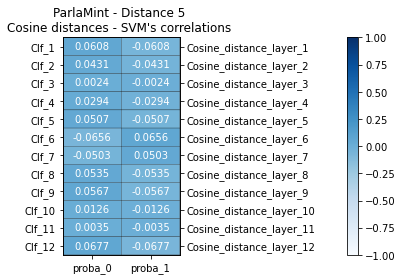

In [165]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_5, "5", diz_cmap['5'])

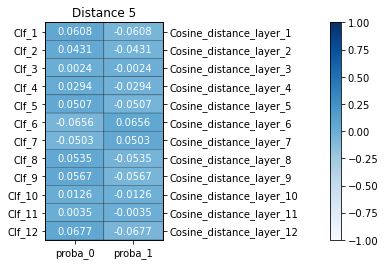

In [166]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_5, "5", diz_cmap['5'], 'ridotto')

In [167]:
#Esempio: prendo lista delle probabilità del clf_1 - distanza 5 per la classe 1 (non segue) e le distanze coseniche
#del livello 1
corr, _ = spearmanr([diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba'][i][1] \
                     for i in diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']], \
                    df_dist_5_cosine_distance['Cosine_distance_layer_1'])

print(corr)

-0.060849889410366835


In [168]:
df_proba_cosine_distances_dist_10 = get_probabilities_dataset(diz_dist_10_svm['df_dist_10'], df_dist_10_cosine_distance)

In [169]:
df_proba_cosine_distances_dist_10

,proba_0,proba_1
Cosine_distance_layer_1,-0.033567,0.033567
Cosine_distance_layer_2,-0.055527,0.055527
Cosine_distance_layer_3,-0.056017,0.056017
Cosine_distance_layer_4,-0.033311,0.033311
Cosine_distance_layer_5,-0.015891,0.015891
Cosine_distance_layer_6,-0.039247,0.039247
Cosine_distance_layer_7,-0.025840,0.025840
Cosine_distance_layer_8,-0.025420,0.025420
Cosine_distance_layer_9,-0.038561,0.038561
Cosine_distance_layer_10,-0.007132,0.007132


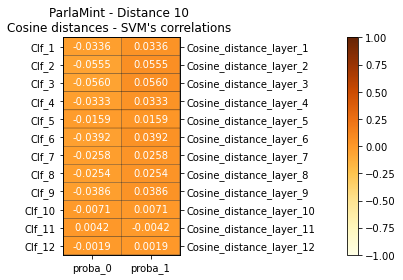

In [170]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_10, "10", diz_cmap['10'])

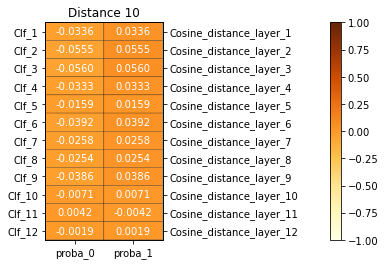

In [171]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_10, "10", diz_cmap['10'], 'ridotto')

In [172]:
df_proba_cosine_distances_dist_20 = get_probabilities_dataset(diz_dist_20_svm['df_dist_20'], df_dist_20_cosine_distance)

In [173]:
df_proba_cosine_distances_dist_20

,proba_0,proba_1
Cosine_distance_layer_1,-0.016908,0.016908
Cosine_distance_layer_2,0.028655,-0.028655
Cosine_distance_layer_3,-0.022091,0.022091
Cosine_distance_layer_4,-0.022912,0.022912
Cosine_distance_layer_5,-0.006836,0.006836
Cosine_distance_layer_6,-0.006795,0.006795
Cosine_distance_layer_7,0.034611,-0.034611
Cosine_distance_layer_8,0.017423,-0.017423
Cosine_distance_layer_9,-0.015796,0.015796
Cosine_distance_layer_10,-0.017537,0.017537


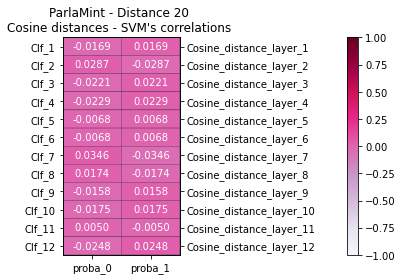

In [174]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_20, "20", diz_cmap['20'])

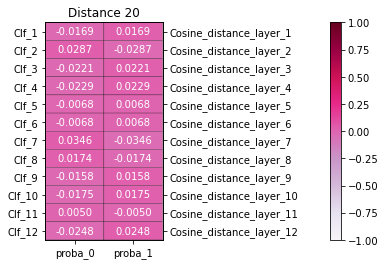

In [175]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_20, "20", diz_cmap['20'], 'ridotto')

In [176]:
df_proba_cosine_distances_dist_30 = get_probabilities_dataset(diz_dist_30_svm['df_dist_30'], df_dist_30_cosine_distance)

In [177]:
df_proba_cosine_distances_dist_30

,proba_0,proba_1
Cosine_distance_layer_1,-0.122614,0.122614
Cosine_distance_layer_2,-0.041779,0.041779
Cosine_distance_layer_3,-0.070705,0.070705
Cosine_distance_layer_4,-0.072199,0.072199
Cosine_distance_layer_5,-0.074118,0.074118
Cosine_distance_layer_6,-0.041217,0.041217
Cosine_distance_layer_7,-0.025169,0.025169
Cosine_distance_layer_8,-0.004223,0.004223
Cosine_distance_layer_9,-0.019750,0.019750
Cosine_distance_layer_10,-0.065417,0.065417


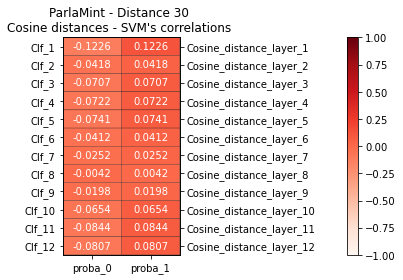

In [178]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_30, "30", diz_cmap['30'])

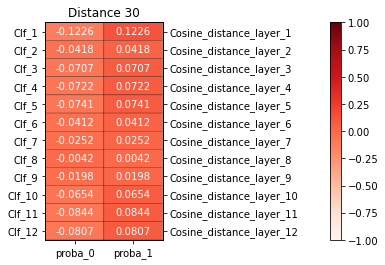

In [179]:
plot_correlation_heatmap(df_proba_cosine_distances_dist_30, "30", diz_cmap['30'], 'ridotto')

In [180]:
#Esempio: prendo lista delle probabilità del clf_1 - distanza 5 per la classe 1 (non segue) e le distanze coseniche
#del livello 1
corr, _ = spearmanr([diz_dist_30_svm['df_dist_30']['clf_11']['ids_proba'][i][0] \
                     for i in diz_dist_30_svm['df_dist_30']['clf_11']['ids_proba']], \
                    df_dist_30_cosine_distance['Cosine_distance_layer_11'])

print(corr)

-0.08441121297146192


In [181]:
df_proba_cosine_distances_random_speech = get_probabilities_dataset(diz_random_speech_svm['df_random_speech'], \
                                                        df_random_speech_cosine_distance)

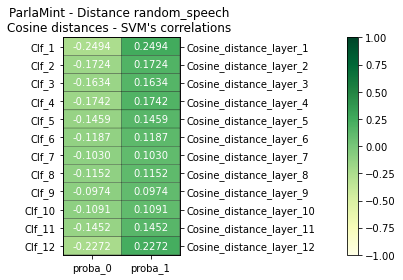

In [182]:
plot_correlation_heatmap(df_proba_cosine_distances_random_speech, "random_speech", diz_cmap['random_speech'])

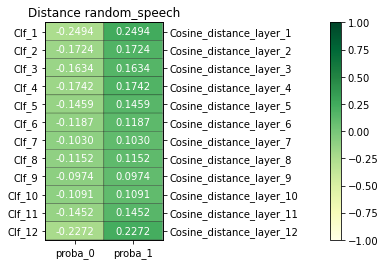

In [183]:
plot_correlation_heatmap(df_proba_cosine_distances_random_speech, "random_speech", diz_cmap['random_speech'], 'ridotto')

In [184]:
corr, _ = spearmanr([diz_random_speech_svm['df_random_speech']['clf_1']['ids_proba'][i][1] \
                     for i in diz_random_speech_svm['df_random_speech']['clf_1']['ids_proba']], \
                    df_random_speech_cosine_distance['Cosine_distance_layer_1'])

print(corr)

0.2494038413466064


In [185]:
diz_random_speech_svm['df_random_speech']['clf_1']['ids_proba']

{104187: array([0.61367691, 0.38632309]),
 816288: array([0.27394991, 0.72605009]),
 794533: array([0.52219854, 0.47780146]),
 90004: array([0.54694919, 0.45305081]),
 193562: array([0.44143427, 0.55856573]),
 604765: array([0.52996834, 0.47003166]),
 250068: array([0.70132032, 0.29867968]),
 406032: array([0.49605782, 0.50394218]),
 374566: array([0.58881964, 0.41118036]),
 785739: array([0.42425594, 0.57574406]),
 339795: array([0.48711974, 0.51288026]),
 620649: array([0.5169003, 0.4830997]),
 431853: array([0.32611744, 0.67388256]),
 828386: array([0.53989691, 0.46010309]),
 256916: array([0.57353048, 0.42646952]),
 873714: array([0.47424879, 0.52575121]),
 543013: array([0.46083185, 0.53916815]),
 767332: array([0.45433464, 0.54566536]),
 498307: array([0.3686755, 0.6313245]),
 382671: array([0.59689931, 0.40310069]),
 83510: array([0.38057685, 0.61942315]),
 504292: array([0.46111617, 0.53888383]),
 173018: array([0.52649759, 0.47350241]),
 641769: array([0.52341215, 0.47658785])

In [186]:
df_random_speech_cosine_distance

,Id,Sentence_1,Sentence_2,Class,Cosine_distance_layer_1,Cosine_distance_layer_2,Cosine_distance_layer_3,Cosine_distance_layer_4,Cosine_distance_layer_5,Cosine_distance_layer_6,Cosine_distance_layer_7,Cosine_distance_layer_8,Cosine_distance_layer_9,Cosine_distance_layer_10,Cosine_distance_layer_11,Cosine_distance_layer_12
0,104187,Penso - ad esempio - al numero molto alto di d...,Se quindi si accedesse per concorso - e lo dic...,0,0.0168,0.0278,0.0313,0.0225,0.0193,0.0191,0.0234,0.0486,0.0665,0.0724,0.1069,0.1318
1,816288,Attesa la dichiarazione del relatore e la sua ...,"Signor Presidente, avendolo sottoscritto per t...",0,0.0224,0.0358,0.0407,0.0246,0.0257,0.0217,0.0203,0.0391,0.0670,0.0964,0.3048,0.4397
2,794533,"Signor Presidente, ci troviamo in quest'Aula a...","Siamo di fronte, infatti, ad un Parlamento del...",0,0.0187,0.0430,0.0332,0.0272,0.0289,0.0315,0.0384,0.0489,0.0417,0.0552,0.0769,0.1041
3,90004,"Signor Presidente, recependo le indicazioni de...","In effetti, in 7ᵃ Commissione sono attualmente...",0,0.0193,0.0473,0.0455,0.0377,0.0540,0.0483,0.0456,0.0742,0.1097,0.1343,0.2276,0.2224
4,193562,Mi creda: non c'è nessun bisogno di alzare la ...,Ho interloquito con lei nella maniera che ho r...,0,0.0263,0.0345,0.0571,0.0368,0.0346,0.0358,0.0324,0.0491,0.0807,0.1624,0.4476,0.5265
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2395,449610,Minaccioso ovviamente nei confronti di Gentilo...,"L'immane massacro di milioni di ebrei, ma anch...",1,0.0318,0.0660,0.0722,0.0543,0.0753,0.0766,0.0857,0.1222,0.1861,0.2862,0.4000,0.3071
2396,770109,"Chiedo, perlomeno, di riconoscere le qualità c...",L'elenco dei senatori in congedo e assenti per...,1,0.0235,0.0460,0.0401,0.0368,0.0368,0.0410,0.0384,0.0396,0.0388,0.0456,0.0676,0.3819
2397,193789,Per quanto di competenza dell'amministrazione ...,Allo stesso giornalista non risultano inoltre ...,0,0.0153,0.0316,0.0301,0.0196,0.0203,0.0244,0.0309,0.0647,0.1262,0.2295,0.3974,0.3023
2398,331022,Avverto che nel corso della seduta odierna pot...,Pertanto decorre da questo momento il termine ...,0,0.0197,0.0384,0.0575,0.0397,0.0436,0.0561,0.0496,0.1009,0.1898,0.3034,0.3409,0.4896


## Correlazione BERT unsupervised (coseni) -  Bert finetunato

In [134]:
def get_probabilities_dataset_for_comparison_with_finetuning(diz, df_cosine_distance):
    
    df_proba = pd.DataFrame()
    
    for i in range(0,5):
        df_tmp = pd.DataFrame.from_dict(diz['Epoch{}'.format(str(i))]['ids_proba'], \
                                       columns=["Epoch{}_proba_{}".format(str(i+1), k) for k in [0, 1]], orient='index')
        
        df_proba = pd.concat([df_proba, df_tmp], axis = 1)
        
    ids = df_proba.index

    df_proba.reset_index(inplace=True, drop=True)

    df_proba_cosine_distances = pd.concat([df_proba, df_cosine_distance[[col for col in df_cosine_distance if "Cosine_distance" in col]]], axis = 1)

    df_proba_cosine_distances.insert(0, 'Id', ids)
    
    return df_proba_cosine_distances

In [135]:
def get_correlation_matrix(df, dist, cmap, titolo_ridotto=''):
    
    df_corr_orig = df.corr(method='spearman')
    
    df_corr = df_corr_orig.copy()
    
    cols = [col for col in df_corr.columns if 'Epoch' in col]
    cols.append('Id')

    df_corr.drop(cols, axis=1, inplace=True)
    
    rows = [col for col in df_corr.columns if 'Cosine' in col]
    rows.append('Id')

    df_corr.drop(rows, axis = 0, inplace=True)
    
    fig, ax = plt.subplots(figsize=(12,7))
    sns.heatmap(df_corr, cmap=cmap, annot = True, fmt = '.2f', vmin=-1, vmax=1)
    
    if not titolo_ridotto:
        title = "{} Cosine distances - Bert fine-tuned's correlations \nDistance {}".format(risorsa, dist)
    else:
        title = "Distance {}".format(dist)
        
    plt.title(title)
    
    if not titolo_ridotto:
        fig.savefig(path_images + title.replace("\n", '') + '.png', dpi=fig.dpi, bbox_inches='tight')
    else:
        title = "{} Cosine distances - Bert fine-tuned's correlations \nDistance {}".format(risorsa, dist)
        fig.savefig(path_images_tit_ridotti + title.replace("\n", '') + '.png', dpi=fig.dpi, bbox_inches='tight')
    
    plt.show()
    
    return df_corr_orig

In [189]:
#Esempio: prendo lista delle probabilità dell' Epoca 4 - distanza 5 per la classe 1 (non segue) e le distanze coseniche
#del livello 2
corr, _ = spearmanr([diz_dist_5_bf['df_dist_5']['Epoch4']['ids_proba'][i][1] \
                     for i in diz_dist_5_bf['df_dist_5']['Epoch4']['ids_proba']], \
                    df_dist_5_cosine_distance['Cosine_distance_layer_3'])

print("%.2f" %corr)

-0.02


In [136]:
df_bert_finetuning_proba_cosine_distances_dist_5 = \
    get_probabilities_dataset_for_comparison_with_finetuning(diz_dist_5_bf['df_dist_5'], df_dist_5_cosine_distance)

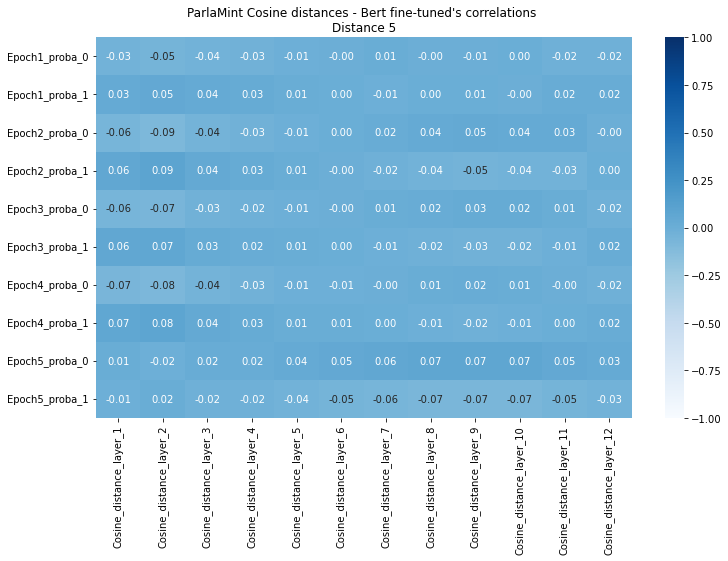

In [137]:
df_bert_finetuning_proba_cosine_distances_dist_5_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_5, '5', diz_cmap['5'])

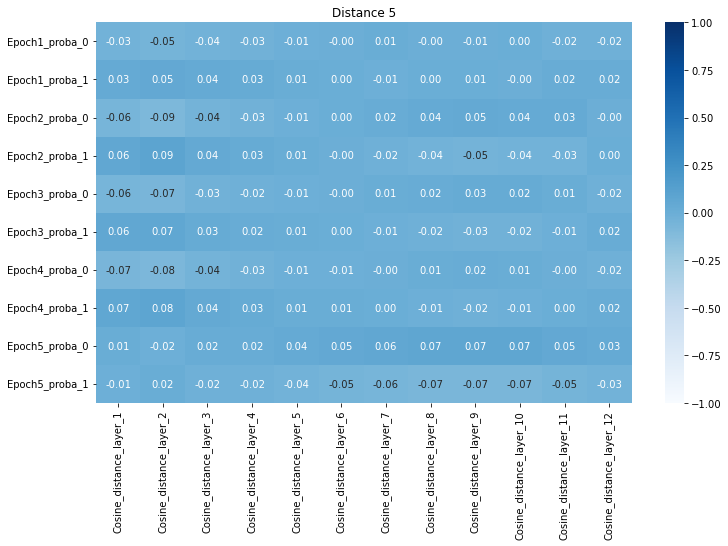

In [138]:
df_bert_finetuning_proba_cosine_distances_dist_5_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_5, '5', diz_cmap['5'], 'ridotto')

In [139]:
df_bert_finetuning_proba_cosine_distances_dist_10 = \
    get_probabilities_dataset_for_comparison_with_finetuning(diz_dist_10_bf['df_dist_10'], \
                                                             df_dist_10_cosine_distance)

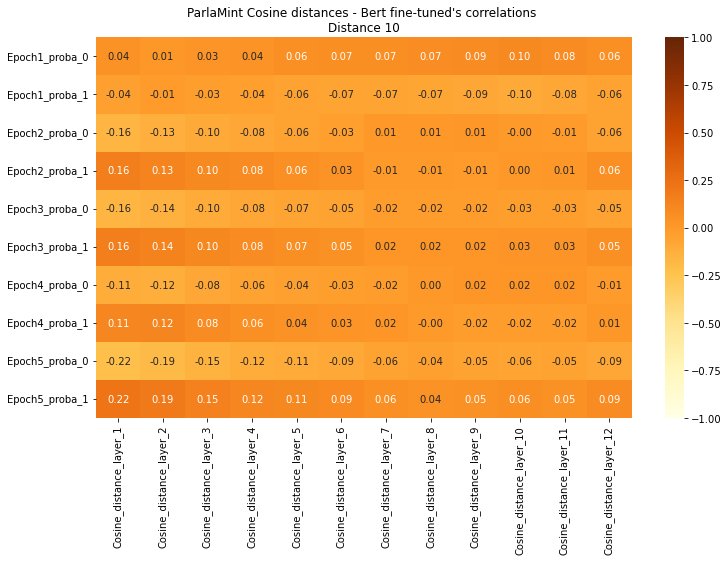

In [140]:
df_bert_finetuning_proba_cosine_distances_dist_10_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_10, '10', diz_cmap['10'])

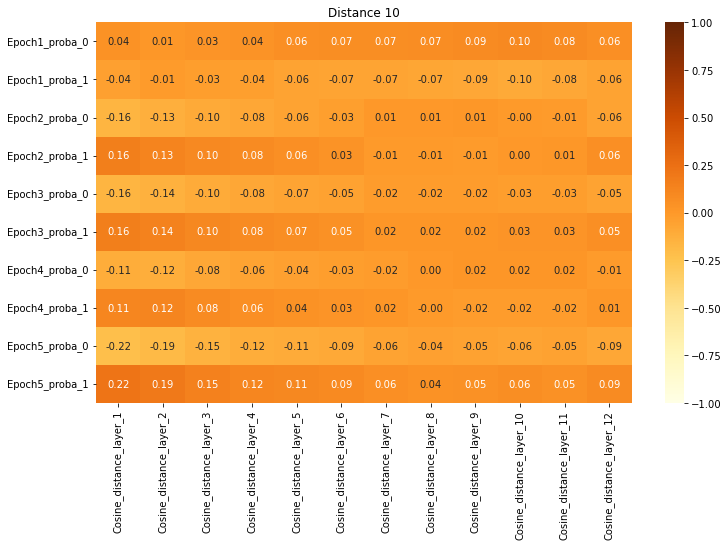

In [141]:
df_bert_finetuning_proba_cosine_distances_dist_10_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_10, '10', diz_cmap['10'], 'ridotto')

In [142]:
df_bert_finetuning_proba_cosine_distances_dist_20 = \
    get_probabilities_dataset_for_comparison_with_finetuning(diz_dist_20_bf['df_dist_20'], \
                                                             df_dist_20_cosine_distance)

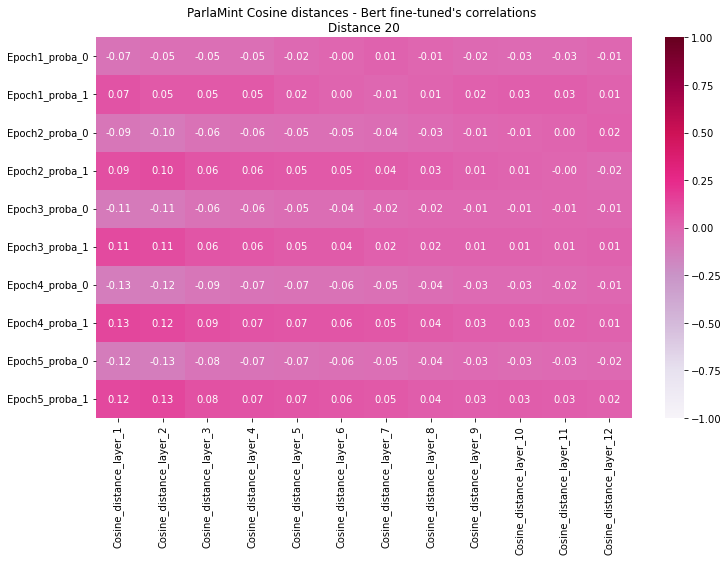

In [143]:
df_bert_finetuning_proba_cosine_distances_dist_20_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_20, '20', diz_cmap['20'])

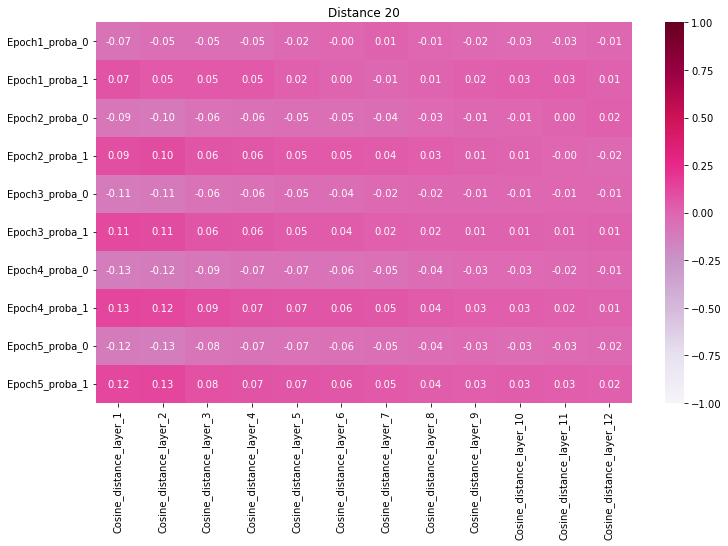

In [144]:
df_bert_finetuning_proba_cosine_distances_dist_20_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_20, '20', diz_cmap['20'], 'ridotto')

In [145]:
df_bert_finetuning_proba_cosine_distances_dist_30 = \
    get_probabilities_dataset_for_comparison_with_finetuning(diz_dist_30_bf['df_dist_30'], \
                                                             df_dist_30_cosine_distance)

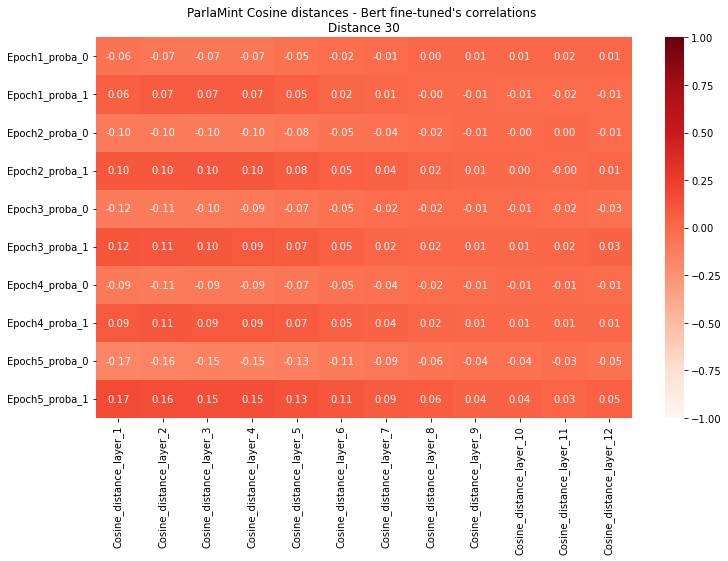

In [146]:
df_bert_finetuning_proba_cosine_distances_dist_30_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_30, '30', diz_cmap['30'])

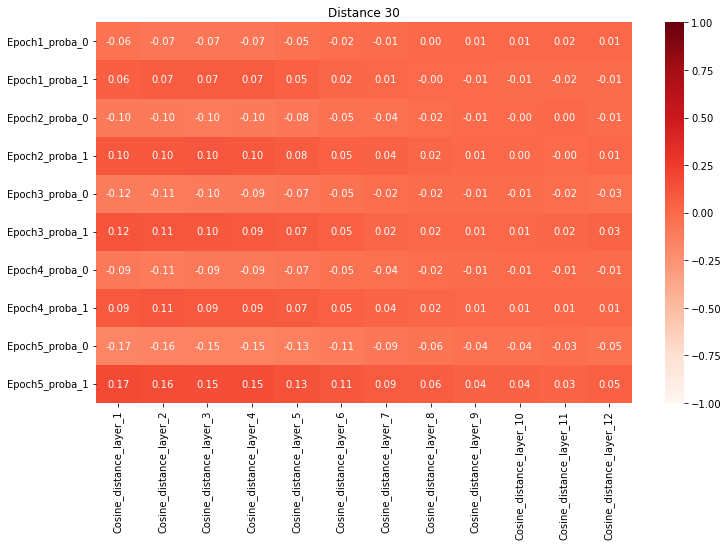

In [147]:
df_bert_finetuning_proba_cosine_distances_dist_30_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_dist_30, '30', diz_cmap['30'], 'ridotto')

In [148]:
df_bert_finetuning_proba_cosine_distances_random_speech = \
    get_probabilities_dataset_for_comparison_with_finetuning(diz_random_speech_bf['df_random_speech'], \
                                                             df_random_speech_cosine_distance)

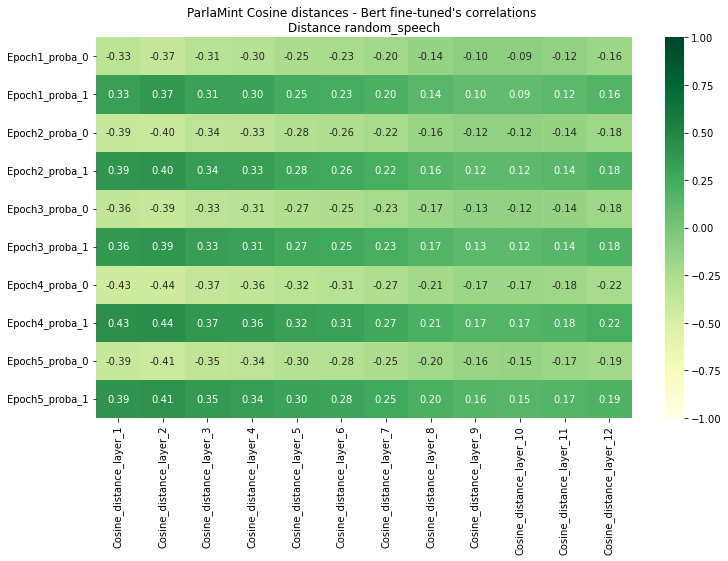

In [149]:
df_bert_finetuning_proba_cosine_distances_random_speech_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_random_speech, 'random_speech', \
                               diz_cmap['random_speech'])


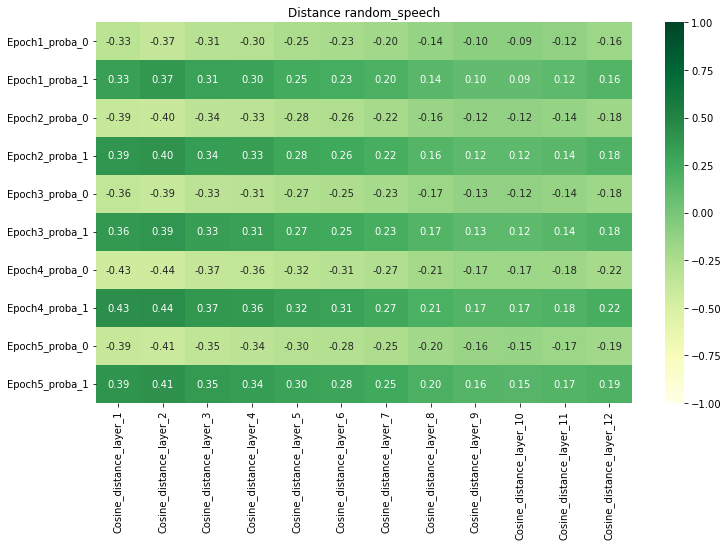

In [150]:
df_bert_finetuning_proba_cosine_distances_random_speech_corr_orig = \
        get_correlation_matrix(df_bert_finetuning_proba_cosine_distances_random_speech, 'random_speech', \
                               diz_cmap['random_speech'], 'ridotto')

# Correlazione SVM - Bert finetunato

In [151]:
def get_proba_df_svm_bert_finetunato(diz_svm, diz_bert_finetuned, num_epoch):
    
    dataset_complessivo = pd.DataFrame(dtype=float)
    
    #calcolo, per ogni livello, la correlazione fra le distanze coseniche di quel livello e le probabilità prodotte 
    #dal classificatore svm corrispondente 
    #Es.: le probabilità prodotte dal classificatore che ha utilizzato le features del livello 1 di BERT saranno 
    #correlate con le distanze coseniche calcolate sui vettori del il primo livello del BERT unsupervised

        
    for i in range(1,13):
        
        df_tmp = pd.DataFrame(index=['clf_{}'.format(i)], columns=["proba_{}".format(k) for k in [0, 1]], \
                             dtype=float)
                
        #formo un dataset prendo le probabilità del classificatore di un certo livello 
        #Es.: diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']
        
        clf = 'clf_{}'.format(str(i))
        epoch = 'Epoch{}'.format(str(num_epoch))
        
        proba_0_svm = [diz_svm[clf]['ids_proba'][i][0] for i in diz_svm[clf]['ids_proba']]
        
        proba_0_bert_finetuned = [diz_bert_finetuned[epoch]['ids_proba'][i][0] \
                     for i in diz_bert_finetuned[epoch]['ids_proba']]
        
        proba_1_svm = [diz_svm[clf]['ids_proba'][i][1] for i in diz_svm[clf]['ids_proba']]
        
        proba_1_bert_finetuned = [diz_bert_finetuned[epoch]['ids_proba'][i][1] \
                     for i in diz_bert_finetuned[epoch]['ids_proba']]
        
        corr_0, _ = spearmanr(proba_0_svm, proba_0_bert_finetuned)
        corr_1, _ = spearmanr(proba_1_svm, proba_1_bert_finetuned)
                
        df_tmp.loc[clf]['proba_0'] = corr_0
        df_tmp.loc[clf]['proba_1'] = corr_1
        
        dataset_complessivo = pd.concat([dataset_complessivo, df_tmp], axis = 0)
    
    return dataset_complessivo

In [156]:
def plot_correlation_heatmap_bert_svm(epoch_df_list, dist, cmap, titolo_ridotto=''):
    
    fig,ax = plt.subplots(1, 5, figsize=(20,6), constrained_layout=True)
    
    for i, df in enumerate(epoch_df_list):
        heatmap = ax[i].pcolor(df, edgecolors='k', cmap=cmap, vmin=-1, vmax=1)

        #cbar = plt.colorbar(heatmap, pad=0.3, ax=ax[i])

        bx = ax[i].twinx()

        ax[i].set_yticks(np.arange(0.5, len(df.index), 1))
        ax[i].set_xticks(np.arange(0.5, len(df.columns), 1), )
        ax[i].set_xticklabels(df.columns,fontsize=14)
        ax[i].set_yticklabels(df.index,fontsize=14)
        bx.set_yticks(np.arange(0.5, len(df.index), 1))
        if not titolo_ridotto:
            bx.set_yticklabels(["Epoch{}".format(i+1) for j in range(1,13)],fontsize=13)
        else:
            bx.set_yticklabels("")
        ax[i].set_ylim([0,12])
        bx.set_ylim([0,12])
        ax[i].invert_yaxis()
        bx.invert_yaxis()
        
        for y in range(df.shape[0]):
            for x in range(df.shape[1]):
                plt.text(x+ 0.5, y+ 0.5, '%.4f' % df.iloc[y, x],
                    horizontalalignment='center',
                    verticalalignment='center',
                         color = 'white',
                         fontsize = 15
              )
        if not titolo_ridotto:
            plt.title("{} \nBert finetuned - \nSVM's correlations \nDistance {} - Epoch {}".format(risorsa, str(dist), i+1), fontsize=14)
        else:
            plt.title("Epoch {}".format(i+1), fontsize=14)
    
    fig.colorbar(heatmap, pad=0.3)
    
    if not titolo_ridotto:
        fig.savefig(path_images + "{} Bert finetuned - SVM's correlations (distance {})".format(risorsa, str(dist)) + \
                    '.png', dpi=fig.dpi, bbox_inches='tight')
    else:
        fig.savefig(path_images_tit_ridotti + "{} Bert finetuned - SVM's correlations (distance {})".format(risorsa, str(dist)) + \
                '.png', dpi=fig.dpi, bbox_inches='tight')
    
    plt.show()

In [153]:
#Esempio
corr, _ = spearmanr([diz_dist_5_bf['df_dist_5']['Epoch0']['ids_proba'][i][0] \
                     for i in diz_dist_5_bf['df_dist_5']['Epoch0']['ids_proba']], \
                    
                    [diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba'][i][0] \
                     for i in diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']])

corr1, _ = spearmanr([diz_dist_5_bf['df_dist_5']['Epoch0']['ids_proba'][i][1] \
                     for i in diz_dist_5_bf['df_dist_5']['Epoch0']['ids_proba']], \
                    
                    [diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba'][i][1] \
                     for i in diz_dist_5_svm['df_dist_5']['clf_1']['ids_proba']])

print(corr, corr1)

0.10165829395541118 0.10165829395541118


In [157]:
list_df_bert_finetuning_proba_svm_dist_5 = [] 

for i in num_epoch:
    list_df_bert_finetuning_proba_svm_dist_5.append(get_proba_df_svm_bert_finetunato(diz_dist_5_svm['df_dist_5'], \
                                                                  diz_dist_5_bf['df_dist_5'], i))

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


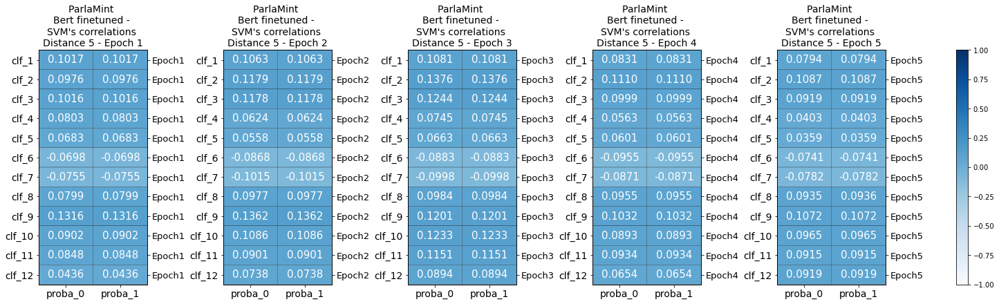

In [158]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_5, 5, diz_cmap['5'])

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


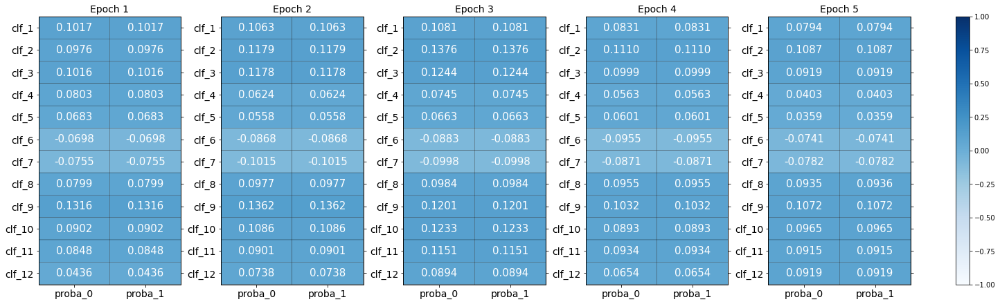

In [159]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_5, 5, diz_cmap['5'], 'ridotto')

In [160]:
list_df_bert_finetuning_proba_svm_dist_10 = [] 

for i in num_epoch:
    list_df_bert_finetuning_proba_svm_dist_10.append(get_proba_df_svm_bert_finetunato(diz_dist_10_svm['df_dist_10'],\
                                                                            diz_dist_10_bf['df_dist_10'], i))

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


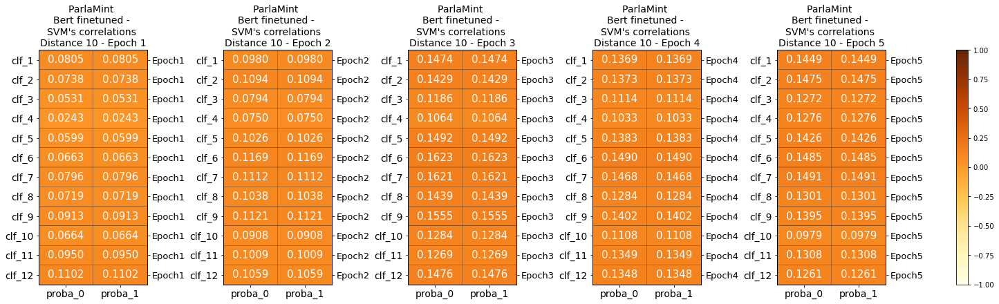

In [161]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_10, 10, diz_cmap['10'])

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


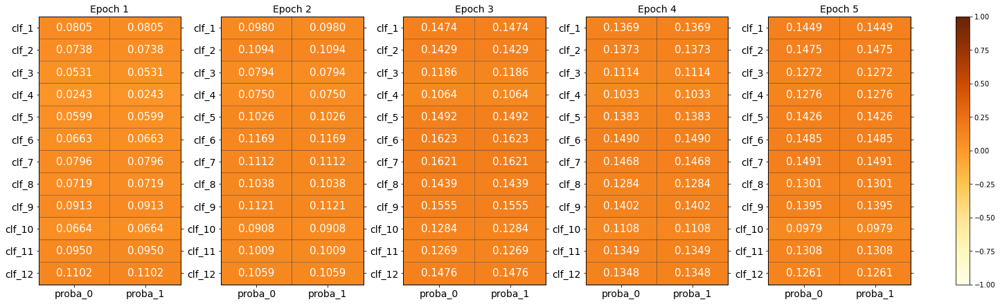

In [162]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_10, 10, diz_cmap['10'], 'ridotto')

In [163]:
list_df_bert_finetuning_proba_svm_dist_20 = []

for i in num_epoch:
    list_df_bert_finetuning_proba_svm_dist_20.append(get_proba_df_svm_bert_finetunato(diz_dist_20_svm['df_dist_20'],\
                                                                            diz_dist_20_bf['df_dist_20'], i))

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


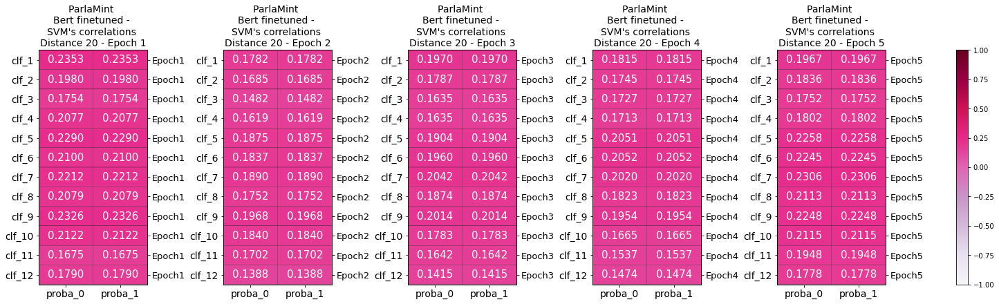

In [164]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_20, 20, diz_cmap['20'])

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


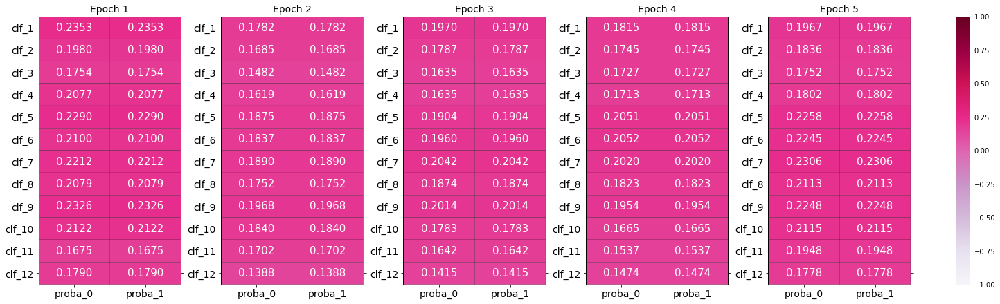

In [165]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_20, 20, diz_cmap['20'], 'ridotto')

In [166]:
#Esempio
corr, _ = spearmanr([diz_dist_20_bf['df_dist_20']['Epoch0']['ids_proba'][i][0] \
                     for i in diz_dist_20_bf['df_dist_20']['Epoch0']['ids_proba']], \
                    
                    [diz_dist_20_svm['df_dist_20']['clf_1']['ids_proba'][i][0] \
                     for i in diz_dist_20_svm['df_dist_20']['clf_1']['ids_proba']])

corr1, _ = spearmanr([diz_dist_20_bf['df_dist_20']['Epoch0']['ids_proba'][i][1] \
                     for i in diz_dist_20_bf['df_dist_20']['Epoch0']['ids_proba']], \
                    
                    [diz_dist_20_svm['df_dist_20']['clf_1']['ids_proba'][i][1] \
                     for i in diz_dist_20_svm['df_dist_20']['clf_1']['ids_proba']])

print(corr, corr1)

0.23530695935842097 0.23530697850671378


In [167]:
list_df_bert_finetuning_proba_svm_dist_30 = []

for i in num_epoch:    
    list_df_bert_finetuning_proba_svm_dist_30.append(get_proba_df_svm_bert_finetunato(diz_dist_30_svm['df_dist_30'],\
                                                                            diz_dist_30_bf['df_dist_30'], i))

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


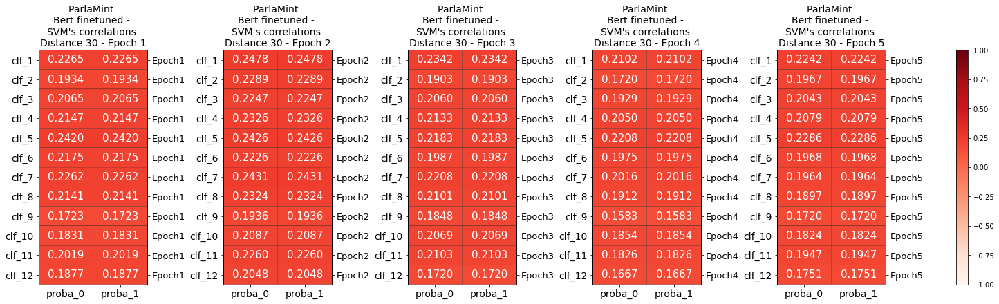

In [168]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_30, 30, diz_cmap['30'])

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


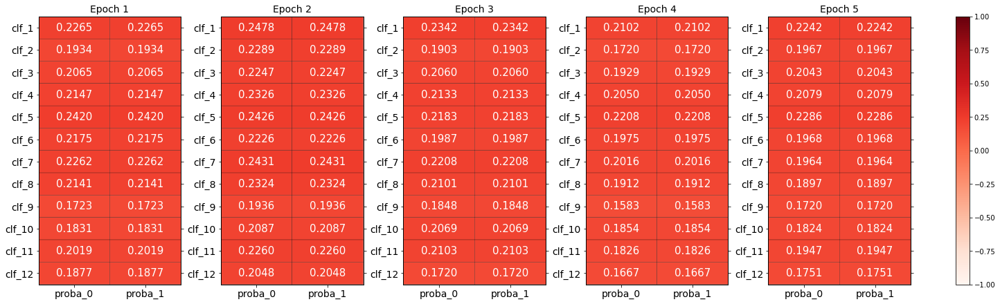

In [169]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_dist_30, 30, diz_cmap['30'], 'ridotto')

In [170]:
corr, _ = spearmanr([diz_dist_30_bf['df_dist_30']['Epoch0']['ids_proba'][i][0] \
                     for i in diz_dist_30_bf['df_dist_30']['Epoch0']['ids_proba']], \
                    
                    [diz_dist_30_svm['df_dist_30']['clf_12']['ids_proba'][i][0] \
                     for i in diz_dist_30_svm['df_dist_30']['clf_12']['ids_proba']])

print(corr)

0.18769020551831234


In [171]:
list_df_bert_finetuning_proba_svm_random_speech = []

for i in num_epoch:    
    list_df_bert_finetuning_proba_svm_random_speech.append(get_proba_df_svm_bert_finetunato(diz_random_speech_svm['df_random_speech'],\
                                                                            diz_random_speech_bf['df_random_speech'], i))

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


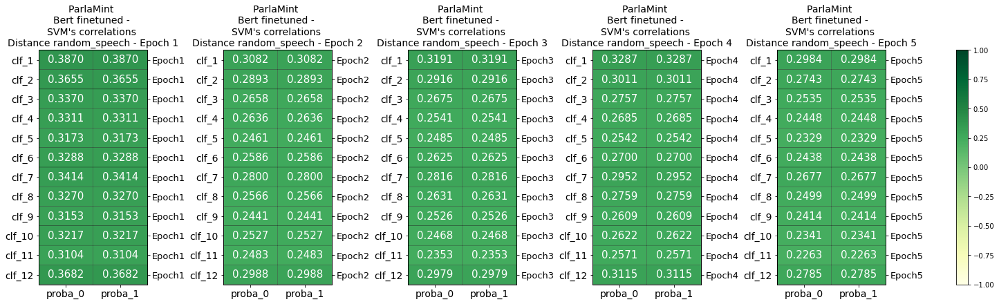

In [172]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_random_speech, 'random_speech', \
                                  diz_cmap['random_speech'])

/var/folders/zr/x6zkwkj55dl2mb3rc8k8h1_h0000gn/T/ipykernel_64697/2324358847.py:39: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(heatmap, pad=0.3)


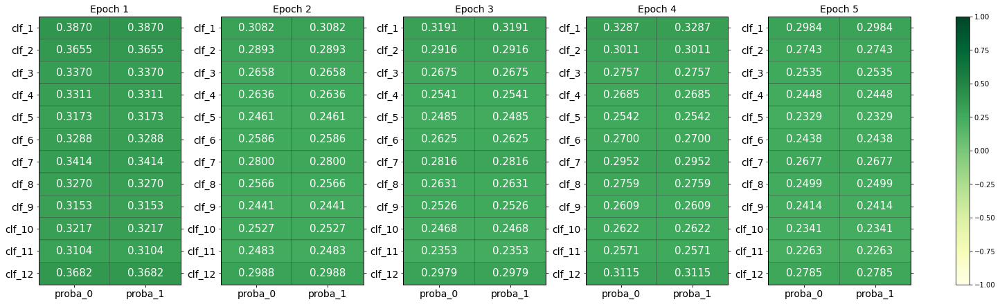

In [173]:
plot_correlation_heatmap_bert_svm(list_df_bert_finetuning_proba_svm_random_speech, 'random_speech', \
                                  diz_cmap['random_speech'], 'ridotto')

# Correlazioni fra Bert non pre-trainato e Bert pre-trainato

In [174]:
def get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(diz_pretrained, diz_no_pretrained):
    
    df_proba_bert_pretrained = pd.DataFrame()
    df_proba_bert_no_pretrained = pd.DataFrame()
    
    for i in range(0,5):
        df_tmp_pretrained = pd.DataFrame.from_dict(diz_pretrained['Epoch{}'.format(str(i))]['ids_proba'], \
                                       columns=["Epoch{}_proba_{}".format(i+1, k) for k in [0, 1]], \
                                                   orient='index')
        
        df_proba_bert_pretrained = pd.concat([df_proba_bert_pretrained, df_tmp_pretrained], axis = 1)
        #--------------------------------------------------------------------------------------------------------
        df_tmp_no_pretrained = pd.DataFrame.from_dict(diz_no_pretrained['Epoch{}'.format(str(i))]['ids_proba'], \
                                       columns=["Epoch{}_proba_{}_no_pretrain".format(i+1, k) for k in [0, 1]], \
                                                      orient='index')
        
        df_proba_bert_no_pretrained = pd.concat([df_proba_bert_no_pretrained, df_tmp_no_pretrained], axis = 1)

    df_proba_total = pd.concat([df_proba_bert_pretrained, df_proba_bert_no_pretrained], axis = 1)
    df_proba_total.reset_index(inplace=True)
    df_proba_total.rename(columns={'index':'Id'}, inplace=True)
    
    return df_proba_total

In [175]:
def get_correlation_matrix_no_pretrain(df, dist, cmap, titolo_ridotto=''):
    
    df_corr_orig = df.corr(method='spearman')
    
    df_corr = df_corr_orig.copy()
    
    cols = [col for col in df_corr.columns if 'no_pretrain' not in col]
    cols.append('Id')

    df_corr.drop(cols, axis=1, inplace=True)
    
    rows = [col for col in df_corr.columns if 'no_pretrain' in col]
    rows.append('Id')

    df_corr.drop(rows, axis = 0, inplace=True)
    
    fig, ax = plt.subplots(figsize=(12,7))
    sns.heatmap(df_corr, cmap=cmap, annot = True, fmt = '.2f', vmin=-1, vmax=1)
    
    if not titolo_ridotto:
        title = "{} Bert fine-tuned pre-trained - Bert fine-tuned no pre-trained's correlations \nDistance {}".format(risorsa, dist)
    else:
        title = "Distance {}".format(dist)
        
    plt.title(title)
    
    if not titolo_ridotto:
        fig.savefig(path_images + title.replace("\n", '') + '_no_pretrain.png', dpi=fig.dpi, bbox_inches='tight')
    else:
        title = "{} Bert fine-tuned pre-trained - Bert fine-tuned no pre-trained's correlations \nDistance {}".format(risorsa, dist)
        fig.savefig(path_images_tit_ridotti + title.replace("\n", '') + '_no_pretrain.png', dpi=fig.dpi, bbox_inches='tight')
    
    plt.show()
    
    return df_corr_orig

In [176]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_5 = \
    get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(diz_dist_5_bf['df_dist_5'], \
                                                                        diz_dist_5_bf_no_pretrain['df_dist_5'])

In [177]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_5

,Id,Epoch1_proba_0,Epoch1_proba_1,Epoch2_proba_0,Epoch2_proba_1,Epoch3_proba_0,Epoch3_proba_1,Epoch4_proba_0,Epoch4_proba_1,Epoch5_proba_0,...,Epoch1_proba_0_no_pretrain,Epoch1_proba_1_no_pretrain,Epoch2_proba_0_no_pretrain,Epoch2_proba_1_no_pretrain,Epoch3_proba_0_no_pretrain,Epoch3_proba_1_no_pretrain,Epoch4_proba_0_no_pretrain,Epoch4_proba_1_no_pretrain,Epoch5_proba_0_no_pretrain,Epoch5_proba_1_no_pretrain
0,3511,0.416695,0.583305,0.339515,0.660485,0.027861,0.972139,0.006812,0.993188,0.000402,...,0.525120,0.474880,0.509914,0.490086,0.510786,0.489214,0.507784,0.492216,0.499702,0.500298
1,443194,0.527308,0.472692,0.613658,0.386342,0.705266,0.294734,0.552000,0.448000,0.167935,...,0.521284,0.478716,0.506303,0.493697,0.507451,0.492549,0.504689,0.495311,0.496640,0.503360
2,438394,0.727630,0.272370,0.886159,0.113841,0.960816,0.039184,0.994669,0.005331,0.989630,...,0.501957,0.498043,0.487481,0.512519,0.488895,0.511105,0.486721,0.513279,0.479447,0.520553
3,313751,0.425089,0.574911,0.369113,0.630887,0.041638,0.958362,0.032358,0.967642,0.000431,...,0.487795,0.512205,0.473038,0.526962,0.474315,0.525684,0.471700,0.528300,0.464495,0.535505
4,488165,0.494760,0.505240,0.397623,0.602377,0.674382,0.325618,0.567554,0.432446,0.000942,...,0.516468,0.483532,0.501507,0.498493,0.503116,0.496884,0.500897,0.499103,0.493080,0.506920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2395,35231,0.457519,0.542481,0.653037,0.346963,0.904169,0.095831,0.984018,0.015982,0.855538,...,0.511953,0.488047,0.497147,0.502853,0.498552,0.501448,0.496017,0.503983,0.488307,0.511693
2396,300044,0.565930,0.434070,0.781245,0.218755,0.260961,0.739039,0.994744,0.005256,0.981212,...,0.496544,0.503456,0.481989,0.518011,0.483646,0.516354,0.481621,0.518379,0.473989,0.526011
2397,74207,0.502398,0.497602,0.460317,0.539683,0.042093,0.957907,0.066736,0.933264,0.002291,...,0.530227,0.469773,0.514919,0.485082,0.515841,0.484159,0.512824,0.487176,0.504614,0.495386
2398,390608,0.456637,0.543363,0.222310,0.777690,0.019487,0.980513,0.002758,0.997242,0.000243,...,0.527352,0.472648,0.511903,0.488097,0.512800,0.487200,0.509777,0.490222,0.501558,0.498442


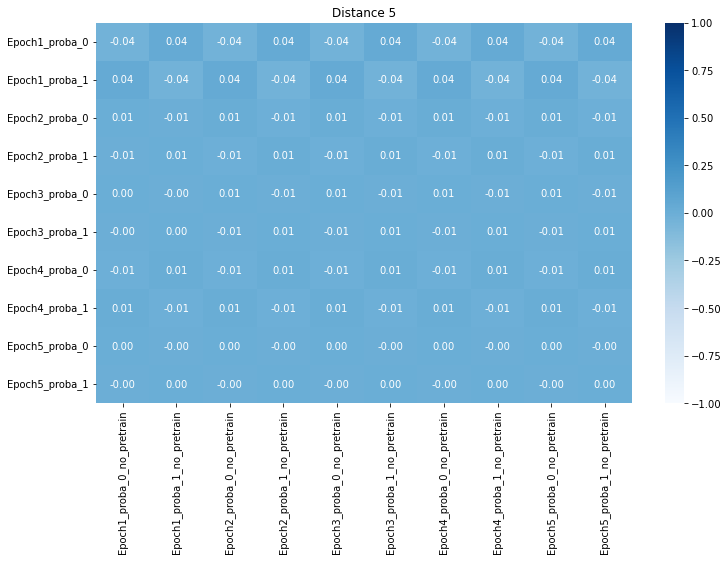

In [178]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_5_corr_orig = \
        get_correlation_matrix_no_pretrain(df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_5, \
                               '5', diz_cmap['5'], 'ridotto')

In [179]:
#Esempio: prendo lista delle probabilità dell' Epoca 4 - distanza 5 per la classe 1 (non segue) e le distanze coseniche
#del livello 2
corr, _ = spearmanr([diz_dist_5_bf['df_dist_5']['Epoch4']['ids_proba'][i][1] \
                     for i in diz_dist_5_bf['df_dist_5']['Epoch4']['ids_proba']], \
                    [diz_dist_5_bf_no_pretrain['df_dist_5']['Epoch0']['ids_proba'][i][1] \
                     for i in diz_dist_5_bf_no_pretrain['df_dist_5']['Epoch0']['ids_proba']])                                                                 

print("%.6f" %corr)

0.001756


In [180]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_10 = \
    get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(diz_dist_10_bf['df_dist_10'], \
                                                                        diz_dist_10_bf_no_pretrain['df_dist_10'])

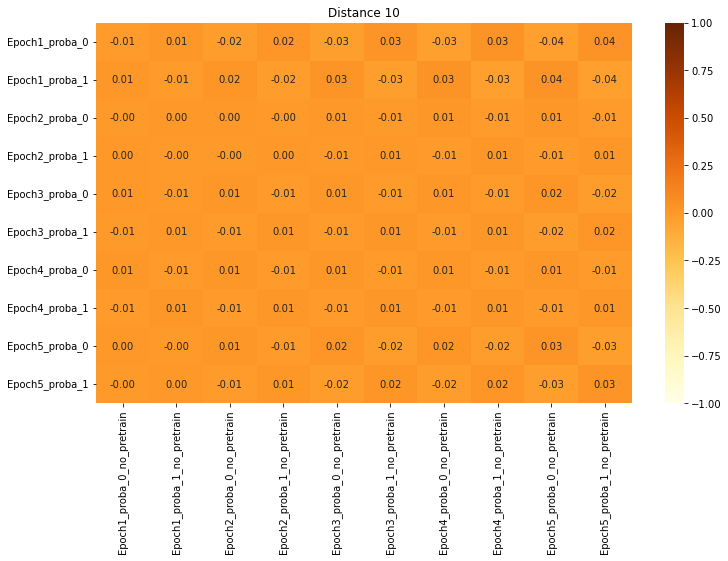

In [181]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_10_corr_orig = \
        get_correlation_matrix_no_pretrain(df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_10, \
                               '10', diz_cmap['10'], 'ridotto')

In [182]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_20 = \
    get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(diz_dist_20_bf['df_dist_20'], \
                                                                        diz_dist_20_bf_no_pretrain['df_dist_20'])

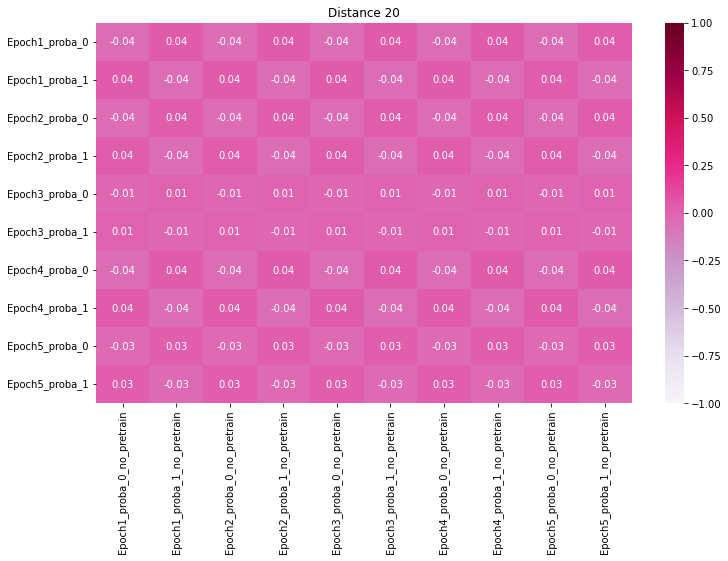

In [183]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_20_corr_orig = \
        get_correlation_matrix_no_pretrain(df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_20, \
                               '20', diz_cmap['20'], 'ridotto')

In [184]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_30 = \
    get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(diz_dist_30_bf['df_dist_30'], \
                                                                        diz_dist_30_bf_no_pretrain['df_dist_30'])

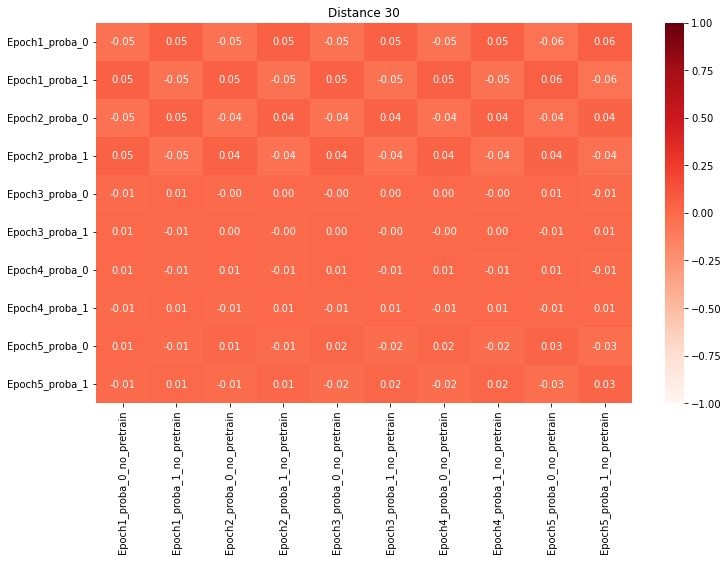

In [185]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_30_corr_orig = \
        get_correlation_matrix_no_pretrain(df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_dist_30, \
                               '30', diz_cmap['30'], 'ridotto')

In [186]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_random_speech = \
    get_probabilities_dataset_for_comparison_with_finetuning_with_no_pretrain(\
                                                diz_random_speech_bf['df_random_speech'], \
                                                diz_random_speech_bf_no_pretrain['df_random_speech'])

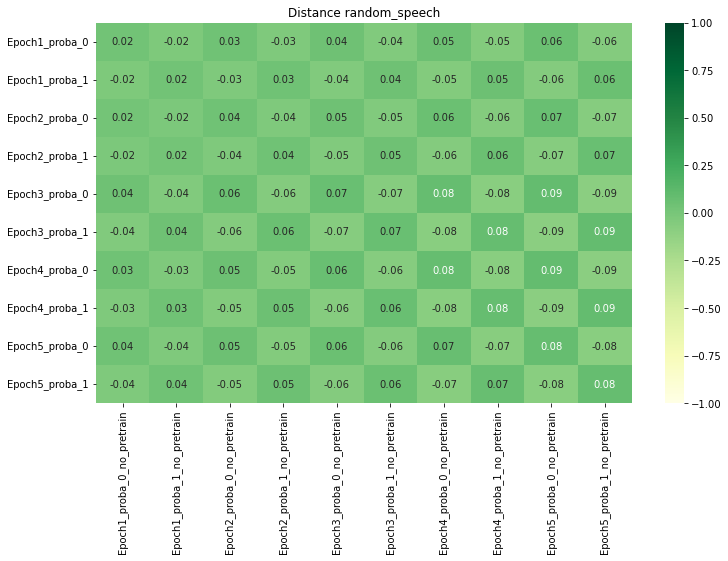

In [187]:
df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_random_speech_corr_orig = \
    get_correlation_matrix_no_pretrain(df_bert_finetuning_pretrain_proba_df_bert_finetuning_no_pretrain_random_speech, \
                               'random_speech', diz_cmap['random_speech'], 'ridotto')